In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np

import torch.nn.functional as F
import torch

import os

import seaborn as sns

from tqdm import tqdm
import xmltodict

from matplotlib.pyplot import MultipleLocator


import matplotlib as mpl

# mpl.rcParams['lines.linewidth'] = 3

mpl.rcParams['axes.linewidth']=2

mpl.rcParams['xtick.labelsize']=14
mpl.rcParams['ytick.labelsize']=14


mpl.rcParams['axes.labelsize']=18




# Load

In [ ]:
## Dock performance total

In [2]:
dock_performance=[6405,
9837,
10896,
11569,
12284,
12820,
13123,
13293,
13353,
13390
]

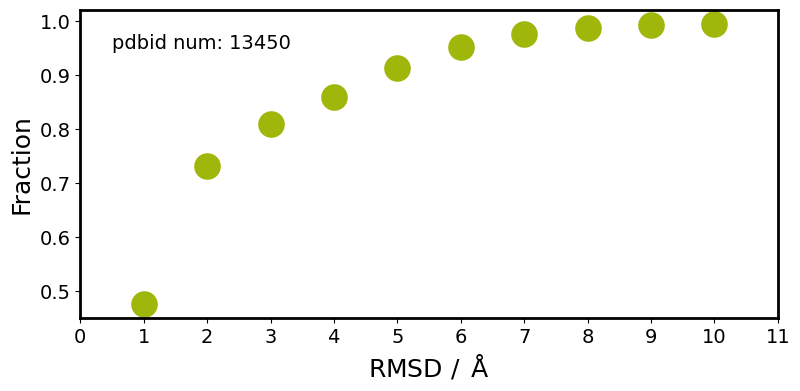

In [3]:
from matplotlib.pyplot import MultipleLocator

plt.figure(figsize=(9,4))
mpl.rcParams['axes.linewidth']=2

mpl.rcParams['xtick.labelsize']=14
mpl.rcParams['ytick.labelsize']=14


mpl.rcParams['axes.labelsize']=18
#'#acbb0d

plt.scatter([i+1 for i in range(10)], np.array(dock_performance)/13450,s=200,color='#9FB70A',linewidths=5)
plt.xlabel('RMSD / $\,\mathrm{\AA}$',fontsize=18)
plt.ylabel('Fraction',fontsize=18)
plt.xlim(0,11)
plt.text(0.5,0.95,'pdbid num: 13450',fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
x_major_locator = MultipleLocator(1)
ax = plt.gca()
ax.xaxis.set_major_locator(x_major_locator)
# bwith = 2 #边框宽度设置为2
# ax = plt.gca()#获取边框
# ax.spines['top'].set_color('red')  # 设置上‘脊梁’为红色
# ax.spines['right'].set_color('none')  # 设置上‘脊梁’为无色
# ax.spines['top'].set_color('none')
# ax.spines['left'].set_color('none')
# ax.spines['bottom'].set_color('none')
# plt.minorticks_off()
# plt.tick_params(direction='in',color='violet',width=4)

# ax.spines['bottom'].set_linewidth(bwith)
# ax.spines['left'].set_linewidth(bwith)
# ax.spines['top'].set_linewidth(bwith)
# ax.spines['right'].set_linewidth(bwith)

plt.savefig('total_docking.pdf', bbox_inches='tight')
plt.show()

## common dataset

In [5]:
origin_data_path='/data/mdml/neutral_collection/analysis_all/origin_data'
file_all=os.path.join(origin_data_path,'2019-all-information-2021-9-4.csv')
file_sel_100=os.path.join(origin_data_path,'pdbid_100.txt')

all_data=pd.read_csv(file_all)                     

sel_100=pd.read_table(file_sel_100,header=None,sep='\s+')[0].tolist()
sel_100_data=all_data[all_data['pdbid'].isin(sel_100)]
sel_100_order=sel_100_data['pdbid'].tolist()


## Plot distribution of affinity

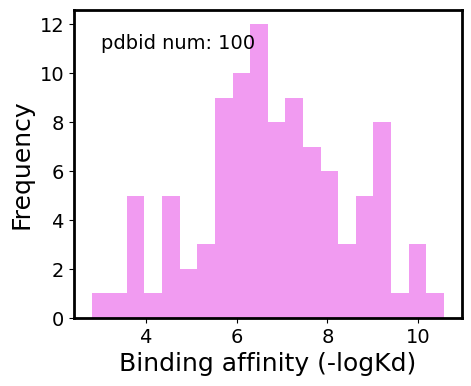

In [7]:
plt.figure(figsize=(5,4))

sel_100_data['affinity(-logkd)'].hist(bins=20,color = "violet",grid=False,alpha=0.8)


mpl.rcParams['axes.linewidth']=2

mpl.rcParams['xtick.labelsize']=14
mpl.rcParams['ytick.labelsize']=14


mpl.rcParams['axes.labelsize']=18

plt.xlabel('Binding affinity (-logKd)',fontsize=18)
plt.ylabel('Frequency',fontsize=18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.text(3,11,'pdbid num: 100',fontsize=14)

# plt.title('Distribution of affinity (num: 100)')
plt.savefig('distribution.pdf', bbox_inches='tight')
plt.show()

# Common functions

In [8]:
def comparison_four_pose(pdfile,col1='native',col2='10a',col3='5a',col4='2a',reverse=False):
    if reverse:
        screen_1=pdfile[pdfile[col1]>pdfile[col2]]
        screen_2=screen_1[screen_1[col1]>screen_1[col3]]
        screen_3=screen_2[screen_2[col1]>screen_2[col4]]
    else:        
        screen_1=pdfile[pdfile[col1]<pdfile[col2]]
        screen_2=screen_1[screen_1[col1]<screen_1[col3]]
        screen_3=screen_2[screen_2[col1]<screen_2[col4]]
    print(len(screen_1),len(screen_2),len(screen_3))
    return screen_2

# RMSD section

In [9]:
color_native = 'blue'
color_2a = 'skyblue'
color_5a = 'salmon'
color_10a = 'pink'

In [10]:
path_native = '/data/mdml/neutral_collection/neutral_native/'
path_2a = '/data/mdml/neutral_collection/neutral_2a/'
path_5a = '/data/mdml/neutral_collection/neutral_5a/'
path_10a = '/data/mdml/neutral_collection/neutral_10a/'

## Draw rmsd of ligand and protein for each pdbid

In [17]:
def rmsd_plot(file):
    with open(file, 'r') as f:
        cons = []
        contents = f.readlines()
        for line in contents:
            if line.startswith('@'):
                pass
            else:
                line = [float(i) for i in line.split()]
                cons.append(line)

    return np.array(cons)


def plot_rmsd_four(pdbid):

    affinity = sel_100_data.loc[sel_100_data['pdbid'] ==
                                pdbid]['affinity(-logkd)'].values[0]

    plt.figure(figsize=(8, 3))
    plt.subplot(1, 2, 1)

    x_native = rmsd_plot(path_native + pdbid + 'MD2_neu/new_rmsd_lig.agr')
    x_2a = rmsd_plot(path_2a + pdbid + 'MD_neu_2a/new_rmsd_lig.agr')
    x_5a = rmsd_plot(path_5a + pdbid + 'MD_neu_5a/new_rmsd_lig.agr')
    x_10a = rmsd_plot(path_10a + pdbid + 'MD_neu_10a/new_rmsd_lig.agr')
    sel_native, = plt.plot(x_native[:, 0]/500, x_native[:, 1], color_native)
    sel_2a, = plt.plot(x_2a[:, 0]/500, x_2a[:, 1], color_2a)
    sel_5a, = plt.plot(x_5a[:, 0]/500, x_5a[:, 1], color_5a)
    sel_10a, = plt.plot(x_10a[:, 0]/500, x_10a[:, 1], color_10a)
    plt.ylim(0, 6)

    x_major_locator=MultipleLocator(5)

    ax=plt.gca()

    ax.xaxis.set_major_locator(x_major_locator)


    plt.legend(handles=[sel_native, sel_2a, sel_5a, sel_10a],
               labels=['native','$2\,\mathrm{\AA}$','$5\,\mathrm{\AA}$','$10\,\mathrm{\AA}$'],
               loc='best',frameon=False)
    plt.title(pdbid + '_lig_' + str(affinity))
    plt.xlabel('Simulation time / ns')
    plt.ylabel('RMSD / Å')

    plt.subplot(1, 2, 2)
    y_pro_native = rmsd_plot(path_native + pdbid + 'MD2_neu/new_rmsd_pro.agr')
    y_pro_2a = rmsd_plot(path_2a + pdbid + 'MD_neu_2a/new_rmsd_pro.agr')
    y_pro_5a = rmsd_plot(path_5a + pdbid + 'MD_neu_5a/new_rmsd_pro.agr')
    y_pro_10a = rmsd_plot(path_10a + pdbid + 'MD_neu_10a/new_rmsd_pro.agr')
    y_sel_native, = plt.plot(y_pro_native[:, 0]/500, y_pro_native[:, 1],
                             color_native)
    y_sel_2a, = plt.plot(y_pro_2a[:, 0]/500, y_pro_2a[:, 1], color_2a)
    y_sel_5a, = plt.plot(y_pro_5a[:, 0]/500, y_pro_5a[:, 1], color_5a)
    y_sel_10a, = plt.plot(y_pro_10a[:, 0]/500, y_pro_10a[:, 1], color_10a)
    
    x_major_locator=MultipleLocator(5)

    ax=plt.gca()

    ax.xaxis.set_major_locator(x_major_locator)

    plt.ylim(0, 6)
    plt.legend(handles=[y_sel_native, y_sel_2a, y_sel_5a, y_sel_10a],
               labels=['native','$2\,\mathrm{\AA}$','$5\,\mathrm{\AA}$','$10\,\mathrm{\AA}$'],
               loc='best',frameon=False)
    plt.title(pdbid + '_pro_' + str(affinity))
    plt.xlabel('Simulation time / ns')
    plt.ylabel('RMSD / Å')
    plt.subplots_adjust(wspace=0.3, hspace=0.3)
#     plt.show()
    

### 100 all done

In [12]:
fail=[]
for i in tqdm(sel_100_data['pdbid'].tolist()):
    try:
        plot_rmsd_four(i)
    except:
        fail.append(i)
        pass

 20%|██        | 20/100 [00:12<00:46,  1.71it/s]<ipython-input-11-88d487f5dd82>:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(8, 3))
100%|██████████| 100/100 [00:58<00:00,  1.70it/s]


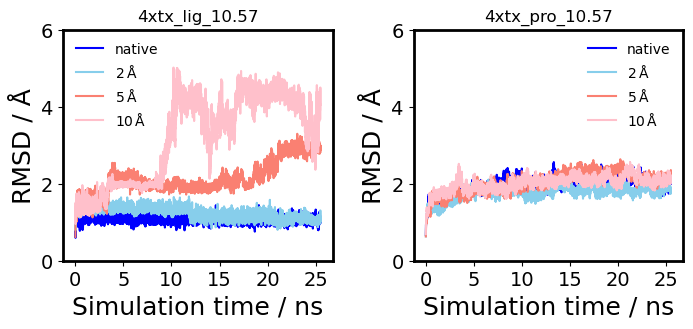

In [15]:
plot_rmsd_four('4xtx')
plt.savefig('4xtx_si_rmsd.pdf',bbox_inches='tight')
plt.show()

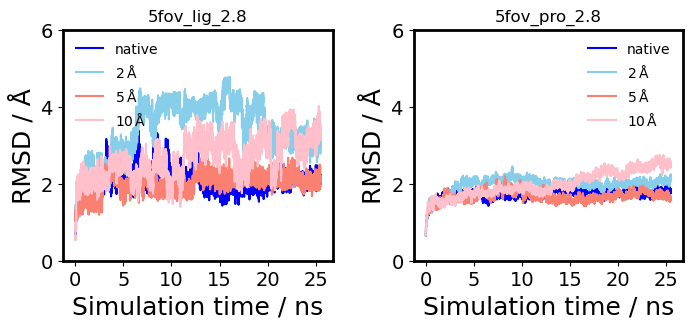

<Figure size 640x480 with 0 Axes>

In [16]:
plot_rmsd_four('5fov')
plt.savefig('5fov_si_rmsd.pdf',bbox_inches='tight')
plt.show()

## RMSD comparison for two

In [18]:
def rmsd_avg(pdbid, x_lower=10250, x_upper=12750):
    
    x_native=rmsd_plot(path_native+pdbid+'MD2_neu/new_rmsd_lig.agr')
    x_2a=rmsd_plot(path_2a+pdbid+'MD_neu_2a/new_rmsd_lig.agr')
    x_5a=rmsd_plot(path_5a+pdbid+'MD_neu_5a/new_rmsd_lig.agr')
    x_10a=rmsd_plot(path_10a+pdbid+'MD_neu_10a/new_rmsd_lig.agr')
    x_native_avg=np.average(x_native[:,1][x_lower:x_upper])
    x_2a_avg=np.average(x_2a[:,1][x_lower:x_upper])
    x_5a_avg=np.average(x_5a[:,1][x_lower:x_upper])
    x_10a_avg=np.average(x_10a[:,1][x_lower:x_upper])

    return x_native_avg, x_2a_avg, x_5a_avg, x_10a_avg



### RMSD last 5 ns (10250,12750)

In [19]:
rmsd_last_five = pd.DataFrame(sel_100_data['pdbid'].tolist(),
                              columns=['pdbid'])

rmsd_last_five.loc[:, 'rmsd_5ns_native'] = np.nan
rmsd_last_five.loc[:, 'rmsd_5ns_2a'] = np.nan
rmsd_last_five.loc[:, 'rmsd_5ns_5a'] = np.nan
rmsd_last_five.loc[:, 'rmsd_5ns_10a'] = np.nan

for i in tqdm(range(len(rmsd_last_five))):
    try:
        rmsd_last_five.loc[
            i,
            ['rmsd_5ns_native', 'rmsd_5ns_2a', 'rmsd_5ns_5a', 'rmsd_5ns_10a'
             ]] = rmsd_avg(rmsd_last_five['pdbid'][i])
    except:
        pass

100%|██████████| 100/100 [00:09<00:00, 10.98it/s]


## Scatter point of rmsd of last 5 ns four poses

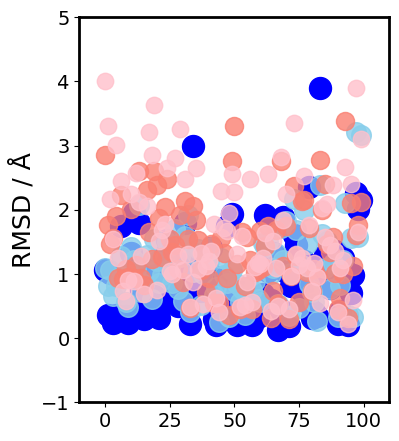

In [20]:
plt.figure(figsize=(4,5))
mpl.rcParams['axes.linewidth']=2

mpl.rcParams['xtick.labelsize']=14
mpl.rcParams['ytick.labelsize']=14


mpl.rcParams['axes.labelsize']=18


plt.scatter([i for i in range(100)],
            rmsd_last_five['rmsd_5ns_native'],
            s=250,
            c=color_native,
            alpha=1)
plt.scatter([i for i in range(100)],
            rmsd_last_five['rmsd_5ns_2a'],
            s=200,
            c=color_2a,
            alpha=0.8)
plt.scatter([i for i in range(100)],
            rmsd_last_five['rmsd_5ns_5a'],
            s=170,
            c=color_5a,
            alpha=0.8)
plt.scatter([i for i in range(100)],
            rmsd_last_five['rmsd_5ns_10a'],
            s=140,
            c=color_10a,
            alpha=0.8)
plt.xlim(-10, 110)
plt.ylim(-1, 5)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.ylabel('RMSD / Å', fontsize=18)
plt.xlabel('', fontsize=18)

plt.savefig('si_rmsd_distribution.pdf',bbox_inches='tight')
plt.show()


## bobplot of mean for all complexs

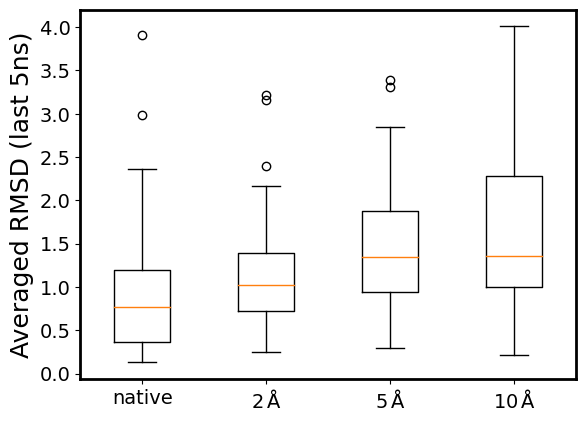

In [21]:
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.ylabel('Averaged RMSD (last 5ns)',fontsize=18)
plt.boxplot(rmsd_last_five[['rmsd_5ns_native','rmsd_5ns_2a','rmsd_5ns_5a','rmsd_5ns_10a']])
plt.xticks([i+1 for i in range(4)], ['native','$2\,\mathrm{\AA}$','$5\,\mathrm{\AA}$','$10\,\mathrm{\AA}$'])
# plt.xlabel('PDBs (Affinity strong --> weak)',fontsize=18)
plt.show()

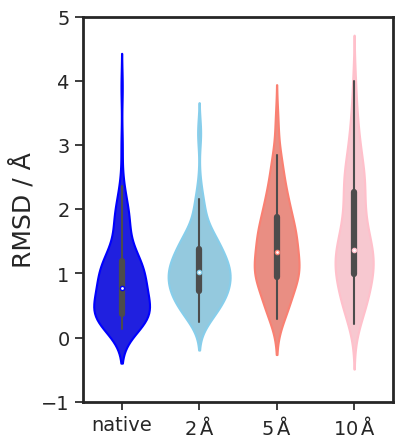

In [22]:
plt.figure(figsize=(4,5))



colors=[color_native,color_native,color_2a,color_2a,color_5a,color_5a,color_10a,color_10a]
sns.set(style="ticks", color_codes=True)    
my_pal = {"rmsd_5ns_native": color_native, "rmsd_5ns_2a": color_2a, "rmsd_5ns_5a": color_5a, "rmsd_5ns_10a": color_10a}

grid=sns.violinplot(data=rmsd_last_five,palette=my_pal,alpha=0.5)

for i in range(len(grid.axes.collections)):
    grid.axes.collections[i].set_edgecolor(colors[i])


plt.xticks([i for i in range(4)], ['native','$2\,\mathrm{\AA}$','$5\,\mathrm{\AA}$','$10\,\mathrm{\AA}$'],fontsize=14)
plt.ylabel('RMSD / Å',fontsize=18)
plt.yticks(fontsize=14)
plt.ylim(-1,5)
plt.xlabel('',fontsize=18)

ax = plt.gca()

bwith = 2 #边框宽度设置为2
ax = plt.gca()#获取边框

ax.spines['bottom'].set_linewidth(bwith)
ax.spines['left'].set_linewidth(bwith)
ax.spines['top'].set_linewidth(bwith)
ax.spines['right'].set_linewidth(bwith)

plt.savefig('si_rmsd_5ns_dis.pdf',bbox_inches='tight')

plt.show()

## Plot comparison for four poses (6 subplots)

In [23]:
#color PRGn
def plot_contrast_native(pdfile,col1='native',col2='5a',color='pink', marker='o', color_scatter='mediumpurple'):

#     plt.scatter(pdfile[col1],pdfile[col2],s=150,c=pdfile['affinity(-logkd)'],cmap=plt.get_cmap('pink'))
    plt.scatter(pdfile[col1],pdfile[col2],s=100,c=color_scatter,marker=marker,alpha=0.5)

    plt.plot([i for i in range(0, 6, 1)],[i for i in range(0, 6, 1)],color=color,linewidth=1.5)
#     plt.plot([i+0.3 for i in range(0, 5, 1)],[i for i in range(0, 5, 1)],color=color)
#     plt.plot([i-0.3 for i in range(0, 5, 1)],[i for i in range(0, 5, 1)],color=color)
    if col1.split('_')[-1]!='native':
        plt.xlabel('RMSD_%s' % col1.split('_')[-1].replace('a', '$\,\mathrm{\AA}$'),fontsize=18)
        plt.ylabel('RMSD_%s' % col2.split('_')[-1].replace('a', '$\,\mathrm{\AA}$'),fontsize=18)

#     plt.title('RMSD reference to first frame (near 5ns)',fontsize=18)
    plt.xlim(-0.5,6)
    plt.ylim(-0.5,6)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
#     plt.colorbar()
#     plt.show()

In [24]:
def plot_six_rmsd_subplot(pdfile,name1='native',name2='2a',name3='5a',name4='10a',labelx=2.0,labely=0.5):
    
    plt.figure(figsize=(22, 12))

    plt.subplot(2, 3, 1)

    plot_contrast_native(pdfile, col1=name1, col2=name2)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name2]]),
                              len(pdfile[pdfile[name1] > pdfile[name2]])),
             fontsize=18)

    plt.subplot(2, 3, 2)
    plot_contrast_native(pdfile, col1=name1, col2=name3)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name3]]),
                              len(pdfile[pdfile[name1] > pdfile[name3]])),
             fontsize=18)

    plt.subplot(2, 3, 3)
    plot_contrast_native(pdfile, col1=name1, col2=name4)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name4]]),
                              len(pdfile[pdfile[name1] > pdfile[name4]])),
             fontsize=18)

    plt.subplot(2, 3, 4)
    plot_contrast_native(pdfile, col1=name2, col2=name3)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name2] < pdfile[name3]]),
                              len(pdfile[pdfile[name2] > pdfile[name3]])),
             fontsize=18)

    plt.subplot(2, 3, 5)
    plot_contrast_native(pdfile, col1=name2, col2=name4)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name2] < pdfile[name4]]),
                              len(pdfile[pdfile[name2] > pdfile[name4]])),
             fontsize=18)

    plt.subplot(2, 3, 6)
    plot_contrast_native(pdfile, col1=name3, col2=name4)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name3] < pdfile[name4]]),
                              len(pdfile[pdfile[name3] > pdfile[name4]])),
             fontsize=18)

    plt.subplots_adjust(wspace=0.3, hspace=0.4)

    # plt.savefig('rmsd_last_5ns.png',bbox_inches='tight')

    plt.show()

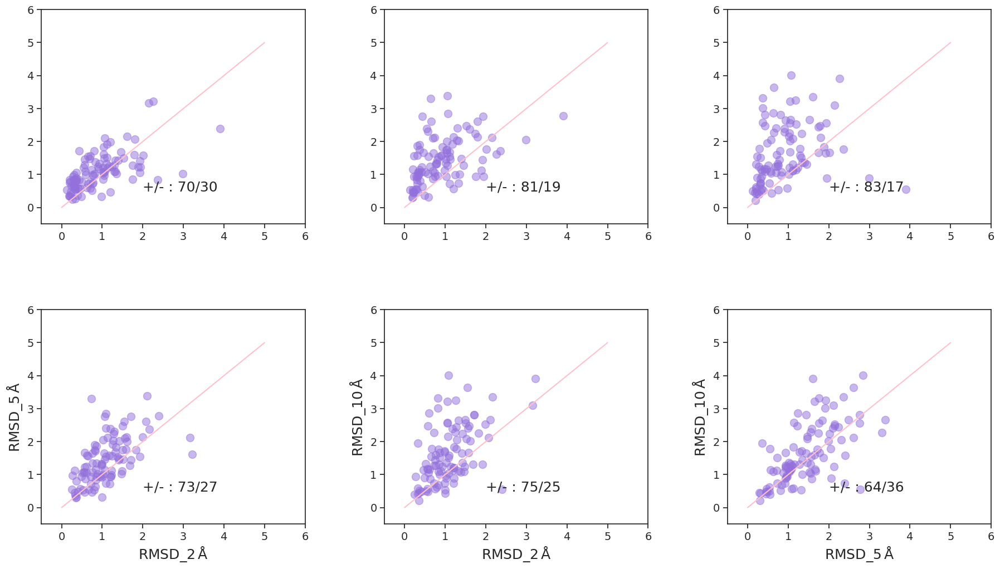

In [25]:
plot_six_rmsd_subplot(rmsd_last_five,
                 name1='rmsd_5ns_native',
                 name2='rmsd_5ns_2a',
                 name3='rmsd_5ns_5a',
                 name4='rmsd_5ns_10a')

## rmsd at different stages (12 2ns)

In [26]:
def rmsd_12_parts(num_periods=12, interval=1000, start=0):

    rmsd_periods = pd.DataFrame(sel_100_data['pdbid'].tolist(),
                                columns=['pdbid'])

    for i in range(num_periods):
        rmsd_periods.loc[:, 'native_%d' % i] = 0
        rmsd_periods.loc[:, '2a_%d' % i] = 0
        rmsd_periods.loc[:, '5a_%d' % i] = 0
        rmsd_periods.loc[:, '10a_%d' % i] = 0

    for time_num in tqdm(range(num_periods)):
        for i in tqdm(range(len(rmsd_periods))):
            cols = [
                'native_%d' % time_num,
                '2a_%d' % time_num,
                '5a_%d' % time_num,
                '10a_%d' % time_num
            ]
            rmsd_periods.loc[i, cols] = rmsd_avg(
                rmsd_periods['pdbid'][i],
                x_lower=interval * time_num + start,
                x_upper=interval * (time_num + 1) + start)

    return rmsd_periods

In [65]:
rmsd_12_data=rmsd_12_parts(num_periods=12, interval=1000, start=0)
rmsd_12_data.to_csv('rmsd_12_data.csv')

  6%|▌         | 6/100 [00:00<00:08, 11.69it/s]


100%|██████████| 12/12 [01:53<00:00,  9.46s/it]


In [28]:
rmsd_12_data=pd.read_csv('rmsd_12_data.csv')

### draw rmsd of 12 periods for each pdbid

  0%|          | 0/100 [00:00<?, ?it/s]

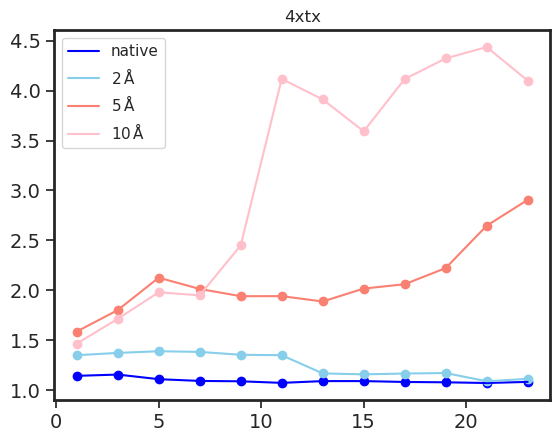

  1%|          | 1/100 [00:00<00:16,  6.09it/s]

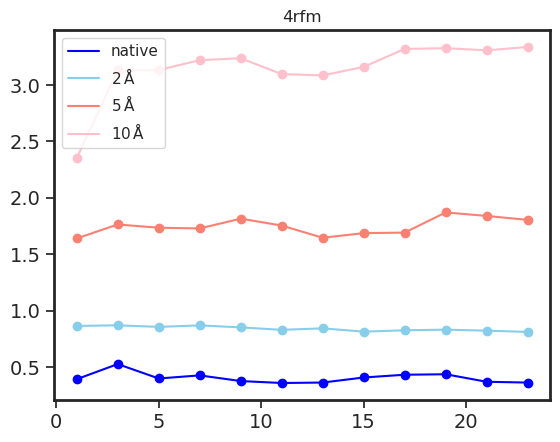

  2%|▏         | 2/100 [00:00<00:24,  4.07it/s]

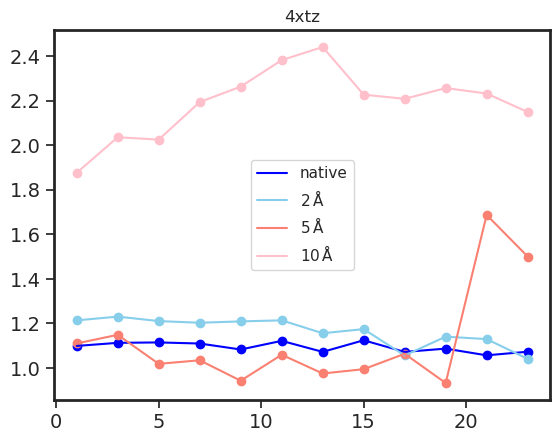

  3%|▎         | 3/100 [00:00<00:19,  4.92it/s]

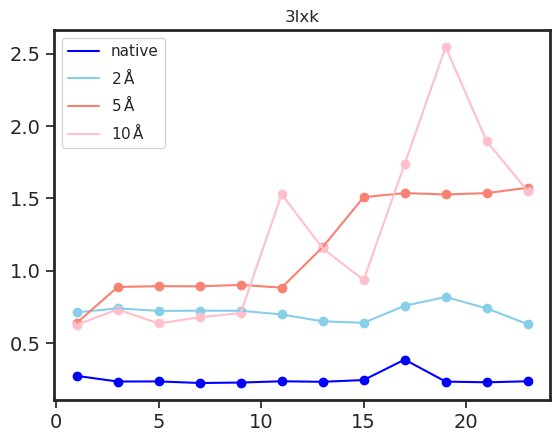

  4%|▍         | 4/100 [00:00<00:17,  5.64it/s]

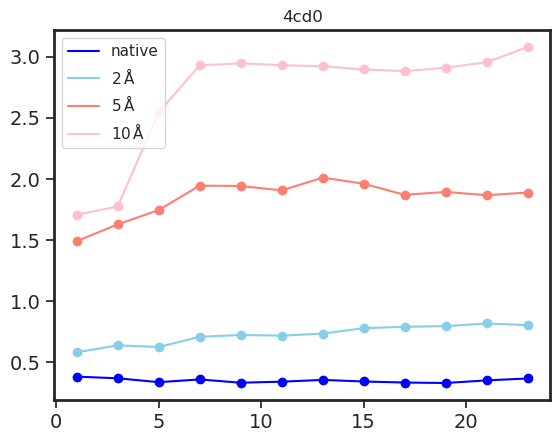

  5%|▌         | 5/100 [00:00<00:15,  6.02it/s]

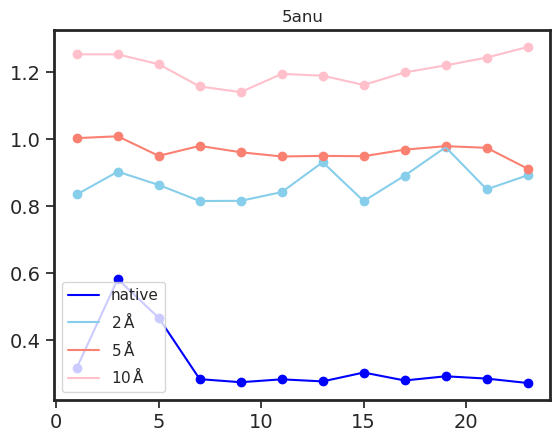

  6%|▌         | 6/100 [00:01<00:14,  6.30it/s]

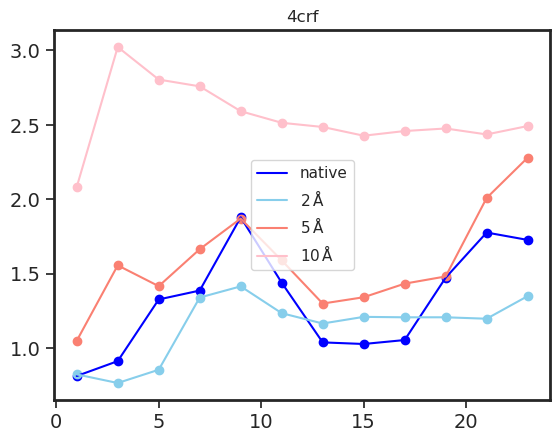

  7%|▋         | 7/100 [00:01<00:14,  6.46it/s]

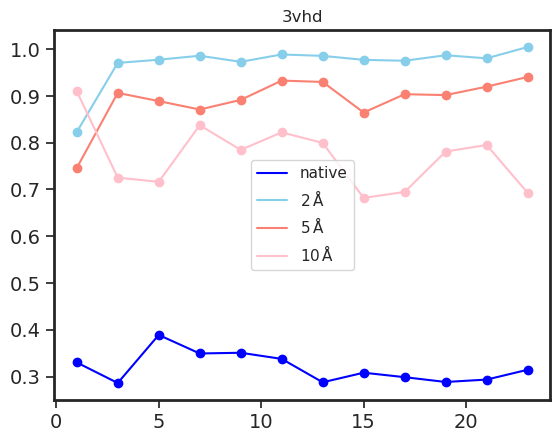

  8%|▊         | 8/100 [00:01<00:14,  6.49it/s]

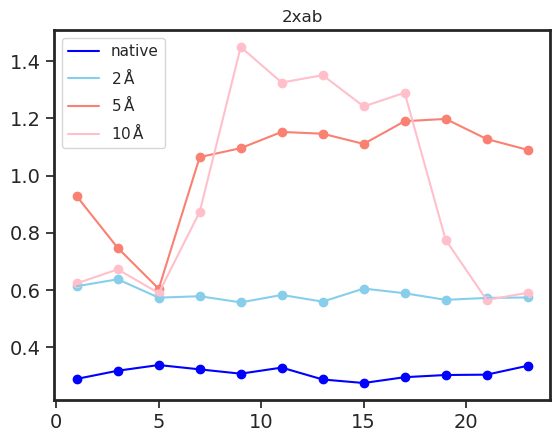

  9%|▉         | 9/100 [00:01<00:13,  6.68it/s]

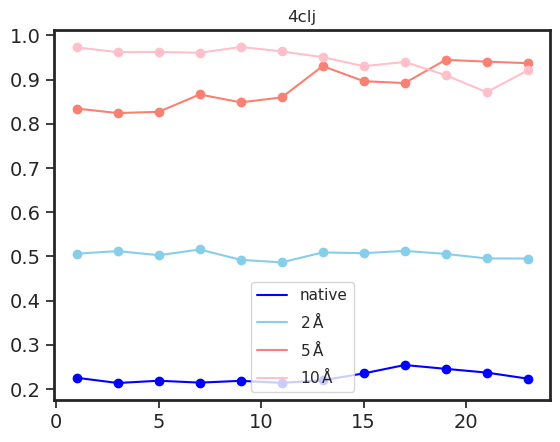

 10%|█         | 10/100 [00:01<00:13,  6.62it/s]

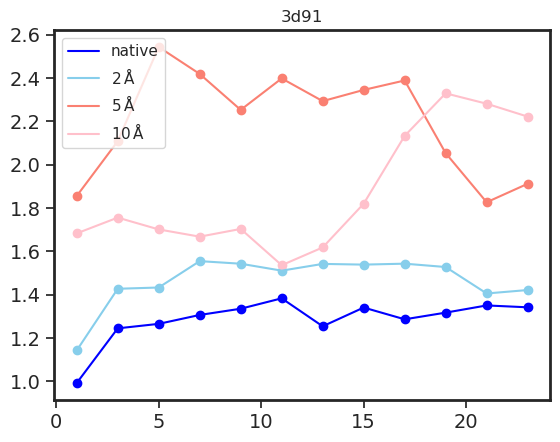

 11%|█         | 11/100 [00:01<00:13,  6.54it/s]

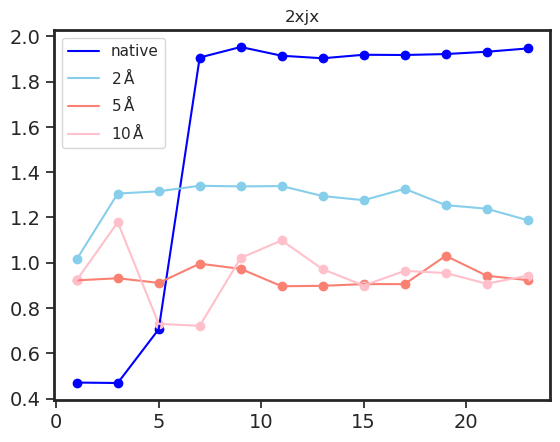

 12%|█▏        | 12/100 [00:01<00:13,  6.61it/s]

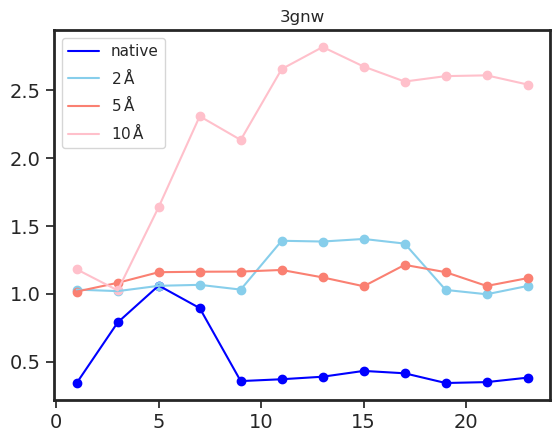

 13%|█▎        | 13/100 [00:02<00:12,  6.74it/s]

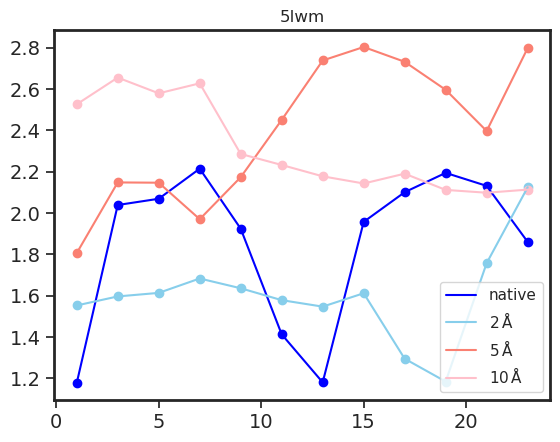

 14%|█▍        | 14/100 [00:02<00:13,  6.35it/s]

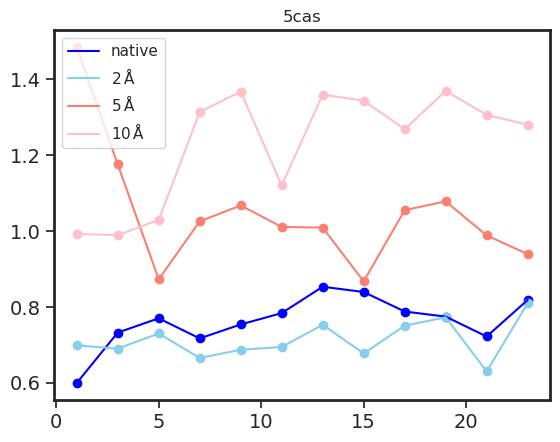

 15%|█▌        | 15/100 [00:02<00:13,  6.45it/s]

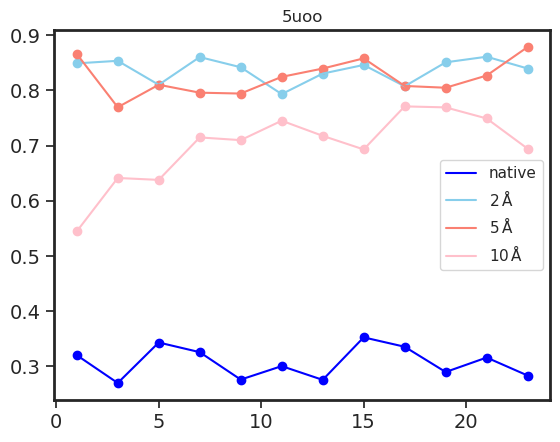

 16%|█▌        | 16/100 [00:02<00:12,  6.47it/s]

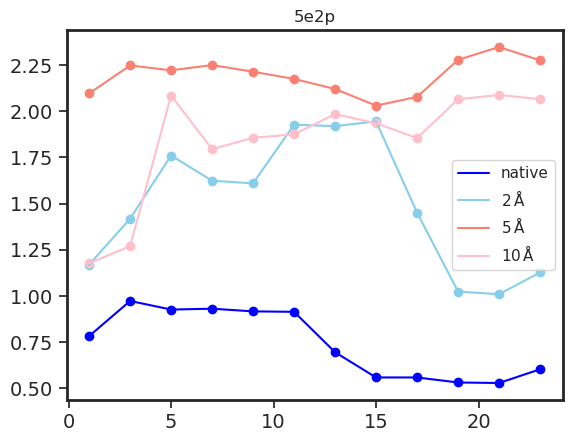

 17%|█▋        | 17/100 [00:02<00:12,  6.53it/s]

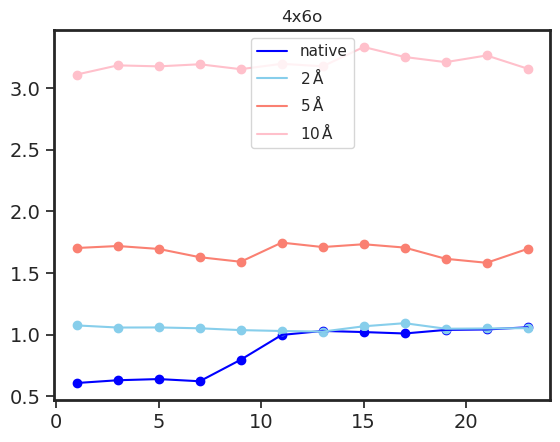

 18%|█▊        | 18/100 [00:02<00:12,  6.62it/s]

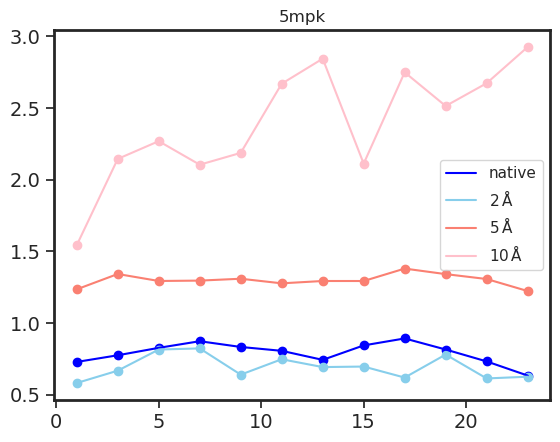

 19%|█▉        | 19/100 [00:03<00:16,  4.98it/s]

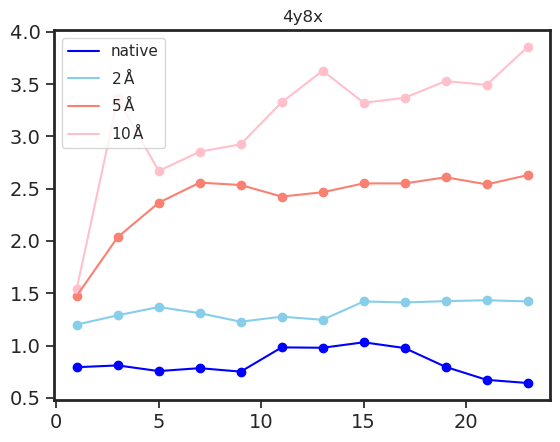

 20%|██        | 20/100 [00:03<00:15,  5.33it/s]

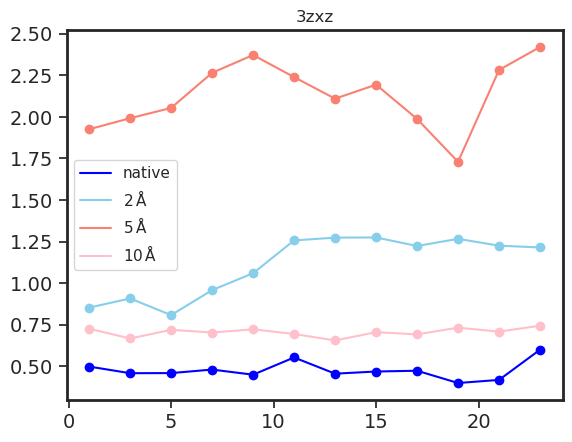

 21%|██        | 21/100 [00:03<00:13,  5.64it/s]

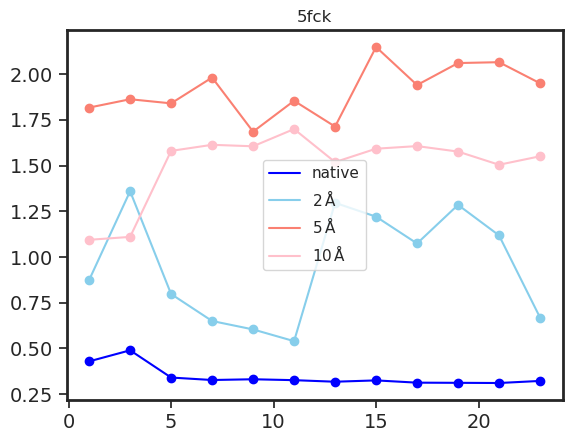

 22%|██▏       | 22/100 [00:03<00:13,  5.87it/s]

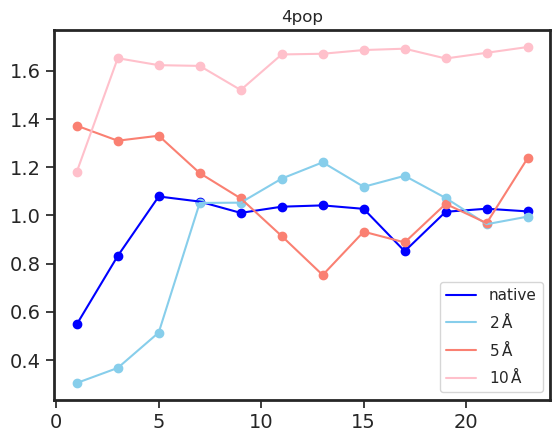

 23%|██▎       | 23/100 [00:03<00:12,  6.15it/s]

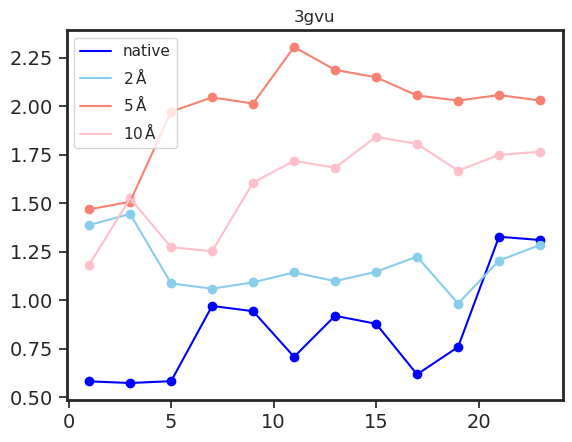

 24%|██▍       | 24/100 [00:03<00:12,  6.23it/s]

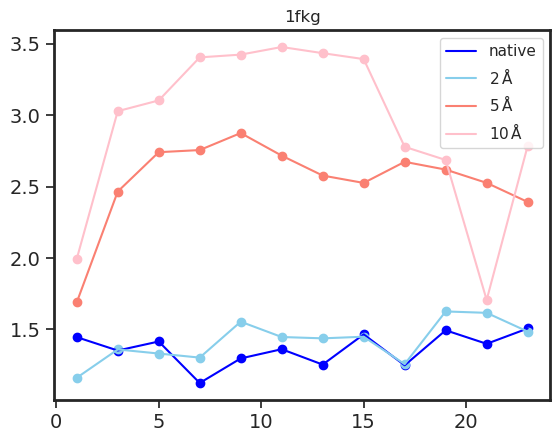

 25%|██▌       | 25/100 [00:04<00:11,  6.39it/s]

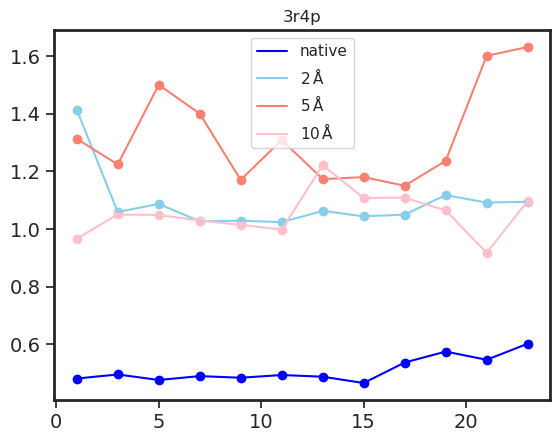

 26%|██▌       | 26/100 [00:04<00:11,  6.49it/s]

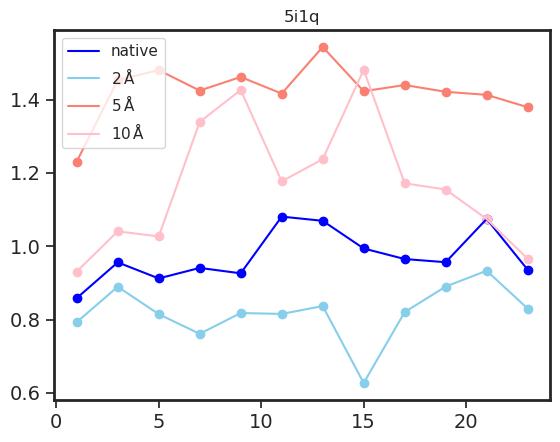

 27%|██▋       | 27/100 [00:04<00:11,  6.57it/s]

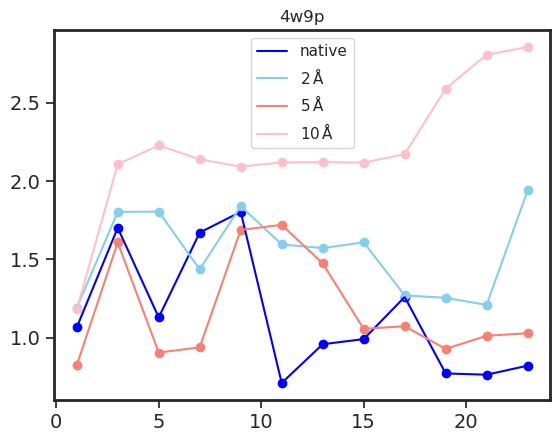

 28%|██▊       | 28/100 [00:04<00:10,  6.67it/s]

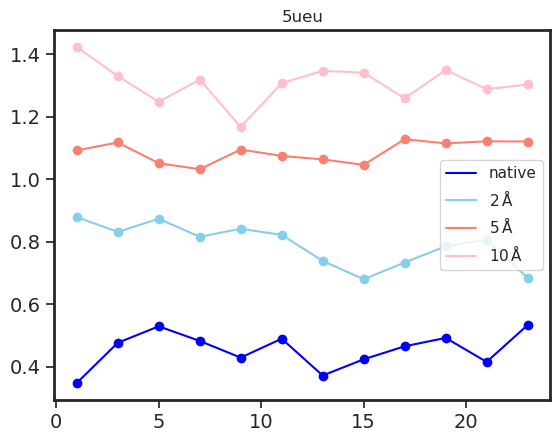

 29%|██▉       | 29/100 [00:04<00:10,  6.70it/s]

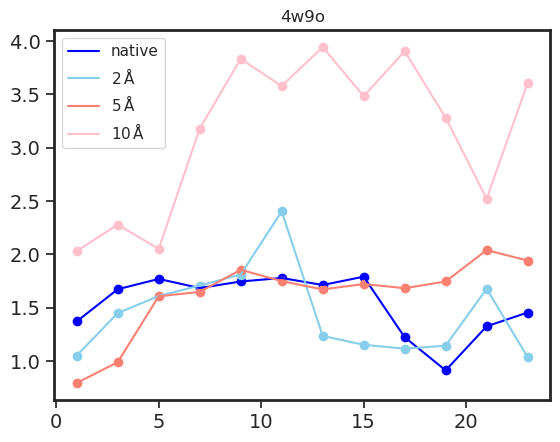

 30%|███       | 30/100 [00:04<00:10,  6.78it/s]

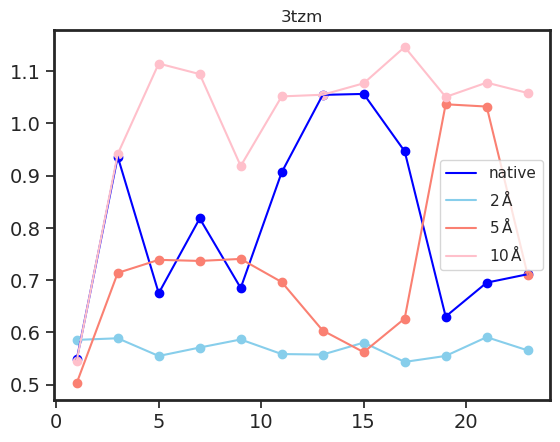

 31%|███       | 31/100 [00:04<00:10,  6.71it/s]

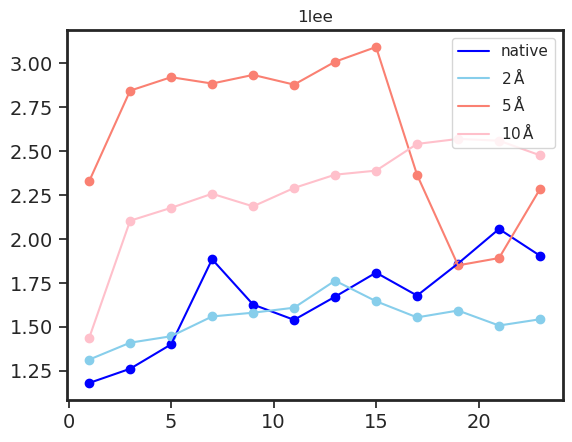

 32%|███▏      | 32/100 [00:05<00:10,  6.63it/s]

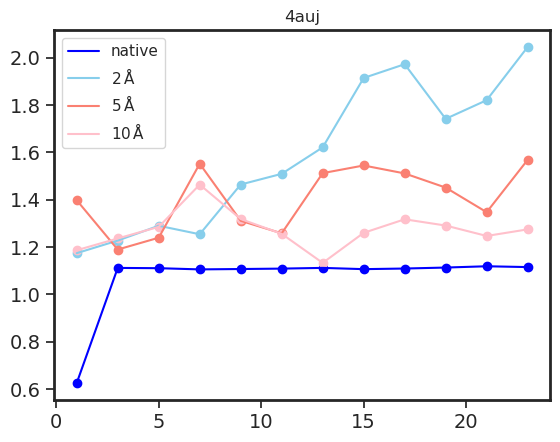

 33%|███▎      | 33/100 [00:05<00:09,  6.71it/s]

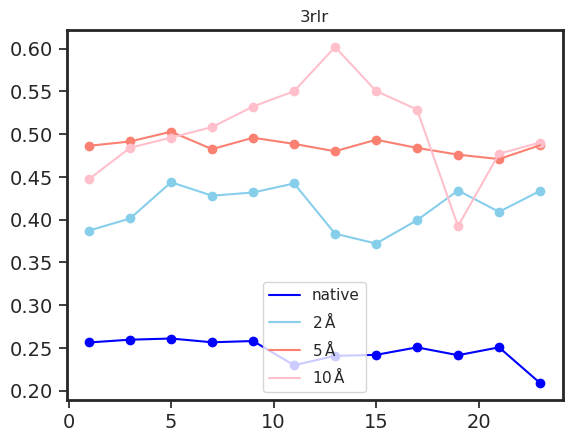

 34%|███▍      | 34/100 [00:05<00:09,  6.62it/s]

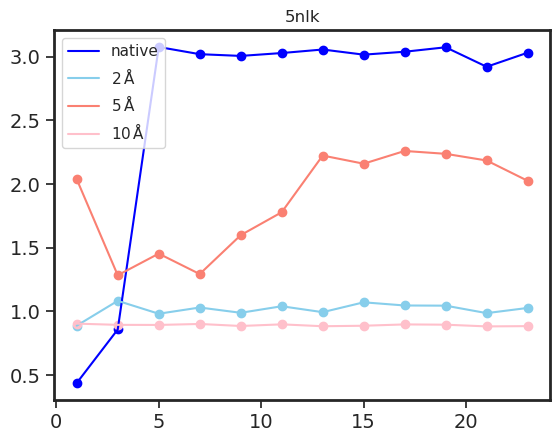

 35%|███▌      | 35/100 [00:05<00:09,  6.65it/s]

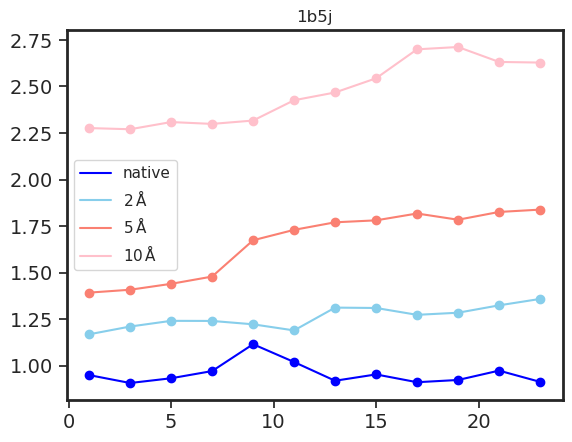

 36%|███▌      | 36/100 [00:05<00:12,  5.08it/s]

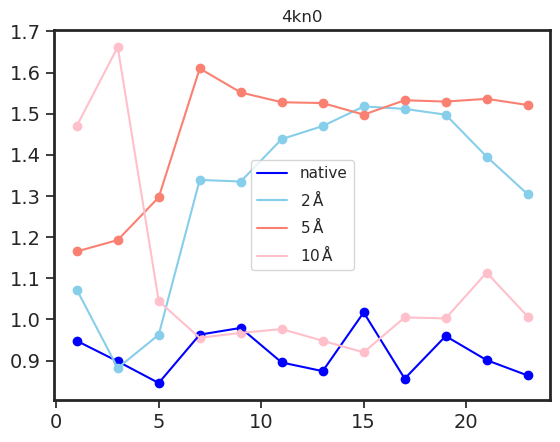

 37%|███▋      | 37/100 [00:06<00:11,  5.42it/s]

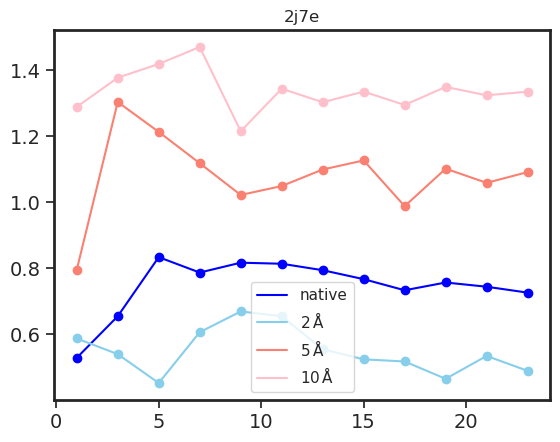

 38%|███▊      | 38/100 [00:06<00:10,  5.77it/s]

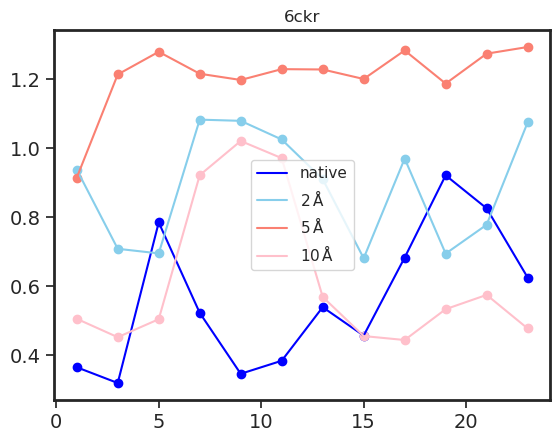

 39%|███▉      | 39/100 [00:06<00:10,  6.03it/s]

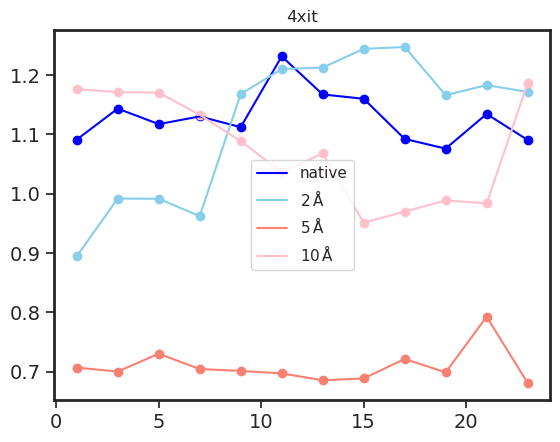

 40%|████      | 40/100 [00:06<00:09,  6.22it/s]

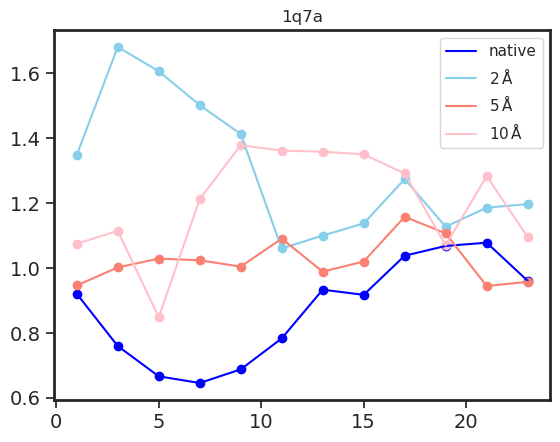

 41%|████      | 41/100 [00:06<00:09,  6.47it/s]

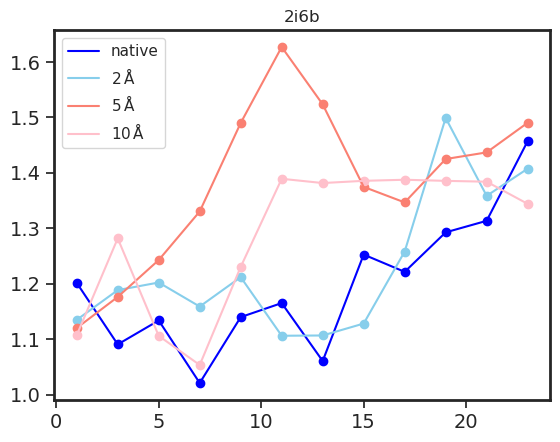

 42%|████▏     | 42/100 [00:06<00:08,  6.60it/s]

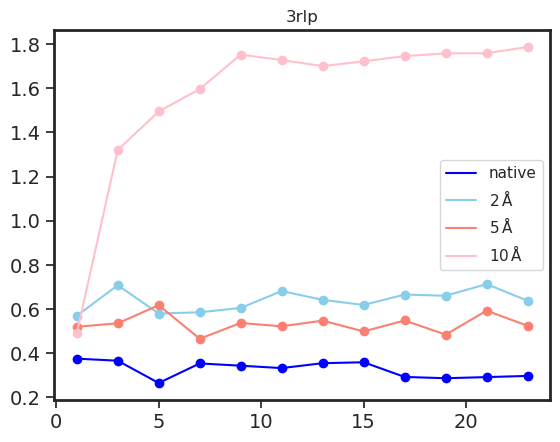

 43%|████▎     | 43/100 [00:06<00:08,  6.62it/s]

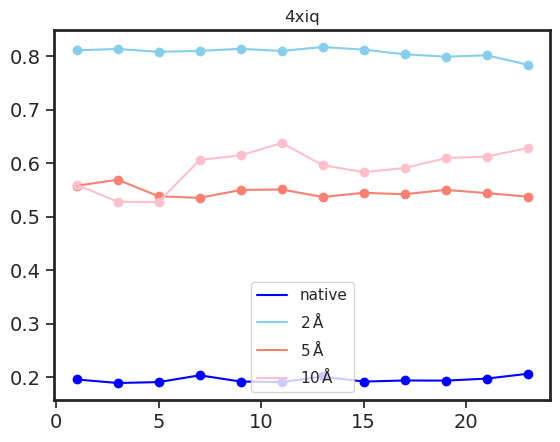

 44%|████▍     | 44/100 [00:07<00:08,  6.64it/s]

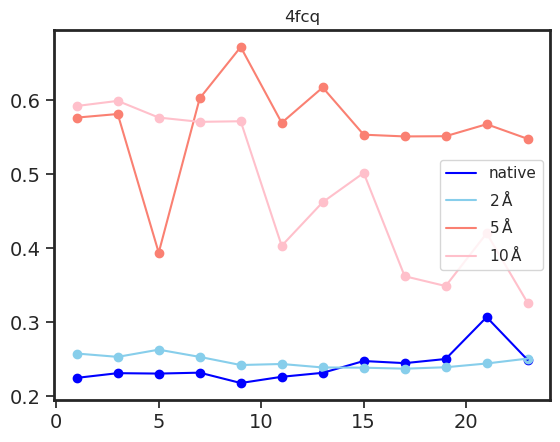

 45%|████▌     | 45/100 [00:07<00:08,  6.68it/s]

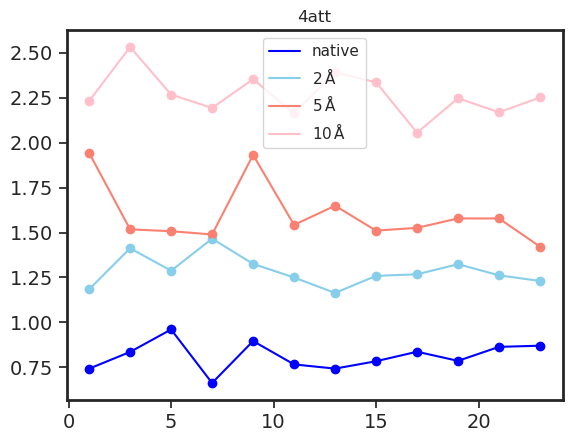

 46%|████▌     | 46/100 [00:07<00:08,  6.62it/s]

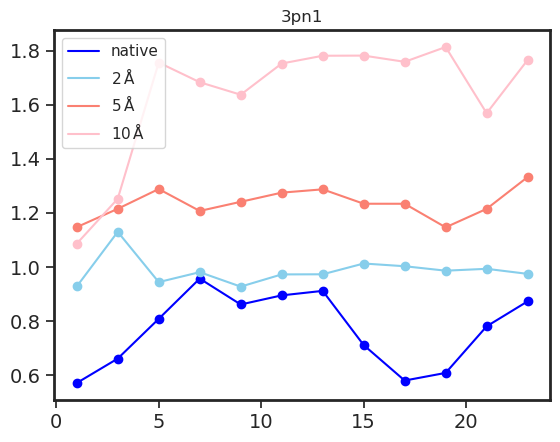

 47%|████▋     | 47/100 [00:07<00:07,  6.63it/s]

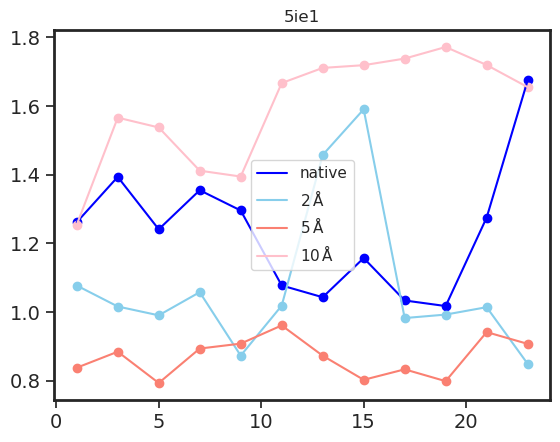

 48%|████▊     | 48/100 [00:07<00:07,  6.61it/s]

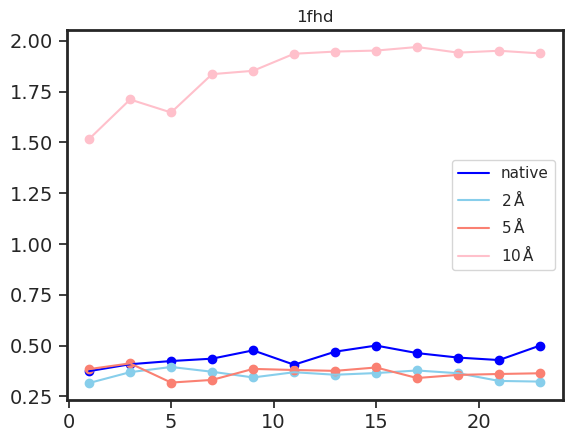

 49%|████▉     | 49/100 [00:07<00:07,  6.67it/s]

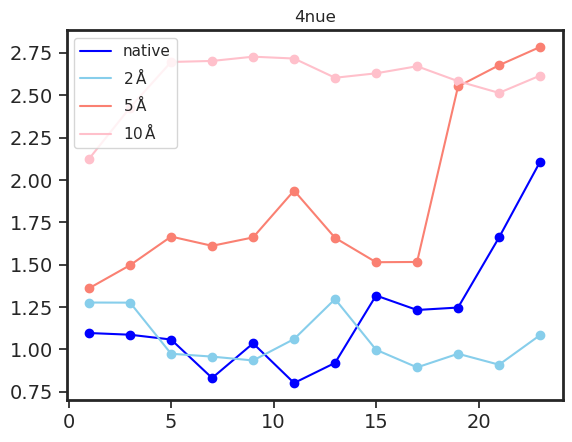

 50%|█████     | 50/100 [00:07<00:07,  6.59it/s]

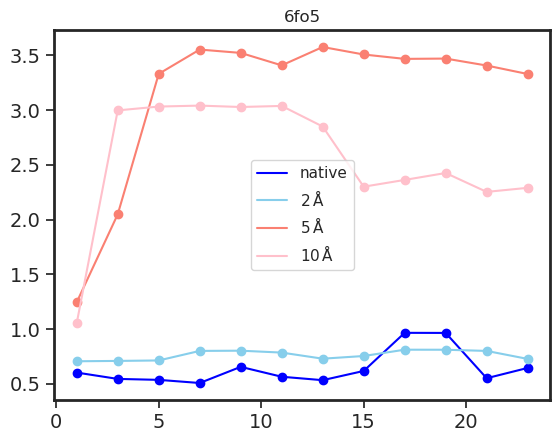

 51%|█████     | 51/100 [00:08<00:07,  6.60it/s]

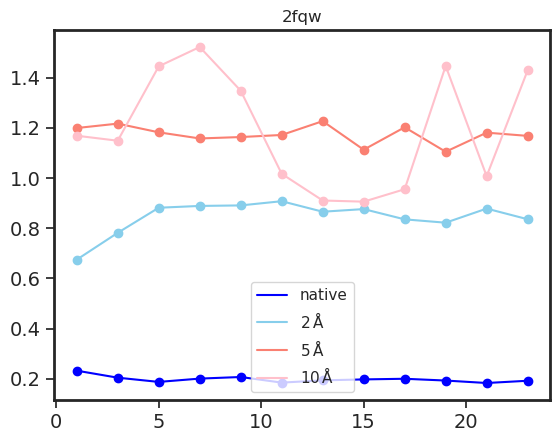

 52%|█████▏    | 52/100 [00:08<00:07,  6.62it/s]

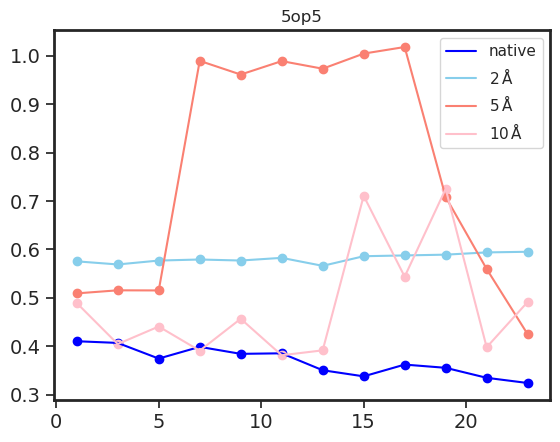

 53%|█████▎    | 53/100 [00:08<00:09,  5.16it/s]

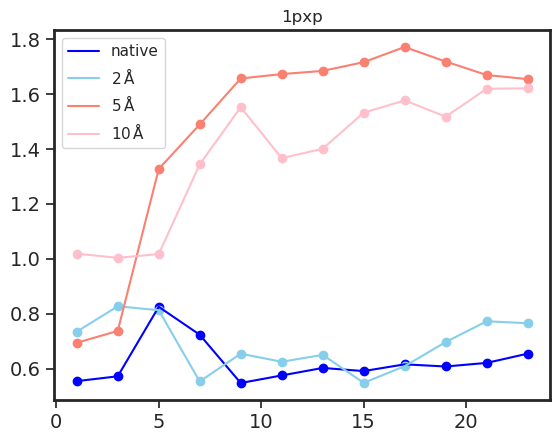

 54%|█████▍    | 54/100 [00:08<00:08,  5.60it/s]

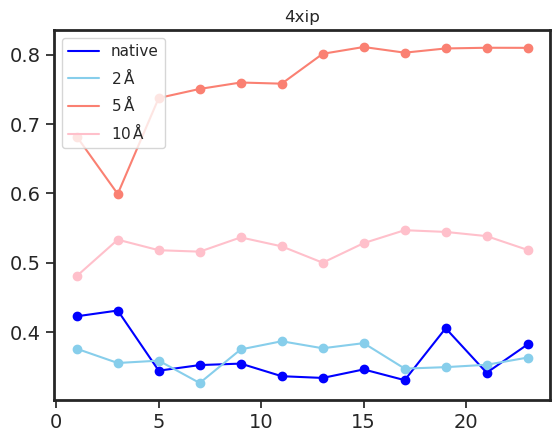

 55%|█████▌    | 55/100 [00:08<00:07,  5.93it/s]

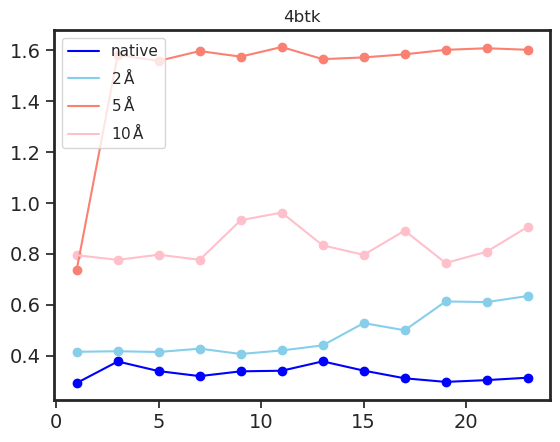

 56%|█████▌    | 56/100 [00:09<00:07,  6.13it/s]

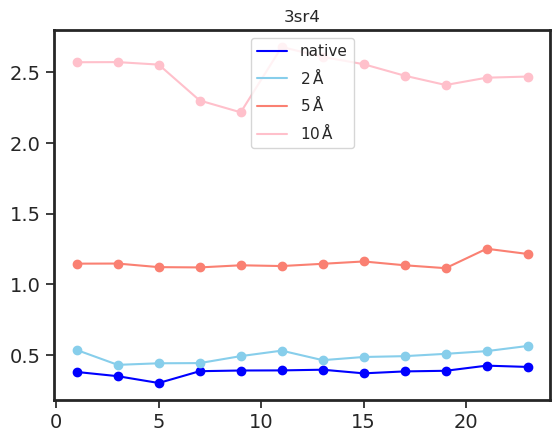

 57%|█████▋    | 57/100 [00:09<00:06,  6.35it/s]

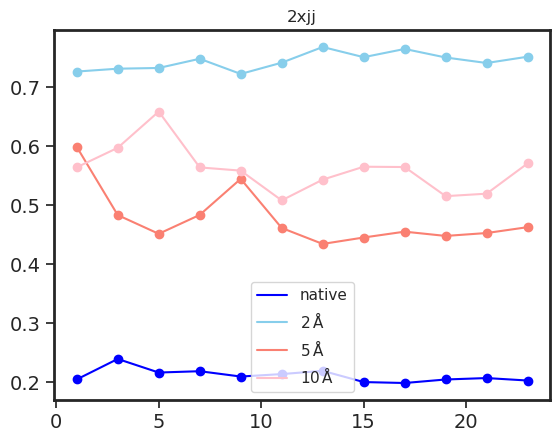

 58%|█████▊    | 58/100 [00:09<00:06,  6.46it/s]

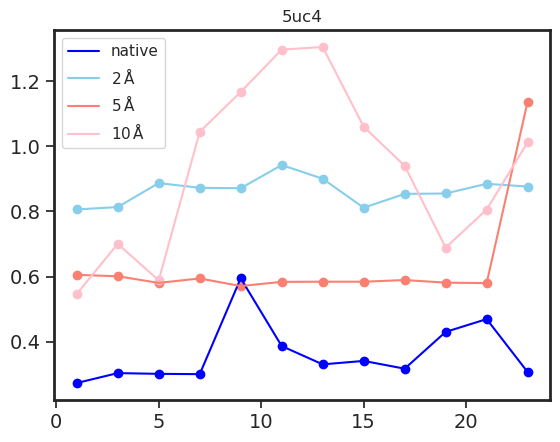

 59%|█████▉    | 59/100 [00:09<00:06,  6.52it/s]

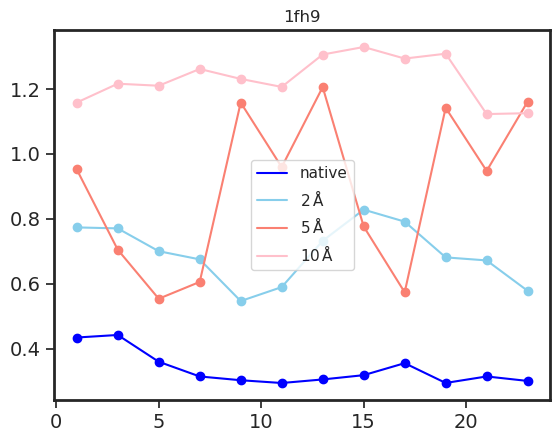

 60%|██████    | 60/100 [00:09<00:06,  6.55it/s]

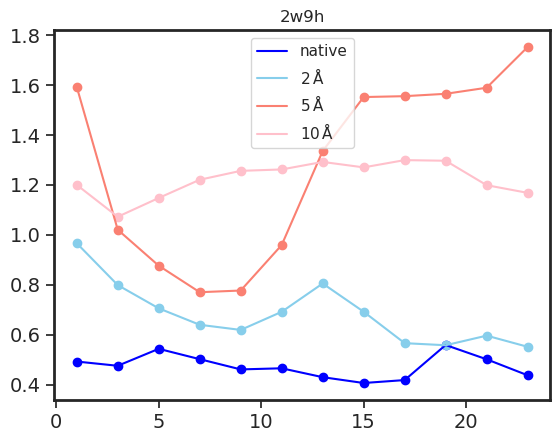

 61%|██████    | 61/100 [00:09<00:05,  6.52it/s]

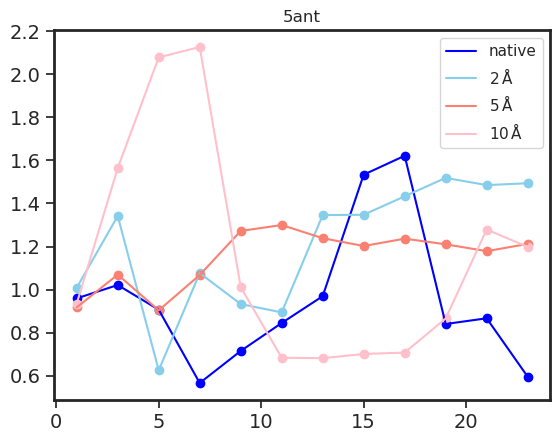

 62%|██████▏   | 62/100 [00:09<00:05,  6.58it/s]

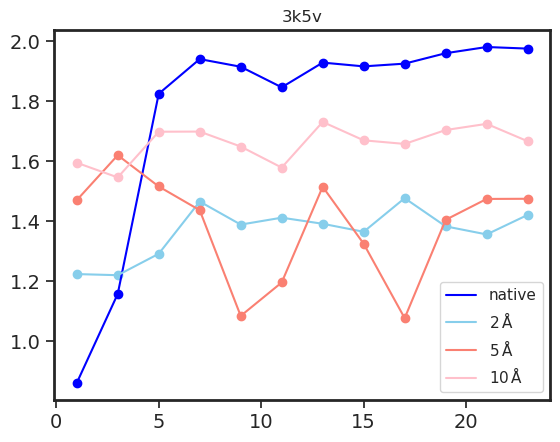

 63%|██████▎   | 63/100 [00:10<00:05,  6.67it/s]

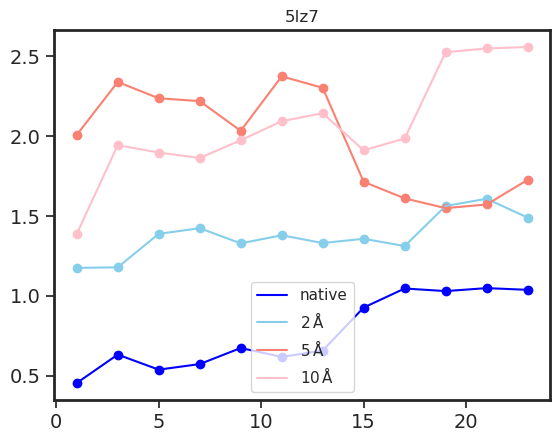

 64%|██████▍   | 64/100 [00:10<00:05,  6.71it/s]

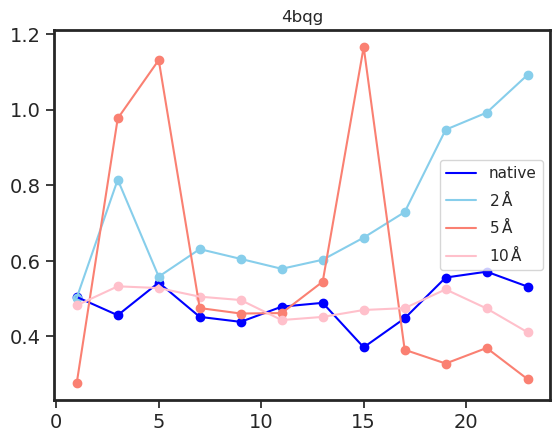

 65%|██████▌   | 65/100 [00:10<00:05,  6.77it/s]

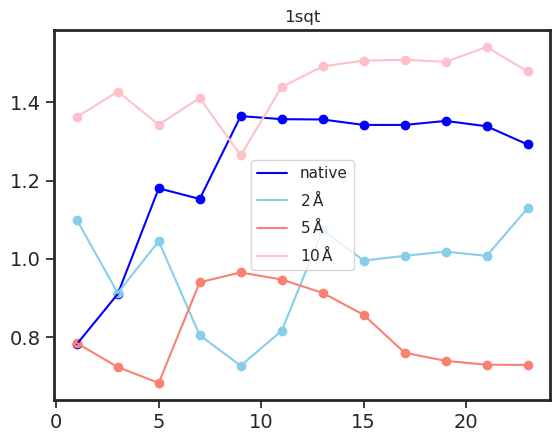

 66%|██████▌   | 66/100 [00:10<00:04,  6.81it/s]

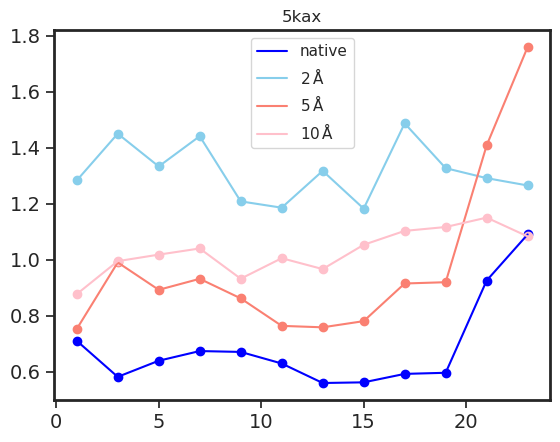

 67%|██████▋   | 67/100 [00:10<00:04,  6.75it/s]

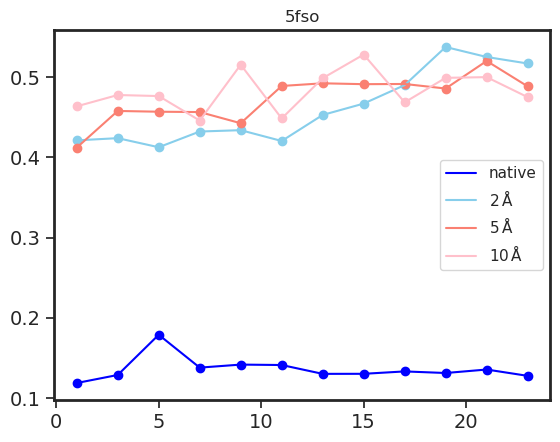

 68%|██████▊   | 68/100 [00:10<00:04,  6.85it/s]

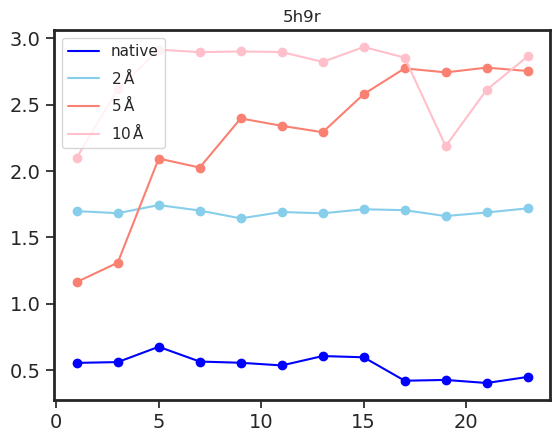

 69%|██████▉   | 69/100 [00:10<00:04,  6.82it/s]

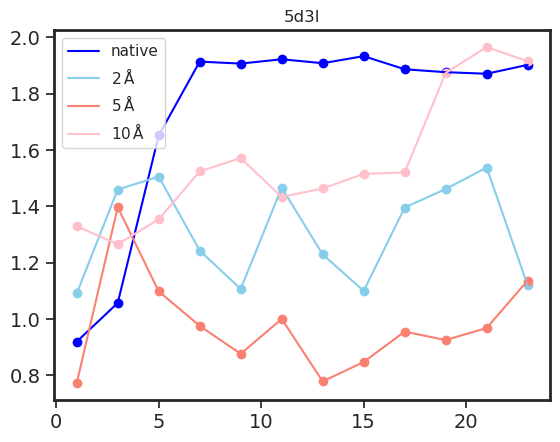

 70%|███████   | 70/100 [00:11<00:05,  5.03it/s]

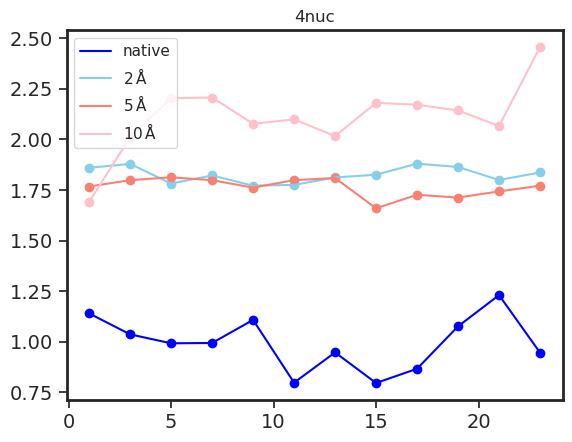

 71%|███████   | 71/100 [00:11<00:05,  5.35it/s]

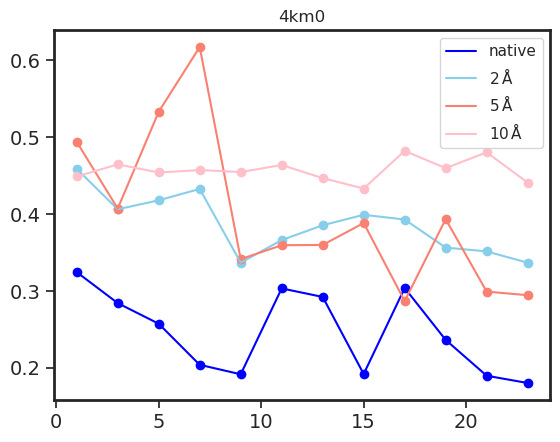

 72%|███████▏  | 72/100 [00:11<00:04,  5.79it/s]

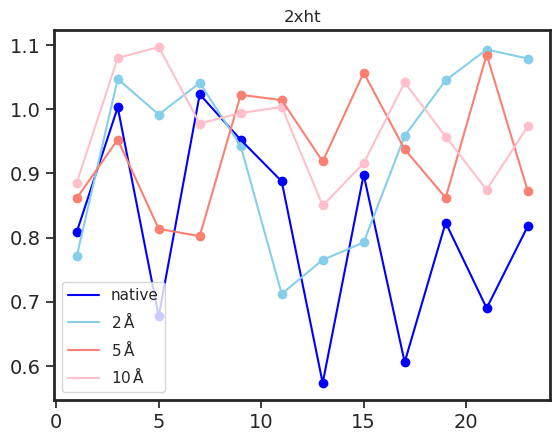

 73%|███████▎  | 73/100 [00:11<00:04,  6.00it/s]

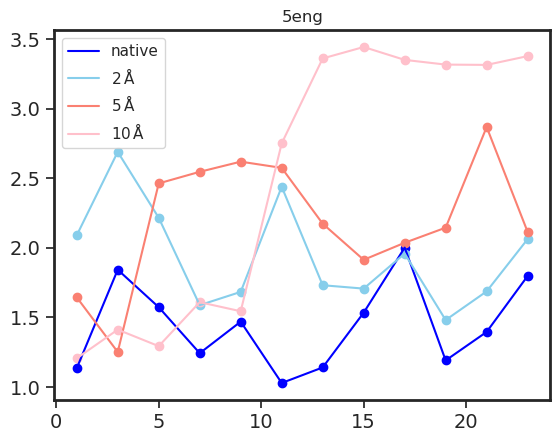

 74%|███████▍  | 74/100 [00:11<00:04,  6.27it/s]

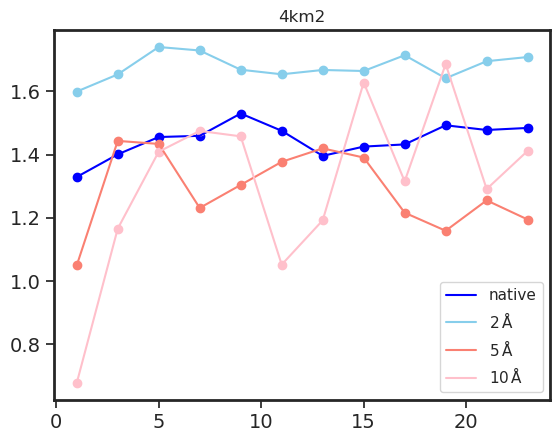

 75%|███████▌  | 75/100 [00:11<00:03,  6.49it/s]

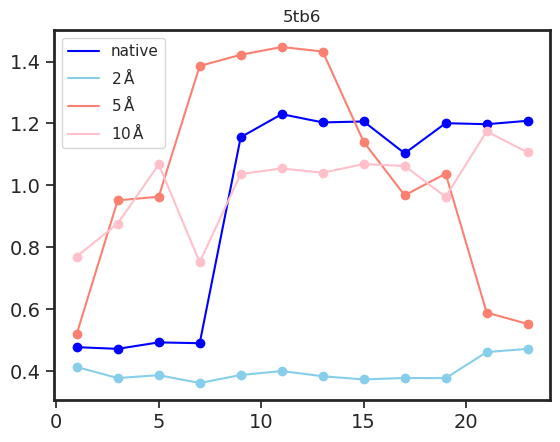

 76%|███████▌  | 76/100 [00:12<00:03,  6.65it/s]

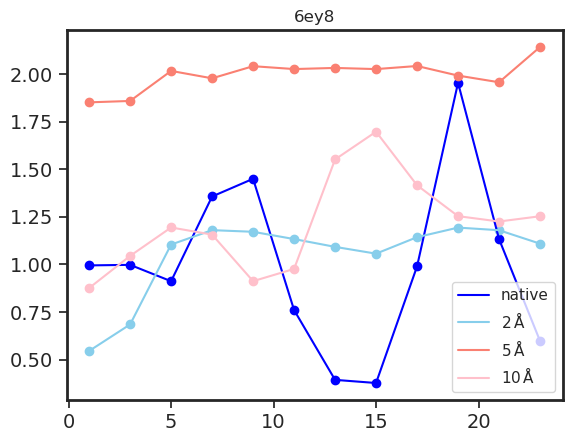

 77%|███████▋  | 77/100 [00:12<00:03,  6.62it/s]

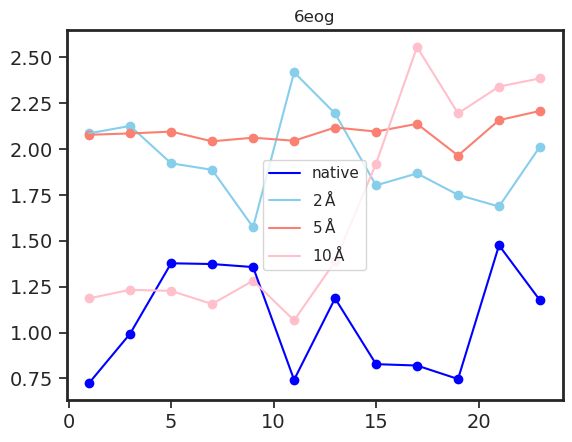

 78%|███████▊  | 78/100 [00:12<00:03,  6.56it/s]

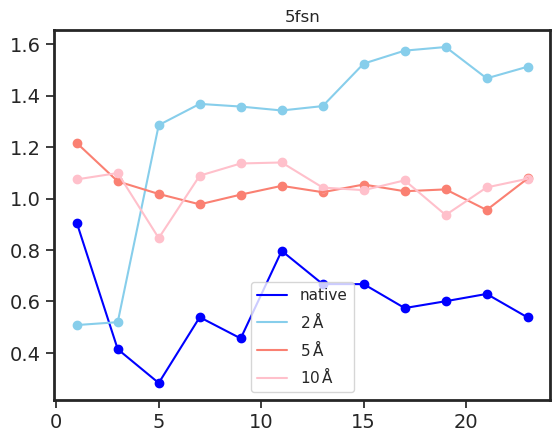

 79%|███████▉  | 79/100 [00:12<00:03,  6.57it/s]

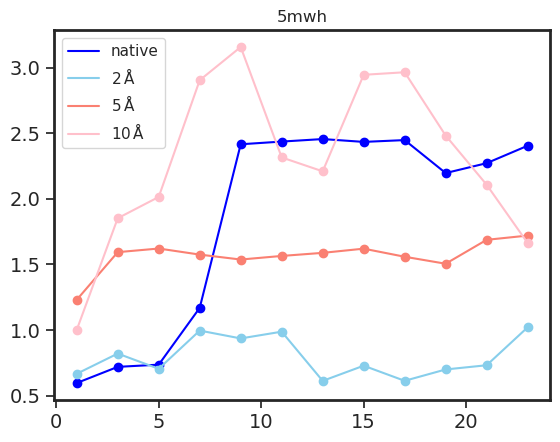

 80%|████████  | 80/100 [00:12<00:02,  6.71it/s]

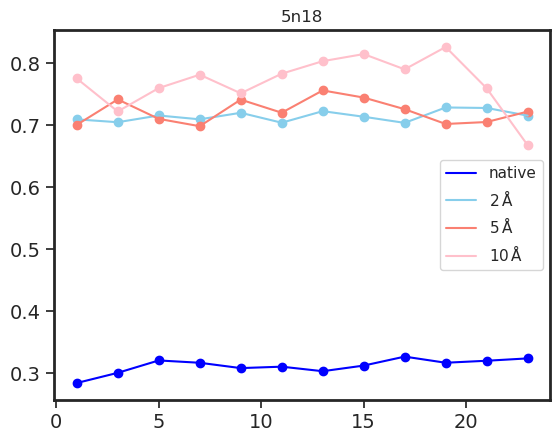

 81%|████████  | 81/100 [00:12<00:02,  6.81it/s]

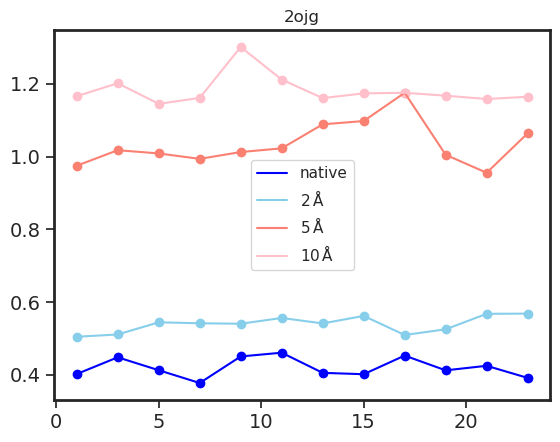

 82%|████████▏ | 82/100 [00:13<00:02,  6.84it/s]

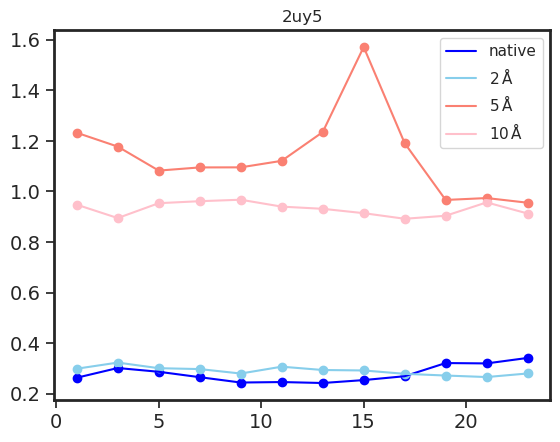

 83%|████████▎ | 83/100 [00:13<00:02,  6.89it/s]

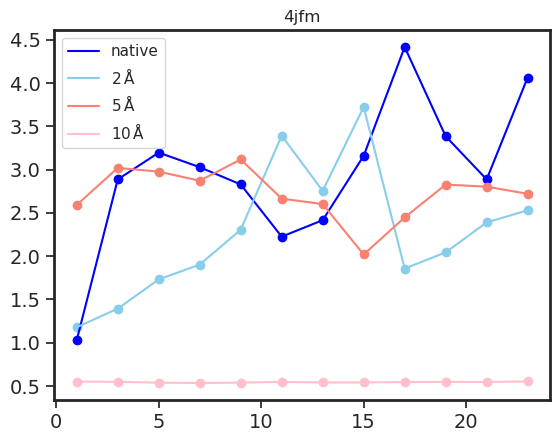

 84%|████████▍ | 84/100 [00:13<00:02,  6.86it/s]

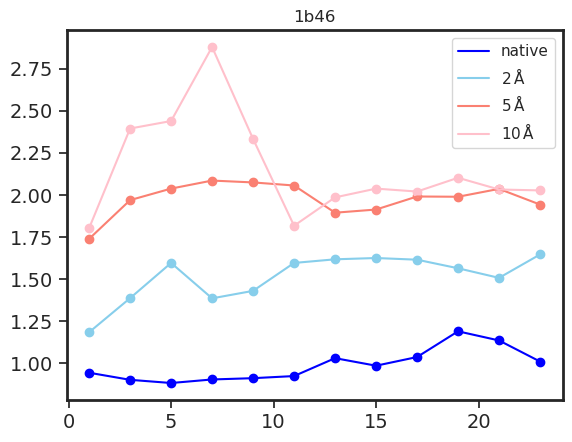

 85%|████████▌ | 85/100 [00:13<00:02,  6.89it/s]

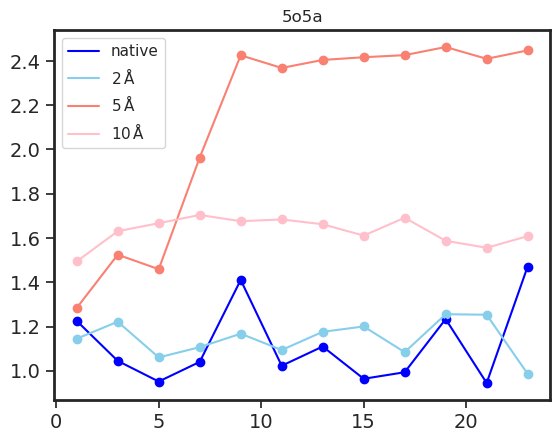

 86%|████████▌ | 86/100 [00:13<00:02,  6.89it/s]

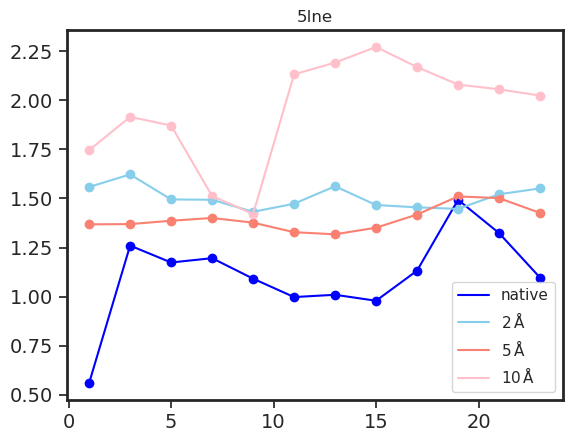

 87%|████████▋ | 87/100 [00:13<00:02,  5.18it/s]

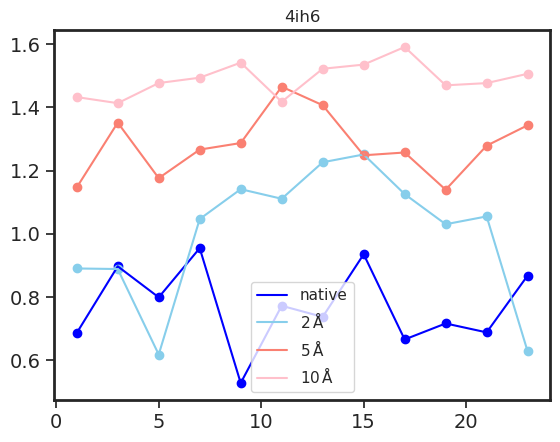

 88%|████████▊ | 88/100 [00:14<00:02,  5.55it/s]

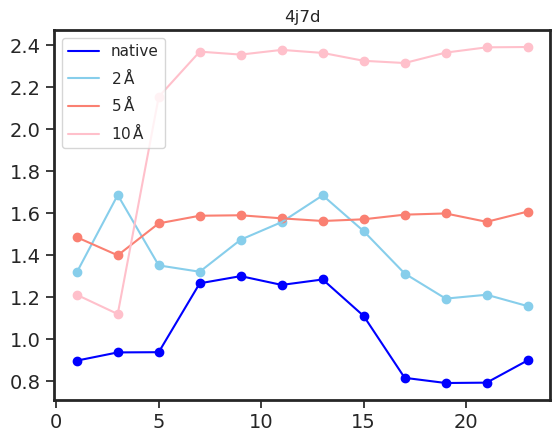

 89%|████████▉ | 89/100 [00:14<00:01,  5.79it/s]

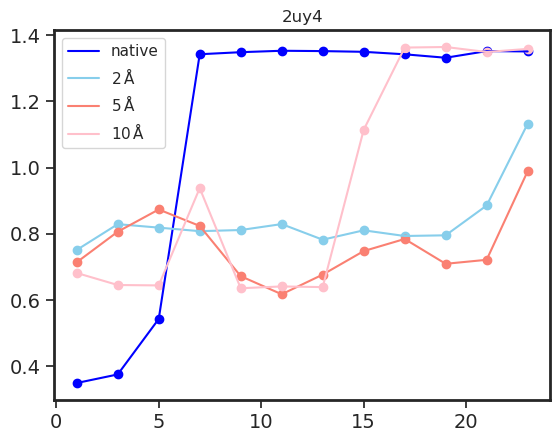

 90%|█████████ | 90/100 [00:14<00:01,  6.12it/s]

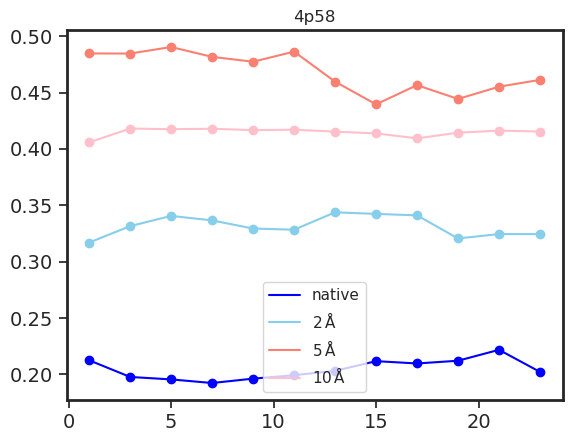

 91%|█████████ | 91/100 [00:14<00:01,  6.27it/s]

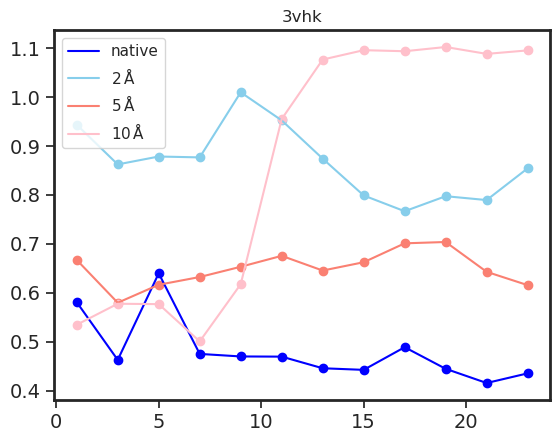

 92%|█████████▏| 92/100 [00:14<00:01,  6.33it/s]

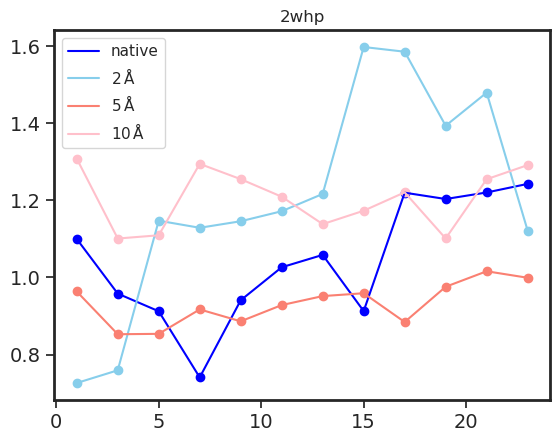

 93%|█████████▎| 93/100 [00:14<00:01,  6.56it/s]

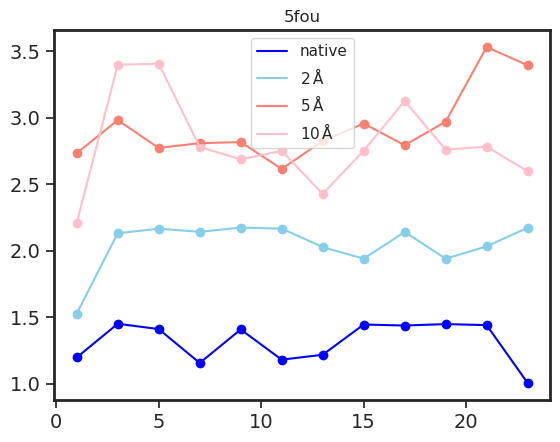

 94%|█████████▍| 94/100 [00:14<00:00,  6.60it/s]

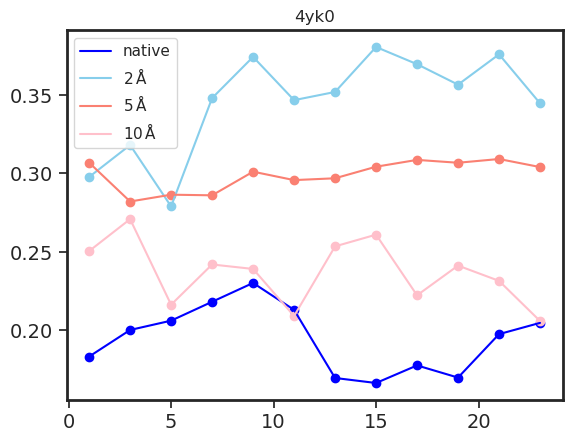

 95%|█████████▌| 95/100 [00:15<00:00,  6.68it/s]

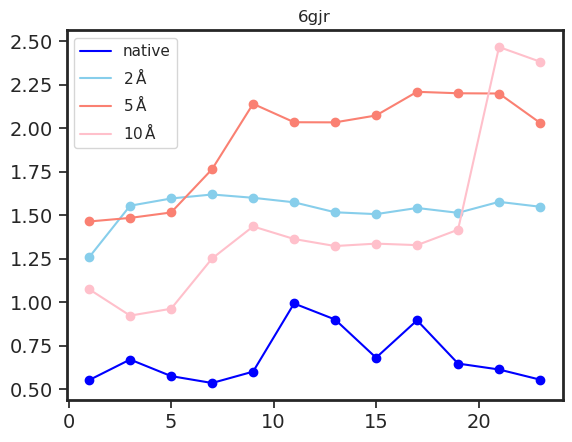

 96%|█████████▌| 96/100 [00:15<00:00,  6.70it/s]

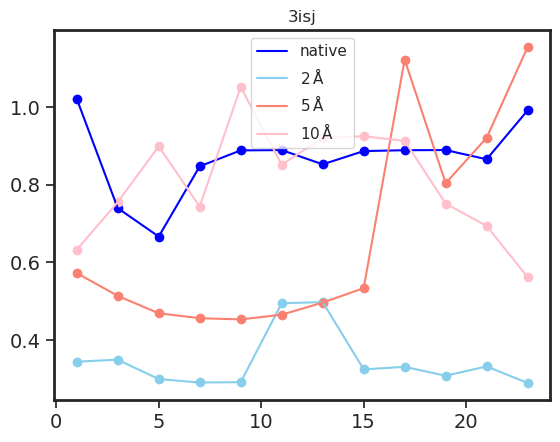

 97%|█████████▋| 97/100 [00:15<00:00,  6.75it/s]

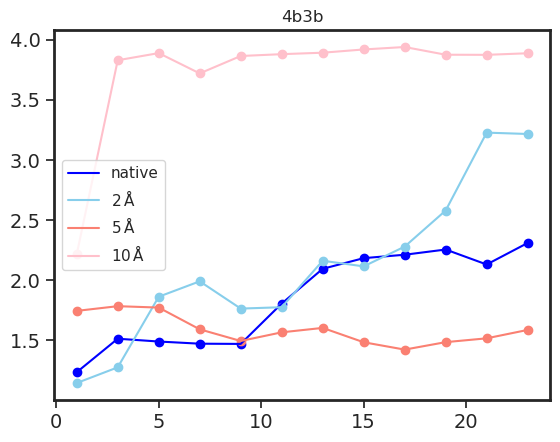

 98%|█████████▊| 98/100 [00:15<00:00,  6.74it/s]

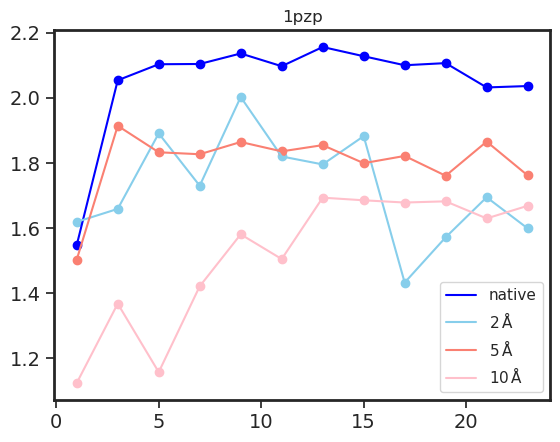

 99%|█████████▉| 99/100 [00:15<00:00,  6.82it/s]

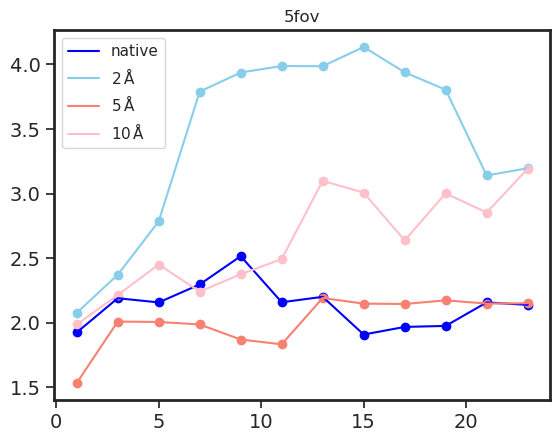

100%|██████████| 100/100 [00:15<00:00,  6.32it/s]


In [95]:
num_periods=12
x=[i*2+1 for i in range(num_periods)]

for i in tqdm(range(len(rmsd_12_data))):
       
        aa_native_cols=['native_%d' % num for num in range(num_periods)]
        aa_native_values=rmsd_12_data[rmsd_12_data['pdbid']==rmsd_12_data['pdbid'][i]][aa_native_cols].values[0]
        f_native, = plt.plot(x, aa_native_values,color=color_native)
        plt.scatter(x, aa_native_values,c=color_native)
        
        aa_2a_cols=['2a_%d' % num for num in range(num_periods)]
        aa_2a_values=rmsd_12_data[rmsd_12_data['pdbid']==rmsd_12_data['pdbid'][i]][aa_2a_cols].values[0]
        f_2a, = plt.plot(x, aa_2a_values,color=color_2a)  
        plt.scatter(x, aa_2a_values,c=color_2a) 
        
        aa_5a_cols=['5a_%d' % num for num in range(num_periods)]
        aa_5a_values=rmsd_12_data[rmsd_12_data['pdbid']==rmsd_12_data['pdbid'][i]][aa_5a_cols].values[0]
        f_5a, = plt.plot(x, aa_5a_values,color=color_5a)
        plt.scatter(x, aa_5a_values,c=color_5a)
        
        aa_10a_cols=['10a_%d' % num for num in range(num_periods)]
        aa_10a_values=rmsd_12_data[rmsd_12_data['pdbid']==rmsd_12_data['pdbid'][i]][aa_10a_cols].values[0]
        f_10a, = plt.plot(x, aa_10a_values,color=color_10a)
        plt.scatter(x, aa_10a_values,c=color_10a)
        plt.title(rmsd_12_data['pdbid'][i])
        
        plt.legend(handles=[f_native,f_2a,f_5a,f_10a],labels=['native','$2\,\mathrm{\AA}$','$5\,\mathrm{\AA}$','$10\,\mathrm{\AA}$'],loc='best')
        
        
        plt.show()


## mean, stand deviation,max, min

In [98]:
quality=['mean','std','max','min','median']

for id in tqdm(quality) :
    rmsd_12_data.loc[:, 'native_%s' % id]=np.nan
    rmsd_12_data.loc[:, '2a_%s' % id]=np.nan
    rmsd_12_data.loc[:, '5a_%s' % id]=np.nan
    rmsd_12_data.loc[:, '10a_%s' % id]=np.nan

100%|██████████| 5/5 [00:00<00:00, 742.75it/s]


In [99]:


for i in tqdm(range(len(rmsd_12_data))):

        bb_native_cols=['native_%d' % j for j in range(12)]
        bb_native_values_T=rmsd_12_data[rmsd_12_data['pdbid']==rmsd_12_data['pdbid'][i]][bb_native_cols].T
        native_ana_col=['native_%s' % j for j in quality]
        rmsd_12_data.loc[i,native_ana_col]=[bb_native_values_T.mean().values[0],bb_native_values_T.std().values[0],bb_native_values_T.max().values[0],bb_native_values_T.min().values[0],bb_native_values_T.median().values[0]]



        bb_2a_cols=['2a_%d' % j for j in range(12)]
        bb_2a_values_T=rmsd_12_data[rmsd_12_data['pdbid']==rmsd_12_data['pdbid'][i]][bb_2a_cols].T
        bb_2a_ana_col=['2a_%s' % j for j in quality]
        rmsd_12_data.loc[i,bb_2a_ana_col]=bb_2a_values_T.mean().values[0],bb_2a_values_T.std().values[0],bb_2a_values_T.max().values[0],bb_2a_values_T.min().values[0],bb_2a_values_T.median().values[0]




        bb_5a_cols=['5a_%d' % j for j in range(12)]
        bb_5a_values_T=rmsd_12_data[rmsd_12_data['pdbid']==rmsd_12_data['pdbid'][i]][bb_5a_cols].T
        bb_5a_ana_col=['5a_%s' % j for j in quality]
        rmsd_12_data.loc[i,bb_5a_ana_col]=bb_5a_values_T.mean().values[0],bb_5a_values_T.std().values[0],bb_5a_values_T.max().values[0],bb_5a_values_T.min().values[0],bb_5a_values_T.median().values[0]





        bb_10a_cols=['10a_%d' % j for j in range(12)]
        bb_10a_values_T=rmsd_12_data[rmsd_12_data['pdbid']==rmsd_12_data['pdbid'][i]][bb_10a_cols].T
        bb_10a_ana_col=['10a_%s' % j for j in quality]
        rmsd_12_data.loc[i,bb_10a_ana_col]=bb_10a_values_T.mean().values[0],bb_10a_values_T.std().values[0],bb_10a_values_T.max().values[0],bb_10a_values_T.min().values[0],bb_10a_values_T.median().values[0]





100%|██████████| 100/100 [00:01<00:00, 91.98it/s]


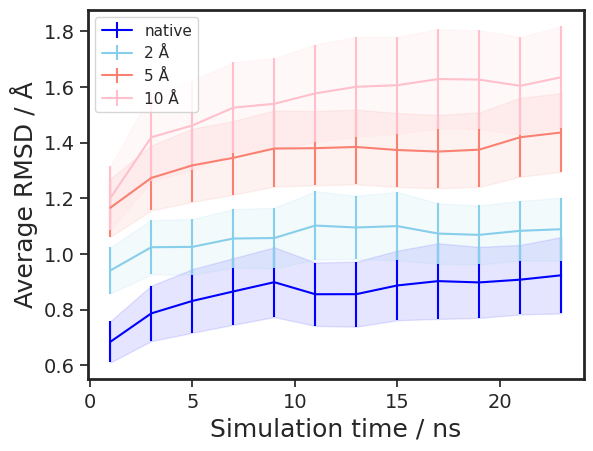

In [104]:
num_periods=12
y=[i*2+1 for i in range(num_periods)]

f_native=plt.errorbar(y,mean:=rmsd_12_data[bb_native_cols].mean(), yerr=(err:=rmsd_12_data[bb_native_cols].std()*0.2),c=color_native)
plt.fill_between(y,mean-err, mean+err, color=color_native, alpha=.1)
f_2a=plt.errorbar(y,mean:=rmsd_12_data[bb_2a_cols].mean(),yerr=(err:=rmsd_12_data[bb_2a_cols].std()*0.2),c=color_2a)
plt.fill_between(y,mean-err, mean+err, color=color_2a, alpha=.1)
f_5a=plt.errorbar(y,mean:=rmsd_12_data[bb_5a_cols].mean(),yerr=(err:=rmsd_12_data[bb_5a_cols].std()*0.2),c=color_5a)
plt.fill_between(y,mean-err, mean+err, color=color_5a, alpha=.1)
f_10a=plt.errorbar(y,mean:=rmsd_12_data[bb_10a_cols].mean(),yerr=(err:=rmsd_12_data[bb_10a_cols].std()*0.2),c=color_10a)
plt.fill_between(y,mean-err, mean+err, color=color_10a, alpha=.1)
# plt.title('RMSD_Mean')
# plt.xlim(x_min_scatter,x_max_scatter)
plt.legend(handles=[f_native,f_2a,f_5a,f_10a],labels=['native','2 Å','5 Å','10 Å'],loc='best')
# plt.ylim(y_min_scatter,y_max_scatter)
plt.xlabel('Simulation time / ns')
plt.ylabel('Average RMSD / Å')

plt.show()

### Distribution of mean, std, max, mean

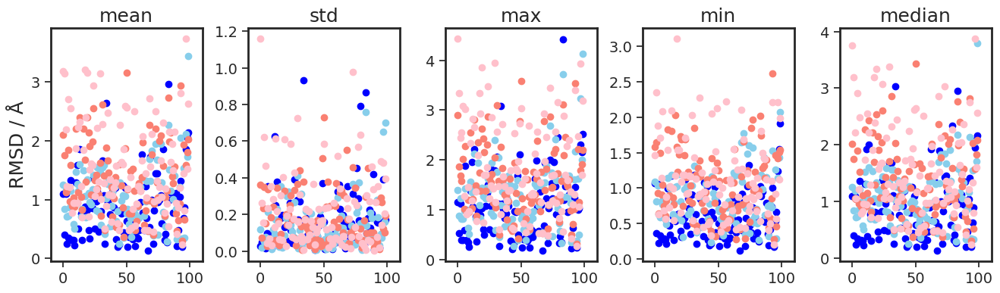

In [167]:
x_asix=[i for i in range(len(rmsd_12_data))]
plt.figure(figsize=(16,4))
mpl.rcParams['axes.linewidth']=2

mpl.rcParams['xtick.labelsize']=14
mpl.rcParams['ytick.labelsize']=14


mpl.rcParams['axes.labelsize']=18

for i,j in enumerate(quality):
    plt.subplot(1,5,i+1)
    if i==0:
        plt.ylabel('RMSD / Å', fontsize=18)
    plt.scatter(x_asix,rmsd_12_data['native_%s' % quality[i]],c=color_native)
    plt.scatter(x_asix,rmsd_12_data['2a_%s' % quality[i]],c=color_2a)
    plt.scatter(x_asix,rmsd_12_data['5a_%s' % quality[i]],c=color_5a)
    plt.scatter(x_asix,rmsd_12_data['10a_%s' % quality[i]],c=color_10a)
    plt.title(quality[i],fontsize=18)
    plt.xlim(-10, 110)

    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)

    
plt.subplots_adjust(wspace=0.3, hspace=0.3)

plt.savefig('rmsd_last_5ns_mean_std_max.pdf',bbox_inches='tight')

plt.show()


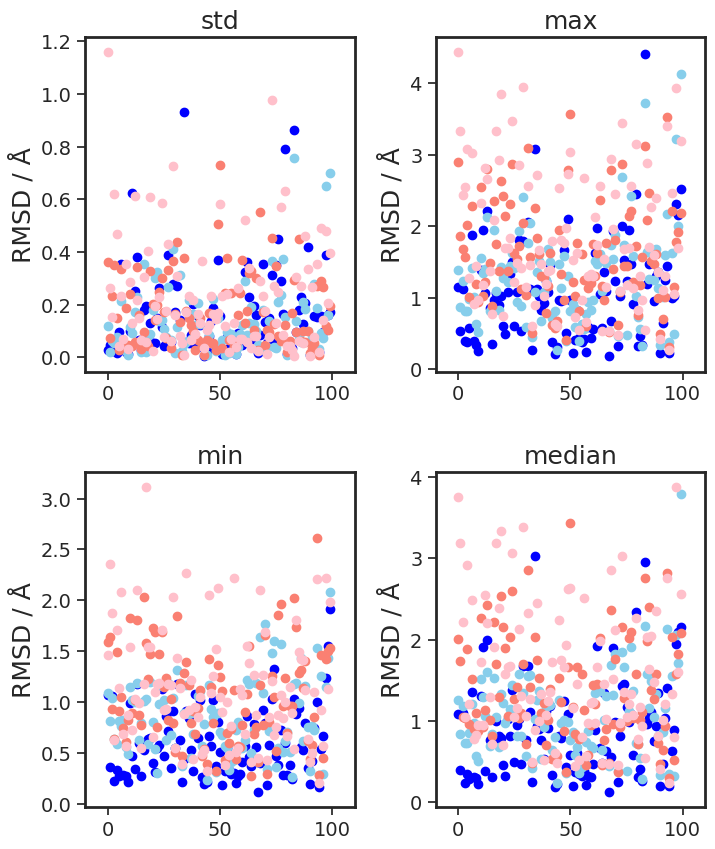

In [179]:
x_asix=[i for i in range(len(rmsd_12_data))]
plt.figure(figsize=(8,10))
mpl.rcParams['axes.linewidth']=2

mpl.rcParams['xtick.labelsize']=14
mpl.rcParams['ytick.labelsize']=14


mpl.rcParams['axes.labelsize']=18

for i,j in enumerate(quality[1:]):
    plt.subplot(2,2,i+1)
   
    plt.ylabel('RMSD / Å', fontsize=18)
    plt.scatter(x_asix,rmsd_12_data['native_%s' % quality[i+1]],c=color_native)
    plt.scatter(x_asix,rmsd_12_data['2a_%s' % quality[i+1]],c=color_2a)
    plt.scatter(x_asix,rmsd_12_data['5a_%s' % quality[i+1]],c=color_5a)
    plt.scatter(x_asix,rmsd_12_data['10a_%s' % quality[i+1]],c=color_10a)
    plt.title(quality[i+1],fontsize=18)
    plt.xlim(-10, 110)

    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)

    
plt.subplots_adjust(wspace=0.3, hspace=0.3)

plt.savefig('rmsd_last_5ns_mean_std_max.pdf',bbox_inches='tight')

plt.show()


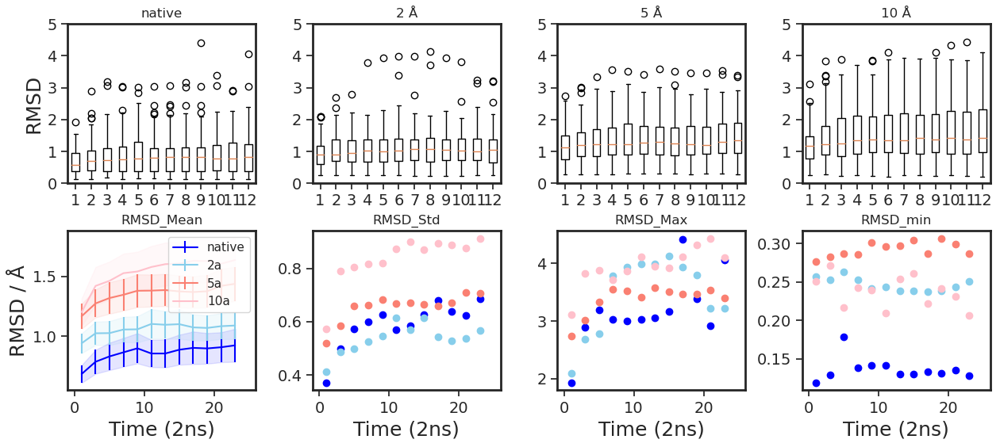

In [113]:


plt.figure(figsize=(15,6))

interval_num=12
y=[i*2+1 for i in range(interval_num)]
y_min=0
y_max=5
y_min_scatter=0
y_max_scatter=10
x_min_scatter=-1
x_max_scatter=26


plt.subplot(2,4,1)
bb_native_cols=['native_%d' % j for j in range(interval_num)]
plt.boxplot(rmsd_12_data[bb_native_cols])
plt.title('native')
plt.ylim(y_min,y_max)
plt.ylabel('RMSD')

plt.subplot(2,4,5)
# f_native=plt.scatter(y,rmsd_12_data[bb_native_cols].mean(),c=color_native)
f_native=plt.errorbar(y,mean:=rmsd_12_data[bb_native_cols].mean(), yerr=(err:=rmsd_12_data[bb_native_cols].std()*0.2),c=color_native)
plt.fill_between(y,mean-err, mean+err, color=color_native, alpha=.1)
f_2a=plt.errorbar(y,mean:=rmsd_12_data[bb_2a_cols].mean(),yerr=(err:=rmsd_12_data[bb_2a_cols].std()*0.2),c=color_2a)
plt.fill_between(y,mean-err, mean+err, color=color_2a, alpha=.1)
f_5a=plt.errorbar(y,mean:=rmsd_12_data[bb_5a_cols].mean(),yerr=(err:=rmsd_12_data[bb_5a_cols].std()*0.2),c=color_5a)
plt.fill_between(y,mean-err, mean+err, color=color_5a, alpha=.1)
f_10a=plt.errorbar(y,mean:=rmsd_12_data[bb_10a_cols].mean(),yerr=(err:=rmsd_12_data[bb_10a_cols].std()*0.2), elinewidth=0, c=color_10a)
plt.fill_between(y,mean-err, mean+err, color=color_10a, alpha=.1)
plt.title('RMSD_Mean')
plt.xlim(x_min_scatter,x_max_scatter)
plt.legend(handles=[f_native,f_2a,f_5a,f_10a],labels=['native','2a','5a','10a'],loc='best')
# plt.ylim(y_min_scatter,y_max_scatter)
plt.xlabel('Time (2ns)')
plt.ylabel('RMSD / Å')

plt.subplot(2,4,2)
bb_2a_cols=['2a_%d' % j for j in range(interval_num)]
plt.boxplot(rmsd_12_data[bb_2a_cols])
plt.title('2 Å')
plt.ylim(y_min,y_max)

plt.subplot(2,4,6)
plt.scatter(y,rmsd_12_data[bb_native_cols].std(),c=color_native)
plt.scatter(y,rmsd_12_data[bb_2a_cols].std(),c=color_2a)
plt.scatter(y,rmsd_12_data[bb_5a_cols].std(),c=color_5a)
plt.scatter(y,rmsd_12_data[bb_10a_cols].std(),c=color_10a)
plt.title('RMSD_Std')
plt.xlim(x_min_scatter,x_max_scatter)
# plt.ylim(y_min_scatter,y_max_scatter)
plt.xlabel('Time (2ns)')

plt.subplot(2,4,3)
bb_5a_cols=['5a_%d' % j for j in range(interval_num)]
plt.boxplot(rmsd_12_data[bb_5a_cols])
plt.title('5 Å')
plt.ylim(y_min,y_max)

plt.subplot(2,4,7)
plt.scatter(y,rmsd_12_data[bb_native_cols].max(),c=color_native)
plt.scatter(y,rmsd_12_data[bb_2a_cols].max(),c=color_2a)
plt.scatter(y,rmsd_12_data[bb_5a_cols].max(),c=color_5a)
plt.scatter(y,rmsd_12_data[bb_10a_cols].max(),c=color_10a)
plt.title('RMSD_Max')
plt.xlim(x_min_scatter,x_max_scatter)
# plt.ylim(y_min_scatter,y_max_scatter)
plt.xlabel('Time (2ns)')



plt.subplot(2,4,4)
bb_10a_cols=['10a_%d' % j for j in range(interval_num)]
plt.boxplot(rmsd_12_data[bb_10a_cols])
plt.title('10 Å')
plt.ylim(y_min,y_max)


plt.subplot(2,4,8)
plt.scatter(y,rmsd_12_data[bb_native_cols].min(),c=color_native)
plt.scatter(y,rmsd_12_data[bb_2a_cols].min(),c=color_2a)
plt.scatter(y,rmsd_12_data[bb_5a_cols].min(),c=color_5a)
plt.scatter(y,rmsd_12_data[bb_10a_cols].min(),c=color_10a)
plt.title('RMSD_min')
plt.xlim(x_min_scatter,x_max_scatter)
# plt.ylim(y_min_scatter,y_max_scatter)

plt.xlabel('Time (2ns)')

plt.subplots_adjust(wspace=0.3,hspace=0.3)
# plt.savefig('rmsd_12time_std.png')


plt.show()


## Total rmsd analysis

In [114]:
def plot_rmsd_four_lig(pdbid):

    affinity = sel_100_data.loc[sel_100_data['pdbid'] ==
                                pdbid]['affinity(-logkd)'].values[0]

    x_native = rmsd_plot(path_native + pdbid + 'MD2_neu/new_rmsd_lig.agr')
    x_2a = rmsd_plot(path_2a + pdbid + 'MD_neu_2a/new_rmsd_lig.agr')
    x_5a = rmsd_plot(path_5a + pdbid + 'MD_neu_5a/new_rmsd_lig.agr')
    x_10a = rmsd_plot(path_10a + pdbid + 'MD_neu_10a/new_rmsd_lig.agr')
    sel_native, = plt.plot(x_native[:, 0]/500, x_native[:, 1], color_native)
    sel_2a, = plt.plot(x_2a[:, 0]/500, x_2a[:, 1], color_2a)
    sel_5a, = plt.plot(x_5a[:, 0]/500, x_5a[:, 1], color_5a)
    sel_10a, = plt.plot(x_10a[:, 0]/500, x_10a[:, 1], color_10a)
    plt.ylim(0, 6)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.legend(handles=[sel_native, sel_2a, sel_5a, sel_10a],
               labels=['native','$2\,\mathrm{\AA}$','$5\,\mathrm{\AA}$','$10\,\mathrm{\AA}$'],
               loc='best')
#     plt.title(pdbid + '_lig_' + str(affinity))
    plt.text(10,5.5,pdbid + '_lig_' + str(affinity),fontsize=18)
    plt.xlabel('Simulation time / ns',fontsize=18)
    plt.ylabel('RMSD / Å', fontsize=18)



#### RMSD Total Fig 

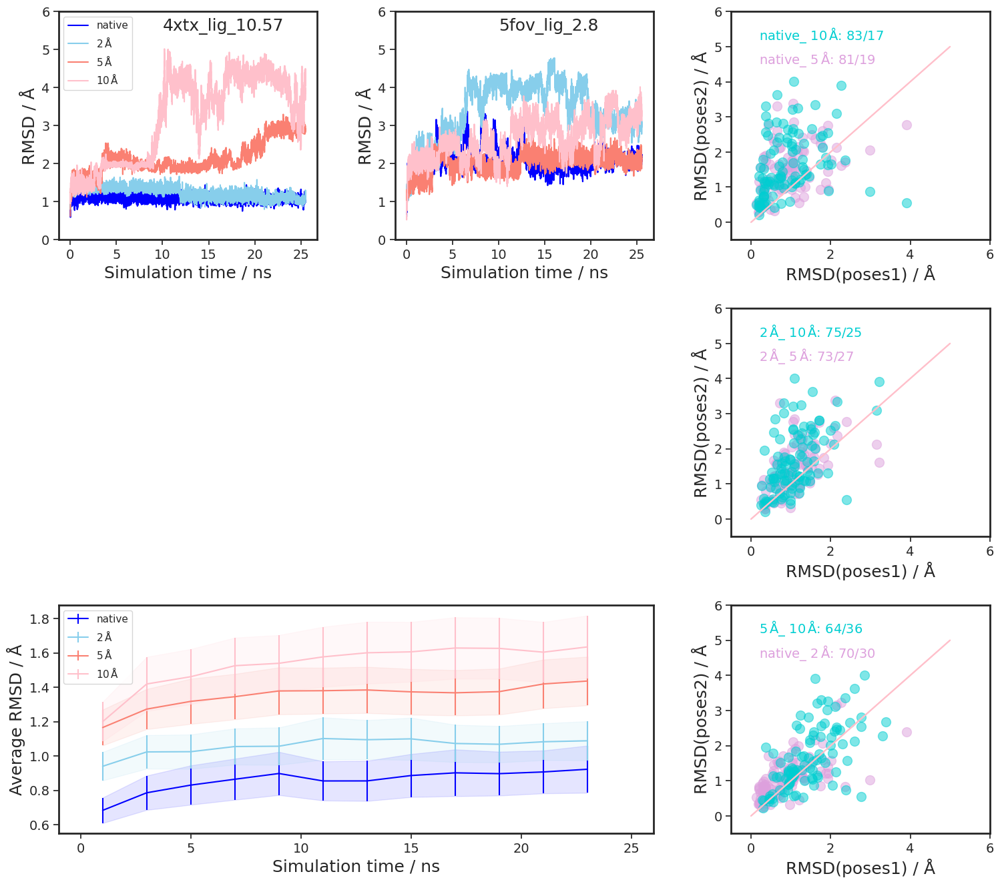

In [115]:
name1 = 'rmsd_5ns_native'
name2 = 'rmsd_5ns_2a'
name3 = 'rmsd_5ns_5a'
name4 = 'rmsd_5ns_10a'
labelx = 0.2
labely = 4.5

# plt.figure(figsize=(15, 12))
plt.figure(figsize=(18, 16))

mpl.rcParams['axes.linewidth']=2

mpl.rcParams['xtick.labelsize']=14
mpl.rcParams['ytick.labelsize']=14


mpl.rcParams['axes.labelsize']=18


gs = gridspec.GridSpec(3, 3)

plt.subplot(gs[0, 0])

plot_rmsd_four_lig('4xtx')
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Simulation time / ns', fontsize=18)

plt.subplot(gs[0, 1])

plot_rmsd_four_lig('5fov')
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Simulation time / ns', fontsize=18)

plt.legend('', frameon=False)

plt.subplot(gs[0, 2])

plot_contrast_native(rmsd_last_five,
                     col1=name1,
                     col2=name3,
                     color_scatter='plum')
plt.text(labelx,
         labely,
         '%s_ %s: %d/%d' %
         (name1.split('_')[-1], name3.split('_')[-1].replace(
             'a', '$\,\mathrm{\AA}$'),
          len(rmsd_last_five[rmsd_last_five[name1] < rmsd_last_five[name3]]),
          len(rmsd_last_five[rmsd_last_five[name1] > rmsd_last_five[name3]])),
         fontsize=14,
         color='plum')

plot_contrast_native(rmsd_last_five,
                     col1=name1,
                     col2=name4,
                     color_scatter='darkturquoise')
plt.text(labelx,
         labely + 0.7,
         '%s_ %s: %d/%d' %
         (name1.split('_')[-1], name4.split('_')[-1].replace(
             'a', '$\,\mathrm{\AA}$'),
          len(rmsd_last_five[rmsd_last_five[name1] < rmsd_last_five[name4]]),
          len(rmsd_last_five[rmsd_last_five[name1] > rmsd_last_five[name4]])),
         fontsize=14,
         color='darkturquoise')

plt.xlabel('RMSD(poses1) / Å', fontsize=18)
plt.ylabel('RMSD(poses2) / Å', fontsize=18)


axes = plt.subplot(gs[1, 2])

# my_pal = {"rmsd_5ns_native": color_native, "rmsd_5ns_2a": color_2a, "rmsd_5ns_5a": color_5a, "rmsd_5ns_10a": color_10a}

# plt.ylabel('Averaged RMSD',fontsize=18)

# colors=[color_native,color_native,color_2a,color_2a,color_5a,color_5a,color_10a,color_10a]
# sns.set(style="ticks", color_codes=True)
# my_pal = {"rmsd_5ns_native": color_native, "rmsd_5ns_2a": color_2a, "rmsd_5ns_5a": color_5a, "rmsd_5ns_10a": color_10a}

# grid=sns.violinplot(data=rmsd_last_five,ax=axes,palette=my_pal,alpha=0.5)

# for i in range(len(grid.axes.collections)):
#     grid.axes.collections[i].set_edgecolor(colors[i])

# plt.xticks([i for i in range(4)], ['native','$2\,\mathrm{\AA}$','$5\,\mathrm{\AA}$','$10\,\mathrm{\AA}$'])

# plt.text(0,
#          5,
#          'Last 5ns',
#          fontsize=18)

plot_contrast_native(rmsd_last_five,
                     col1=name2,
                     col2=name3,
                     color_scatter='plum')
plt.text(labelx,
         labely,
         '%s_ %s: %d/%d' %
         (name2.split('_')[-1].replace('a', '$\,\mathrm{\AA}$'),
          name3.split('_')[-1].replace('a', '$\,\mathrm{\AA}$'),
          len(rmsd_last_five[rmsd_last_five[name2] < rmsd_last_five[name3]]),
          len(rmsd_last_five[rmsd_last_five[name2] > rmsd_last_five[name3]])),
         fontsize=14,
         color='plum')

plot_contrast_native(rmsd_last_five,
                     col1=name2,
                     col2=name4,
                     color_scatter='darkturquoise')
plt.text(labelx,
         labely + 0.7,
         '%s_ %s: %d/%d' %
         (name2.split('_')[-1].replace('a', '$\,\mathrm{\AA}$'),
          name4.split('_')[-1].replace('a', '$\,\mathrm{\AA}$'),
          len(rmsd_last_five[rmsd_last_five[name2] < rmsd_last_five[name4]]),
          len(rmsd_last_five[rmsd_last_five[name2] > rmsd_last_five[name4]])),
         fontsize=14,
         color='darkturquoise')

plt.xlabel('RMSD(poses1) / Å', fontsize=18)
plt.ylabel('RMSD(poses2) / Å', fontsize=18)


plt.subplot(gs[2, 2])

plot_contrast_native(rmsd_last_five,
                     col1=name1,
                     col2=name2,
                     color_scatter='plum')
plt.text(labelx,
         labely,
         '%s_ %s: %d/%d' %
         (name1.split('_')[-1], name2.split('_')[-1].replace(
             'a', '$\,\mathrm{\AA}$'),
          len(rmsd_last_five[rmsd_last_five[name1] < rmsd_last_five[name2]]),
          len(rmsd_last_five[rmsd_last_five[name1] > rmsd_last_five[name2]])),
         fontsize=14,
         color='plum')

plot_contrast_native(rmsd_last_five,
                     col1=name3,
                     col2=name4,
                     color_scatter='darkturquoise')
plt.text(labelx,
         labely + 0.7,
         '%s_ %s: %d/%d' %
         (name3.split('_')[-1].replace('a', '$\,\mathrm{\AA}$'),
          name4.split('_')[-1].replace('a', '$\,\mathrm{\AA}$'),
          len(rmsd_last_five[rmsd_last_five[name3] < rmsd_last_five[name4]]),
          len(rmsd_last_five[rmsd_last_five[name3] > rmsd_last_five[name4]])),
         fontsize=14,
         color='darkturquoise')

plt.xlabel('RMSD(poses1) / Å', fontsize=18)
plt.ylabel('RMSD(poses2) / Å', fontsize=18)

plt.subplot(gs[2, 0:2])

f_native = plt.errorbar(y,
                        mean := rmsd_12_data[bb_native_cols].mean(),
                        yerr=(err := rmsd_12_data[bb_native_cols].std() * 0.2),
                        c=color_native)
plt.fill_between(y, mean - err, mean + err, color=color_native, alpha=.1)
f_2a = plt.errorbar(y,
                    mean := rmsd_12_data[bb_2a_cols].mean(),
                    yerr=(err := rmsd_12_data[bb_2a_cols].std() * 0.2),
                    c=color_2a)
plt.fill_between(y, mean - err, mean + err, color=color_2a, alpha=.1)
f_5a = plt.errorbar(y,
                    mean := rmsd_12_data[bb_5a_cols].mean(),
                    yerr=(err := rmsd_12_data[bb_5a_cols].std() * 0.2),
                    c=color_5a)
plt.fill_between(y, mean - err, mean + err, color=color_5a, alpha=.1)
f_10a = plt.errorbar(y,
                     mean := rmsd_12_data[bb_10a_cols].mean(),
                     yerr=(err := rmsd_12_data[bb_10a_cols].std() * 0.2),
                     c=color_10a)
plt.fill_between(y, mean - err, mean + err, color=color_10a, alpha=.1)
# plt.title('RMSD_Mean')
plt.xlim(x_min_scatter, x_max_scatter)
plt.legend(handles=[f_native, f_2a, f_5a, f_10a],
           labels=[
               'native', '$2\,\mathrm{\AA}$', '$5\,\mathrm{\AA}$',
               '$10\,\mathrm{\AA}$'
           ],
           loc='best')
# plt.ylim(y_min_scatter,y_max_scatter)
plt.xlim(-1,26)
plt.xlabel('Simulation time / ns', fontsize=18)
plt.ylabel('Average RMSD / Å', fontsize=18)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

x_major_locator=MultipleLocator(5)
ax=plt.gca()
ax.xaxis.set_major_locator(x_major_locator)


plt.subplots_adjust(wspace=0.3, hspace=0.3)

plt.savefig('rmsd_last_5ns_3.pdf', bbox_inches='tight')

plt.savefig('rmsd_last_5ns_3.png', bbox_inches='tight')

plt.show()

# RMSF section

In [70]:
def plot_rmsf_four(pdbid):

    affinity = sel_100_data.loc[sel_100_data['pdbid'] ==
                                pdbid]['affinity(-logkd)'].values[0]

    plt.figure(figsize=(8, 3))
    plt.subplot(1, 2, 1)

    x_native = rmsd_plot(path_native + pdbid + 'MD2_neu/new_rmsf-ligand.agr')
    x_2a = rmsd_plot(path_2a + pdbid + 'MD_neu_2a/new_rmsf-ligand.agr')
    x_5a = rmsd_plot(path_5a + pdbid + 'MD_neu_5a/' + 'new_rmsf-ligand.agr')
    x_10a = rmsd_plot(path_10a + pdbid + 'MD_neu_10a/' + 'new_rmsf-ligand.agr')
    sel_native, = plt.plot([i+1 for i in range(len(x_native[:, 0]))], x_native[:, 1], color_native)
    sel_2a, = plt.plot(x_2a[:, 0], x_2a[:, 1], color_2a)
    sel_5a, = plt.plot(x_5a[:, 0], x_5a[:, 1], color_5a)
    sel_10a, = plt.plot(x_10a[:, 0], x_10a[:, 1], color_10a)
    plt.ylim(0, 30)
    plt.legend(handles=[sel_native, sel_2a, sel_5a, sel_10a],
               labels=['native', '2 Å', '5 Å', '10 Å'],
               loc='best',frameon=False)
    plt.title(pdbid + '_lig_' + str(affinity))
    plt.xlabel('Label of ligand atoms')
    plt.ylabel('RMSF')

    plt.subplot(1, 2, 2)
    y_pro_native = rmsd_plot(path_native + pdbid + 'MD2_neu/new_rmsf-pro.agr')
    y_pro_2a = rmsd_plot(path_2a + pdbid + 'MD_neu_2a/new_rmsf-pro.agr')
    y_pro_5a = rmsd_plot(path_5a + pdbid + 'MD_neu_5a/' + 'new_rmsf-pro.agr')
    y_pro_10a = rmsd_plot(path_10a + pdbid + 'MD_neu_10a/' +
                          'new_rmsf-pro.agr')
    y_sel_native, = plt.plot(y_pro_native[:, 0], y_pro_native[:, 1],
                             color_native)
    y_sel_2a, = plt.plot(y_pro_2a[:, 0], y_pro_2a[:, 1], color_2a)
    y_sel_5a, = plt.plot(y_pro_5a[:, 0], y_pro_5a[:, 1], color_5a)
    y_sel_10a, = plt.plot(y_pro_10a[:, 0], y_pro_10a[:, 1], color_10a)
    plt.ylim(0, 30)
    plt.legend(handles=[y_sel_native, y_sel_2a, y_sel_5a, y_sel_10a],
               labels=['native', '2 Å', '5 Å', '10 Å'],
               loc='best',frameon=False)
    plt.title(pdbid + '_pro_' + str(affinity))
    plt.xlabel('Label of protein residues')
    plt.ylabel('RMSF')
    plt.subplots_adjust(wspace=0.3, hspace=0.3)
#     plt.savefig('%s_si_rmsf.pdf' % pdbid ,bbox_inches='tight')
#     plt.show()

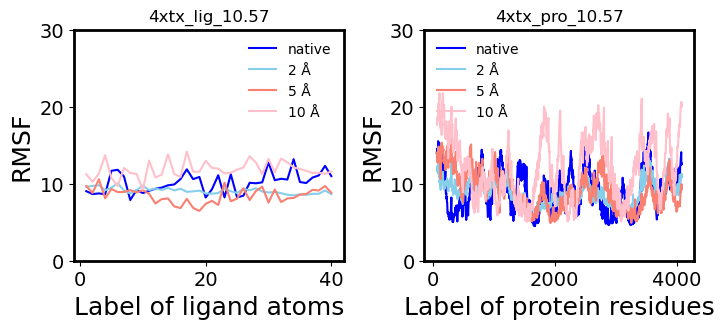

In [71]:
plot_rmsf_four('4xtx')
plt.savefig('4xtx_si_rmsf.pdf',bbox_inches='tight')
plt.show()

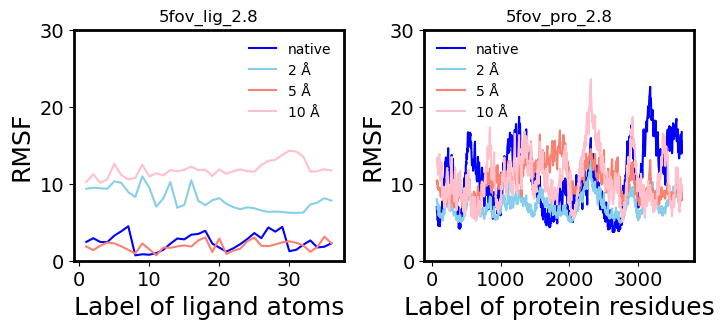

In [72]:
plot_rmsf_four('5fov')
plt.savefig('5fov_si_rmsf.pdf',bbox_inches='tight')
plt.show()

  0%|          | 0/100 [00:00<?, ?it/s]

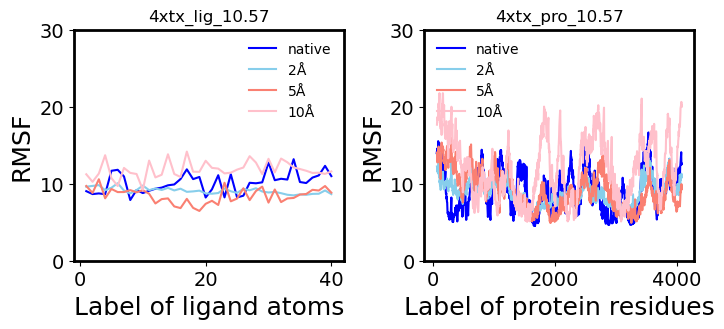

  1%|          | 1/100 [00:00<00:37,  2.64it/s]

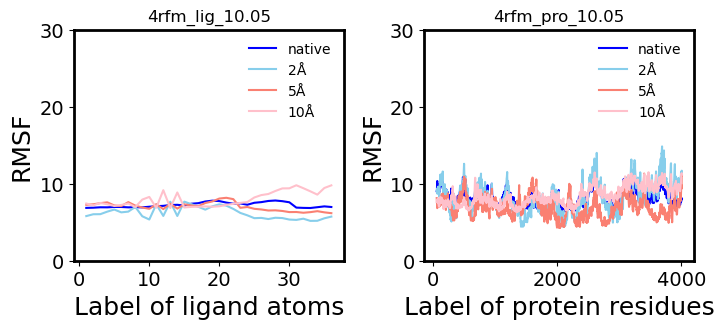

  2%|▏         | 2/100 [00:00<00:25,  3.92it/s]

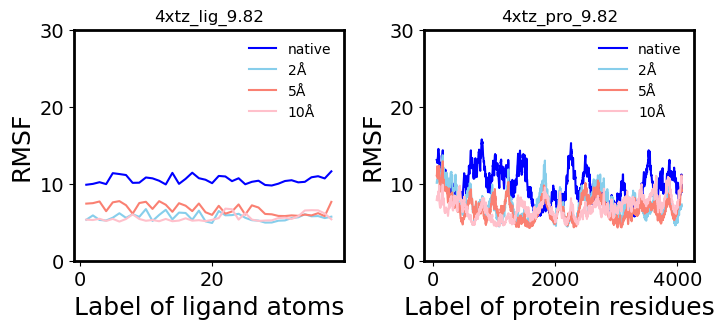

  3%|▎         | 3/100 [00:00<00:21,  4.52it/s]

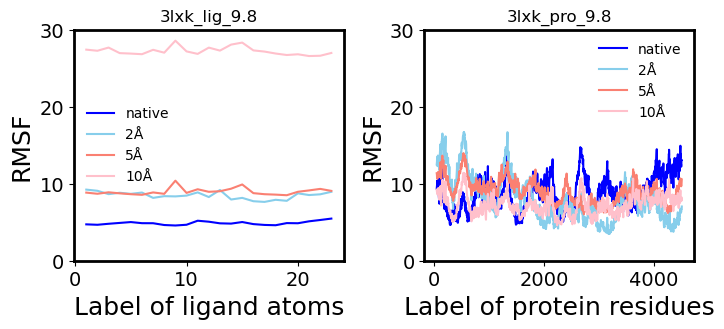

  4%|▍         | 4/100 [00:00<00:19,  4.94it/s]

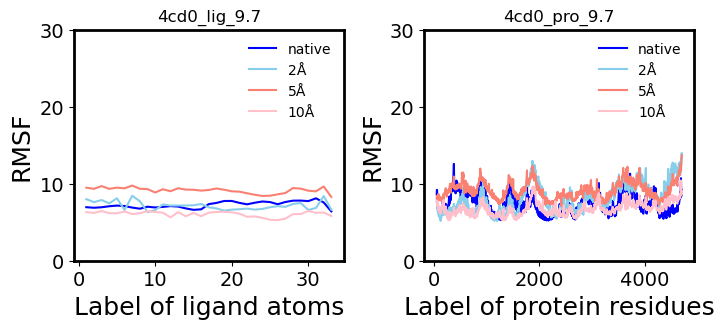

  5%|▌         | 5/100 [00:01<00:18,  5.26it/s]

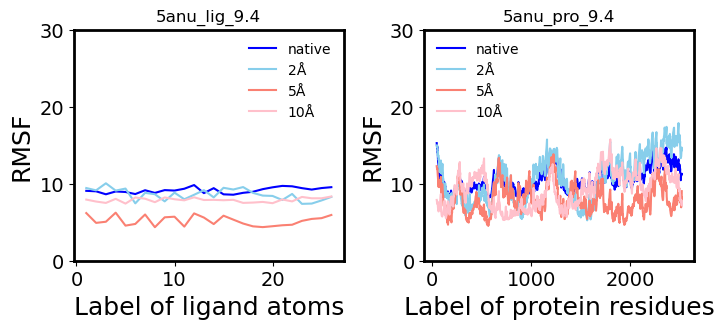

  6%|▌         | 6/100 [00:01<00:16,  5.55it/s]

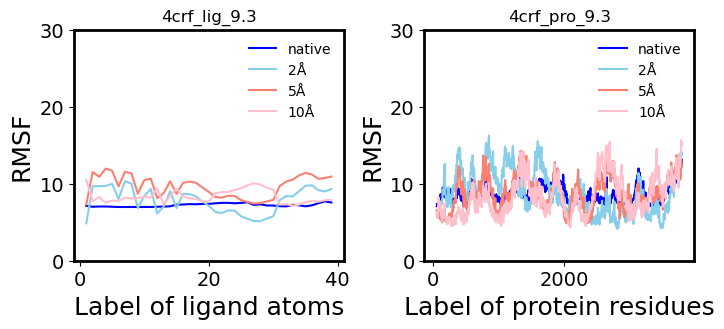

  7%|▋         | 7/100 [00:01<00:16,  5.73it/s]

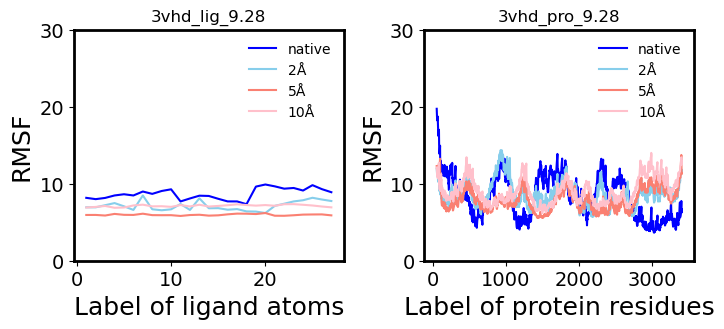

  8%|▊         | 8/100 [00:01<00:16,  5.73it/s]

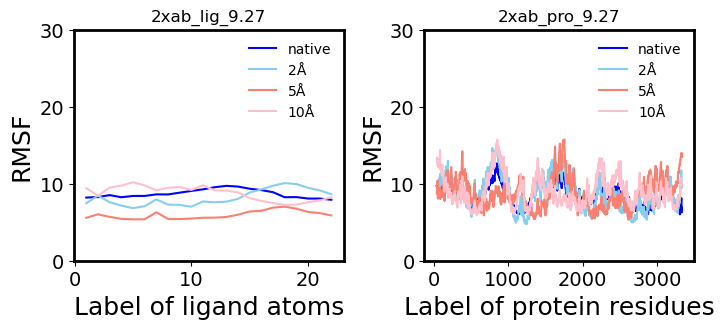

  9%|▉         | 9/100 [00:01<00:15,  5.81it/s]

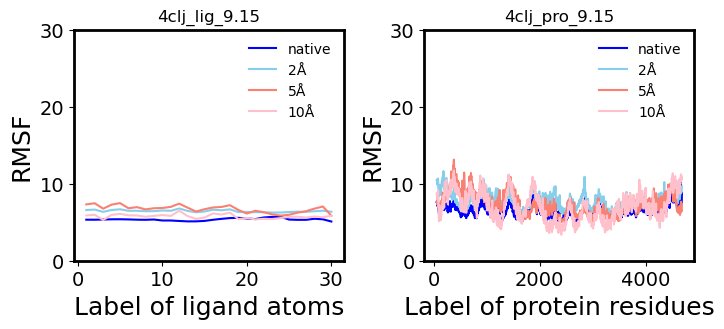

 10%|█         | 10/100 [00:01<00:15,  5.85it/s]

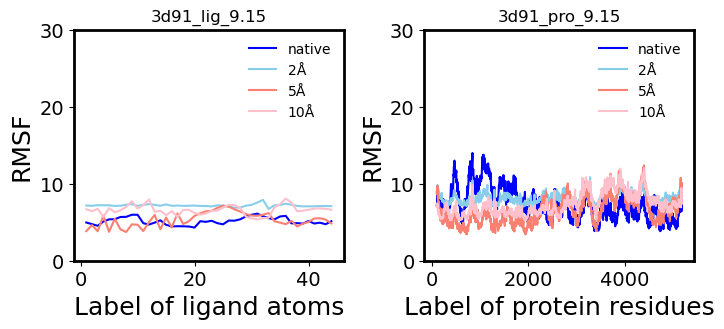

 11%|█         | 11/100 [00:02<00:15,  5.85it/s]

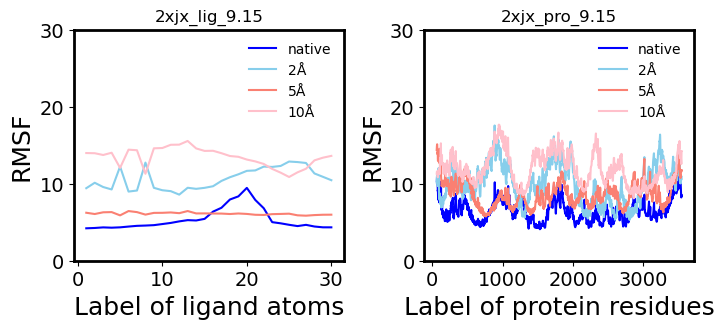

 12%|█▏        | 12/100 [00:02<00:19,  4.59it/s]

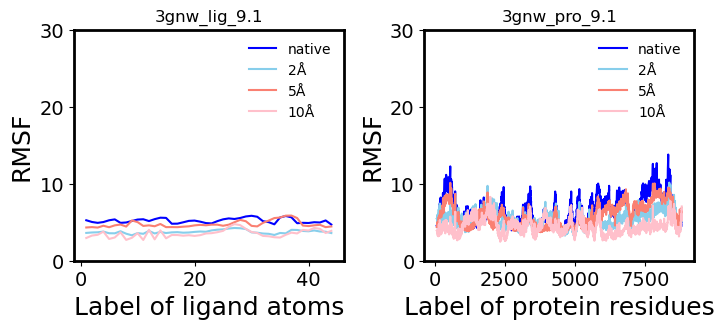

 13%|█▎        | 13/100 [00:02<00:18,  4.79it/s]

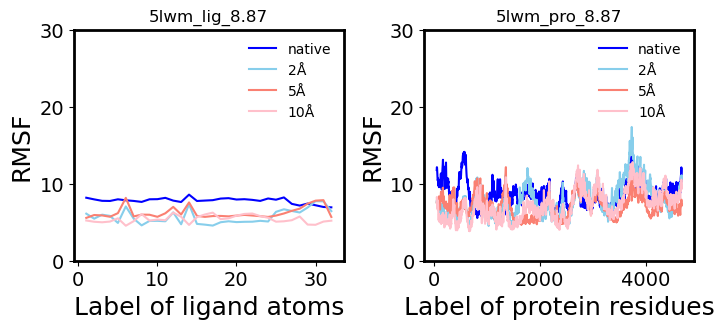

 14%|█▍        | 14/100 [00:02<00:16,  5.07it/s]

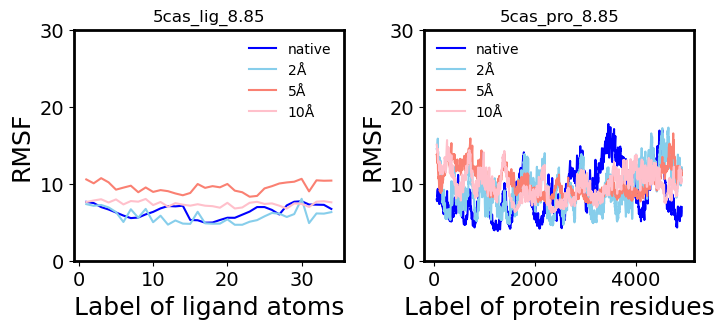

 15%|█▌        | 15/100 [00:02<00:16,  5.18it/s]

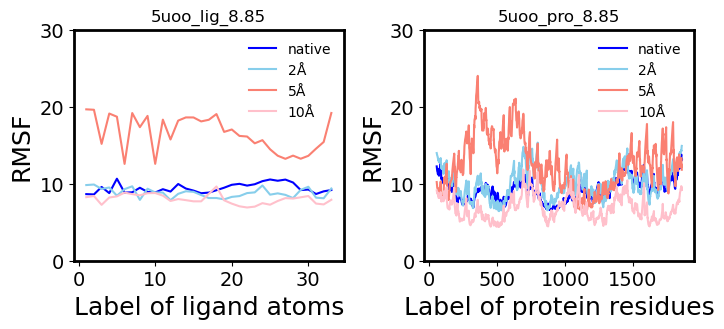

 16%|█▌        | 16/100 [00:03<00:16,  5.24it/s]

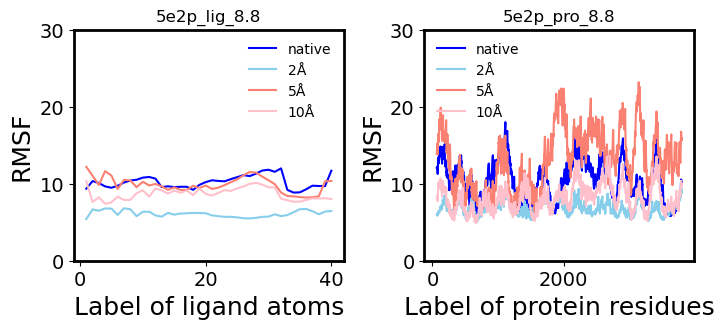

 17%|█▋        | 17/100 [00:03<00:15,  5.30it/s]

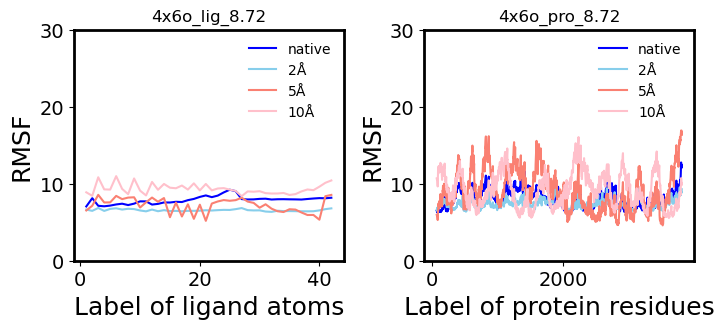

 18%|█▊        | 18/100 [00:03<00:14,  5.53it/s]

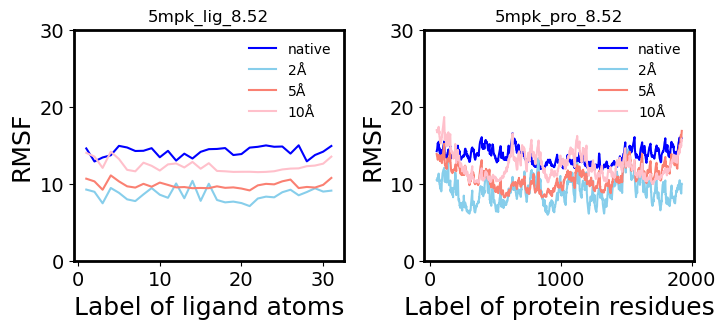

 19%|█▉        | 19/100 [00:03<00:14,  5.73it/s]

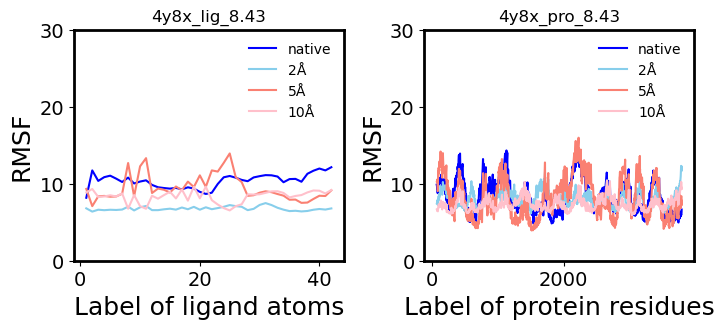

 20%|██        | 20/100 [00:03<00:13,  5.84it/s]

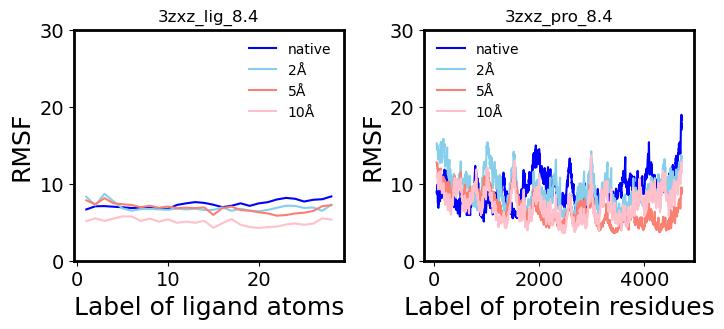

 21%|██        | 21/100 [00:03<00:13,  5.81it/s]

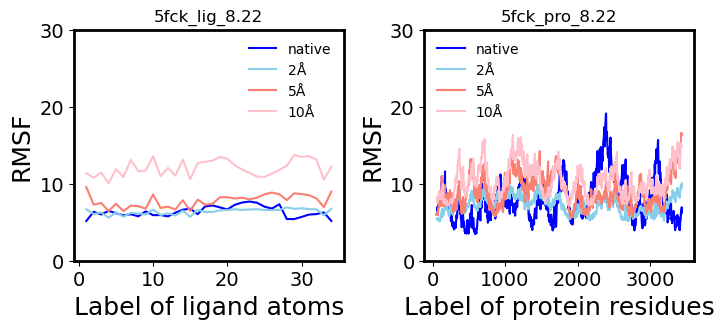

 22%|██▏       | 22/100 [00:04<00:13,  5.77it/s]

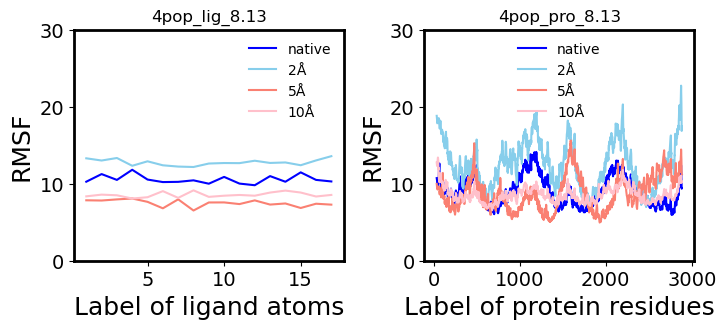

 23%|██▎       | 23/100 [00:04<00:17,  4.50it/s]

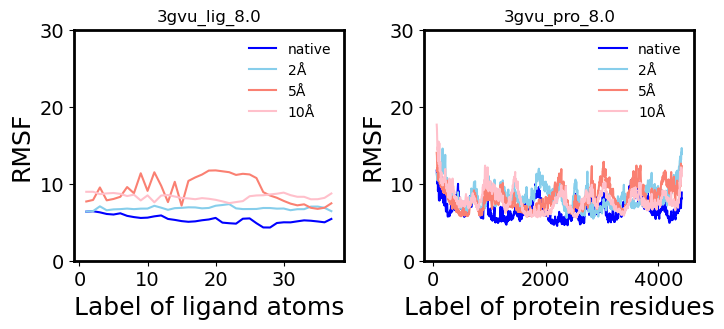

 24%|██▍       | 24/100 [00:04<00:15,  4.79it/s]

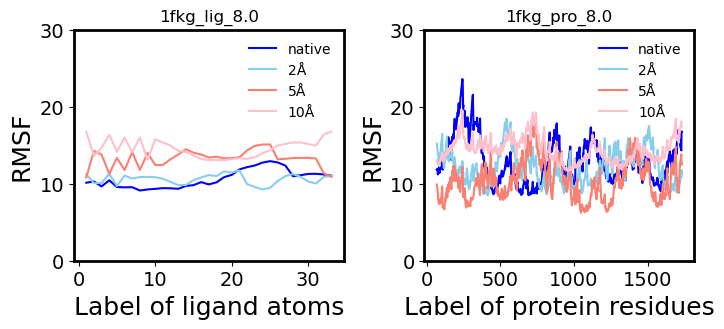

 25%|██▌       | 25/100 [00:04<00:15,  4.96it/s]

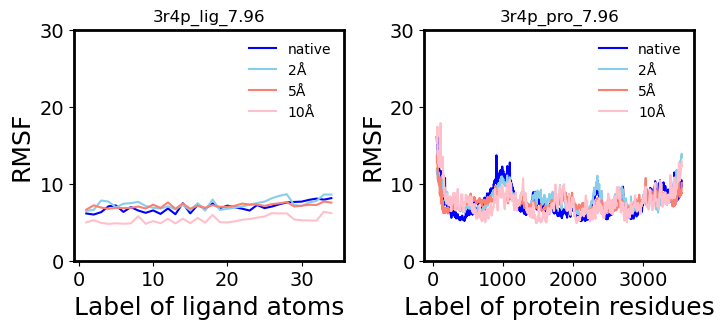

 26%|██▌       | 26/100 [00:05<00:14,  5.22it/s]

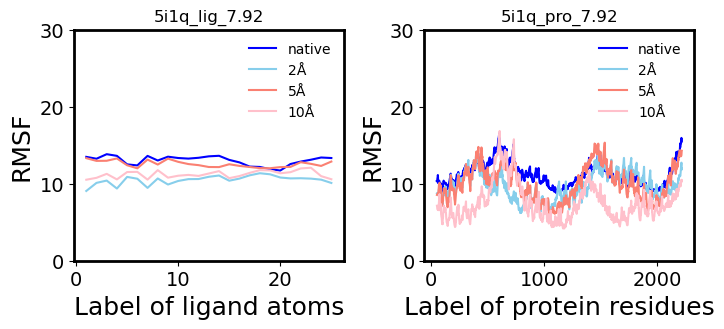

 27%|██▋       | 27/100 [00:05<00:13,  5.50it/s]

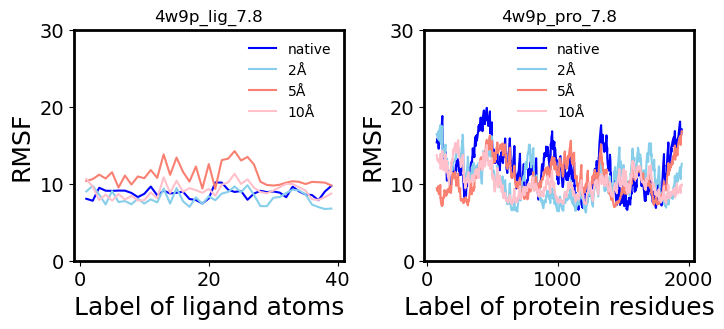

 28%|██▊       | 28/100 [00:05<00:12,  5.60it/s]

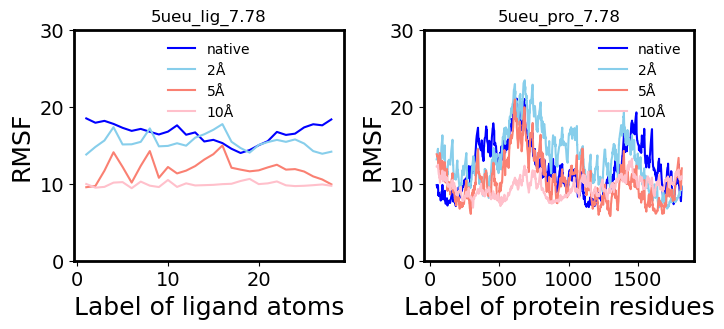

 29%|██▉       | 29/100 [00:05<00:12,  5.56it/s]

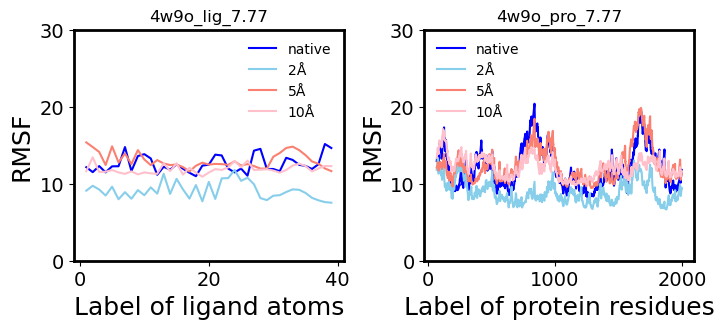

 30%|███       | 30/100 [00:05<00:12,  5.75it/s]

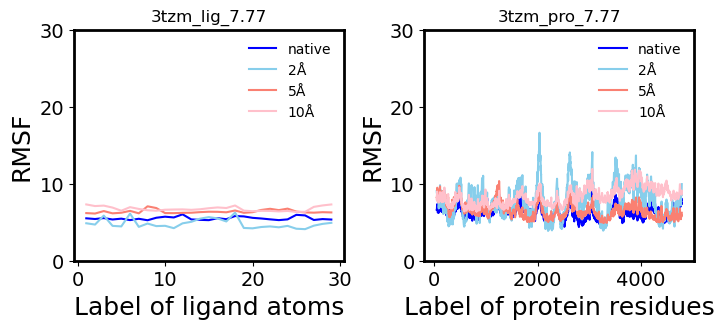

 31%|███       | 31/100 [00:05<00:11,  5.80it/s]

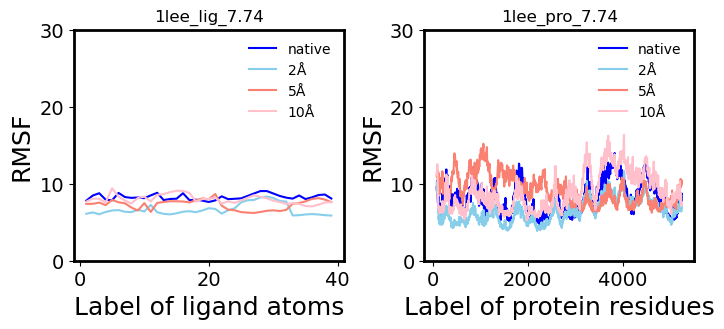

 32%|███▏      | 32/100 [00:06<00:11,  5.84it/s]

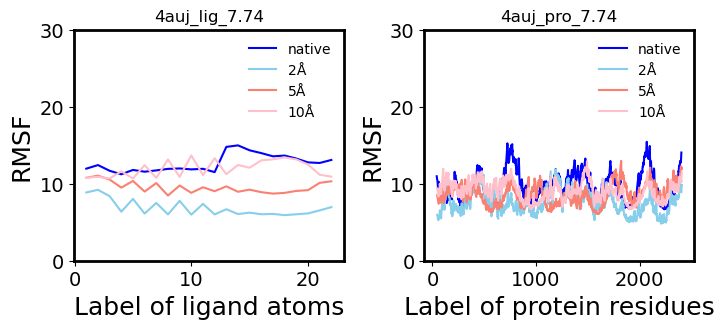

 33%|███▎      | 33/100 [00:06<00:11,  5.97it/s]

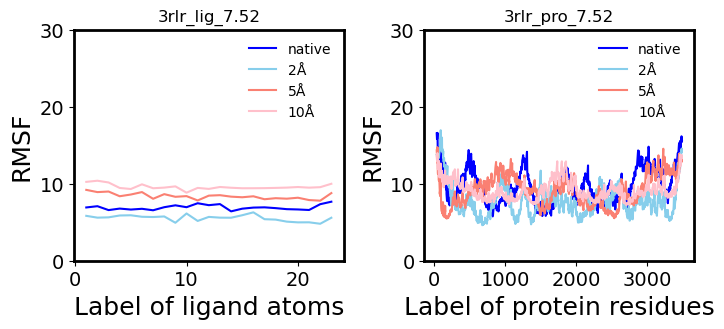

 34%|███▍      | 34/100 [00:06<00:14,  4.70it/s]

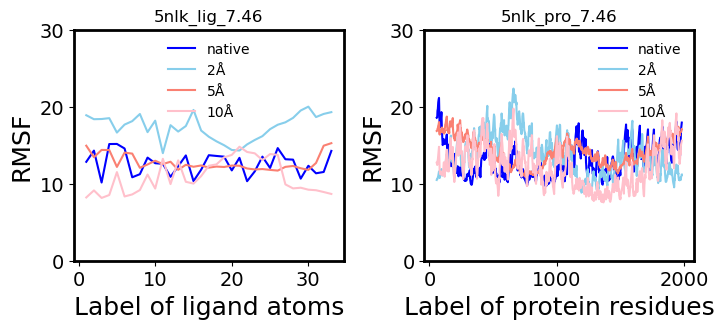

 35%|███▌      | 35/100 [00:06<00:13,  4.89it/s]

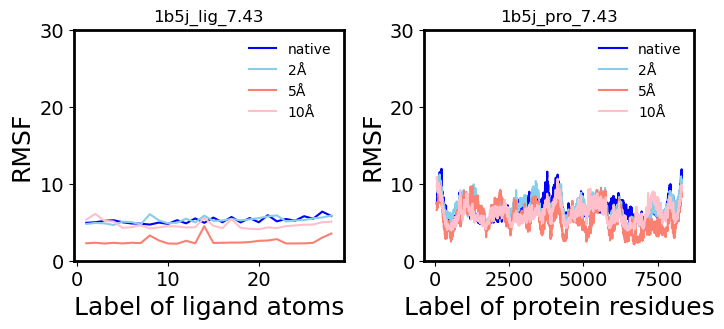

 36%|███▌      | 36/100 [00:06<00:12,  5.06it/s]

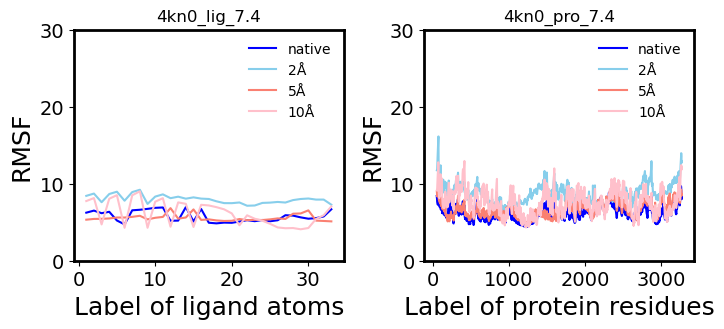

 37%|███▋      | 37/100 [00:07<00:11,  5.31it/s]

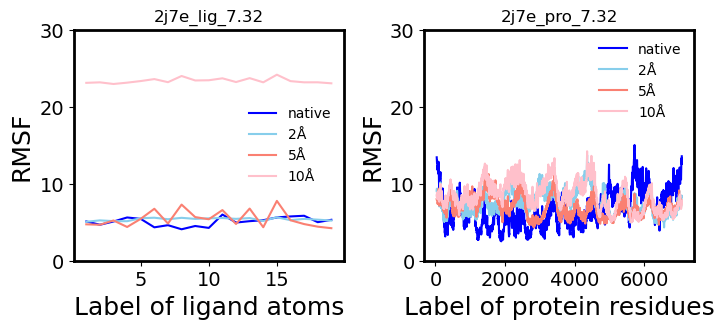

 38%|███▊      | 38/100 [00:07<00:11,  5.36it/s]

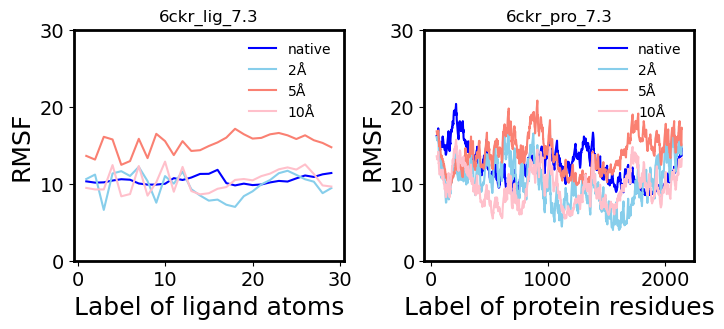

 39%|███▉      | 39/100 [00:07<00:11,  5.44it/s]

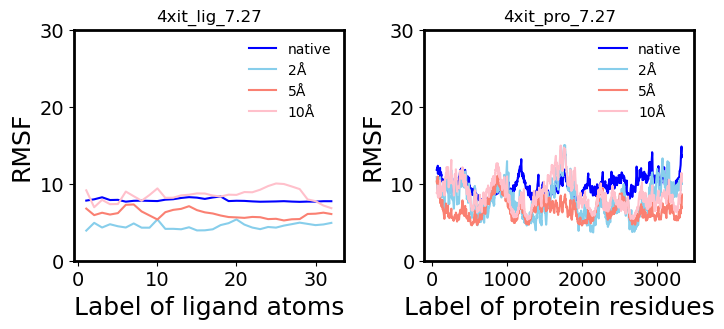

 40%|████      | 40/100 [00:07<00:10,  5.58it/s]

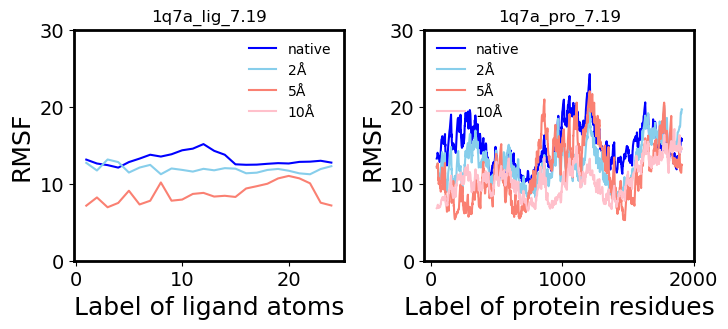

 41%|████      | 41/100 [00:07<00:10,  5.65it/s]

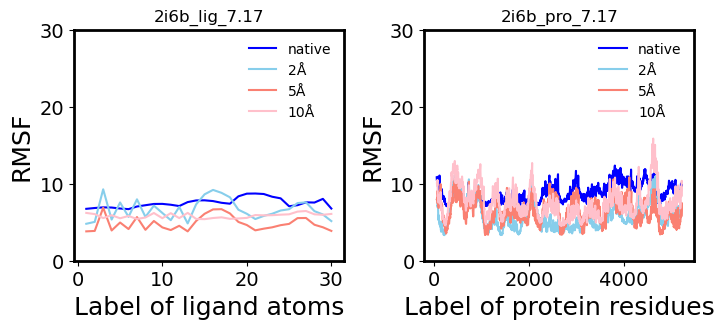

 42%|████▏     | 42/100 [00:07<00:10,  5.71it/s]

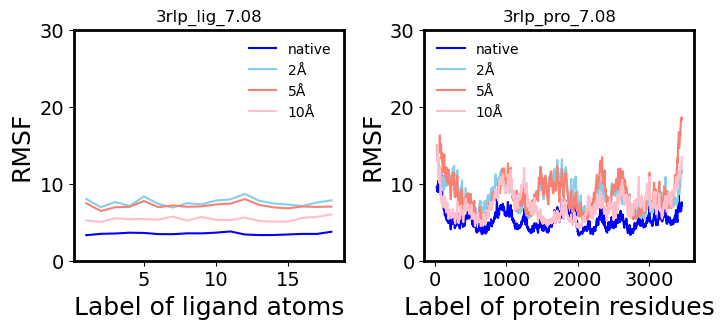

 43%|████▎     | 43/100 [00:08<00:09,  5.78it/s]

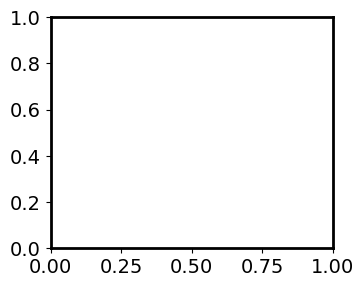

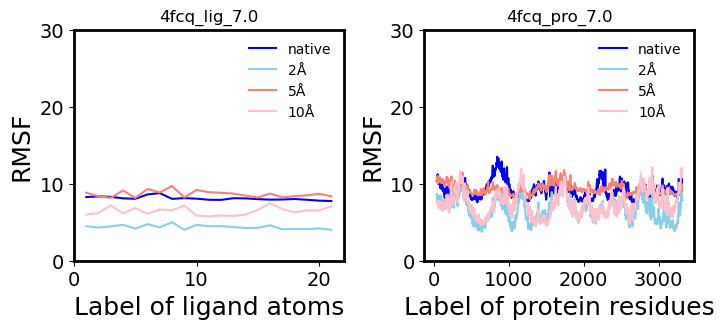

 45%|████▌     | 45/100 [00:08<00:07,  6.93it/s]

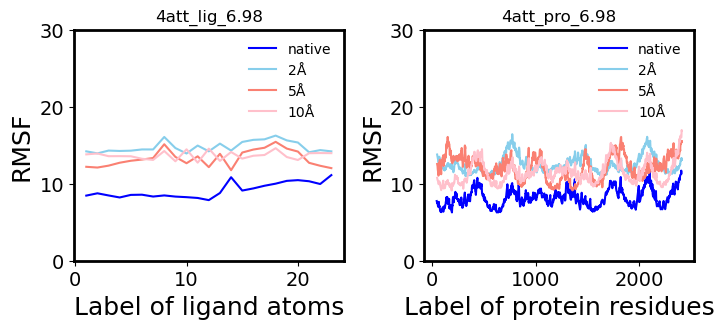

 46%|████▌     | 46/100 [00:08<00:09,  5.54it/s]

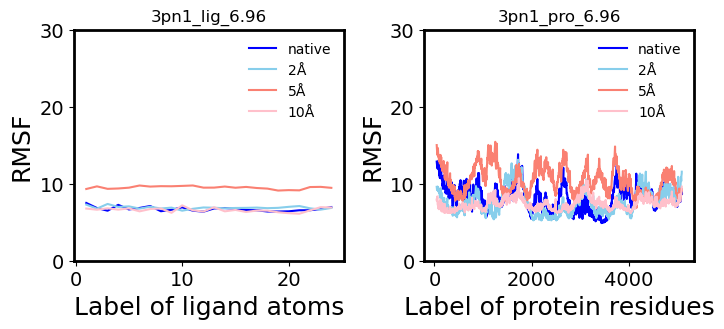

 47%|████▋     | 47/100 [00:08<00:09,  5.65it/s]

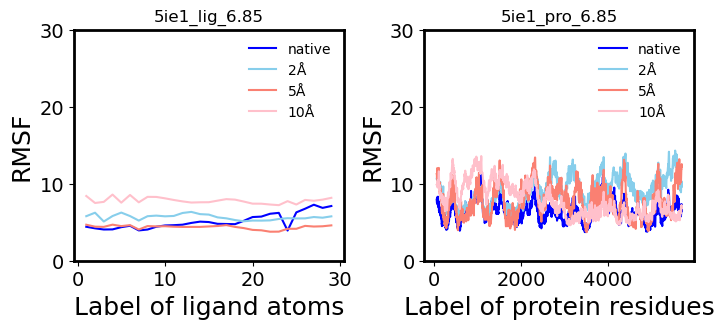

 48%|████▊     | 48/100 [00:08<00:09,  5.69it/s]

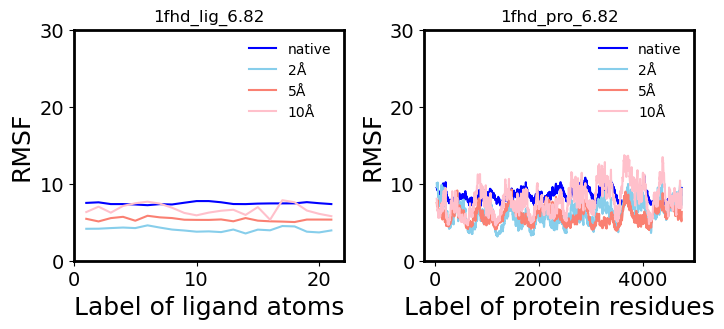

 49%|████▉     | 49/100 [00:09<00:08,  5.78it/s]

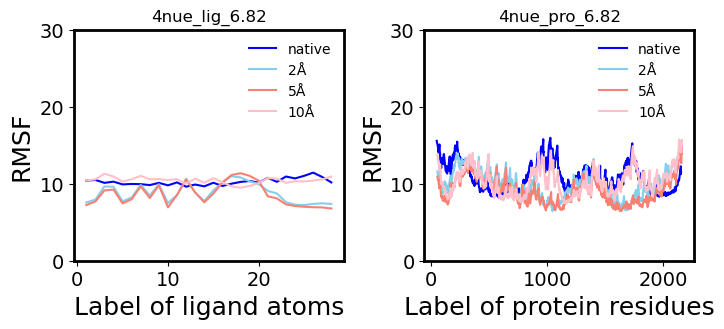

 50%|█████     | 50/100 [00:09<00:08,  5.94it/s]

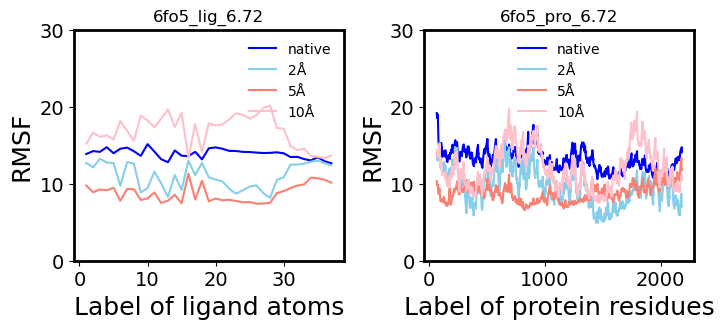

 51%|█████     | 51/100 [00:09<00:08,  5.79it/s]

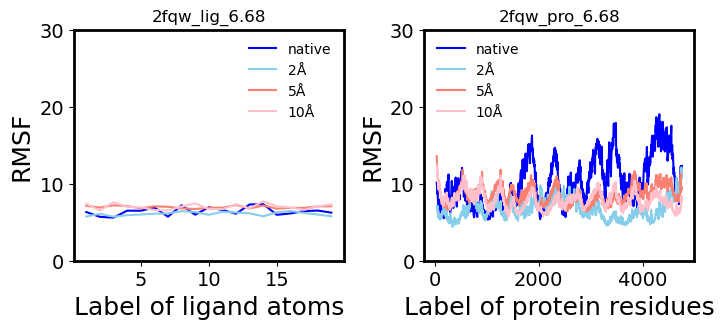

 52%|█████▏    | 52/100 [00:09<00:08,  5.78it/s]

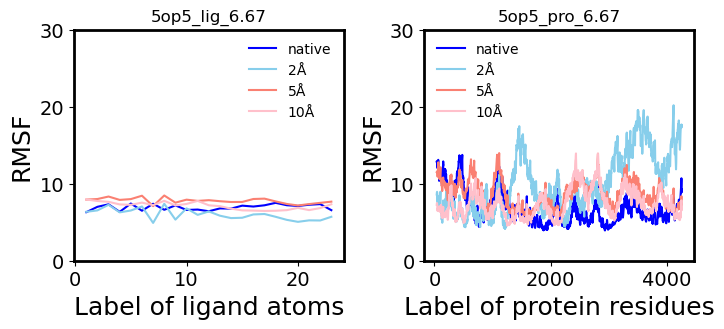

 53%|█████▎    | 53/100 [00:09<00:08,  5.83it/s]

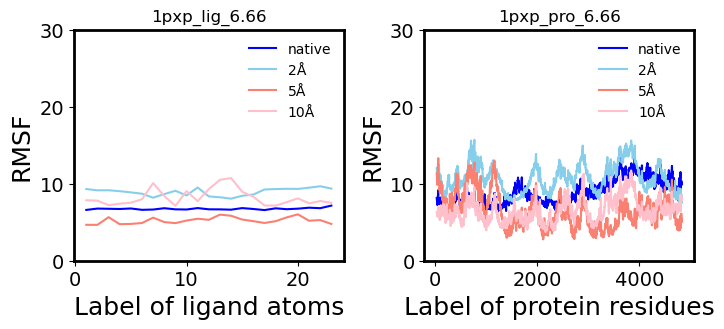

 54%|█████▍    | 54/100 [00:09<00:07,  5.87it/s]

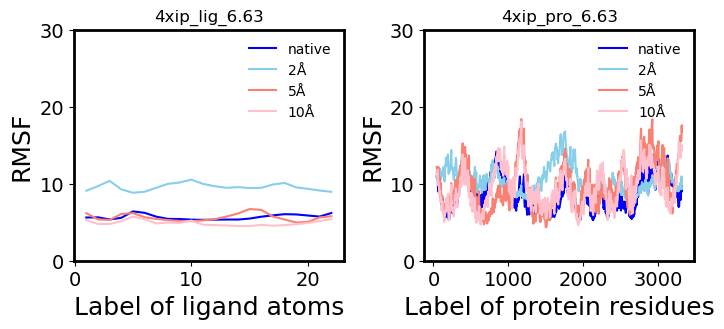

 55%|█████▌    | 55/100 [00:10<00:07,  5.74it/s]

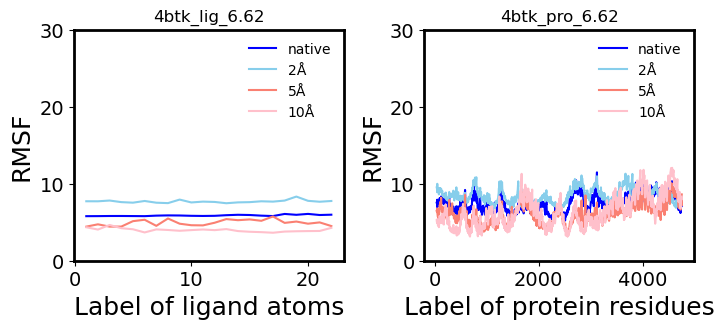

 56%|█████▌    | 56/100 [00:10<00:07,  5.83it/s]

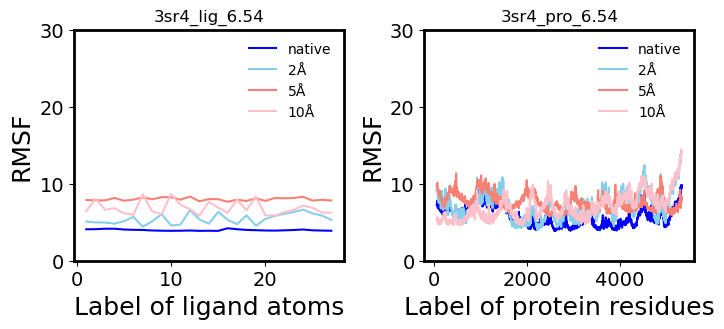

 57%|█████▋    | 57/100 [00:10<00:08,  4.78it/s]

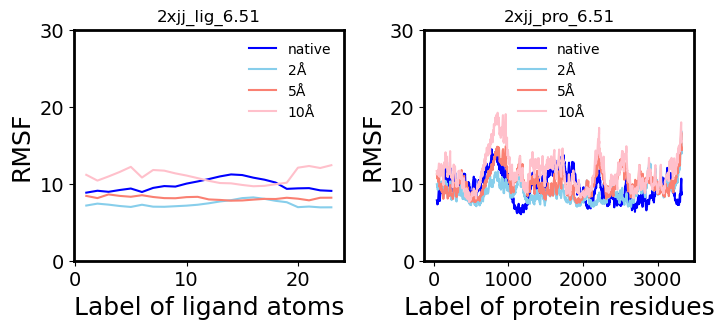

 58%|█████▊    | 58/100 [00:10<00:08,  4.97it/s]

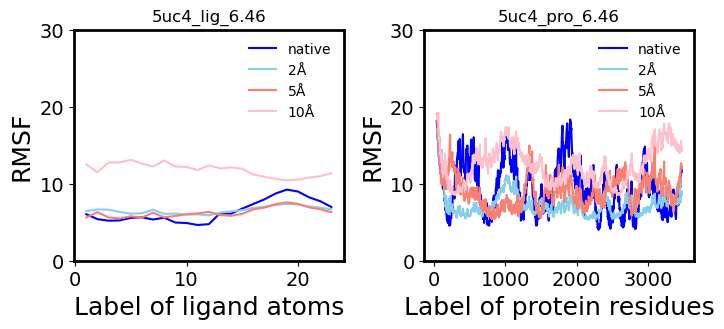

 59%|█████▉    | 59/100 [00:10<00:08,  5.08it/s]

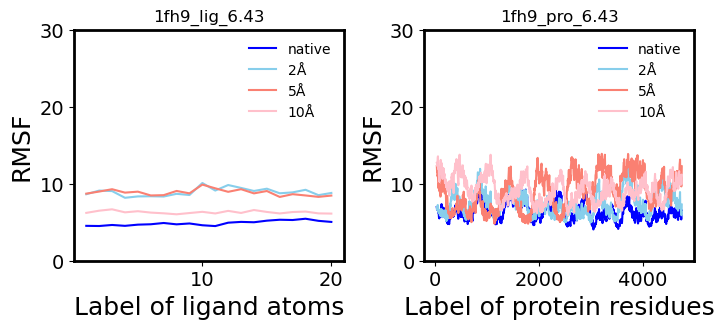

 60%|██████    | 60/100 [00:11<00:07,  5.33it/s]

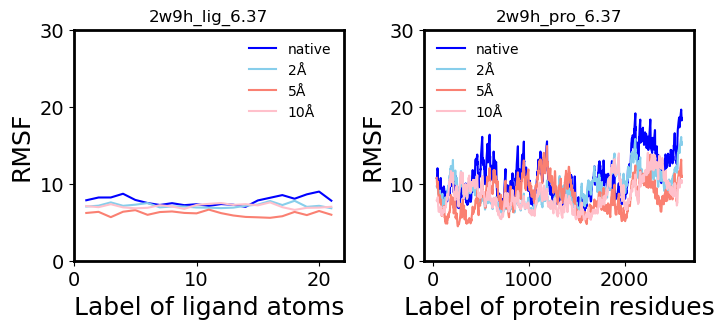

 61%|██████    | 61/100 [00:11<00:07,  5.57it/s]

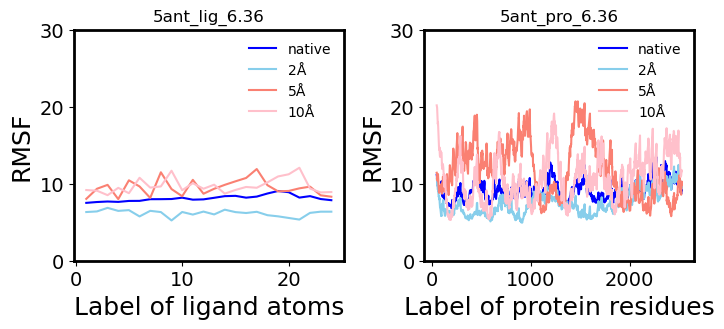

 62%|██████▏   | 62/100 [00:11<00:06,  5.75it/s]

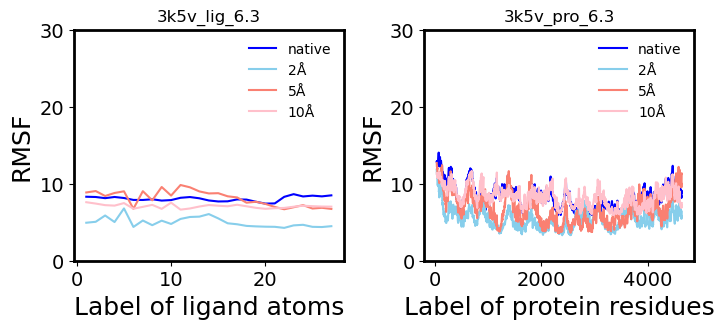

 63%|██████▎   | 63/100 [00:11<00:06,  5.81it/s]

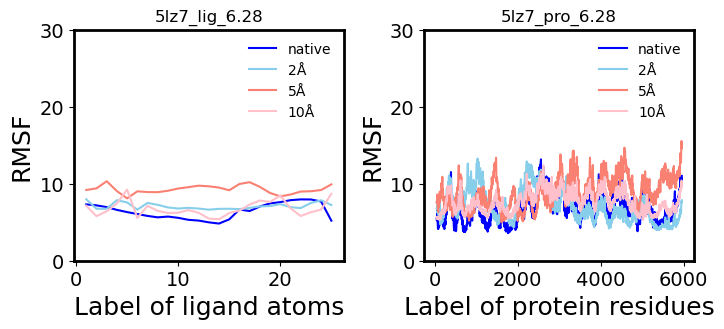

 64%|██████▍   | 64/100 [00:11<00:06,  5.80it/s]

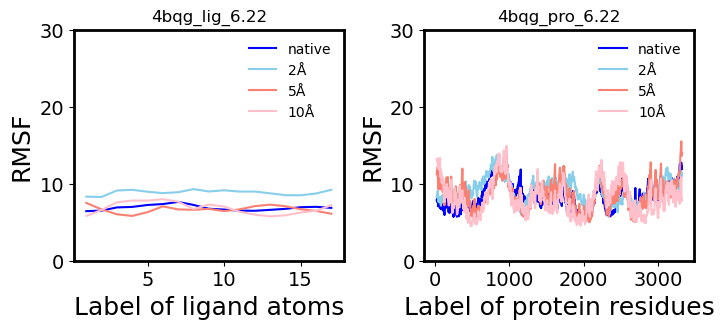

 65%|██████▌   | 65/100 [00:11<00:05,  5.89it/s]

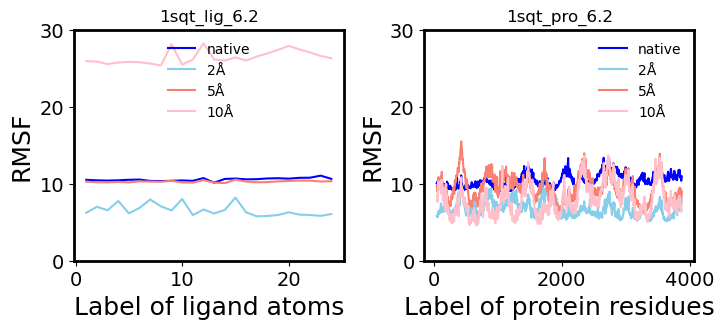

 66%|██████▌   | 66/100 [00:12<00:05,  5.89it/s]

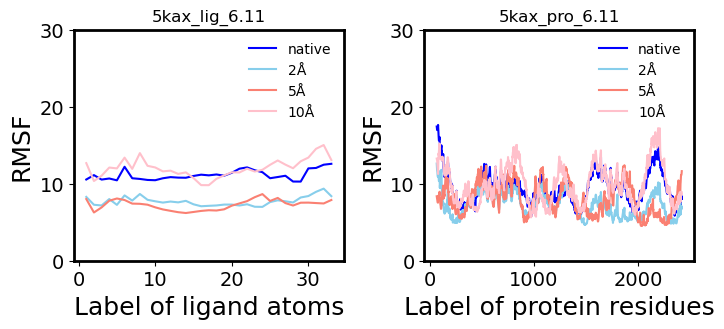

 67%|██████▋   | 67/100 [00:12<00:05,  6.00it/s]

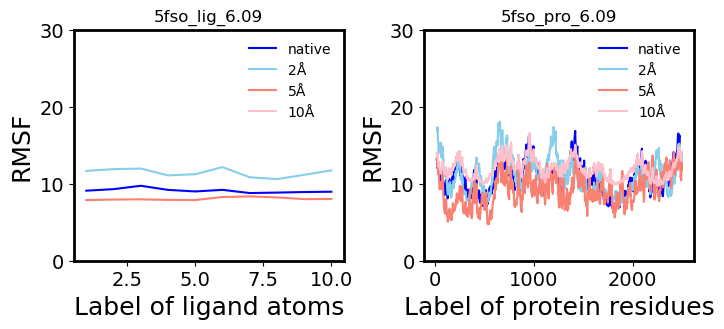

 68%|██████▊   | 68/100 [00:12<00:06,  4.90it/s]

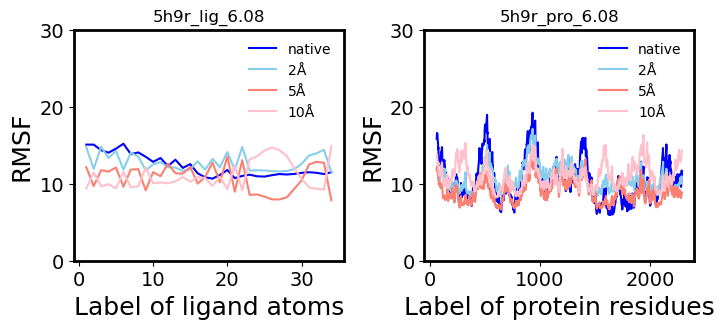

 69%|██████▉   | 69/100 [00:12<00:05,  5.23it/s]

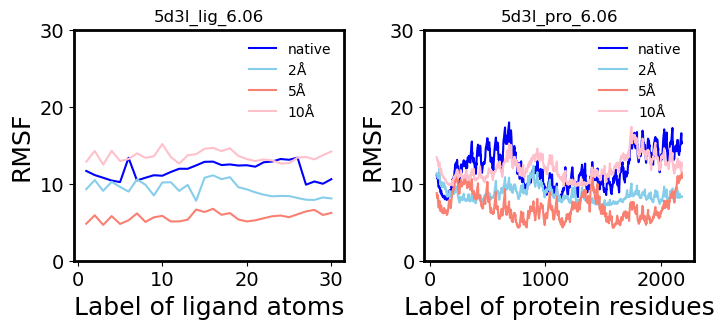

 70%|███████   | 70/100 [00:12<00:05,  5.49it/s]

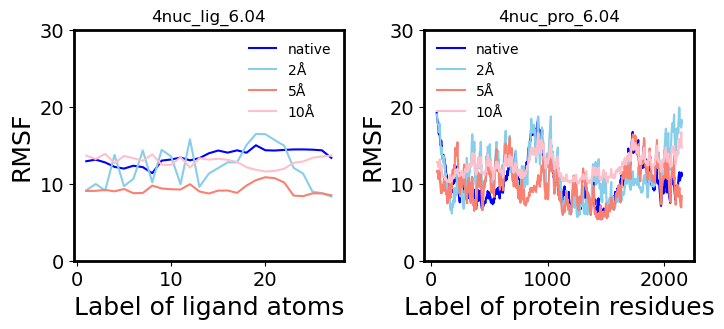

 71%|███████   | 71/100 [00:13<00:05,  5.56it/s]

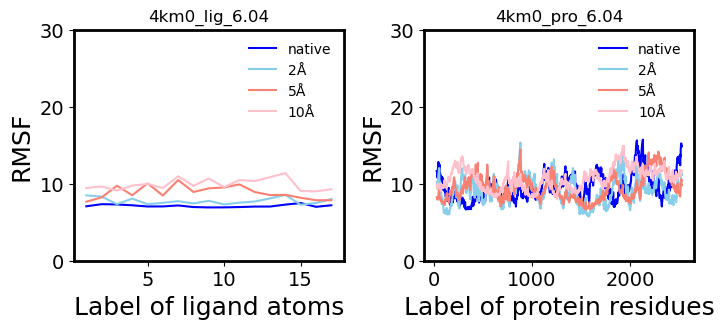

 72%|███████▏  | 72/100 [00:13<00:04,  5.73it/s]

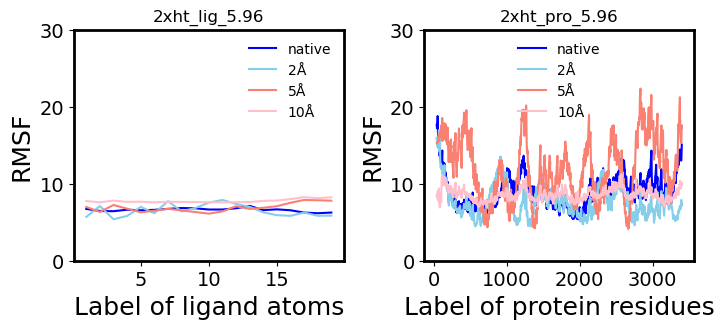

 73%|███████▎  | 73/100 [00:13<00:04,  5.62it/s]

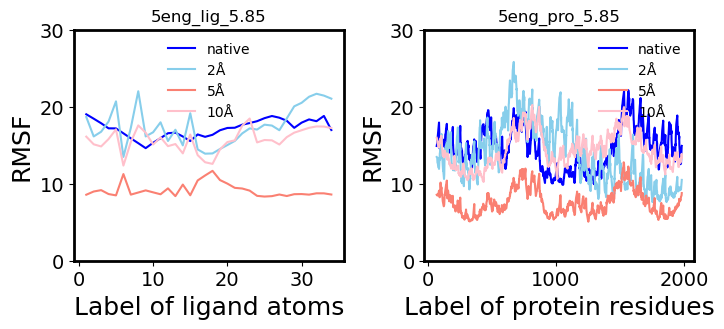

 74%|███████▍  | 74/100 [00:13<00:04,  5.56it/s]

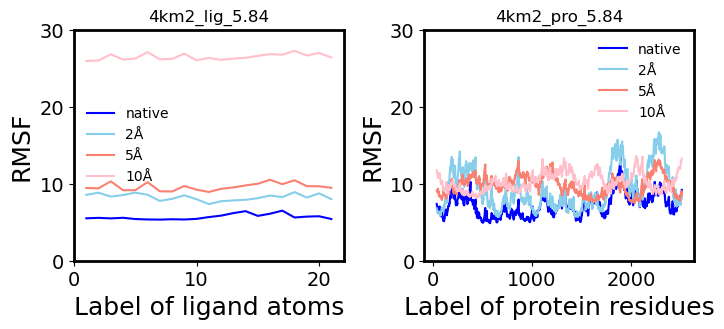

 75%|███████▌  | 75/100 [00:13<00:04,  5.69it/s]

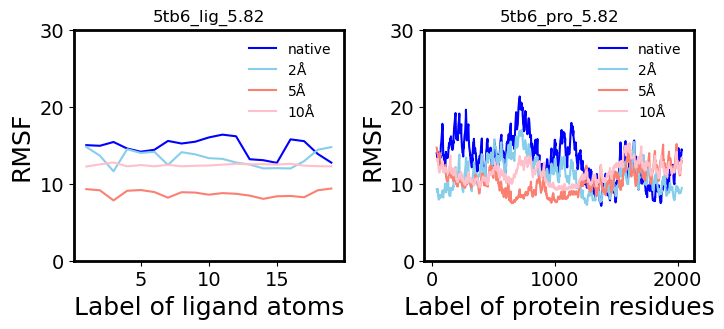

 76%|███████▌  | 76/100 [00:13<00:04,  5.87it/s]

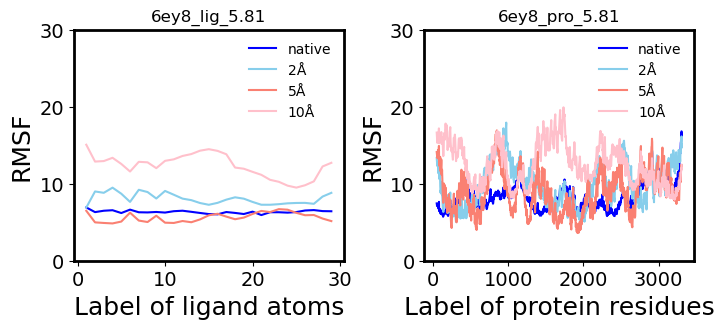

 77%|███████▋  | 77/100 [00:14<00:03,  5.90it/s]

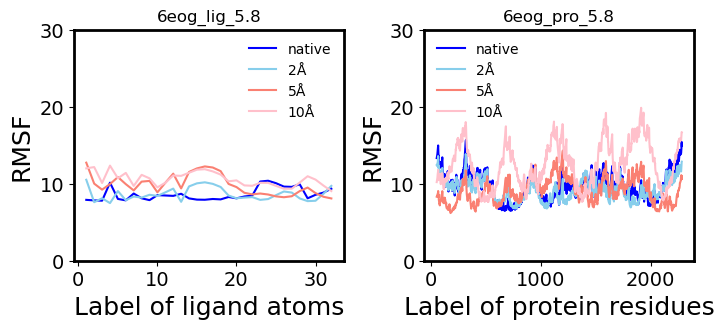

 78%|███████▊  | 78/100 [00:14<00:03,  5.83it/s]

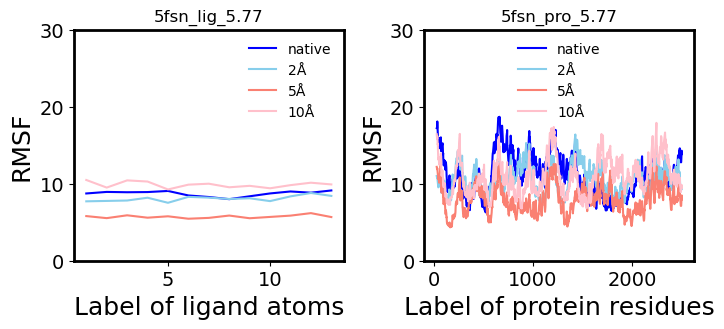

 79%|███████▉  | 79/100 [00:14<00:04,  4.74it/s]

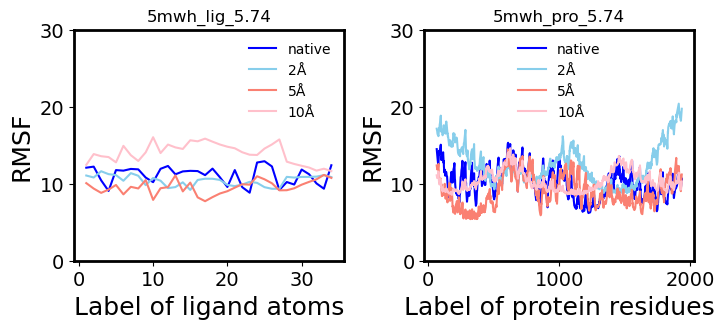

 80%|████████  | 80/100 [00:14<00:03,  5.01it/s]

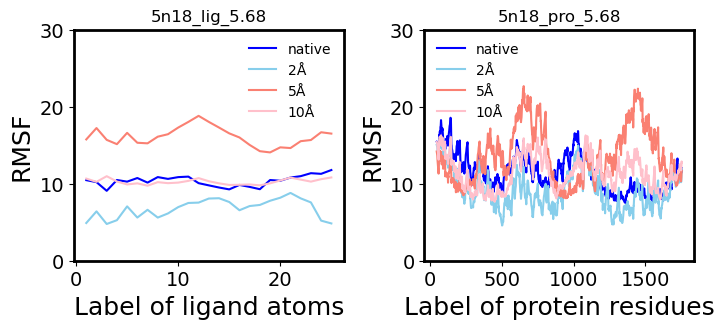

 81%|████████  | 81/100 [00:14<00:03,  5.22it/s]

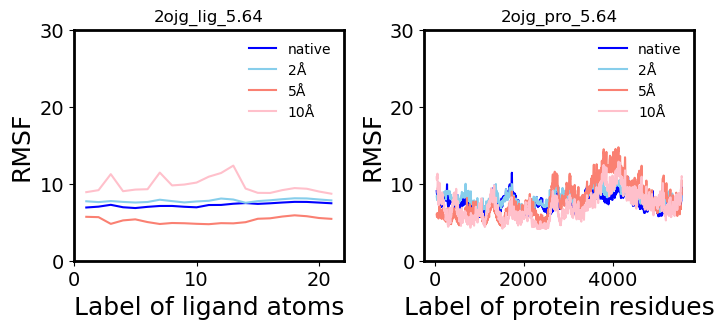

 82%|████████▏ | 82/100 [00:15<00:03,  5.42it/s]

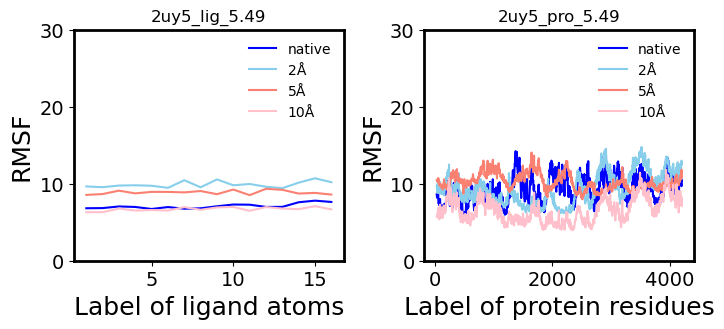

 83%|████████▎ | 83/100 [00:15<00:03,  5.60it/s]

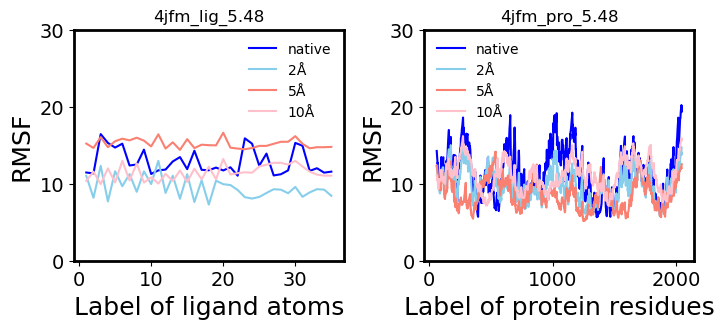

 84%|████████▍ | 84/100 [00:15<00:02,  5.62it/s]

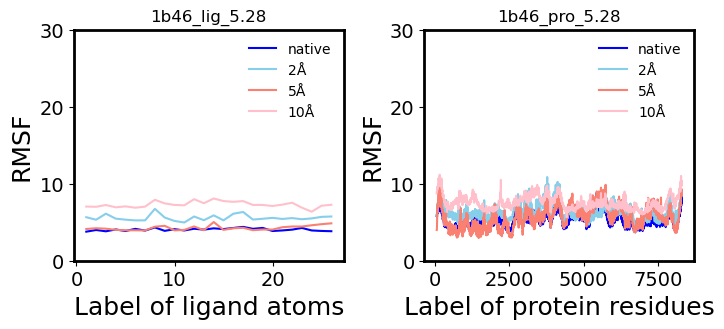

 85%|████████▌ | 85/100 [00:15<00:02,  5.59it/s]

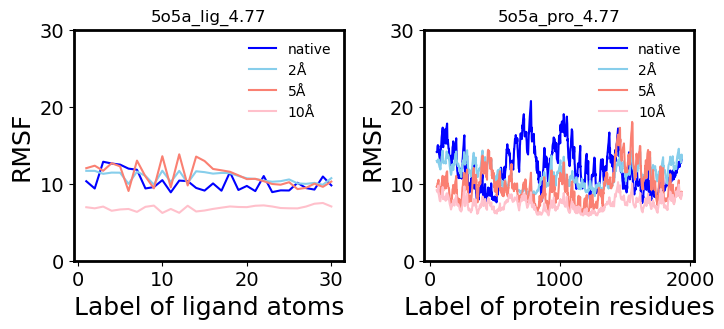

 86%|████████▌ | 86/100 [00:15<00:02,  5.63it/s]

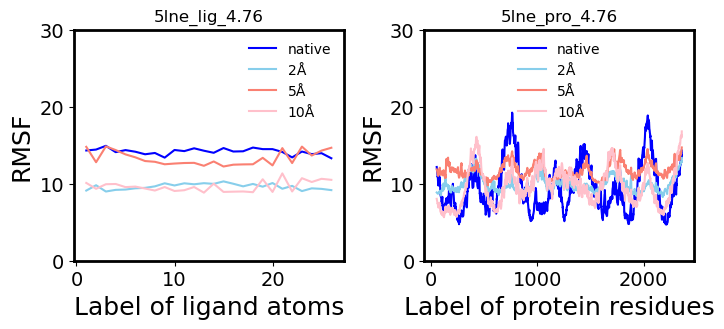

 87%|████████▋ | 87/100 [00:15<00:02,  5.66it/s]

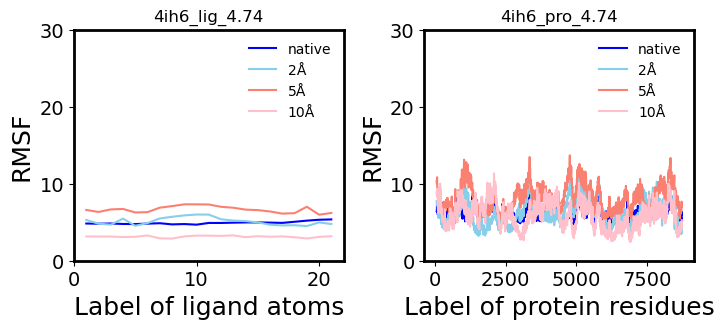

 88%|████████▊ | 88/100 [00:16<00:02,  5.63it/s]

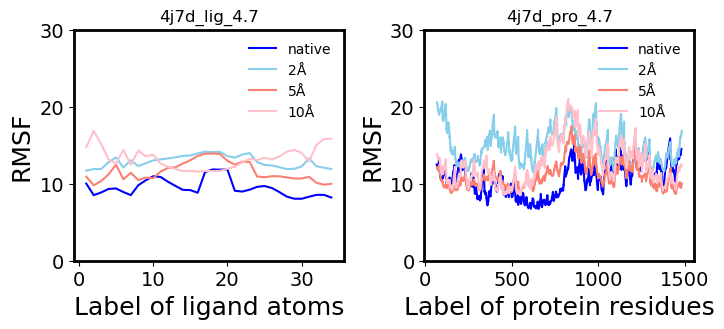

 89%|████████▉ | 89/100 [00:16<00:01,  5.68it/s]

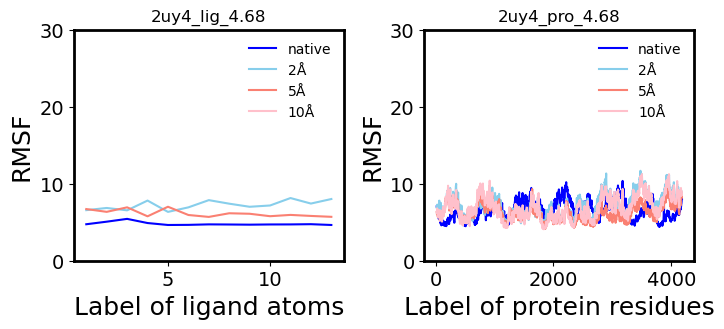

 90%|█████████ | 90/100 [00:16<00:02,  4.75it/s]

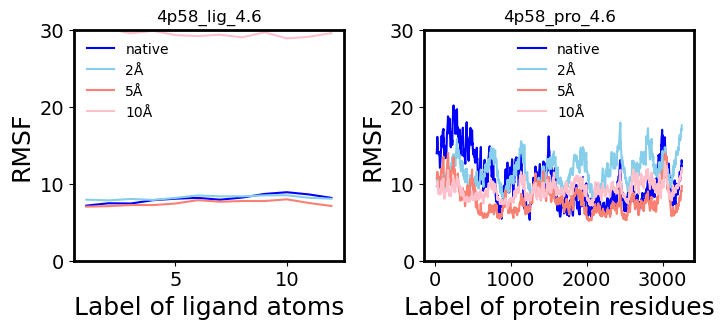

 91%|█████████ | 91/100 [00:16<00:01,  4.96it/s]

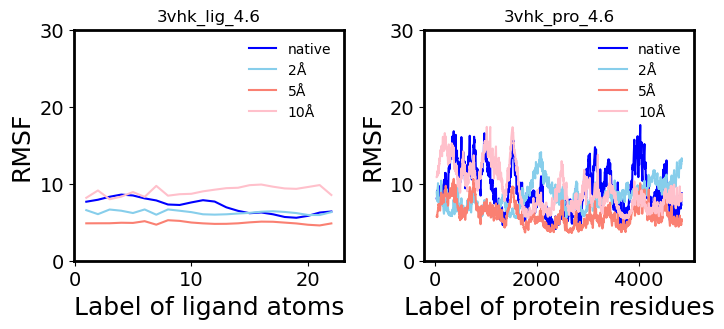

 92%|█████████▏| 92/100 [00:16<00:01,  5.22it/s]

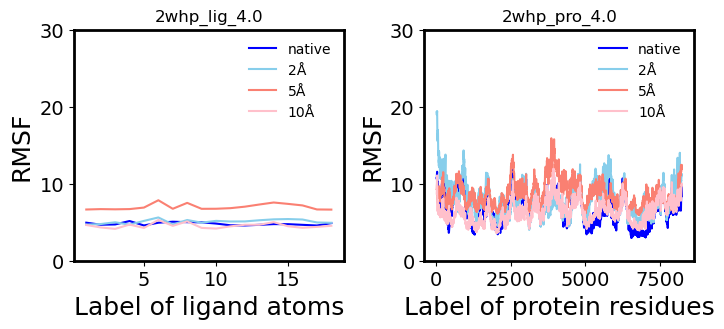

 93%|█████████▎| 93/100 [00:17<00:01,  5.30it/s]

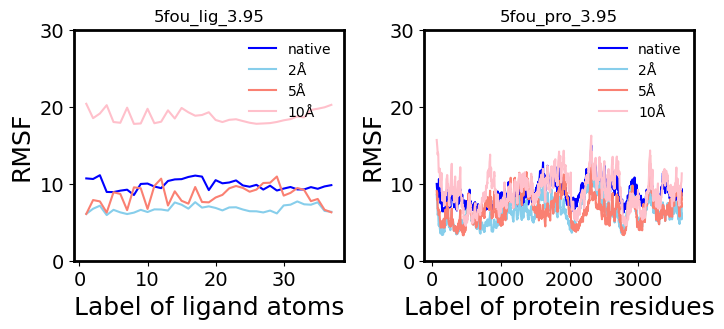

 94%|█████████▍| 94/100 [00:17<00:01,  5.41it/s]

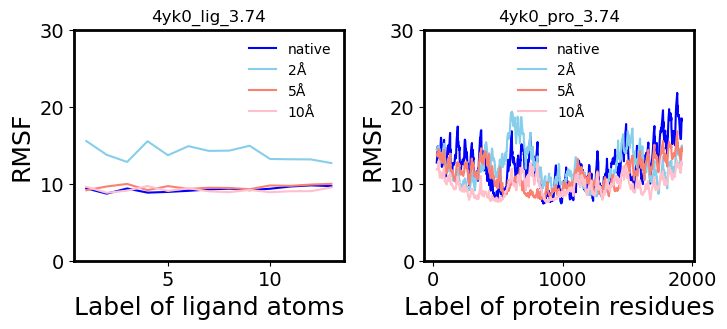

 95%|█████████▌| 95/100 [00:17<00:00,  5.55it/s]

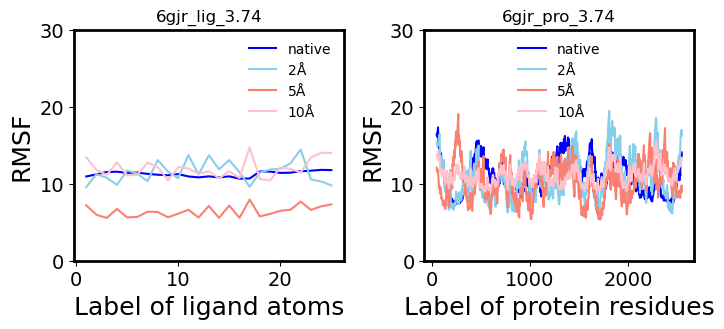

 96%|█████████▌| 96/100 [00:17<00:00,  5.56it/s]

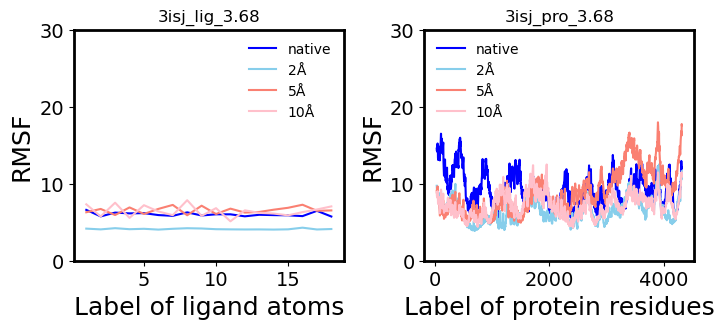

 97%|█████████▋| 97/100 [00:17<00:00,  5.66it/s]

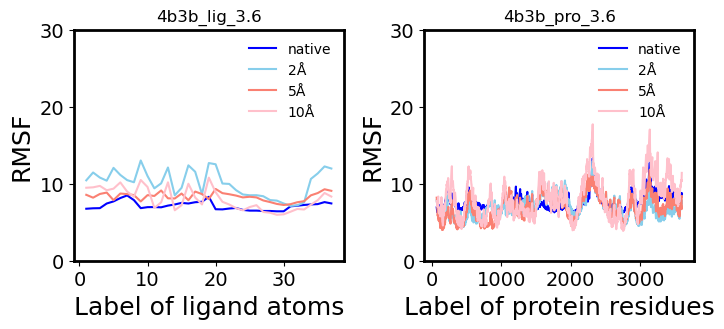

 98%|█████████▊| 98/100 [00:17<00:00,  5.75it/s]

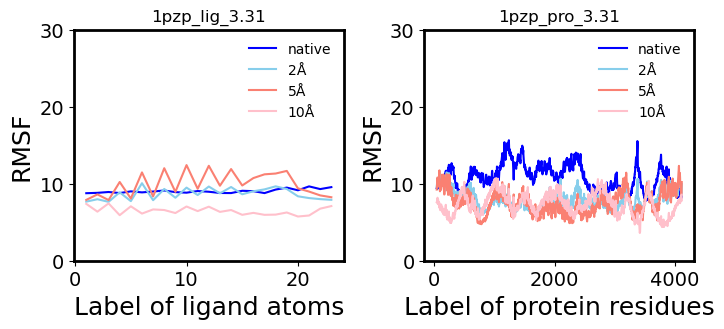

 99%|█████████▉| 99/100 [00:18<00:00,  5.86it/s]

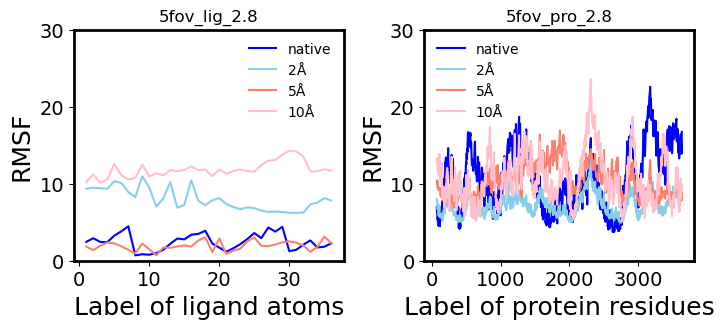

100%|██████████| 100/100 [00:18<00:00,  5.45it/s]


In [55]:
fail_rmsf = []
pdblist_100 = sel_100_data['pdbid'].tolist()
for i in tqdm(pdblist_100):
    try:
        plot_rmsf_four(i)
    except:
        fail_rmsf.append(i)
        pass

# MMPBSA section

In [256]:
def plot_contrast_mmpbsa(pdfile,
                         col1='native',
                         col2='5a',
                         color='lightseagreen',
                         x_min=-80,
                         x_max=100):

    plt.scatter(pdfile[col1],
                pdfile[col2],
                s=150,
#                 c=pdfile['affinity(-logkd)'],
                color=color)
    #     plt.scatter(pdfile[col1],pdfile[col2],cmap=plt.get_cmap('winter'))

    plt.plot([i for i in range(x_min, x_max, 1)],
             [i for i in range(x_min, x_max, 1)],c='pink')
#     plt.plot([i + 5 for i in range(x_min, x_max, 1)],
#              [i for i in range(x_min, x_max, 1)])
#     plt.plot([i - 5 for i in range(x_min, x_max, 1)],
#              [i for i in range(x_min, x_max, 1)])
    if col1.endswith('a'):
        plt.xlabel('%s_mmpbsa' % col1.split('_')[1].replace('a',' Å'), fontsize=18)
    else:
        plt.xlabel('%s_mmpbsa' % col1.split('_')[1], fontsize=18)
    if col2.endswith('a'):
        plt.ylabel('%s_mmpbsa' % col2.split('_')[1].replace('a',' Å'), fontsize=18)
    else:
        plt.ylabel('%s_mmpbsa' % col2.split('_')[1], fontsize=18)
    #     plt.title('RMSD reference to first frame (near 5ns)',fontsize=18)
    plt.xlim(x_min, x_max)
    plt.ylim(x_min, x_max)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)


#     plt.colorbar()
#     plt.show()

In [246]:
def plot_six_mmpbsa_subplot(pdfile,
                            name1='native',
                            name2='2a',
                            name3='5a',
                            name4='10a',
                            color='pink',
                            decompose=False,
                            x_min=-80,
                            x_max=20,
                            labelx=20,
                            labely=-30):

    plt.figure(figsize=(22, 12))

    plt.subplot(2, 3, 1)

    plot_contrast_mmpbsa(pdfile,
                         col1=name1,
                         col2=name2,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name2]]),
                              len(pdfile[pdfile[name1] > pdfile[name2]])),
             fontsize=18)
    if decompose:
        plt.text(-40, 80, 'Static_%s' % decompose.upper(), fontsize=14)

    plt.subplot(2, 3, 2)
    plot_contrast_mmpbsa(pdfile,
                         col1=name1,
                         col2=name3,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name3]]),
                              len(pdfile[pdfile[name1] > pdfile[name3]])),
             fontsize=18)

    plt.subplot(2, 3, 3)
    plot_contrast_mmpbsa(pdfile,
                         col1=name1,
                         col2=name4,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name4]]),
                              len(pdfile[pdfile[name1] > pdfile[name4]])),
             fontsize=18)

    plt.subplot(2, 3, 4)
    plot_contrast_mmpbsa(pdfile,
                         col1=name2,
                         col2=name3,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name2] < pdfile[name3]]),
                              len(pdfile[pdfile[name2] > pdfile[name3]])),
             fontsize=18)

    plt.subplot(2, 3, 5)
    plot_contrast_mmpbsa(pdfile,
                         col1=name2,
                         col2=name4,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name2] < pdfile[name4]]),
                              len(pdfile[pdfile[name2] > pdfile[name4]])),
             fontsize=18)

    plt.subplot(2, 3, 6)
    plot_contrast_mmpbsa(pdfile,
                         col1=name3,
                         col2=name4,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name3] < pdfile[name4]]),
                              len(pdfile[pdfile[name3] > pdfile[name4]])),
             fontsize=18)

    plt.subplots_adjust(wspace=0.3, hspace=0.4)

    # plt.savefig('rmsd_last_5ns.png',bbox_inches='tight')

    plt.show()

In [247]:
def plot_six_mmpbsa_s_d_subplot(pdfile,
                            name1='native',
                            name2='2a',
                            name3='5a',
                            name4='10a',
                            color1='salmon',
                            s_color='blue',
                            s_name1='native',
                            s_name2='2a',
                            s_name3='5a',
                            s_name4='10a',
                            decompose=False,
                            x_min=-80,
                            x_max=100,
                            labelx=0,
                            labely=-40,
                            labelx2=0,
                            labely2=-60):

    plt.figure(figsize=(22, 12))

    plt.subplot(2, 3, 1)

    plot_contrast_mmpbsa(pdfile,
                         col1=name1,
                         col2=name2,
                         color=color1,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             'static +/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name2]]),
                              len(pdfile[pdfile[name1] > pdfile[name2]])),
             fontsize=18, color=color1)
    
    plot_contrast_mmpbsa(pdfile,
                         col1=s_name1,
                         col2=s_name2,
                         color=s_color,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx2,
             labely2,
             'dynamic +/- : %d/%d' % (len(pdfile[pdfile[s_name1] < pdfile[s_name2]]),
                              len(pdfile[pdfile[s_name1] > pdfile[s_name2]])),
             fontsize=18, color=s_color)
    

    plt.subplot(2, 3, 2)
    plot_contrast_mmpbsa(pdfile,
                         col1=name1,
                         col2=name3,
                         color=color1,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             'static +/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name3]]),
                              len(pdfile[pdfile[name1] > pdfile[name3]])),
             fontsize=18, color=color1)
    
    plot_contrast_mmpbsa(pdfile,
                         col1=s_name1,
                         col2=s_name3,
                         color=s_color,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx2,
             labely2,
             'dynamic +/- : %d/%d' % (len(pdfile[pdfile[s_name1] < pdfile[s_name3]]),
                              len(pdfile[pdfile[s_name1] > pdfile[s_name3]])),
             fontsize=18, color=s_color)


    plt.subplot(2, 3, 3)
    plot_contrast_mmpbsa(pdfile,
                         col1=name1,
                         col2=name4,
                         color=color1,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             'static +/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name4]]),
                              len(pdfile[pdfile[name1] > pdfile[name4]])),
             fontsize=18, color=color1)
    
    plot_contrast_mmpbsa(pdfile,
                         col1=s_name1,
                         col2=s_name4,
                         color=s_color,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx2,
             labely2,
             'dynamic +/- : %d/%d' % (len(pdfile[pdfile[s_name1] < pdfile[s_name4]]),
                              len(pdfile[pdfile[s_name1] > pdfile[s_name4]])),
             fontsize=18, color=s_color)


    plt.subplot(2, 3, 4)
    plot_contrast_mmpbsa(pdfile,
                         col1=name2,
                         col2=name3,
                         color=color1,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             'static +/- : %d/%d' % (len(pdfile[pdfile[name2] < pdfile[name3]]),
                              len(pdfile[pdfile[name2] > pdfile[name3]])),
             fontsize=18, color=color1)
    
    plot_contrast_mmpbsa(pdfile,
                         col1=s_name2,
                         col2=s_name3,
                         color=s_color,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx2,
             labely2,
             'dynamic +/- : %d/%d' % (len(pdfile[pdfile[s_name2] < pdfile[s_name3]]),
                              len(pdfile[pdfile[s_name2] > pdfile[s_name3]])),
             fontsize=18, color=s_color)

    plt.subplot(2, 3, 5)
    plot_contrast_mmpbsa(pdfile,
                         col1=name2,
                         col2=name4,
                         color=color1,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             'static +/- : %d/%d' % (len(pdfile[pdfile[name2] < pdfile[name4]]),
                              len(pdfile[pdfile[name2] > pdfile[name4]])),
             fontsize=18, color=color1)
    
    plot_contrast_mmpbsa(pdfile,
                         col1=s_name2,
                         col2=s_name4,
                         color=s_color,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx2,
             labely2,
             'dynamic +/- : %d/%d' % (len(pdfile[pdfile[s_name2] < pdfile[s_name4]]),
                              len(pdfile[pdfile[s_name2] > pdfile[s_name4]])),
             fontsize=18, color=s_color)


    plt.subplot(2, 3, 6)
    plot_contrast_mmpbsa(pdfile,
                         col1=name3,
                         col2=name4,
                         color=color1,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             'static +/- : %d/%d' % (len(pdfile[pdfile[name3] < pdfile[name4]]),
                              len(pdfile[pdfile[name3] > pdfile[name4]])),
             fontsize=18, color=color1)
    
    plot_contrast_mmpbsa(pdfile,
                         col1=s_name3,
                         col2=s_name4,
                         color=s_color,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx2,
             labely2,
             'dynamic +/- : %d/%d' % (len(pdfile[pdfile[s_name3] < pdfile[s_name4]]),
                              len(pdfile[pdfile[s_name3] > pdfile[s_name4]])),
             fontsize=18, color=s_color)

    plt.subplots_adjust(wspace=0.3, hspace=0.4)

    # plt.savefig('rmsd_last_5ns.png',bbox_inches='tight')

    plt.show()

## Initial structure native, 2a, 5a, 10a

In [248]:
path_native_0 = os.path.join(
    '/data/mdml/neutral_collection/inital_mmpbsa_total/neutral_native_0',
    'total_mmpbsa.txt')
pbsa_native = pd.read_table(path_native_0,
                            sep='\s+',
                            header=None,
                            names=['pdbid', '1', 'static_native', 'deviation'])

path_2a_0 = os.path.join(
    '/data/mdml/neutral_collection/inital_mmpbsa_total/neutral_2a_0',
    'total_mmpbsa.txt')
pbsa_2a = pd.read_table(path_2a_0,
                        sep='\s+',
                        header=None,
                        names=['pdbid', '1', 'static_2a', 'deviation'])

path_5a_0 = os.path.join(
    '/data/mdml/neutral_collection/inital_mmpbsa_total/neutral_5a_0',
    'total_mmpbsa.txt')
pbsa_5a = pd.read_table(path_5a_0,
                        sep='\s+',
                        header=None,
                        names=['pdbid', '1', 'static_5a', 'deviation'])

path_10a_0 = os.path.join(
    '/data/mdml/neutral_collection/inital_mmpbsa_total/neutral_10a_0',
    'total_mmpbsa.txt')
pbsa_10a = pd.read_table(path_10a_0,
                         sep='\s+',
                         header=None,
                         names=['pdbid', '1', 'static_10a', 'deviation'])

In [251]:
pbsa_static = pbsa_native.merge(pbsa_2a, how='left', on='pdbid')
pbsa_static = pbsa_static.merge(pbsa_5a, how='left', on='pdbid')
pbsa_static = pbsa_static.merge(pbsa_10a, how='left', on='pdbid')
pbsa_static = pbsa_static[[
    'pdbid', 'static_native', 'static_2a', 'static_5a', 'static_10a'
]]

# pbsa_static=pbsa_static.dropna()
pbsa_static = sel_100_data[['pdbid', 'affinity(-logkd)']].merge(pbsa_static,
                                how='left',
                                on='pdbid')

/data/mdml/miniconda3/lib/python3.8/site-packages/pandas/core/frame.py:9186: FutureWarning: Passing 'suffixes' which cause duplicate columns {'1_x', 'deviation_x'} in the result is deprecated and will raise a MergeError in a future version.
  return merge(


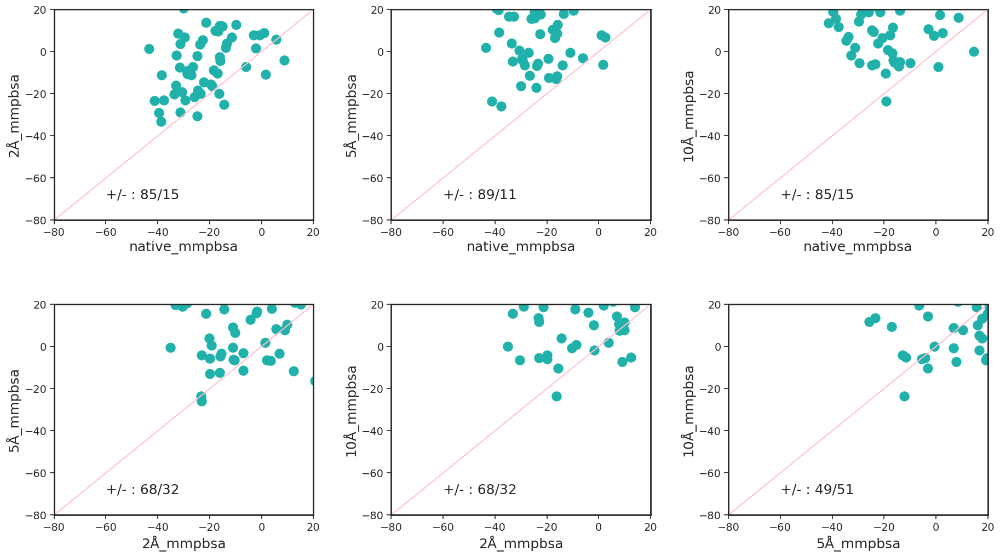

In [252]:
plot_six_mmpbsa_subplot(pbsa_static,
                        name1='static_native',
                        name2='static_2a',
                        name3='static_5a',
                        name4='static_10a',
                        labelx=-60,
                        labely=-70)

## Decompose energy (ELE, VDW, PBSUR, PBSOL)

In [250]:
path_native_de = os.path.join(
    '/data/mdml/neutral_collection/inital_mmpbsa_total/neutral_native_0',
    'total_mmpbsa_de.txt')
pbsa_native_de = pd.read_table(path_native_de, sep='\s+')

path_2a_de = os.path.join(
    '/data/mdml/neutral_collection/inital_mmpbsa_total/neutral_2a_0',
    'total_mmpbsa_de.txt')
pbsa_2a_de = pd.read_table(path_2a_de, sep='\s+')

path_5a_de = os.path.join(
    '/data/mdml/neutral_collection/inital_mmpbsa_total/neutral_5a_0',
    'total_mmpbsa_de.txt')
pbsa_5a_de = pd.read_table(path_5a_de, sep='\s+')

path_10a_de = os.path.join(
    '/data/mdml/neutral_collection/inital_mmpbsa_total/neutral_10a_0',
    'total_mmpbsa_de.txt')
pbsa_10a_de = pd.read_table(path_10a_de, sep='\s+')

In [259]:
pbsa_static_de = pbsa_native_de.merge(pbsa_2a_de, how='left', on='pdbid')
pbsa_static_de = pbsa_static_de.merge(pbsa_5a_de, how='left', on='pdbid')
pbsa_static_de = pbsa_static_de.merge(pbsa_10a_de, how='left', on='pdbid')

# pbsa_static_de=pbsa_static_de.dropna()
pbsa_static_de = pbsa_static_de.merge(
    sel_100_data[['pdbid', 'affinity(-logkd)']], how='left', on='pdbid')

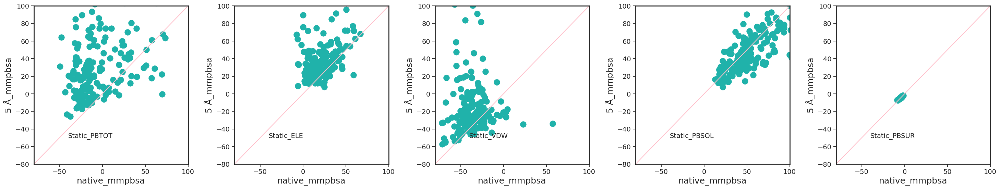

In [260]:
attr = ['ele', 'vdw', 'pbsol', 'pbsur']

plt.figure(figsize=(36, 6))

plt.subplot(1, 5, 1)

plot_contrast_mmpbsa(pbsa_static_de,
                     col1='%s_native' % 'pbtot',
                     col2='%s_5a' % 'pbtot')
plt.text(-40, -50, 'Static_%s' % 'pbtot'.upper(), fontsize=14)

plt.subplot(1, 5, 2)
plot_contrast_mmpbsa(pbsa_static_de,
                     col1='%s_native' % attr[0],
                     col2='%s_5a' % attr[0])
plt.text(-40, -50, 'Static_%s' % attr[0].upper(), fontsize=14)

plt.subplot(1, 5, 3)
plot_contrast_mmpbsa(pbsa_static_de,
                     col1='%s_native' % attr[1],
                     col2='%s_5a' % attr[1])
plt.text(-40, -50, 'Static_%s' % attr[1].upper(), fontsize=14)

plt.subplot(1, 5, 4)
plot_contrast_mmpbsa(pbsa_static_de,
                     col1='%s_native' % attr[2],
                     col2='%s_5a' % attr[2])
plt.text(-40, -50, 'Static_%s' % attr[2].upper(), fontsize=14)

plt.subplot(1, 5, 5)
plot_contrast_mmpbsa(pbsa_static_de,
                     col1='%s_native' % attr[3],
                     col2='%s_5a' % attr[3])
plt.text(-40, -50, 'Static_%s' % attr[3].upper(), fontsize=14)

plt.subplots_adjust(wspace=0.3, hspace=0.4)
plt.savefig('decompose_mmpbsa_static.png',bbox_inches='tight')
plt.show()

<Figure size 1500x1000 with 0 Axes>

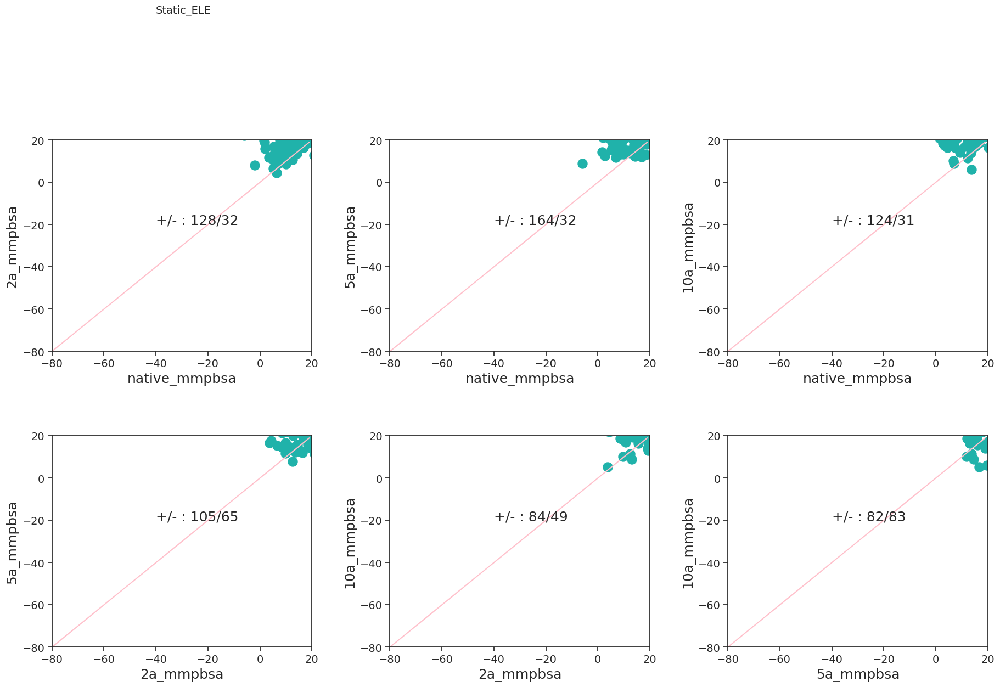

<Figure size 1500x1000 with 0 Axes>

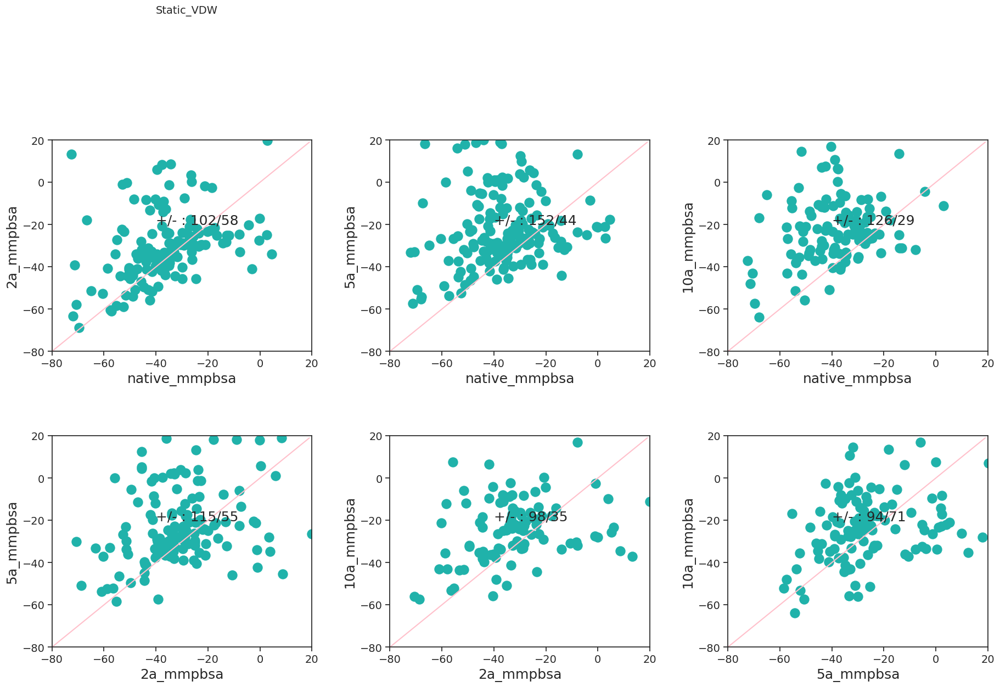

<Figure size 1500x1000 with 0 Axes>

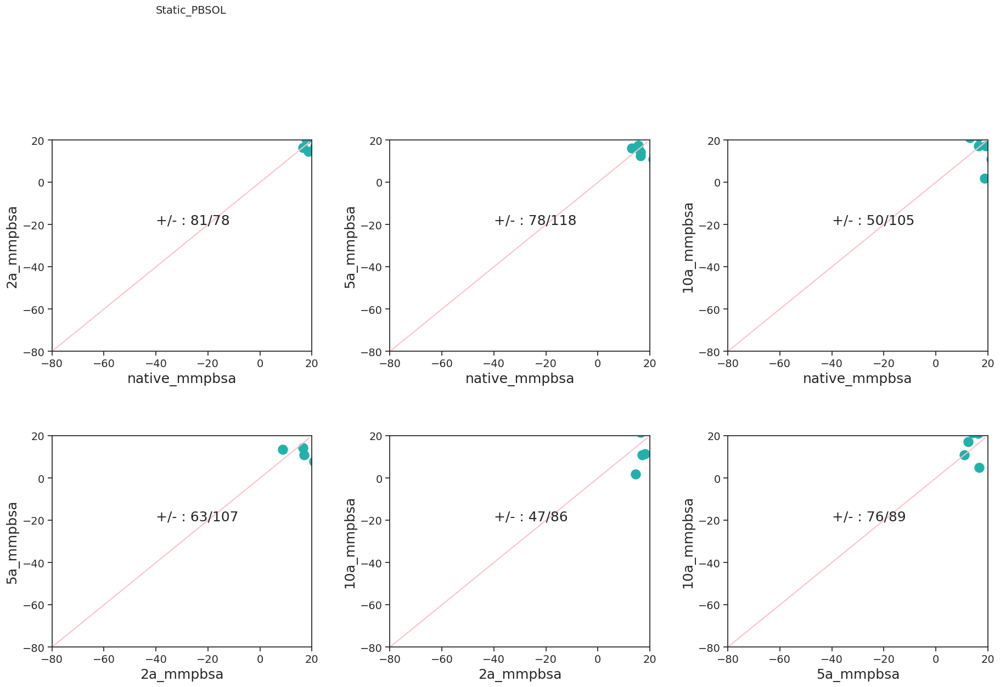

<Figure size 1500x1000 with 0 Axes>

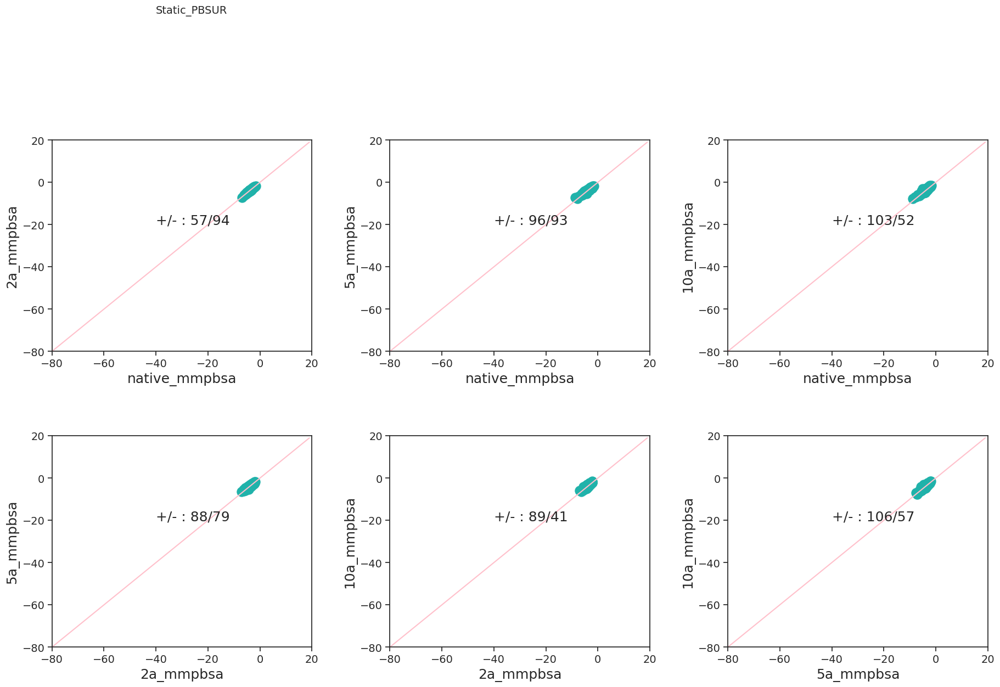

In [112]:
for attr_test in attr:

    plt.figure(figsize=(15, 10))

    gs = gridspec.GridSpec(2, 3)

    plot_six_mmpbsa_subplot(pbsa_static_de,
                            name1='%s_native' % attr_test,
                            name2='%s_2a' % attr_test,
                            name3='%s_5a' % attr_test,
                            name4='%s_10a' % attr_test,
                            decompose='%s' % attr_test,
                            labelx=-40,
                            labely=-20)

## MMPBSA last 5ns

In [69]:
pdblist = sel_100_data['pdbid'].tolist()
errorid_native = []
errorid_2a = []
errorid_5a = []
errorid_10a = []
for id in tqdm(pdblist):
    try:
        pbsa_path_native = os.path.join(path_native, id + 'MD2_neu',
                                        'snapshot_statistics.out.snap')
        pd.read_csv(
            pbsa_path_native, sep='\s+', skiprows=7665, nrows=7666
        ).to_csv(
            os.path.join(
                '/data/mdml/neutral_collection/analysis_all/mmpbsa_result_all',
                id + '_native_mmpbsa_2550.csv'))
    except:
        errorid_native.append(id)
        pass
    try:
        pbsa_path_2a = os.path.join(path_2a, id + 'MD_neu_2a',
                                    'snapshot_statistics.out.snap')
        pd.read_csv(pbsa_path_2a, sep='\s+', skiprows=7665, nrows=7666).to_csv(
            os.path.join(
                '/data/mdml/neutral_collection/analysis_all/mmpbsa_result_all',
                id + '_2a_mmpbsa_2550.csv'))
    except:
        errorid_2a.append(id)
        pass

    try:
        pbsa_path_5a = os.path.join(path_5a, id + 'MD_neu_5a',
                                    'snapshot_statistics.out.snap')
        pd.read_csv(pbsa_path_5a, sep='\s+', skiprows=7665, nrows=7666).to_csv(
            os.path.join(
                '/data/mdml/neutral_collection/analysis_all/mmpbsa_result_all',
                id + '_5a_mmpbsa_2550.csv'))
    except:
        errorid_5a.append(id)
        pass
    try:
        pbsa_path_10a = os.path.join(path_10a, id + 'MD_neu_10a',
                                     'snapshot_statistics.out.snap')
        pd.read_csv(
            pbsa_path_10a, sep='\s+', skiprows=7665, nrows=7666
        ).to_csv(
            os.path.join(
                '/data/mdml/neutral_collection/analysis_all/mmpbsa_result_all',
                id + '_10a_mmpbsa_2550.csv'))
    except:
        errorid_10a.append(id)
        pass

100%|██████████| 100/100 [00:11<00:00,  8.73it/s]


In [261]:
pbsa_last_five = pd.DataFrame(sel_100_data['pdbid'].tolist(),
                              columns=['pdbid'])
pbsa_last_five.loc[:, 'dynamic_native'] = np.nan
pbsa_last_five.loc[:, 'dynamic_2a'] = np.nan
pbsa_last_five.loc[:, 'dynamic_5a'] = np.nan
pbsa_last_five.loc[:, 'dynamic_10a'] = np.nan

# pbsa_last_five=pbsa_last_five.reset_index(drop=True)

mmpbsa_path = '/data/mdml/neutral_collection/analysis_all/mmpbsa_result_all'

cut_min = 2050
cut_max = -1
for id in tqdm(range(len(pbsa_last_five))):
    try:

        pbsa_avg_native = pd.read_csv(
            os.path.join(
                mmpbsa_path, pbsa_last_five['pdbid'][id] +
                '_native_mmpbsa_2550.csv'))['PBTOT'][cut_min:cut_max].mean()
        pbsa_last_five.loc[id, 'dynamic_native'] = pbsa_avg_native

    except:
        pass

    try:
        pbsa_avg_2a = pd.read_csv(
            os.path.join(
                mmpbsa_path, pbsa_last_five['pdbid'][id] +
                '_2a_mmpbsa_2550.csv'))['PBTOT'][cut_min:cut_max].mean()
        pbsa_last_five.loc[id, 'dynamic_2a'] = pbsa_avg_2a
    except:
        pass

    try:
        pbsa_avg_5a = pd.read_csv(
            os.path.join(
                mmpbsa_path, pbsa_last_five['pdbid'][id] +
                '_5a_mmpbsa_2550.csv'))['PBTOT'][cut_min:cut_max].mean()
        pbsa_last_five.loc[id, 'dynamic_5a'] = pbsa_avg_5a
    except:
        pass

    try:
        pbsa_avg_10a = pd.read_csv(
            os.path.join(
                mmpbsa_path, pbsa_last_five['pdbid'][id] +
                '_10a_mmpbsa_2550.csv'))['PBTOT'][cut_min:cut_max].mean()
        pbsa_last_five.loc[id, 'dynamic_10a'] = pbsa_avg_10a

    except:
        pass

pbsa_last_five = pbsa_last_five.merge(
    sel_100_data[['pdbid', 'affinity(-logkd)']], how='left', on='pdbid')
# pbsa_last_five = pbsa_last_five.dropna()

100%|██████████| 100/100 [00:03<00:00, 27.04it/s]


In [71]:
# pbsa_last_five[pbsa_last_five.isnull().T.any()]

,pdbid,dynamic_native,dynamic_2a,dynamic_5a,dynamic_10a,affinity(-logkd)


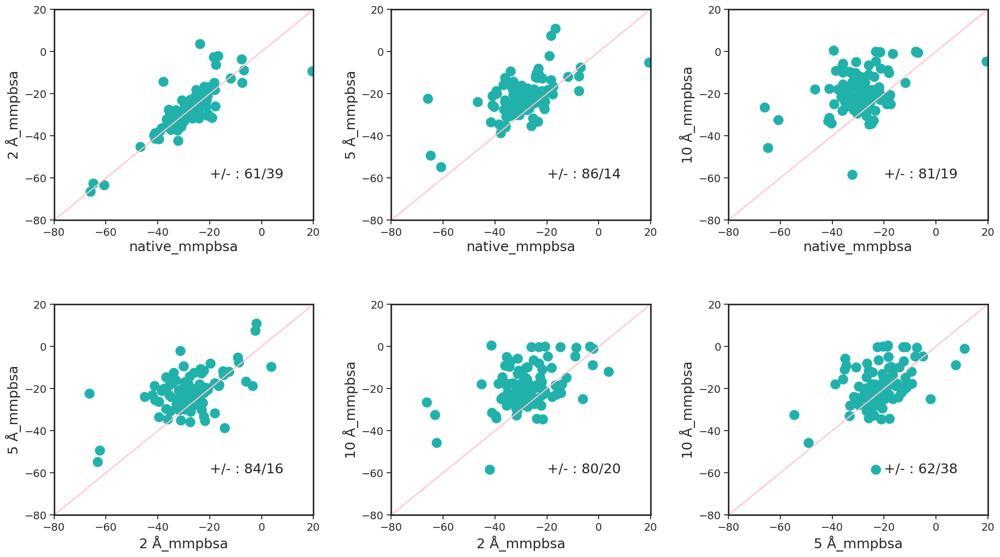

In [263]:
plot_six_mmpbsa_subplot(pbsa_last_five,
                        name1='dynamic_native',
                        name2='dynamic_2a',
                        name3='dynamic_5a',
                        name4='dynamic_10a',
                        x_min=-80,
                        x_max=20,
                        labelx=-20,
                        labely=-60)

#### Compare static and dynamic

In [395]:
pbsa_static_last_five = pbsa_static.merge(pbsa_last_five,
                                          how='left',
                                          on='pdbid')

pbsa_static_last_five = pbsa_static_last_five.dropna()
pbsa_static_last_five = pbsa_static_last_five[[
    'pdbid', 'static_native', 'static_2a', 'static_5a', 'static_10a',
    'affinity(-logkd)_x', 'dynamic_10a', 'dynamic_5a', 'dynamic_2a',
    'dynamic_native'
]]

pbsa_static_last_five=pbsa_static_last_five.rename(columns={'affinity(-logkd)_x':'affinity(-logkd)'})

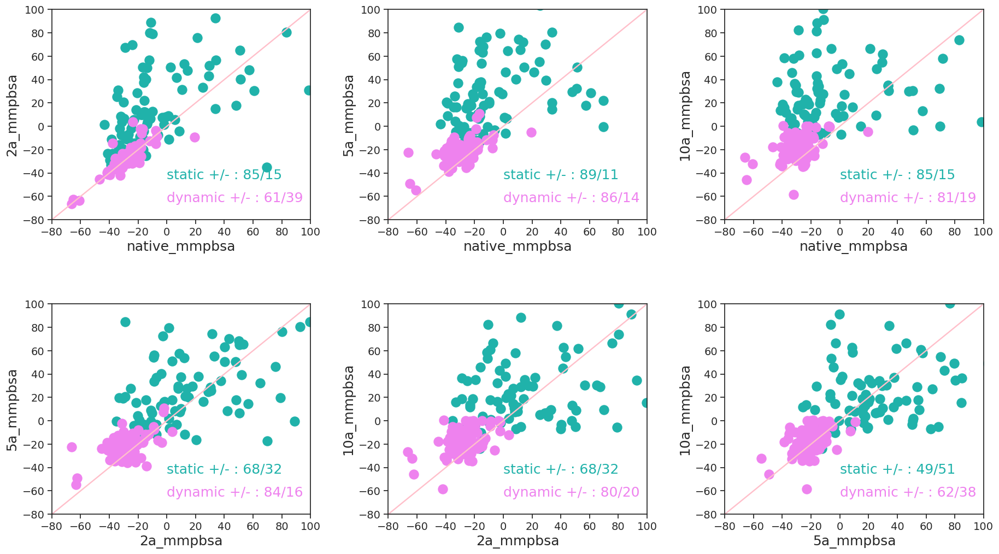

In [396]:
plot_six_mmpbsa_s_d_subplot(pbsa_static_last_five,
                            name1='static_native',
                            name2='static_2a',
                            name3='static_5a',
                            name4='static_10a',
                            color1='lightseagreen',
                            s_color='violet',
                            s_name1='dynamic_native',
                            s_name2='dynamic_2a',
                            s_name3='dynamic_5a',
                            s_name4='dynamic_10a',
                            decompose=False,
                            x_min=-80,
                            x_max=100,
                            labelx=0,
                            labely=-45,
                            labelx2=0,
                            labely2=-65)

## Pearson correlation

In [492]:
list(pbsa_static_last_five)

['pdbid',
 'static_native',
 'static_2a',
 'static_5a',
 'static_10a',
 'affinity(-logkd)',
 'dynamic_10a',
 'dynamic_5a',
 'dynamic_2a',
 'dynamic_native']

<ipython-input-503-931ad1c5d684>:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.zeros_like(pbsa_static_last_five.corr().abs(), dtype=np.bool)


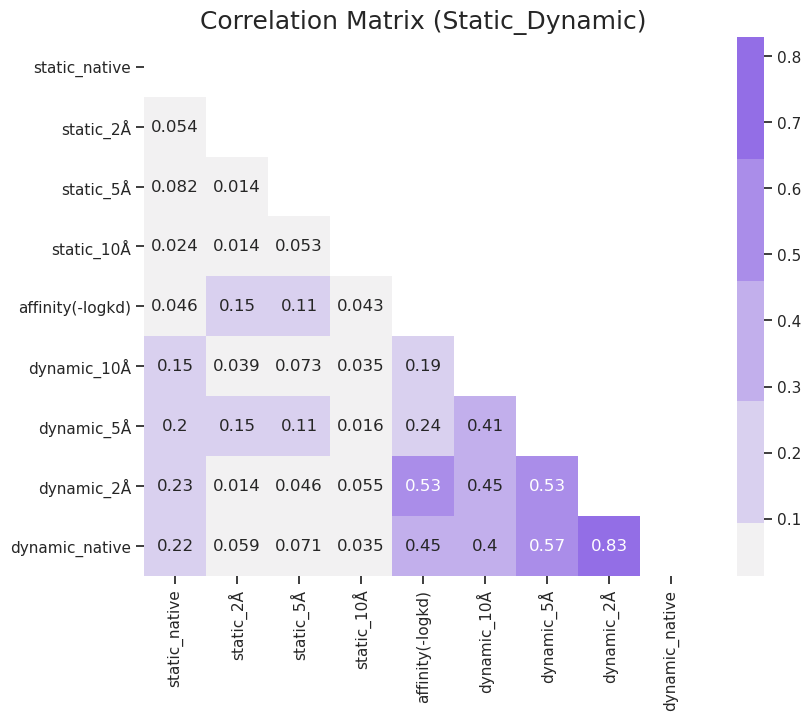

In [503]:
plt.figure(figsize=(9, 7))
mask = np.zeros_like(pbsa_static_last_five.corr().abs(), dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(pbsa_static_last_five.corr().abs(),
            cmap=sns.diverging_palette(150, 275, s=80, l=55, n=9),
            mask=mask,
            annot=True,
            center=0)

plt.xticks([0.5,1.5,2.5,3.5,4.5,5.5,6.5,7.5,8.5],['static_native',
 'static_2Å',
 'static_5Å',
 'static_10Å',
 'affinity(-logkd)',
 'dynamic_10Å',
 'dynamic_5Å',
 'dynamic_2Å',
 'dynamic_native'])
plt.yticks([0.5,1.5,2.5,3.5,4.5,5.5,6.5,7.5,8.5],['static_native',
 'static_2Å',
 'static_5Å',
 'static_10Å',
 'affinity(-logkd)',
 'dynamic_10Å',
 'dynamic_5Å',
 'dynamic_2Å',
 'dynamic_native'])
plt.title("Correlation Matrix (Static_Dynamic)",fontsize=18)
plt.savefig('mmpbsa_staic_dyn_corr_aaa.pdf',bbox_inches='tight')
plt.savefig('mmpbsa_staic_dyn_corr_aaa.png',bbox_inches='tight')
plt.show()

## Total mmpbsa_fig1

In [257]:
def plot_six_mmpbsa_s_d_subplot_test(pdfile,
                            name1='native',
                            name2='2a',
                            name3='5a',
                            name4='10a',
                            color1='salmon',
                            s_color='blue',
                            s_name1='native',
                            s_name2='2a',
                            s_name3='5a',
                            s_name4='10a',
                            decompose=False,
                            x_min=-80,
                            x_max=100,
                            labelx=0,
                            labely=-40,
                            labelx2=0,
                            labely2=-60):

    plt.figure(figsize=(32, 18))
    
    mpl.rcParams['axes.linewidth']=2

    mpl.rcParams['xtick.labelsize']=14
    mpl.rcParams['ytick.labelsize']=14


    mpl.rcParams['axes.labelsize']=18

    plt.subplot(3, 5, 1)

    plot_contrast_mmpbsa(pdfile,
                         col1=name1,
                         col2=name2,
                         color=color1,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             'static +/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name2]]),
                              len(pdfile[pdfile[name1] > pdfile[name2]])),
             fontsize=18, color=color1)
    
    plot_contrast_mmpbsa(pdfile,
                         col1=s_name1,
                         col2=s_name2,
                         color=s_color,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx2,
             labely2,
             'dynamic +/- : %d/%d' % (len(pdfile[pdfile[s_name1] < pdfile[s_name2]]),
                              len(pdfile[pdfile[s_name1] > pdfile[s_name2]])),
             fontsize=18, color=s_color)
    

    plt.subplot(3, 5, 2)
    plot_contrast_mmpbsa(pdfile,
                         col1=name1,
                         col2=name3,
                         color=color1,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             'static +/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name3]]),
                              len(pdfile[pdfile[name1] > pdfile[name3]])),
             fontsize=18, color=color1)
    
    plot_contrast_mmpbsa(pdfile,
                         col1=s_name1,
                         col2=s_name3,
                         color=s_color,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx2,
             labely2,
             'dynamic +/- : %d/%d' % (len(pdfile[pdfile[s_name1] < pdfile[s_name3]]),
                              len(pdfile[pdfile[s_name1] > pdfile[s_name3]])),
             fontsize=18, color=s_color)


    plt.subplot(3, 5, 3)
    plot_contrast_mmpbsa(pdfile,
                         col1=name1,
                         col2=name4,
                         color=color1,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             'static +/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name4]]),
                              len(pdfile[pdfile[name1] > pdfile[name4]])),
             fontsize=18, color=color1)
    
    plot_contrast_mmpbsa(pdfile,
                         col1=s_name1,
                         col2=s_name4,
                         color=s_color,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx2,
             labely2,
             'dynamic +/- : %d/%d' % (len(pdfile[pdfile[s_name1] < pdfile[s_name4]]),
                              len(pdfile[pdfile[s_name1] > pdfile[s_name4]])),
             fontsize=18, color=s_color)


    plt.subplot(3, 5, 6)
    plot_contrast_mmpbsa(pdfile,
                         col1=name2,
                         col2=name3,
                         color=color1,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             'static +/- : %d/%d' % (len(pdfile[pdfile[name2] < pdfile[name3]]),
                              len(pdfile[pdfile[name2] > pdfile[name3]])),
             fontsize=18, color=color1)
    
    plot_contrast_mmpbsa(pdfile,
                         col1=s_name2,
                         col2=s_name3,
                         color=s_color,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx2,
             labely2,
             'dynamic +/- : %d/%d' % (len(pdfile[pdfile[s_name2] < pdfile[s_name3]]),
                              len(pdfile[pdfile[s_name2] > pdfile[s_name3]])),
             fontsize=18, color=s_color)

    plt.subplot(3, 5, 7)
    plot_contrast_mmpbsa(pdfile,
                         col1=name2,
                         col2=name4,
                         color=color1,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             'static +/- : %d/%d' % (len(pdfile[pdfile[name2] < pdfile[name4]]),
                              len(pdfile[pdfile[name2] > pdfile[name4]])),
             fontsize=18, color=color1)
    
    plot_contrast_mmpbsa(pdfile,
                         col1=s_name2,
                         col2=s_name4,
                         color=s_color,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx2,
             labely2,
             'dynamic +/- : %d/%d' % (len(pdfile[pdfile[s_name2] < pdfile[s_name4]]),
                              len(pdfile[pdfile[s_name2] > pdfile[s_name4]])),
             fontsize=18, color=s_color)


    plt.subplot(3, 5, 8)
    plot_contrast_mmpbsa(pdfile,
                         col1=name3,
                         col2=name4,
                         color=color1,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             'static +/- : %d/%d' % (len(pdfile[pdfile[name3] < pdfile[name4]]),
                              len(pdfile[pdfile[name3] > pdfile[name4]])),
             fontsize=18, color=color1)
    
    plot_contrast_mmpbsa(pdfile,
                         col1=s_name3,
                         col2=s_name4,
                         color=s_color,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx2,
             labely2,
             'dynamic +/- : %d/%d' % (len(pdfile[pdfile[s_name3] < pdfile[s_name4]]),
                              len(pdfile[pdfile[s_name3] > pdfile[s_name4]])),
             fontsize=18, color=s_color)

#     plt.subplots_adjust(wspace=0.3, hspace=0.4)

#     # plt.savefig('rmsd_last_5ns.png',bbox_inches='tight')

#     plt.show()

In [258]:
plot_six_mmpbsa_s_d_subplot_test(pbsa_static_last_five,
                            name1='static_native',
                            name2='static_2a',
                            name3='static_5a',
                            name4='static_10a',
                            color1='lightseagreen',
                            s_color='violet',
                            s_name1='dynamic_native',
                            s_name2='dynamic_2a',
                            s_name3='dynamic_5a',
                            s_name4='dynamic_10a',
                            decompose=False,
                            x_min=-80,
                            x_max=100,
                            labelx=-20,
                            labely=-45,
                            labelx2=-20,
                            labely2=-65)

NameError: name 'pbsa_static_last_five' is not defined

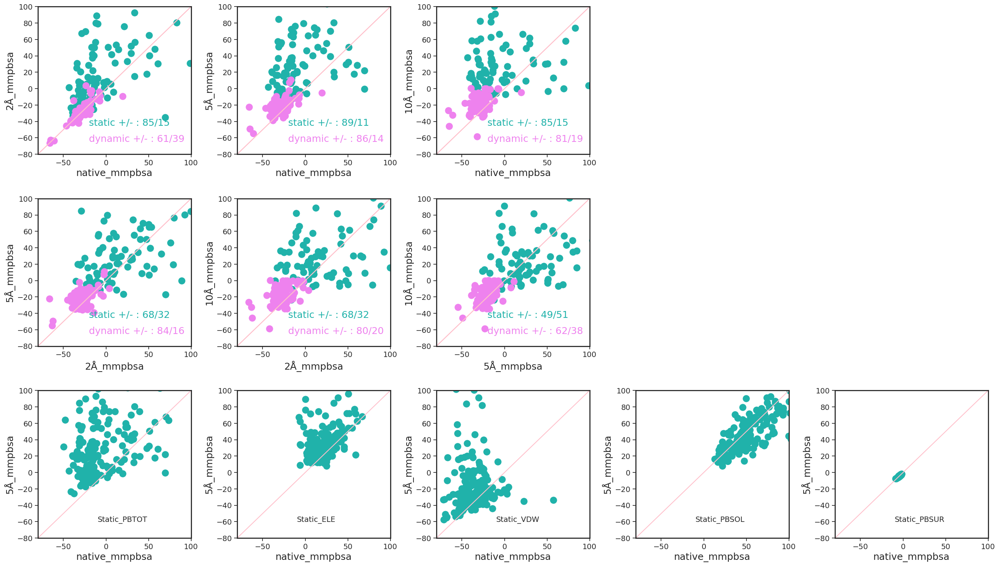

In [625]:
attr = ['ele', 'vdw', 'pbsol', 'pbsur']



plt.subplot(3, 5, 11)

plot_contrast_mmpbsa(pbsa_static_de,
                     col1='%s_native' % 'pbtot',                
                     col2='%s_5a' % 'pbtot')
plt.text(-10, -60, 'Static_%s' % 'pbtot'.upper(), fontsize=14)

plt.subplot(3, 5, 12)
plot_contrast_mmpbsa(pbsa_static_de,
                     col1='%s_native' % attr[0],
                     col2='%s_5a' % attr[0])
plt.text(-10, -60, 'Static_%s' % attr[0].upper(), fontsize=14)

plt.subplot(3, 5, 13)
plot_contrast_mmpbsa(pbsa_static_de,
                     col1='%s_native' % attr[1],
                     col2='%s_5a' % attr[1])
plt.text(-10, -60, 'Static_%s' % attr[1].upper(), fontsize=14)

plt.subplot(3, 5, 14)
plot_contrast_mmpbsa(pbsa_static_de,
                     col1='%s_native' % attr[2],
                     col2='%s_5a' % attr[2])
plt.text(-10, -60, 'Static_%s' % attr[2].upper(), fontsize=14)

plt.subplot(3, 5, 15)
plot_contrast_mmpbsa(pbsa_static_de,
                     col1='%s_native' % attr[3],
                     col2='%s_5a' % attr[3])
plt.text(-10, -60, 'Static_%s' % attr[3].upper(), fontsize=14)

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.savefig('mmpbsa_total.pdf',bbox_inches='tight')
plt.show()

## MMPBSA at different stages (12 2ns)

In [119]:
def mmpbsa_avg(pdbid, x_lower=1500, x_upper=2550):

    mmpbsa_path = '/data/mdml/neutral_collection/analysis_all/mmpbsa_result_all'

    pbsa_native_avg = pd.read_csv(
        os.path.join(
            mmpbsa_path, pdbid +
            '_native_mmpbsa_2550.csv'))['PBTOT'][x_lower:x_upper].mean()
    pbsa_2a_avg = pd.read_csv(
        os.path.join(mmpbsa_path, pdbid +
                     '_2a_mmpbsa_2550.csv'))['PBTOT'][x_lower:x_upper].mean()
    pbsa_5a_avg = pd.read_csv(
        os.path.join(mmpbsa_path, pdbid +
                     '_5a_mmpbsa_2550.csv'))['PBTOT'][x_lower:x_upper].mean()
    pbsa_10a_avg = pd.read_csv(
        os.path.join(mmpbsa_path, pdbid +
                     '_10a_mmpbsa_2550.csv'))['PBTOT'][x_lower:x_upper].mean()

    #     plt.plot(x[:,0],x[:,1],'pink')
    #     plt.plot(y[:,0],y[:,1],'b')
    #     plt.ylim(0,6)
    #     plt.title(pdbid+'_lig_'+str(affinity))
    #     plt.legend(loc='upper left')
    return pbsa_native_avg, pbsa_2a_avg, pbsa_5a_avg, pbsa_10a_avg

In [120]:
def pbsa_12_parts(num_periods=12, pbsa_interval=200, start=0):

    pbsa_periods = pd.DataFrame(sel_100_data['pdbid'].tolist(),
                                columns=['pdbid'])

    for i in range(num_periods):
        pbsa_periods.loc[:, 'native_%d' % i] = np.nan
        pbsa_periods.loc[:, '2a_%d' % i] = np.nan
        pbsa_periods.loc[:, '5a_%d' % i] = np.nan
        pbsa_periods.loc[:, '10a_%d' % i] = np.nan

    for time_num in tqdm(range(num_periods)):
        for i in tqdm(range(len(pbsa_periods))):
            try:
                cols = [
                    'native_%d' % time_num,
                    '2a_%d' % time_num,
                    '5a_%d' % time_num,
                    '10a_%d' % time_num
                ]
                pbsa_periods.loc[i, cols] = mmpbsa_avg(
                    pbsa_periods['pdbid'][i],
                    x_lower=pbsa_interval * time_num,
                    x_upper=pbsa_interval * (time_num + 1))
            except:
                pass
    return pbsa_periods

In [121]:
pbsa_12_data = pbsa_12_parts(num_periods=12, pbsa_interval=200, start=0)

pbsa_12_data.to_csv('pbsa_12_data.csv')

100%|██████████| 12/12 [00:19<00:00,  1.64s/it]


In [122]:
def get_p_n(pdfile, num):
    cols = [
                    'native_%d' % num,
                    '2a_%d' % num,
                    '5a_%d' % num,
                    '10a_%d' % num
                ]

    
    l_n_2_p=len(pdfile[pdfile[cols[0]]<pdfile[cols[1]]])
    l_n_2_n=len(pdfile[pdfile[cols[0]]>pdfile[cols[1]]])
    l_n_5_p=len(pdfile[pdfile[cols[0]]<pdfile[cols[2]]])
    l_n_5_n=len(pdfile[pdfile[cols[0]]>pdfile[cols[2]]])
    l_n_10_p=len(pdfile[pdfile[cols[0]]<pdfile[cols[3]]])
    l_n_10_n=len(pdfile[pdfile[cols[0]]>pdfile[cols[3]]])
    l_2_5_p=len(pdfile[pdfile[cols[1]]<pdfile[cols[2]]])
    l_2_5_n=len(pdfile[pdfile[cols[1]]>pdfile[cols[2]]])
    l_2_10_p=len(pdfile[pdfile[cols[1]]<pdfile[cols[3]]])
    l_2_10_n=len(pdfile[pdfile[cols[1]]>pdfile[cols[3]]])
    l_5_10_p=len(pdfile[pdfile[cols[2]]<pdfile[cols[3]]])
    l_5_10_n=len(pdfile[pdfile[cols[2]]>pdfile[cols[3]]])
        
    return l_n_2_p,l_n_2_n,l_n_5_p,l_n_5_n,l_n_10_p,l_n_10_n,l_2_5_p,l_2_5_n,l_2_10_p,l_2_10_n,l_5_10_p,l_5_10_n


pbsa_12_ratio = pd.DataFrame(sel_100_data['pdbid'].tolist(),
                                columns=['pdbid'])
for time_num in tqdm(range(num_periods)):
#     for i in tqdm(range(len(pbsa_12_ratio))):
    cols = [
        'native_2a_p_%d' % time_num,
        'native_2a_n_%d' % time_num,
        'native_5a_p_%d' % time_num,
        'native_5a_n_%d' % time_num,
        'native_10a_p_%d' % time_num,
        'native_10a_n_%d' % time_num,
        '2a_5a_p_%d' % time_num,
        '2a_5a_n_%d' % time_num,
        '2a_10a_p_%d' % time_num,
        '2a_10a_n_%d' % time_num,
        '5a_10a_p_%d' % time_num,
        '5a_10a_n_%d' % time_num
    ]
    pbsa_12_ratio.loc[:,cols]=np.nan
    pbsa_12_ratio.loc[:,cols]=get_p_n(pbsa_12_data, time_num)
    

    
pbsa_12_ratio.to_csv('pbsa_12_ratio.csv')    


100%|██████████| 12/12 [00:00<00:00, 144.03it/s]


In [123]:
 pbsa_12_data

,pdbid,native_0,2a_0,5a_0,10a_0,native_1,2a_1,5a_1,10a_1,native_2,...,5a_9,10a_9,native_10,2a_10,5a_10,10a_10,native_11,2a_11,5a_11,10a_11
0,4xtx,-66.22445,-73.09545,-50.58355,-29.53805,-71.00350,-75.89645,-53.51025,-34.90995,-73.48500,...,-48.31165,-31.64845,-60.58140,-67.65185,-52.42605,-39.24470,-60.19845,-63.17910,-57.11350,-33.69725
1,4rfm,-34.24240,-33.47485,-21.31195,-16.44755,-31.56580,-34.95520,-21.09895,-14.02800,-31.22140,...,-17.13155,-17.71270,-34.00420,-33.99030,-15.51635,-18.34095,-34.73935,-35.06040,-14.26060,-17.40665
2,4xtz,-67.12275,-73.45095,-56.08960,-36.16960,-67.39200,-76.52875,-53.41765,-41.49950,-67.83210,...,-55.33310,-46.34485,-65.40850,-61.53615,-46.16530,-45.85250,-63.71850,-63.31505,-49.38065,-45.71245
3,3lxk,-37.04365,-34.98470,-22.99170,-11.53915,-40.75065,-37.21610,-20.42030,-10.75695,-39.20245,...,-17.38270,0.34685,-39.29095,-40.80315,-19.11835,0.69630,-39.40015,-41.66765,-18.13510,0.52235
4,4cd0,-39.68135,-36.55385,-24.15045,-29.23300,-41.26200,-37.64695,-23.91070,-32.46285,-40.88865,...,-25.21965,-29.98975,-43.25300,-41.44530,-26.28360,-30.59980,-40.91785,-41.08735,-26.12980,-32.10065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,6gjr,-26.55875,-13.65385,-18.11165,-18.16790,-26.39010,-10.50130,-19.18845,-19.99335,-27.85075,...,-24.76795,-14.60805,-27.55340,-23.64305,-26.45235,-10.77910,-28.57245,-21.82480,-27.36235,-15.59450
96,3isj,-20.55440,-17.30400,-19.80470,-21.55330,-14.18450,-13.37865,-22.13555,-17.98065,-14.32525,...,-16.91930,-26.54695,-16.43970,-15.40405,-16.26385,-28.06500,-18.47535,-14.45265,-12.53950,-20.68050
97,4b3b,-29.71525,-30.71540,-40.95945,-11.20690,-29.42165,-29.33440,-39.50680,-10.78865,-30.25070,...,-26.69150,-22.31700,-24.95210,-19.06940,-24.28495,-21.41405,-26.55210,-17.06290,-32.08275,-22.68425
98,1pzp,-24.64080,-23.94790,-18.93090,-25.90385,-34.03840,-24.12925,-21.27455,-25.84185,-35.69620,...,-25.51945,-32.14075,-29.87965,-24.68480,-23.39690,-28.85435,-31.53485,-24.99465,-23.34390,-26.89600


In [611]:
x=[i*2+1 for i in range(12)]
def draw_pbsa_four(pdfile, pdbid):
    aa_native_cols = ['native_%d' % i for i in range(interval_num)]
    aa_native_values = pdfile[pdfile['pdbid'] ==
                              pdbid][aa_native_cols].values[0]
    f_native, = plt.plot(x, aa_native_values, color=color_native,linewidth=3)

    aa_2a_cols = ['2a_%d' % i for i in range(interval_num)]
    aa_2a_values = pdfile[pdfile['pdbid'] == pdbid][aa_2a_cols].values[0]
    f_2a, = plt.plot(x, aa_2a_values, color=color_2a,linewidth=3)

    aa_5a_cols = ['5a_%d' % i for i in range(interval_num)]
    aa_5a_values = pdfile[pdfile['pdbid'] == pdbid][aa_5a_cols].values[0]
    f_5a, = plt.plot(x, aa_5a_values, color=color_5a,linewidth=3)
    aa_10a_cols = ['10a_%d' % i for i in range(interval_num)]
    aa_10a_values = pdfile[pdfile['pdbid'] == pdbid][aa_10a_cols].values[0]
    f_10a, = plt.plot(x, aa_10a_values, color=color_10a,linewidth=3)
    plt.title(pdbid,fontsize=18)
    plt.xlabel('Time (2ns)',fontsize=18)
    plt.ylabel('MMPBSA',fontsize=18)

    plt.legend(handles=[f_native, f_2a, f_5a, f_10a],
               labels=['native', '2a', '5a', '10a'],
               loc='best')



#     plt.show()

In [30]:
pbsa_fail = []
for i in tqdm(sel_100_data['pdbid'].tolist()):
    try:
        draw_pbsa_four(pbsa_12_data, i)
    except:
        pbsa_fail.append(i)
        pass

## Mean, stand deviation, max, min, median

In [129]:
quality=['mean','std','max','min','median']

for id in tqdm(quality) :
    pbsa_12_data.loc[:, 'native_%s' % id]=np.nan
    pbsa_12_data.loc[:, '2a_%s' % id]=np.nan
    pbsa_12_data.loc[:, '5a_%s' % id]=np.nan
    pbsa_12_data.loc[:, '10a_%s' % id]=np.nan

100%|██████████| 5/5 [00:00<00:00, 309.69it/s]


In [130]:
for i in tqdm(range(len(pbsa_12_data))):

        bb_native_cols=['native_%d' % j for j in range(12)]
        bb_native_values_T=pbsa_12_data[pbsa_12_data['pdbid']==pbsa_12_data['pdbid'][i]][bb_native_cols].T
        native_ana_col=['native_%s' % j for j in quality]
        pbsa_12_data.loc[i,native_ana_col]=[bb_native_values_T.mean().values[0],bb_native_values_T.std().values[0],bb_native_values_T.max().values[0],bb_native_values_T.min().values[0],bb_native_values_T.median().values[0]]



        bb_2a_cols=['2a_%d' % j for j in range(12)]
        bb_2a_values_T=pbsa_12_data[pbsa_12_data['pdbid']==pbsa_12_data['pdbid'][i]][bb_2a_cols].T
        bb_2a_ana_col=['2a_%s' % j for j in quality]
        pbsa_12_data.loc[i,bb_2a_ana_col]=bb_2a_values_T.mean().values[0],bb_2a_values_T.std().values[0],bb_2a_values_T.max().values[0],bb_2a_values_T.min().values[0],bb_2a_values_T.median().values[0]




        bb_5a_cols=['5a_%d' % j for j in range(12)]
        bb_5a_values_T=pbsa_12_data[pbsa_12_data['pdbid']==pbsa_12_data['pdbid'][i]][bb_5a_cols].T
        bb_5a_ana_col=['5a_%s' % j for j in quality]
        pbsa_12_data.loc[i,bb_5a_ana_col]=bb_5a_values_T.mean().values[0],bb_5a_values_T.std().values[0],bb_5a_values_T.max().values[0],bb_5a_values_T.min().values[0],bb_5a_values_T.median().values[0]





        bb_10a_cols=['10a_%d' % j for j in range(12)]
        bb_10a_values_T=pbsa_12_data[pbsa_12_data['pdbid']==pbsa_12_data['pdbid'][i]][bb_10a_cols].T
        bb_10a_ana_col=['10a_%s' % j for j in quality]
        pbsa_12_data.loc[i,bb_10a_ana_col]=bb_10a_values_T.mean().values[0],bb_10a_values_T.std().values[0],bb_10a_values_T.max().values[0],bb_10a_values_T.min().values[0],bb_10a_values_T.median().values[0]





100%|██████████| 100/100 [00:01<00:00, 89.04it/s]


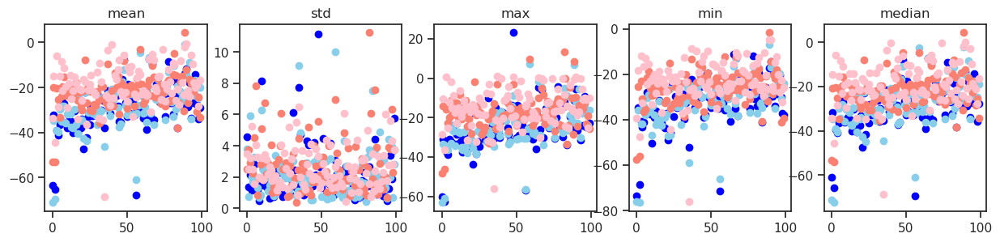

In [131]:
x_asix=[i for i in range(len(pbsa_12_data))]
plt.figure(figsize=(15,3))
for i,j in enumerate(quality):
    plt.subplot(1,5,i+1)
    plt.scatter(x_asix,pbsa_12_data['native_%s' % quality[i]],c=color_native)
    plt.scatter(x_asix,pbsa_12_data['2a_%s' % quality[i]],c=color_2a)
    plt.scatter(x_asix,pbsa_12_data['5a_%s' % quality[i]],c=color_5a)
    plt.scatter(x_asix,pbsa_12_data['10a_%s' % quality[i]],c=color_10a)
    plt.title(quality[i])
    
plt.show()


In [132]:
aaa=pbsa_12_data[pbsa_12_data['native_max']<pbsa_12_data['native_min']+4]['pdbid'].tolist()
bbb=pbsa_last_five[pbsa_last_five['pdbid'].isin(aaa)]
bbb.corr()

,dynamic_native,dynamic_2a,dynamic_5a,dynamic_10a,affinity(-logkd)
dynamic_native,1.000000,0.904851,0.149130,-0.038867,-0.531707
dynamic_2a,0.904851,1.000000,0.007479,-0.052981,-0.522902
dynamic_5a,0.149130,0.007479,1.000000,0.332484,-0.017452
dynamic_10a,-0.038867,-0.052981,0.332484,1.000000,0.091445
affinity(-logkd),-0.531707,-0.522902,-0.017452,0.091445,1.000000


#### Positive and Negative

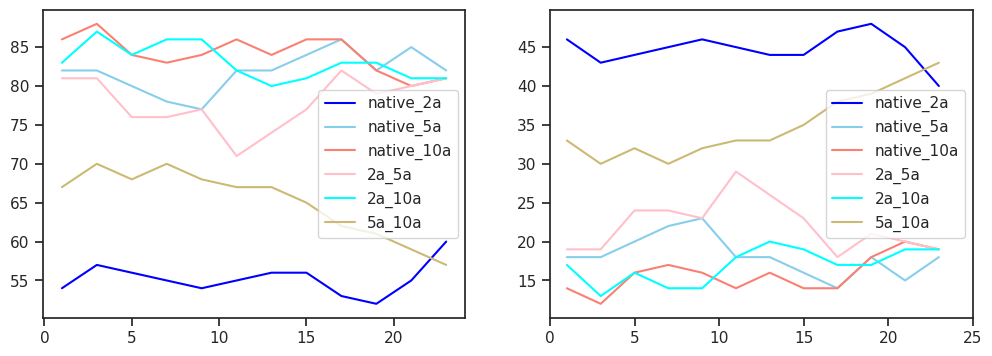

In [133]:
ppp=pbsa_12_ratio[list(pbsa_12_ratio)[1:]].mean().values
    
plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
x=[i*2+1 for i in range(12)]
plt.plot(x, [ppp[m*12+0] for m in range(12)],c=color_native)
plt.plot(x, [ppp[m*12+2] for m in range(12)],c=color_2a)
plt.plot(x, [ppp[m*12+4] for m in range(12)],c=color_5a)
plt.plot(x, [ppp[m*12+6] for m in range(12)],c=color_10a)
plt.plot(x, [ppp[m*12+8] for m in range(12)],c='cyan')
plt.plot(x, [ppp[m*12+10] for m in range(12)],c='y')


plt.legend(
           labels=['native_2a', 'native_5a', 'native_10a', '2a_5a','2a_10a','5a_10a'],
           loc='best')

# plt.legend(
#            labels=['native_5a', 'native_10a', '5a_10a'],
#            loc='best')

plt.subplot(1,2,2)
plt.plot(x, [ppp[m*12+1] for m in range(12)],c=color_native)
plt.plot(x, [ppp[m*12+3] for m in range(12)],c=color_2a)
plt.plot(x, [ppp[m*12+5] for m in range(12)],c=color_5a)
plt.plot(x, [ppp[m*12+7] for m in range(12)],c=color_10a)
plt.plot(x, [ppp[m*12+9] for m in range(12)],c='cyan')
plt.plot(x, [ppp[m*12+11] for m in range(12)],c='y')


plt.legend(
           labels=['native_2a', 'native_5a', 'native_10a', '2a_5a','2a_10a','5a_10a'],
           loc='best')
# plt.legend(
#            labels=['native_5a', 'native_10a', '5a_10a'],
#            loc='best')


plt.xlim(0,25)
plt.show()

<ipython-input-134-10f471e44c6c>:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  kkk=pbsa_12_data.mean().values


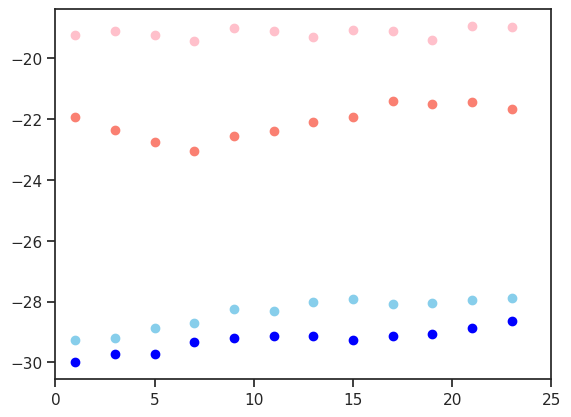

In [134]:
kkk=pbsa_12_data.mean().values
x=[i*2+1 for i in range(12)]
plt.scatter(x, [kkk[m*4+0] for m in range(12)],c=color_native)
plt.scatter(x, [kkk[m*4+1] for m in range(12)],c=color_2a)
plt.scatter(x, [kkk[m*4+2] for m in range(12)],c=color_5a)
plt.scatter(x, [kkk[m*4+3] for m in range(12)],c=color_10a)
plt.xlim(0,25)
plt.show()

### Pearson correlation of 12 periods

In [135]:
pbsa_12_data_drop=pbsa_12_data.merge(sel_100_data[['pdbid','affinity(-logkd)']], how='left', on='pdbid').dropna()


pbsa_12_data_drop=pbsa_12_data_drop.reset_index(drop=True)

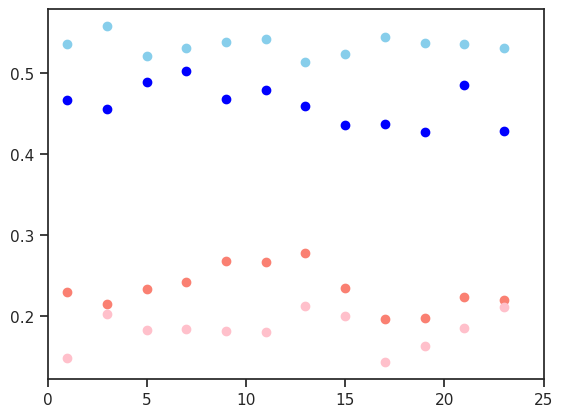

In [136]:
kkk=pbsa_12_data_drop.corr().abs().values[:,-1]
x=[i*2+1 for i in range(12)]
plt.scatter(x, [kkk[m*4+0] for m in range(12)],c=color_native)
plt.scatter(x, [kkk[m*4+1] for m in range(12)],c=color_2a)
plt.scatter(x, [kkk[m*4+2] for m in range(12)],c=color_5a)
plt.scatter(x, [kkk[m*4+3] for m in range(12)],c=color_10a)
plt.xlim(0,25)
plt.show()

<ipython-input-650-34ea150a42d5>:32: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  kkk=pbsa_12_data.mean().values


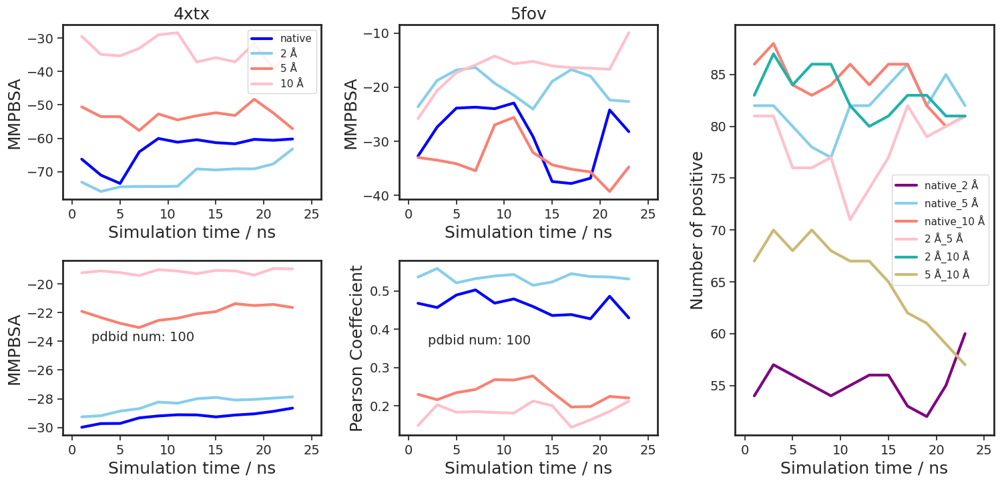

In [650]:
plt.figure(figsize=(18,8))

mpl.rcParams['axes.linewidth']=2

mpl.rcParams['xtick.labelsize']=14
mpl.rcParams['ytick.labelsize']=14


mpl.rcParams['axes.labelsize']=18


plt.subplot2grid((2,3),(0,0))
draw_pbsa_four(pbsa_12_data,'4xtx')
plt.legend(labels=['native', '2 Å', '5 Å', '10 Å'],
               loc='best')
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Simulation time / ns',fontsize=18)
plt.xlim(-1, 26)


plt.subplot2grid((2,3),(0,1))
draw_pbsa_four(pbsa_12_data,'5fov')
plt.xlabel('Simulation time / ns',fontsize=18)
plt.legend('',frameon=False)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlim(-1, 26)


plt.subplot2grid((2,3),(1,0))
kkk=pbsa_12_data.mean().values
x=[i*2+1 for i in range(12)]
plt.plot(x, [kkk[m*4+0] for m in range(12)],c=color_native,linewidth=3)
plt.plot(x, [kkk[m*4+1] for m in range(12)],c=color_2a,linewidth=3)
plt.plot(x, [kkk[m*4+2] for m in range(12)],c=color_5a,linewidth=3)
plt.plot(x, [kkk[m*4+3] for m in range(12)],c=color_10a,linewidth=3)
plt.xlim(-1, 26)
y_major_locator = MultipleLocator(2)
ax = plt.gca()
ax.yaxis.set_major_locator(y_major_locator)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.text(2,-24,'pdbid num: 100', fontsize=14)
plt.xlabel('Simulation time / ns',fontsize=18)
plt.ylabel('MMPBSA',fontsize=18)


plt.subplot2grid((2,3),(1,1))

kkk=pbsa_12_data_drop.corr().abs().values[:,-1]

plt.plot(x, [kkk[m*4+0] for m in range(12)],color=color_native,linewidth=3)
plt.plot(x, [kkk[m*4+1] for m in range(12)],color=color_2a,linewidth=3)
plt.plot(x, [kkk[m*4+2] for m in range(12)],color=color_5a,linewidth=3)
plt.plot(x, [kkk[m*4+3] for m in range(12)],color=color_10a,linewidth=3)
plt.xlim(-1, 26)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.text(2,0.36,'pdbid num: 100', fontsize=14)
plt.ylabel('Pearson Coeffecient',fontsize=18)

plt.legend(labels=['native', '2 Å', '5 Å', '10 Å'],
               loc='best')
plt.legend('',frameon=False)

plt.xlabel('Simulation time / ns',fontsize=18)



plt.subplot2grid((2,3),(0,2),rowspan=2)
ppp=pbsa_12_ratio[list(pbsa_12_ratio)[1:]].mean().values

plt.plot(x, [ppp[m*12+0] for m in range(12)],c='purple',linewidth=3)
plt.plot(x, [ppp[m*12+2] for m in range(12)],c=color_2a,linewidth=3)
plt.plot(x, [ppp[m*12+4] for m in range(12)],c=color_5a,linewidth=3)
plt.plot(x, [ppp[m*12+6] for m in range(12)],c=color_10a,linewidth=3)
plt.plot(x, [ppp[m*12+8] for m in range(12)],c='lightseagreen',linewidth=3)
plt.plot(x, [ppp[m*12+10] for m in range(12)],c='y',linewidth=3)
plt.xlim(-1, 26)

plt.legend(
           labels=['native_2 Å', 'native_5 Å', 'native_10 Å', '2 Å_5 Å','2 Å_10 Å','5 Å_10 Å'],
           loc='right')

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.ylabel('Number of positive',fontsize=18)
plt.xlabel('Simulation time / ns',fontsize=18)

# plt.legend(loc="lower left")



plt.subplots_adjust(wspace=0.3,hspace=0.35)
plt.savefig('mmpbsa_12.pdf',bbox_inches='tight')
plt.savefig('mmpbsa_12.png',bbox_inches='tight')
plt.show()

# Vina

In [143]:
def plot_contrast_vina(pdfile,col1='native',col2='5a',x_min=-14,x_max=1):

    plt.scatter(pdfile[col1],pdfile[col2],cmap=plt.get_cmap('winter'))

    plt.plot([i for i in range(x_min, x_max, 1)],[i for i in range(x_min, x_max, 1)])
#     plt.plot([i+5 for i in range(x_min, x_max, 1)],[i for i in range(x_min, x_max, 1)])
#     plt.plot([i-5 for i in range(x_min, x_max, 1)],[i for i in range(x_min, x_max, 1)])
    plt.xlabel('%s_vina' % col1,fontsize=18)
    plt.ylabel('%s_vina' % col2,fontsize=18)
#     plt.title('RMSD reference to first frame (near 5ns)',fontsize=18)
    plt.xlim(x_min,x_max)
    plt.ylim(x_min,x_max)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
#     plt.colorbar()
#     plt.show()

In [144]:
def plot_six_vina_subplot(pdfile,
                            name1='native',
                            name2='2a',
                            name3='5a',
                            name4='10a',
                            x_min=-15,
                            x_max=2,
                            labelx=-6,
                            labely=-12):

    plt.figure(figsize=(22, 12))

    plt.subplot(2, 3, 1)

    plot_contrast_vina(pdfile,
                         col1=name1,
                         col2=name2,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name2]]),
                              len(pdfile[pdfile[name1] > pdfile[name2]])),
             fontsize=18)

    plt.subplot(2, 3, 2)
    plot_contrast_vina(pdfile,
                         col1=name1,
                         col2=name3,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name3]]),
                              len(pdfile[pdfile[name1] > pdfile[name3]])),
             fontsize=18)

    plt.subplot(2, 3, 3)
    plot_contrast_vina(pdfile,
                         col1=name1,
                         col2=name4,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name1] < pdfile[name4]]),
                              len(pdfile[pdfile[name1] > pdfile[name4]])),
             fontsize=18)

    plt.subplot(2, 3, 4)
    plot_contrast_vina(pdfile,
                         col1=name2,
                         col2=name3,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name2] < pdfile[name3]]),
                              len(pdfile[pdfile[name2] > pdfile[name3]])),
             fontsize=18)

    plt.subplot(2, 3, 5)
    plot_contrast_vina(pdfile,
                         col1=name2,
                         col2=name4,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name2] < pdfile[name4]]),
                              len(pdfile[pdfile[name2] > pdfile[name4]])),
             fontsize=18)

    plt.subplot(2, 3, 6)
    plot_contrast_vina(pdfile,
                         col1=name3,
                         col2=name4,
                         x_min=x_min,
                         x_max=x_max)
    plt.text(labelx,
             labely,
             '+/- : %d/%d' % (len(pdfile[pdfile[name3] < pdfile[name4]]),
                              len(pdfile[pdfile[name3] > pdfile[name4]])),
             fontsize=18)

    plt.subplots_adjust(wspace=0.3, hspace=0.4)

    # plt.savefig('rmsd_last_5ns.png',bbox_inches='tight')

    plt.show()

## Dock 1 from origin dock

In [32]:
vina_data=pd.read_csv('final_sel_100.csv')

vina_2a=vina_data[vina_data['origin_rmsd']<3]
vina_5a=vina_data[(vina_data['origin_rmsd']>3) & (vina_data['origin_rmsd']<6)]
vina_10a=vina_data[vina_data['origin_rmsd']>6]

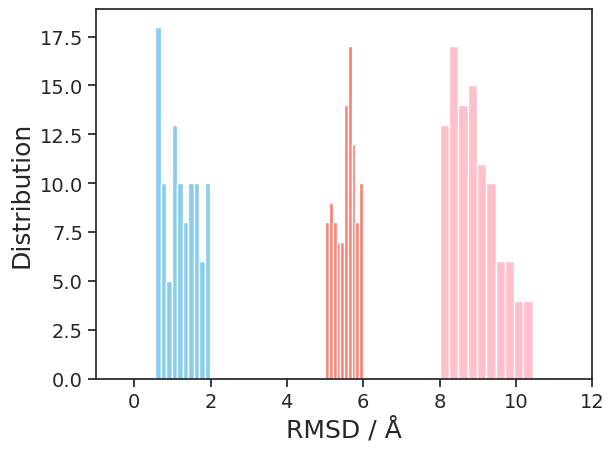

In [33]:
# plt.hist(vina_native_aa['rmsd'])
plt.hist(vina_2a['origin_rmsd'],color=color_2a)
plt.hist(vina_5a['origin_rmsd'],color=color_5a)
plt.hist(vina_10a['origin_rmsd'],color=color_10a)
plt.xlim(-1,12)
plt.xlabel('RMSD / Å', fontsize=18)
plt.ylabel('Distribution', fontsize=18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
# plt.subplots_adjust(wspace=0.3, hspace=0.3)

plt.savefig('fig_si_dock_distribution_three.pdf', bbox_inches='tight')

# plt.savefig('rmsd_last_5ns_3.png', bbox_inches='tight')

plt.show()


## compare four poses

In [36]:
vina_native_aa=pd.read_csv('../native_100.csv')
vina_a=pd.DataFrame(sel_100_order,columns=['pdbid'])
vina_a['vina_native']=np.nan
vina_a['vina_2a']=np.nan
vina_a['vina_5a']=np.nan
vina_a['vina_10a']=np.nan
for i in tqdm(range(len(vina_a))):

        id=vina_a['pdbid'][i]
        value_native=vina_native_aa[vina_native_aa['pdbid']==id]['energy'].values[0]
        value_2a=vina_2a[vina_2a['pdbid']==id]['dock_score'].values[0]
        value_5a=vina_5a[vina_5a['pdbid']==id]['dock_score'].values[0]
        value_10a=vina_10a[vina_10a['pdbid']==id]['dock_score'].values[0]
        vina_a.loc[i,['vina_native','vina_2a','vina_5a','vina_10a']]=[value_native, value_2a, value_5a, value_10a]


vina_total=vina_a


100%|██████████| 100/100 [00:00<00:00, 425.62it/s]


In [62]:
vina_total=vina_a

## statistic rank

In [63]:
vina_total=vina_total[['pdbid','vina_native','vina_5a','vina_10a']]
vina_total.loc[:,'order_native']=np.nan
vina_total.loc[:,'order_5a']=np.nan
vina_total.loc[:,'order_10a']=np.nan

for i in range(len(vina_total)):
    vina_total.loc[i,['order_native','order_5a','order_10a']]=list(vina_total.iloc[i][['vina_native','vina_5a','vina_10a']].T.rank().values)

In [64]:
vina_total_sel=vina_total[list(vina_total)[-3:]]


counts_2a=vina_total_sel['order_native'].value_counts()
cts_2a=pd.DataFrame(counts_2a.values,columns=['native'])
cts_2a.loc[:,'pose']=counts_2a.index.values
counts_5a=vina_total_sel['order_5a'].value_counts()
cts_5a=pd.DataFrame(counts_5a.values,columns=['5a'])
cts_5a.loc[:,'pose']=counts_5a.index.values
counts_10a=vina_total_sel['order_10a'].value_counts()
cts_10a=pd.DataFrame(counts_10a.values,columns=['10a'])
cts_10a.loc[:,'pose']=counts_10a.index.values



cts_total=cts_2a.merge(cts_5a,how='left',on='pose')
cts_total=cts_total.merge(cts_10a,how='left',on='pose')

In [65]:
cts_total=cts_total[['pose', 'native','5a', '10a']]
cts_total=cts_total.sort_values(by='pose')
# cts_total.loc[:,'pose']=[1,2,3]
# cts_total=cts_total.rename({0:1.0,3:1.5,1:2.0,4:2.5,2:3.0})
# cols=list(cts_total)

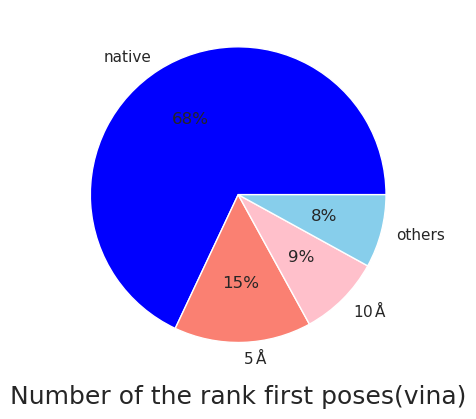

In [66]:
def make_autopct(values):
    def my_autopct(pct):
        total = sum(values)
#         total=100.0
        val = int(round(pct*total/100.0))
        # 同时显示数值和占比的饼图
        return '{p:.0f}%'.format(p=pct)
    return my_autopct



# def func(pct):

#     return "{:.1f}%\n".format(pct)

# labels=['rank1','rank2','rank3','rank4']

xx=np.append(cts_total.T[0].values[1:],100-cts_total.T[0][1:].sum())

labels=['native','$5\,\mathrm{\AA}$','$10\,\mathrm{\AA}$','others']
plt.pie(xx, autopct=make_autopct(xx),labels=labels,colors=[color_native, color_5a,color_10a, color_2a])

plt.xlabel('Number of the rank first poses(vina)',fontsize=18)
plt.savefig('pie_native.png')
plt.show()

# PLIP section

In [181]:
plip_int_types = ['hydrophobic_interactions', 'hydrogen_bonds', 'water_bridges', 'salt_bridges', 'pi_stacks', 'pi_cation_interactions', 'halogen_bonds' ]# 'metal_complexes']
plip_int_types_name = ['hydrophobic', 'hydrogen_bonds', 'water_bridges', 'salt_bridges', 'pi_stacks', 'pi_cation', 'halogen_bonds' ]# 'metal_complexes']


In [182]:
def plot_contrast_plip(pdfile,col1='native',col2='5a',x_min=-1,x_max=15):

    plt.scatter(pdfile[col1],pdfile[col2],cmap=plt.get_cmap('winter'))

    plt.plot([i for i in range(x_min, x_max, 1)],[i for i in range(x_min, x_max, 1)])
    plt.plot([i+5 for i in range(x_min, x_max, 1)],[i for i in range(x_min, x_max, 1)])
    plt.plot([i-5 for i in range(x_min, x_max, 1)],[i for i in range(x_min, x_max, 1)])
    plt.xlabel('%s' % col1.split('_')[-1])
    plt.ylabel('%s' % col2.split('_')[-1])
#     plt.title('RMSD reference to first frame (near 5ns)',fontsize=18)
    plt.xlim(x_min,x_max)
    plt.ylim(x_min,x_max)
    plt.text(8,2,'+/- : %d/%d' % (len(pdfile[pdfile[col1]>pdfile[col2]]), len(pdfile[pdfile[col1]<pdfile[col2]])),fontsize=14)

#     plt.xticks(fontsize=14)
#     plt.yticks(fontsize=14)
#     plt.colorbar()
#     plt.show()

In [183]:
def decompose_inter(g0, value=True,cri=0.0):
    g0_hydrophobic = g0[g0['interaction_type'] == plip_int_types[0]]
    g0_hydrogen = g0[g0['interaction_type'] == plip_int_types[1]]
    g0_water = g0[g0['interaction_type'] == plip_int_types[2]]
    g0_salt = g0[g0['interaction_type'] == plip_int_types[3]]
    g0_pi_stack = g0[g0['interaction_type'] == plip_int_types[4]]
    g0_pi_cation = g0[g0['interaction_type'] == plip_int_types[5]]
    g0_halogen = g0[g0['interaction_type'] == plip_int_types[6]]

    if value:
#         return g0_hydrophobic, g0_hydrogen, g0_water, g0_salt, g0_pi_stack, g0_pi_cation, g0_halogen
        return g0_hydrophobic[g0_hydrophobic['0']>cri], g0_hydrogen[g0_hydrogen['0']>cri], g0_water[g0_water['0']>cri], g0_salt[g0_salt['0']>cri], g0_pi_stack[g0_pi_stack['0']>cri], g0_pi_cation[g0_pi_cation['0']>cri], g0_halogen[g0_halogen['0']>cri]
    else:
        return len(g0_hydrophobic), len(g0_hydrogen), len(g0_water), len(
            g0_salt), len(g0_pi_stack), len(g0_pi_cation), len(g0_halogen)


## Translate xml from plip into csv

In [184]:



def strip_s(x):
    if x != 'metal_complexes':
        return x[:-1]
    return x[:-2]

def collect_plip_info(plip):
    ret = []

    bs_list = plip['report']['bindingsite']
    if type(bs_list) is not list:
        bs_list = [bs_list]
    for bs in bs_list:
        ints = bs['interactions']
        for k in plip_int_types:
            if ints[k]:
                assert len(ints[k]) == 1
                ints_ = ints[k][strip_s(k)]
                if type(ints_) is not list:
                    ints_ = [ints_]
                for x in ints_:
                    ret.append(
                        dict({'interaction_type': k},**x))
    return ret



## Static plip

In [217]:
def collect_interaction_static(pdbid, md_native_true=False, md_2a_true=False, md_5a_true=False, md_10a_true=False ):

    input_plip_path='/data/mdml/neutral_collection/inital_mmpbsa_total/total_plip_xml'
    error=[]
 
    if md_native_true:
        xmlpath = os.path.join(input_plip_path,pdbid+'_native_f.xml')
        out_name='_native_' 

    if md_2a_true:
        xmlpath = os.path.join(input_plip_path,pdbid+'_2a_f.xml')
        out_name='_2a_' 

    if md_5a_true:
        xmlpath = os.path.join(input_plip_path,pdbid+'_5a_f.xml')
        out_name='_5a_' 

    if md_10a_true:
        xmlpath = os.path.join(input_plip_path,pdbid+'_10a_f.xml')
        out_name='_10a_' 


    try:

        if os.path.exists(xmlpath):
            with open(xmlpath) as f:
                plip_ints = xmltodict.parse(f.read())
    #             else os.path.exists(xmlpath_1):
        else:
            with open(xmlpath_1) as f:
                plip_ints = xmltodict.parse(f.read())


        result_0=collect_plip_info(plip_ints)
        result_1=pd.DataFrame(result_0)
        result_1['num']=[i for j in range(len(result_1))]
        result_1=result_1[result_1['resnr_lig']=='1']


        data_f=result_1
        res1=pd.DataFrame(data_f[['resnr','interaction_type']].value_counts())
        res1=pd.DataFrame(res1).reset_index()
        # res1=res1.sort_values(by=0,ascending=False)
        res1=res1.sort_values(by=['interaction_type',0],ascending=False)
        outfile_name=pdbid+out_name+'static_inter.csv'
        out_path=os.path.join('/data/mdml/neutral_collection/inital_mmpbsa_total/total_plip_csv',outfile_name)
        res1.to_csv(out_path)
        return res1
    
    except:
        pass
    


In [150]:
pdblist=sel_100_data['pdbid'].tolist()

for  id in tqdm(pdblist):
    try:
       collect_interaction_static(id, md_10a_true=True)
    except:
       pass

100%|██████████| 133/133 [00:04<00:00, 31.84it/s]


In [185]:
pdblist=sel_100_data['pdbid'].tolist()

plip_static=pd.DataFrame(pdblist,columns=['pdbid'])

plip_native_name=[i+'_native' for i in plip_int_types_name]
plip_2a_name=[i+'_2a' for i in plip_int_types_name]
plip_5a_name=[i+'_5a' for i in plip_int_types_name]
plip_10a_name=[i+'_10a' for i in plip_int_types_name]

plip_static.loc[:,plip_native_name]=np.nan
plip_static.loc[:,plip_2a_name]=np.nan
plip_static.loc[:,plip_5a_name]=np.nan
plip_static.loc[:,plip_10a_name]=np.nan

In [186]:
static_plip_path = '/data/mdml/neutral_collection/inital_mmpbsa_total/total_plip_csv'

error = []
for i in tqdm(range(len(plip_static))):
    try:
        pdbid = plip_static['pdbid'][i]
        plip_native = pd.read_csv(
            os.path.join(static_plip_path, pdbid + '_native_static_inter.csv'))
        plip_2a = pd.read_csv(
            os.path.join(static_plip_path, pdbid + '_2a_static_inter.csv'))
        plip_5a = pd.read_csv(
            os.path.join(static_plip_path, pdbid + '_5a_static_inter.csv'))
        plip_10a = pd.read_csv(
            os.path.join(static_plip_path, pdbid + '_10a_static_inter.csv'))
        plip_static.loc[i, plip_native_name] = decompose_inter(plip_native,
                                                                 value=False)
        plip_static.loc[i, plip_2a_name] = decompose_inter(plip_2a,
                                                                value=False)
        plip_static.loc[i, plip_5a_name] = decompose_inter(plip_5a,
                                                                value=False)
        plip_static.loc[i, plip_10a_name] = decompose_inter(plip_10a,
                                                                 value=False)
    except:
        error.append(plip_static['pdbid'][i])
        pass

100%|██████████| 100/100 [00:03<00:00, 31.82it/s]


In [67]:
plt.figure(figsize=(25,25))

for num,interact in enumerate(plip_int_types_name):

    plt.subplot(7,6,num*6+1)

    plot_contrast_plip(plip_static,col1='%s_native' % interact,col2='%s_2a' % interact)
#     plt.text(-40,80,'Static_%s' % interact.upper(),fontsize=14)
    plt.title('Static_%s' % interact.upper(),fontsize=14)


    plt.subplot(7,6,num*6+2)
    plot_contrast_plip(plip_static,col1='%s_native' % interact,col2='%s_5a' % interact)

    
    plt.subplot(7,6,num*6+3)
    plot_contrast_plip(plip_static,col1='%s_native' % interact,col2='%s_10a' % interact)

    plt.subplot(7,6,num*6+4)
    plot_contrast_plip(plip_static,col1='%s_2a' % interact,col2='%s_5a' % interact)

    plt.subplot(7,6,num*6+5)
    plot_contrast_plip(plip_static,col1='%s_2a' % interact,col2='%s_10a' % interact)

    plt.subplot(7,6,num*6+6)
    plot_contrast_plip(plip_static,col1='%s_5a' % interact,col2='%s_10a' % interact)


plt.subplots_adjust(wspace=0.3,hspace=0.3)

plt.show()

## Dynamic plip

In [189]:
def collect_interaction_md(pdbid, md_native_true=False, md_2a_true=False, md_5a_true=False, md_10a_true=False ):

    input_path_native='/data/mdml/neutral_collection/neutral_native/'
    input_path_2a='/data/mdml/neutral_collection/neutral_2a/'
    input_path_5a='/data/mdml/neutral_collection/neutral_5a/'
    input_path_10a='/data/mdml/neutral_collection/neutral_10a/'

    traj_num=2550
    data_0=[]
    error=[]
    for i in tqdm(range(1, traj_num+1)):
        if md_native_true:
            xmlpath = input_path_native+pdbid+'MD2_neu/trajs/'+pdbid+'_native_f_'+str(i)+'/'+pdbid+'_native_f_'+str(i)+'.xml'
            xmlpath_1 = input_path_native+pdbid+'MD2_neu/trajs/'+'plip_xml/'+pdbid+'_native_f_'+str(i)+'.xml'
            out_name='_native_'        
        if md_2a_true:
            xmlpath = input_path_2a+pdbid+'MD_neu_2a/trajs/'+pdbid+'_native_f_'+str(i)+'/'+pdbid+'_native_f_'+str(i)+'.xml'
            xmlpath_1 = input_path_2a+pdbid+'MD_neu_2a/trajs/'+'plip_xml/'+pdbid+'_native_f_'+str(i)+'.xml'
            out_name='_2a_'
        if md_5a_true:
            xmlpath = input_path_5a+pdbid+'MD_neu_5a/trajs/'+pdbid+'_native_f_'+str(i)+'/'+pdbid+'_native_f_'+str(i)+'.xml'
            xmlpath_1 = input_path_5a+pdbid+'MD_neu_5a/trajs/'+'plip_xml/'+pdbid+'_native_f_'+str(i)+'.xml'
            out_name='_5a_'
        if md_10a_true:
            xmlpath = input_path_10a+pdbid+'MD_neu_10a/trajs/'+pdbid+'_native_f_'+str(i)+'/'+pdbid+'_native_f_'+str(i)+'.xml'
            xmlpath_1 = input_path_10a+pdbid+'MD_neu_10a/trajs/'+'plip_xml/'+pdbid+'_native_f_'+str(i)+'.xml'
            out_name='_10a_'
            
        try:

            if os.path.exists(xmlpath):
                with open(xmlpath) as f:
                    plip_ints = xmltodict.parse(f.read())
        #             else os.path.exists(xmlpath_1):
            else:
                with open(xmlpath_1) as f:
                    plip_ints = xmltodict.parse(f.read())


            result_0=collect_plip_info(plip_ints)
            result_1=pd.DataFrame(result_0)
            result_1['num']=[i for j in range(len(result_1))]
            result_1=result_1[result_1['resnr_lig']=='1']
            data_0.append(result_1)
        except:
            pass

    real_traj_num=len(data_0)
    data_f=pd.concat(data_0)
    res1=pd.DataFrame(data_f[['resnr','interaction_type']].value_counts())
    res1=pd.DataFrame(res1).reset_index()
    res1[0]=res1[0]/real_traj_num
    # res1=res1.sort_values(by=0,ascending=False)
    res1=res1.sort_values(by=['interaction_type',0],ascending=False)
    outfile_name=pdbid+out_name+str(real_traj_num)+'_md_inter.csv'
    out_path=os.path.join('/data/mdml/neutral_collection/analysis_all/plip_interact',outfile_name)
    res1.to_csv(out_path)
    print(error)

    return res1


In [68]:
pdbidlist=sel_100_data['pdbid'].tolist()

for  id in pdbidlist:
    try:
       collect_interaction_md(id, md_native_true=True)
    except:
       pass

## plip for each pdbid

In [190]:
def plot_interaction_md(pdbid):
    

    plip_path = '/data/mdml/neutral_collection/analysis_all/plip_interact'

    file_native = pdbid + '_native_2550_md_inter.csv'
    file_2a = pdbid + '_2a_2550_md_inter.csv'
    file_5a = pdbid + '_5a_2550_md_inter.csv'
    file_10a = pdbid + '_10a_2550_md_inter.csv'

    g0_native = pd.read_csv(os.path.join(plip_path, file_native))
    g0_2a = pd.read_csv(os.path.join(plip_path, file_2a))
    g0_5a = pd.read_csv(os.path.join(plip_path, file_5a))
    g0_10a = pd.read_csv(os.path.join(plip_path, file_10a))

    g0_native_hydrophobic, g0_native_hydrogen, g0_native_water, g0_native_salt, g0_native_pi_stack, g0_native_pi_cation, g0_native_halogen = decompose_inter(
        g0_native)
    g0_2a_hydrophobic, g0_2a_hydrogen, g0_2a_water, g0_2a_salt, g0_2a_pi_stack, g0_2a_pi_cation, g0_2a_halogen = decompose_inter(
        g0_2a)
    g0_5a_hydrophobic, g0_5a_hydrogen, g0_5a_water, g0_5a_salt, g0_5a_pi_stack, g0_5a_pi_cation, g0_5a_halogen = decompose_inter(
        g0_5a)
    g0_10a_hydrophobic, g0_10a_hydrogen, g0_10a_water, g0_10a_salt, g0_10a_pi_stack, g0_10a_pi_cation, g0_10a_halogen = decompose_inter(
        g0_10a)

    plt.figure(figsize=(28, 3))
    mpl.rcParams['axes.linewidth']=2

    mpl.rcParams['xtick.labelsize']=14
    mpl.rcParams['ytick.labelsize']=14


    mpl.rcParams['axes.labelsize']=18

    plt.cla()
    plt.subplot(1, 7, 1)
    #     plt.title(pdbid+'_Hydrophobic')
    plt.title('Hydrophobic',fontsize=18)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.ylabel(pdbid,fontsize=18)
    plt.ylim(-1, 3)
    g0_native_hydro = plt.scatter(g0_native_hydrophobic['resnr'].values,
                                  g0_native_hydrophobic['0'].values,
                                  color=color_native,
                                  s=350, 
                                  marker='o')
    g0_2a_hydro = plt.scatter(g0_2a_hydrophobic['resnr'].values,
                              g0_2a_hydrophobic['0'].values,
                              color=color_2a,
                              s=150, 
                              marker='o')
    g0_5a_hydro = plt.scatter(g0_5a_hydrophobic['resnr'].values,
                              g0_5a_hydrophobic['0'].values,
                              color=color_5a,
                              s=150, 
                              marker='o')
    g0_10a_hydro = plt.scatter(g0_10a_hydrophobic['resnr'].values,
                               g0_10a_hydrophobic['0'].values,
                               color=color_10a,
                               s=150, 
                               marker='o')

    plt.subplot(1, 7, 2)
    plt.title('Hydrogen Bonds',fontsize=18)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.ylim(-1, 3)
    g0_native_hbond = plt.scatter(g0_native_hydrogen['resnr'].values,
                                  g0_native_hydrogen['0'].values,
                                  color=color_native,
                                  s=350,
                                  marker='o')
    g0_2a_hbond = plt.scatter(g0_2a_hydrogen['resnr'].values,
                              g0_2a_hydrogen['0'].values,
                              color=color_2a,
                              s=150, 
                              marker='o')
    g0_5a_hbond = plt.scatter(g0_5a_hydrogen['resnr'].values,
                              g0_5a_hydrogen['0'].values,
                              color=color_5a,
                              s=150, 
                              marker='o')
    g0_10a_hbond = plt.scatter(g0_10a_hydrogen['resnr'].values,
                               g0_10a_hydrogen['0'].values,
                               color=color_10a,
                               s=150, 
                               marker='o')

    plt.subplot(1, 7, 3)
    plt.title('Water Bridges',fontsize=18)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.ylim(-1, 3)
    g0_native_w = plt.scatter(g0_native_water['resnr'].values,
                              g0_native_water['0'].values,
                              color=color_native,
                              s=350,
                              marker='o')
    g0_2a_w = plt.scatter(g0_2a_water['resnr'].values,
                          g0_2a_water['0'].values,
                          color=color_2a,
                          s=150, 
                          marker='o')
    g0_5a_w = plt.scatter(g0_5a_water['resnr'].values,
                          g0_5a_water['0'].values,
                          color=color_5a,
                          s=150, 
                          marker='o')
    g0_10a_w = plt.scatter(g0_10a_water['resnr'].values,
                           g0_10a_water['0'].values,
                           color=color_10a,
                           s=150, 
                           marker='o')

    plt.subplot(1, 7, 4)
    plt.title('Salt',fontsize=18)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.ylim(-1, 3)
    g0_native_s = plt.scatter(g0_native_salt['resnr'].values,
                              g0_native_salt['0'].values,
                              color=color_native,
                              s=350, 
                              marker='o')
    g0_2a_s = plt.scatter(g0_2a_salt['resnr'].values,
                          g0_2a_salt['0'].values,
                          color=color_2a,
                          s=150, 
                          marker='o')
    g0_5a_s = plt.scatter(g0_5a_salt['resnr'].values,
                          g0_5a_salt['0'].values,
                          color=color_5a,
                          s=150, 
                          marker='o')
    g0_10a_s = plt.scatter(g0_10a_salt['resnr'].values,
                           g0_10a_salt['0'].values,
                           color=color_10a,
                           s=150, 
                           marker='o')

    plt.subplot(1, 7, 5)
    plt.title('Pi stack',fontsize=18)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.ylim(-1, 3)
    g0_native_pi_s = plt.scatter(g0_native_pi_stack['resnr'].values,
                                 g0_native_pi_stack['0'].values,
                                 color=color_native,
                                 s=350, 
                                 marker='o')
    g0_2a_pi_s = plt.scatter(g0_2a_pi_stack['resnr'].values,
                             g0_2a_pi_stack['0'].values,
                             color=color_2a,
                             s=150, 
                             marker='o')
    g0_5a_pi_s = plt.scatter(g0_5a_pi_stack['resnr'].values,
                             g0_5a_pi_stack['0'].values,
                             color=color_5a,
                             s=150, 
                             marker='o')
    g0_10a_pi_stack = plt.scatter(g0_10a_pi_stack['resnr'].values,
                                  g0_10a_pi_stack['0'].values,
                                  color=color_10a,
                                  s=150, 
                                  marker='o')

    plt.subplot(1, 7, 6)
    plt.title('Pi cation',fontsize=18)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.ylim(-1, 3)
    g0_native_pi_c = plt.scatter(g0_native_pi_cation['resnr'].values,
                                 g0_native_pi_cation['0'].values,
                                 color=color_native,
                                 s=150, 
                                 marker='o')
    g0_2a_pi_c = plt.scatter(g0_2a_pi_cation['resnr'].values,
                             g0_2a_pi_cation['0'].values,
                             color=color_2a,
                             s=150, 
                             marker='o')
    g0_5a_pi_c = plt.scatter(g0_5a_pi_cation['resnr'].values,
                             g0_5a_pi_cation['0'].values,
                             color=color_5a,
                             s=150, 
                             marker='o')
    g0_10a_pi_c = plt.scatter(g0_10a_pi_cation['resnr'].values,
                              g0_10a_pi_cation['0'].values,                            
                              color=color_10a,
                              s=150, 
                              marker='o')

    plt.subplot(1, 7, 7)
    plt.title('Halogen',fontsize=18)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.ylim(-1, 3)
    g0_native_hal = plt.scatter(g0_native_halogen['resnr'].values,
                                g0_native_halogen['0'].values,
                                color=color_native,
                                s=150, 
                                marker='o')
    g0_2a_hal = plt.scatter(g0_2a_halogen['resnr'].values,
                            g0_2a_halogen['0'].values,
                            color=color_2a,
                            s=150, 
                            marker='o')
    g0_5a_hal = plt.scatter(g0_5a_halogen['resnr'].values,
                            g0_5a_halogen['0'].values,
                            color=color_5a,
                            s=150, 
                            marker='o')
    g0_10a_hal = plt.scatter(g0_10a_halogen['resnr'].values,
                             g0_10a_halogen['0'].values,
                             color=color_10a,
                             s=150, 
                             marker='o')
    
    plt.subplots_adjust(wspace=0.3,hspace=0.3)
    plt.savefig('%s.pdf' % pdbid, bbox_inches='tight')
#     plt.savefig('5fov.png')

    #     plt.legend(handles=[g0_hydro,g0_hbond,g0_w,g0_s,g0_pi_s,g0_pi_c,g0_hal],labels=['hydrophobic','hbond','water_bridge','salt_bridge','pi_stack','pi_cation','halogen'],loc='best',fontsize=8)
    plt.show()
#     plt.close('all')

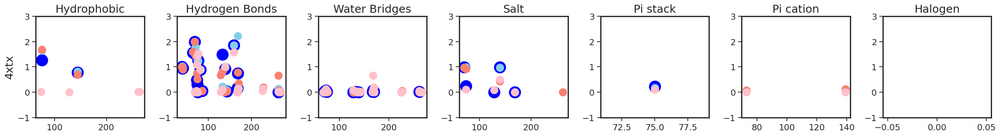

In [191]:
plot_interaction_md('4xtx')

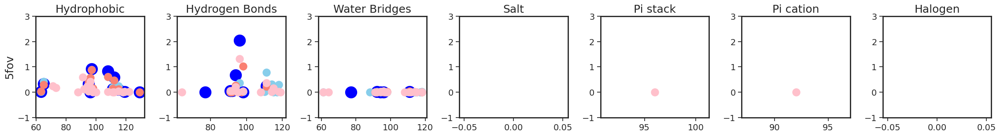

In [192]:
plot_interaction_md('5fov')

  0%|          | 0/100 [00:00<?, ?it/s]

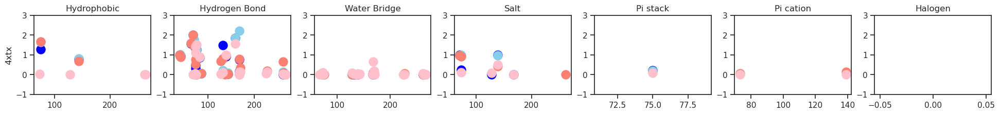

  1%|          | 1/100 [00:00<00:58,  1.68it/s]

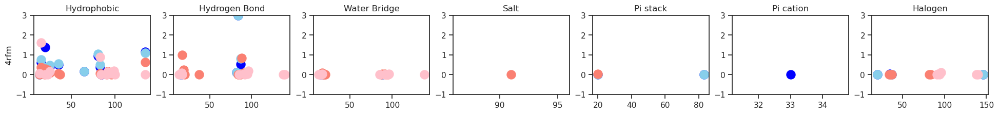

  2%|▏         | 2/100 [00:01<00:56,  1.74it/s]

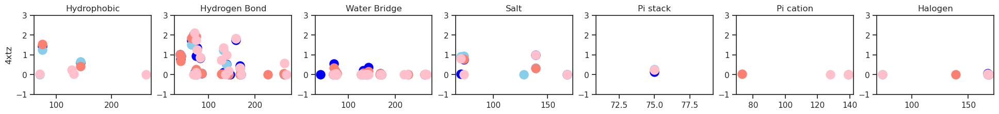

  3%|▎         | 3/100 [00:01<00:55,  1.76it/s]

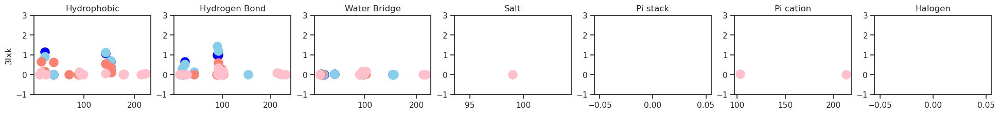

  4%|▍         | 4/100 [00:02<01:04,  1.49it/s]

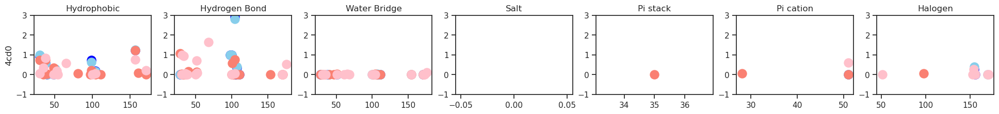

  5%|▌         | 5/100 [00:03<01:00,  1.56it/s]

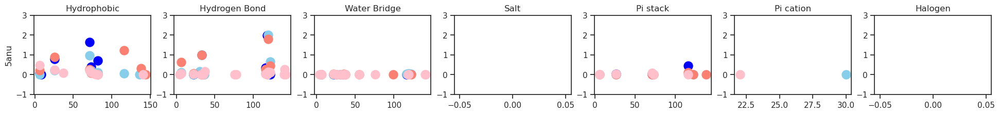

  6%|▌         | 6/100 [00:03<00:58,  1.61it/s]

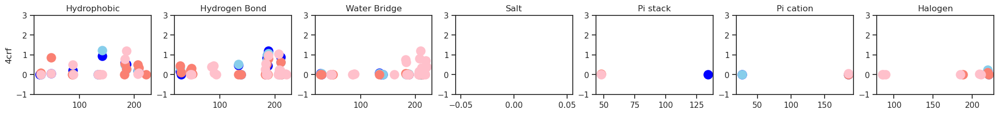

  7%|▋         | 7/100 [00:04<00:56,  1.66it/s]

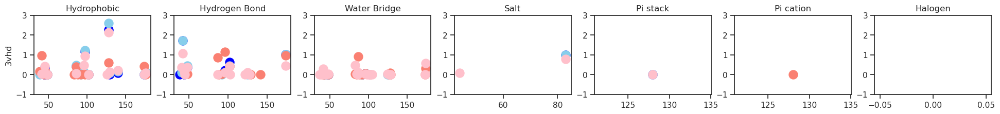

  8%|▊         | 8/100 [00:04<00:58,  1.57it/s]

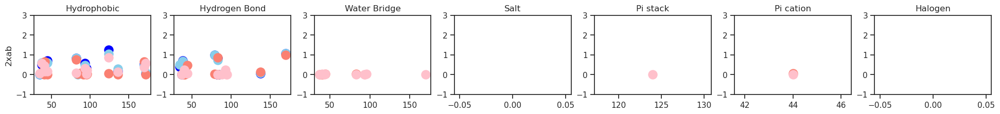

  9%|▉         | 9/100 [00:05<00:56,  1.62it/s]

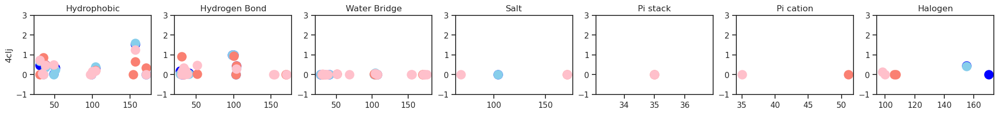

 10%|█         | 10/100 [00:06<00:53,  1.68it/s]

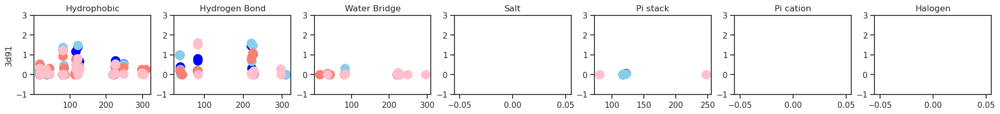

 11%|█         | 11/100 [00:06<00:51,  1.73it/s]

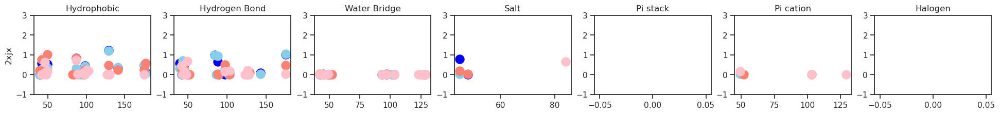

 12%|█▏        | 12/100 [00:07<00:50,  1.75it/s]

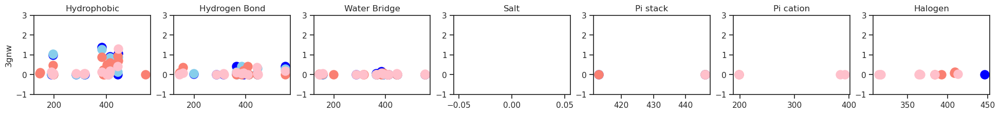

 13%|█▎        | 13/100 [00:07<00:52,  1.64it/s]

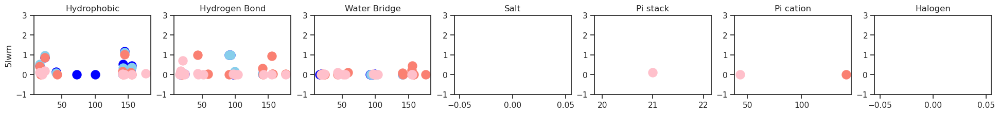

 14%|█▍        | 14/100 [00:08<00:50,  1.71it/s]

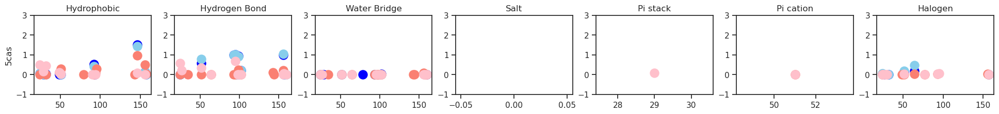

 15%|█▌        | 15/100 [00:08<00:48,  1.75it/s]

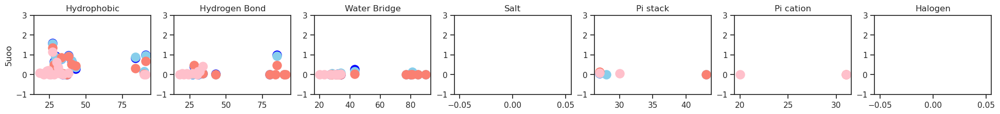

 16%|█▌        | 16/100 [00:09<00:46,  1.79it/s]

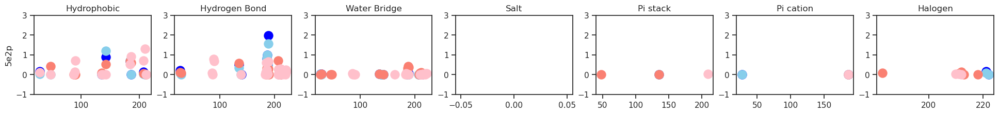

 17%|█▋        | 17/100 [00:10<00:45,  1.82it/s]

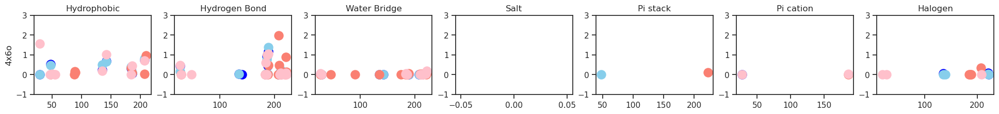

 18%|█▊        | 18/100 [00:10<00:48,  1.69it/s]

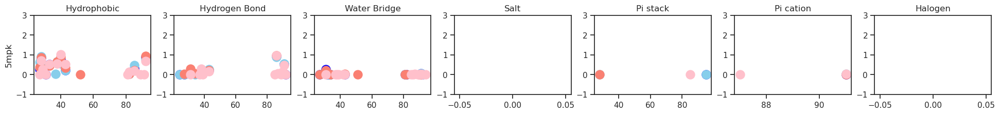

 19%|█▉        | 19/100 [00:11<00:46,  1.74it/s]

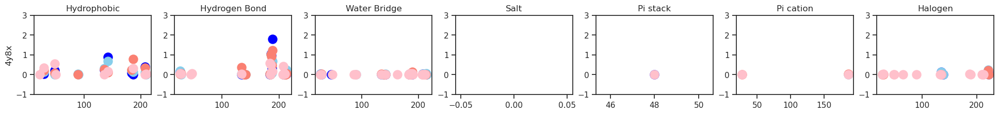

 20%|██        | 20/100 [00:11<00:44,  1.78it/s]

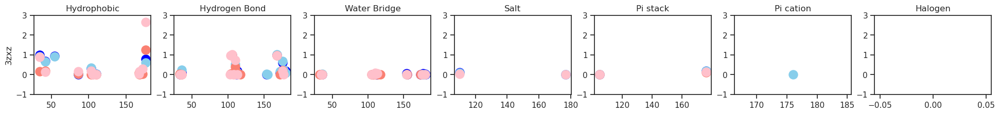

 21%|██        | 21/100 [00:12<00:44,  1.79it/s]

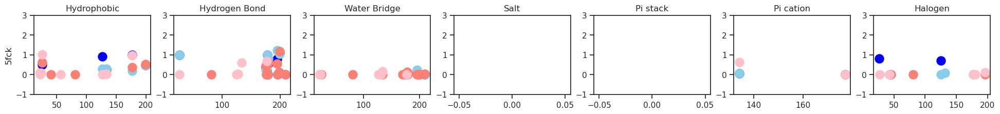

 22%|██▏       | 22/100 [00:12<00:43,  1.79it/s]

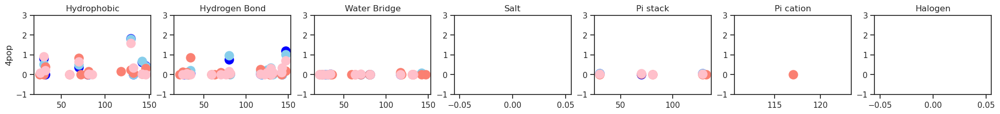

 23%|██▎       | 23/100 [00:13<00:46,  1.65it/s]

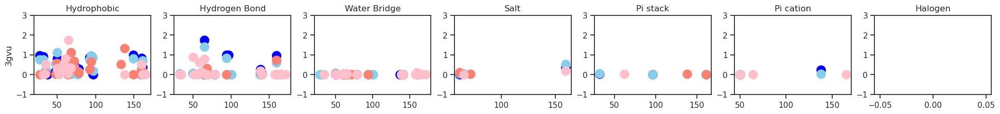

 24%|██▍       | 24/100 [00:14<00:44,  1.71it/s]

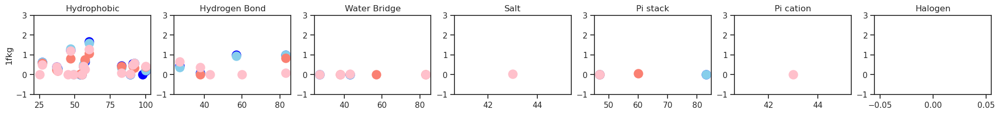

 25%|██▌       | 25/100 [00:14<00:42,  1.75it/s]

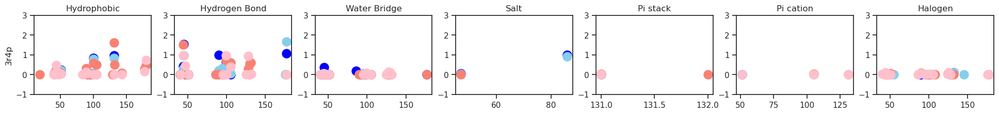

 26%|██▌       | 26/100 [00:15<00:41,  1.79it/s]

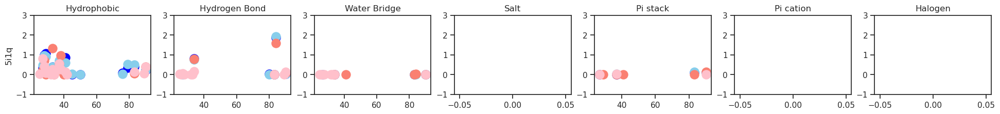

 27%|██▋       | 27/100 [00:15<00:40,  1.82it/s]

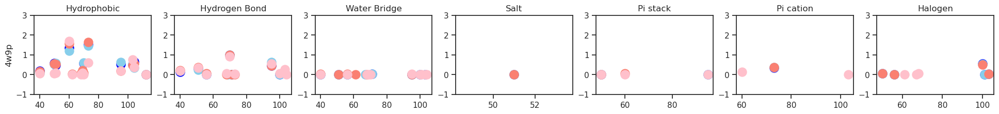

 28%|██▊       | 28/100 [00:16<00:43,  1.66it/s]

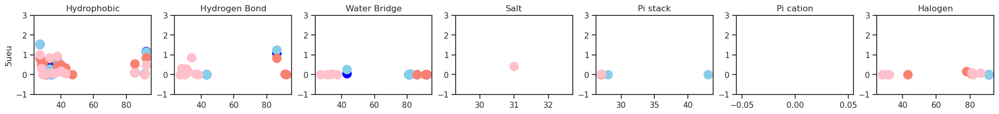

 29%|██▉       | 29/100 [00:17<00:41,  1.71it/s]

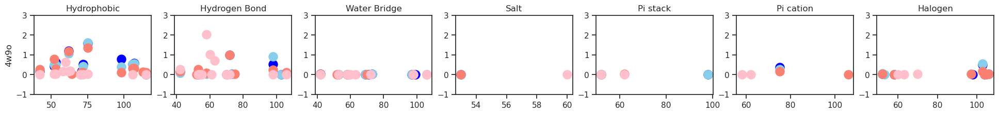

 30%|███       | 30/100 [00:17<00:40,  1.75it/s]

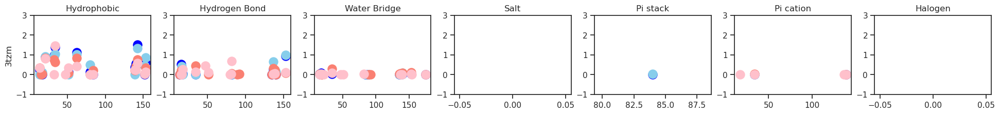

 31%|███       | 31/100 [00:18<00:38,  1.78it/s]

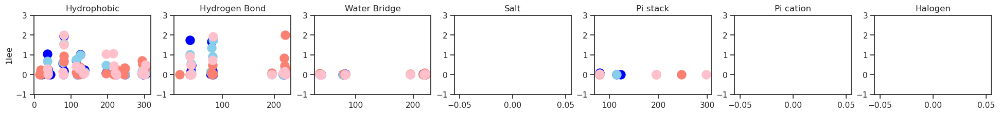

 32%|███▏      | 32/100 [00:18<00:37,  1.81it/s]

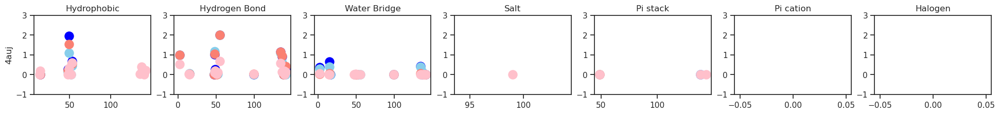

 33%|███▎      | 33/100 [00:19<00:39,  1.68it/s]

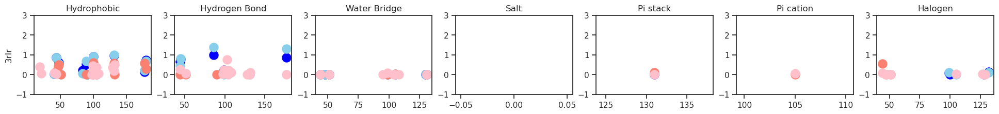

 34%|███▍      | 34/100 [00:19<00:38,  1.73it/s]

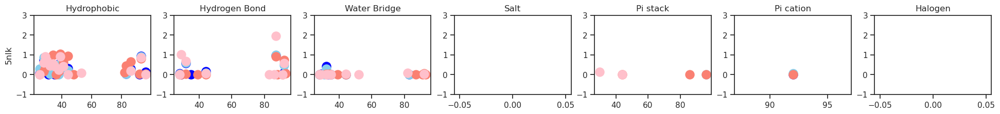

 35%|███▌      | 35/100 [00:20<00:36,  1.77it/s]

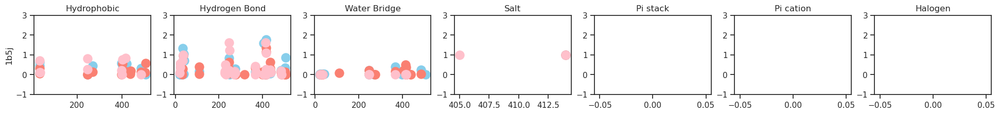

 36%|███▌      | 36/100 [00:20<00:35,  1.80it/s]

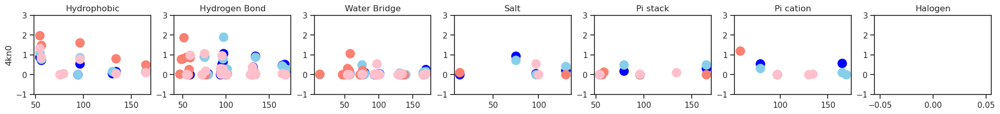

 37%|███▋      | 37/100 [00:21<00:34,  1.82it/s]

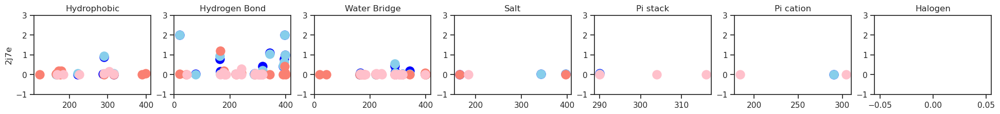

 38%|███▊      | 38/100 [00:22<00:36,  1.69it/s]

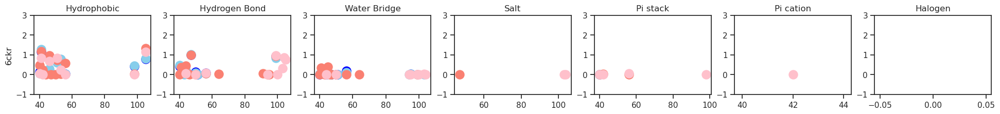

 39%|███▉      | 39/100 [00:22<00:35,  1.73it/s]

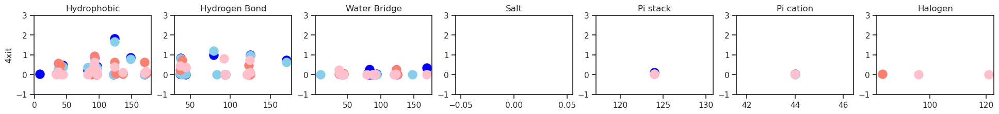

 40%|████      | 40/100 [00:23<00:33,  1.77it/s]

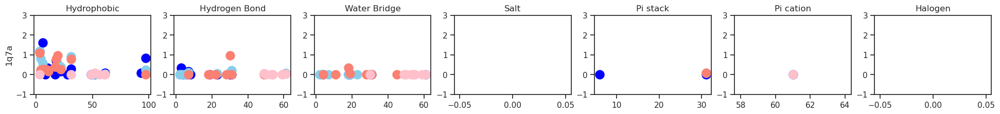

 41%|████      | 41/100 [00:23<00:32,  1.80it/s]

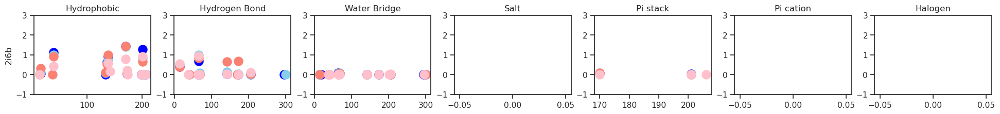

 42%|████▏     | 42/100 [00:24<00:31,  1.82it/s]

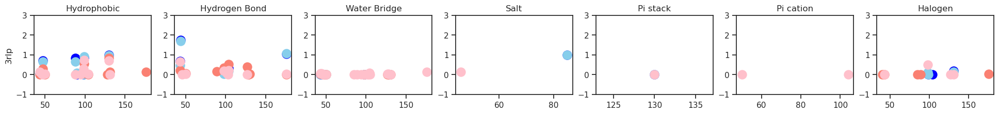

 43%|████▎     | 43/100 [00:24<00:33,  1.69it/s]

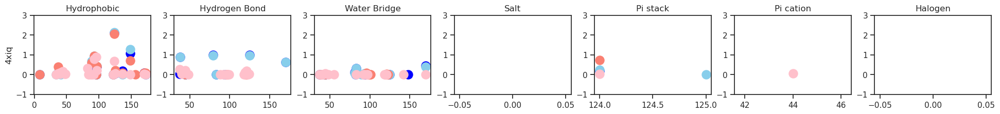

 44%|████▍     | 44/100 [00:25<00:32,  1.74it/s]

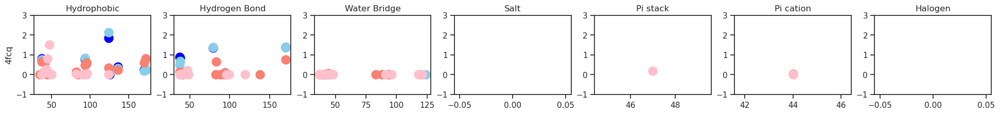

 45%|████▌     | 45/100 [00:26<00:30,  1.78it/s]

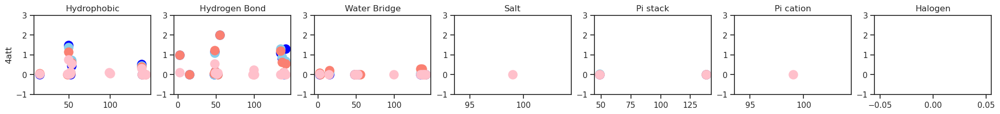

 46%|████▌     | 46/100 [00:26<00:29,  1.81it/s]

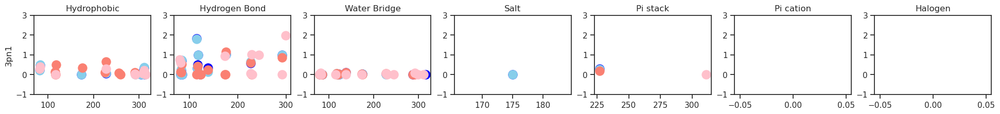

 47%|████▋     | 47/100 [00:27<00:29,  1.83it/s]

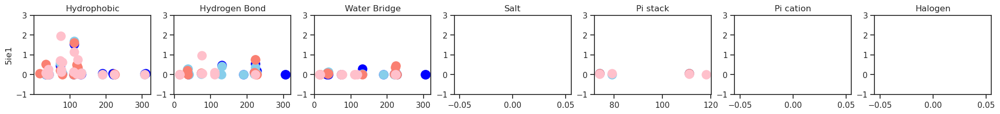

 48%|████▊     | 48/100 [00:27<00:30,  1.68it/s]

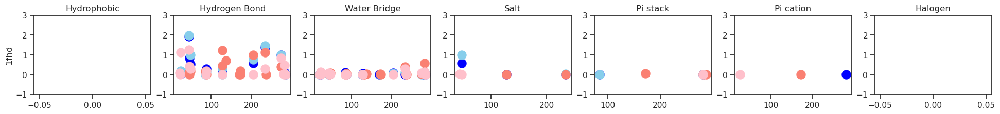

 49%|████▉     | 49/100 [00:28<00:29,  1.74it/s]

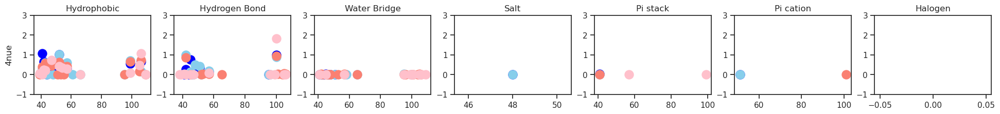

 50%|█████     | 50/100 [00:28<00:28,  1.74it/s]

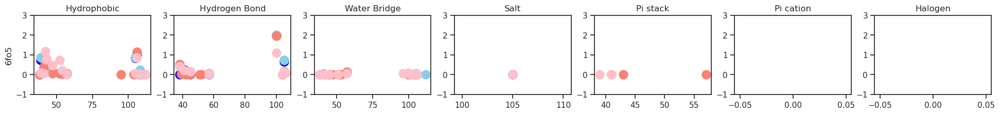

 51%|█████     | 51/100 [00:29<00:27,  1.77it/s]

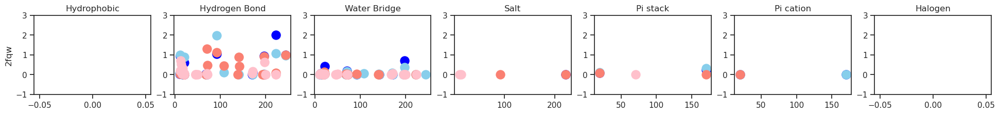

 52%|█████▏    | 52/100 [00:30<00:26,  1.79it/s]

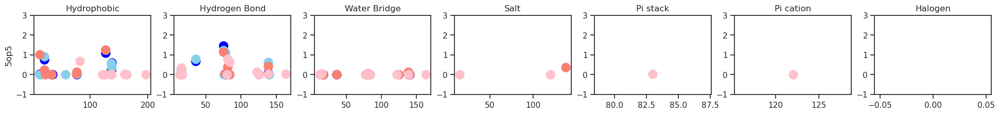

 53%|█████▎    | 53/100 [00:30<00:28,  1.67it/s]

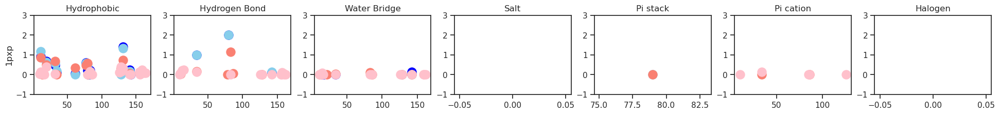

 54%|█████▍    | 54/100 [00:31<00:26,  1.73it/s]

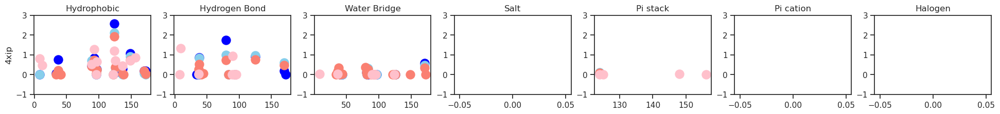

 55%|█████▌    | 55/100 [00:31<00:25,  1.75it/s]

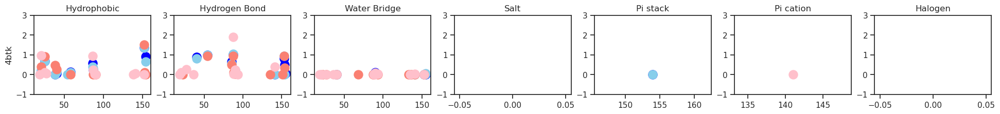

 56%|█████▌    | 56/100 [00:32<00:24,  1.78it/s]

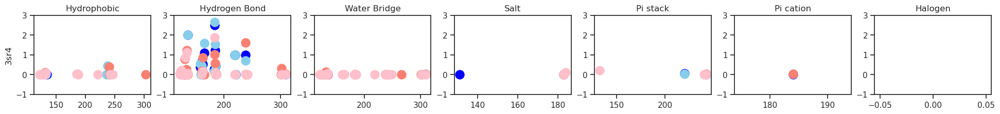

 57%|█████▋    | 57/100 [00:32<00:24,  1.79it/s]

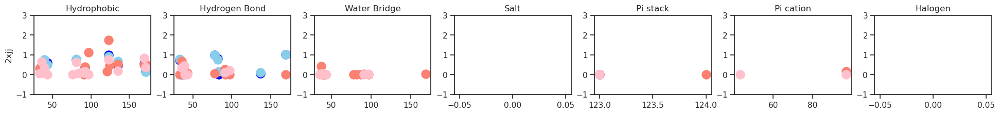

 58%|█████▊    | 58/100 [00:33<00:25,  1.65it/s]

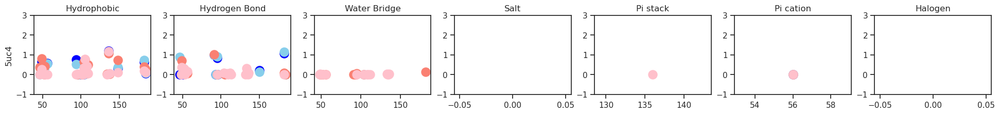

 59%|█████▉    | 59/100 [00:34<00:23,  1.71it/s]

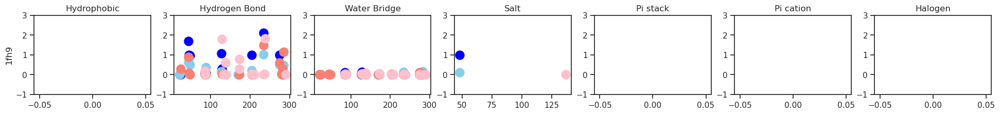

 60%|██████    | 60/100 [00:34<00:22,  1.75it/s]

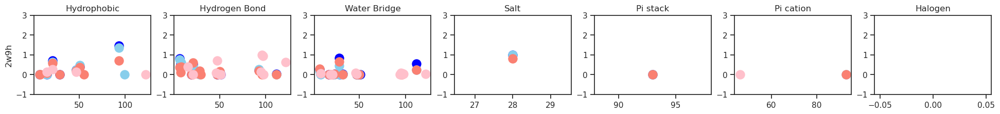

 61%|██████    | 61/100 [00:35<00:21,  1.78it/s]

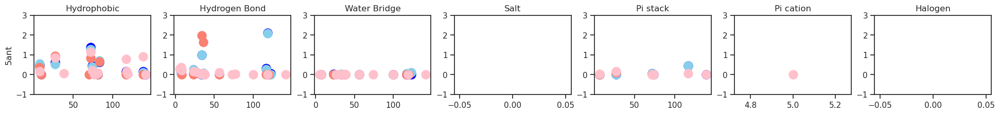

 62%|██████▏   | 62/100 [00:35<00:21,  1.80it/s]

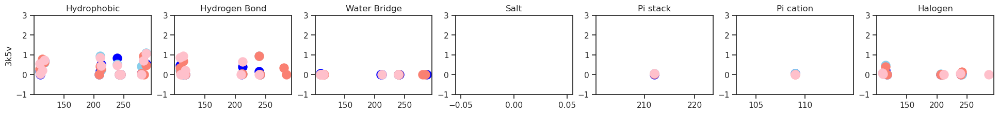

 63%|██████▎   | 63/100 [00:36<00:22,  1.65it/s]

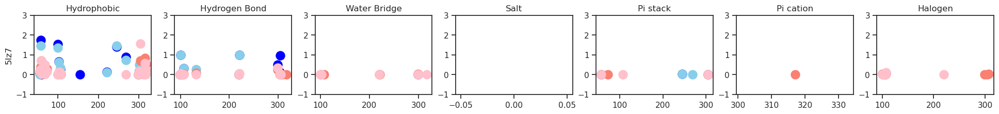

 64%|██████▍   | 64/100 [00:37<00:21,  1.71it/s]

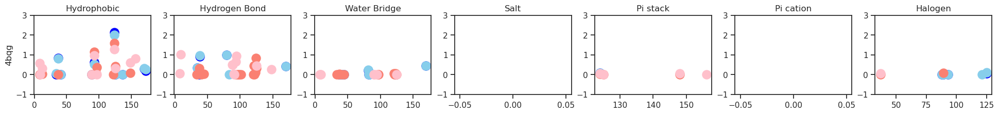

 65%|██████▌   | 65/100 [00:37<00:20,  1.74it/s]

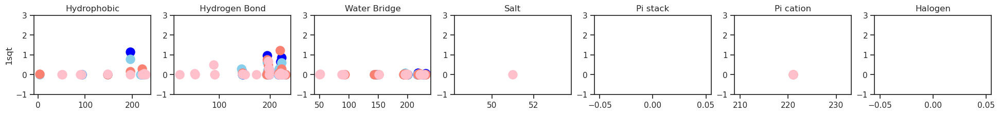

 66%|██████▌   | 66/100 [00:38<00:19,  1.78it/s]

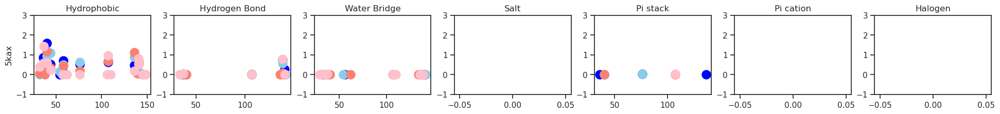

 67%|██████▋   | 67/100 [00:38<00:18,  1.80it/s]

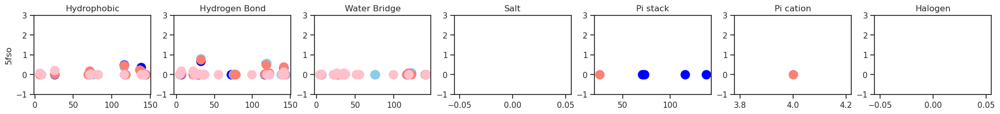

 68%|██████▊   | 68/100 [00:39<00:19,  1.67it/s]

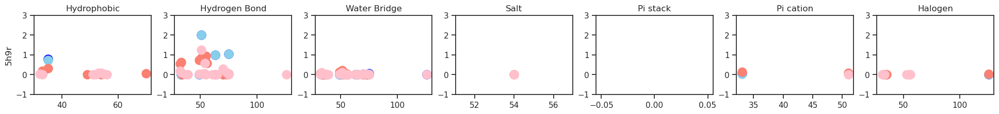

 69%|██████▉   | 69/100 [00:39<00:18,  1.71it/s]

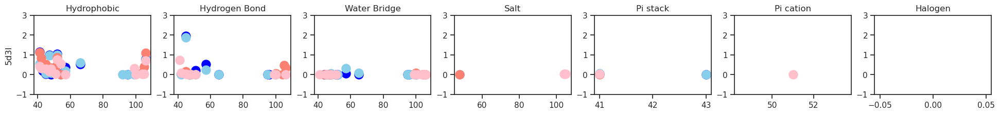

 70%|███████   | 70/100 [00:40<00:17,  1.75it/s]

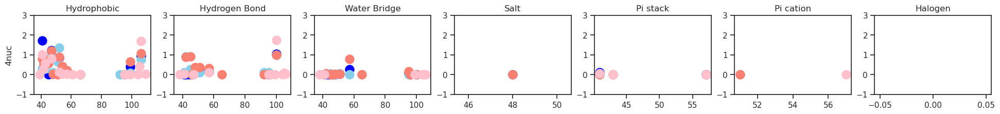

 71%|███████   | 71/100 [00:40<00:16,  1.78it/s]

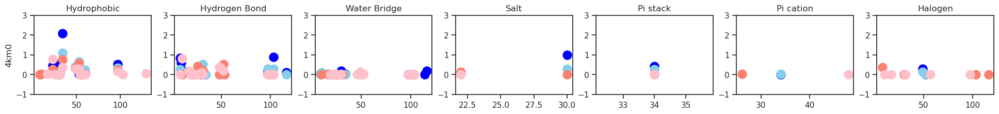

 72%|███████▏  | 72/100 [00:41<00:15,  1.78it/s]

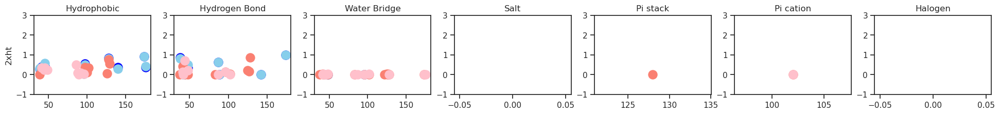

 73%|███████▎  | 73/100 [00:42<00:16,  1.66it/s]

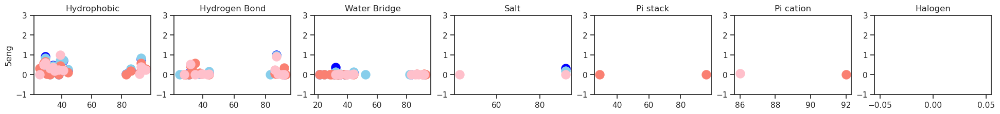

 74%|███████▍  | 74/100 [00:42<00:15,  1.72it/s]

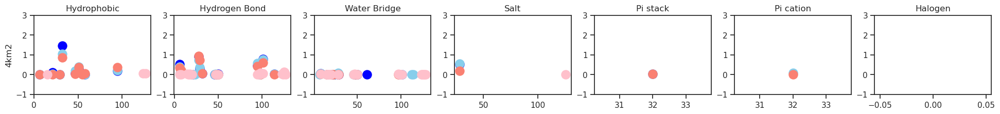

 75%|███████▌  | 75/100 [00:43<00:14,  1.77it/s]

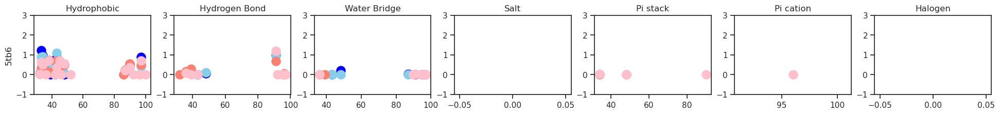

 76%|███████▌  | 76/100 [00:43<00:13,  1.80it/s]

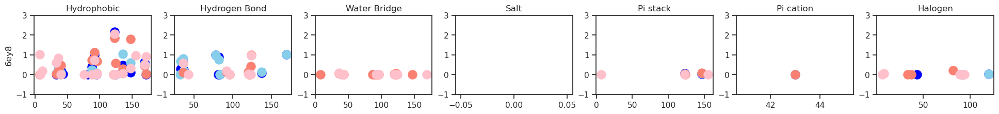

 77%|███████▋  | 77/100 [00:44<00:12,  1.82it/s]

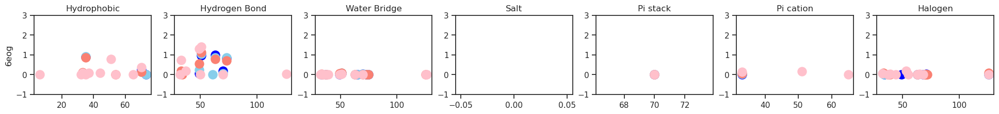

 78%|███████▊  | 78/100 [00:45<00:13,  1.68it/s]

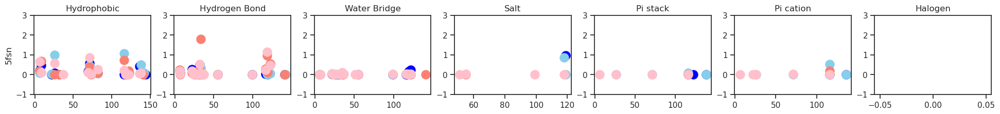

 79%|███████▉  | 79/100 [00:45<00:12,  1.73it/s]

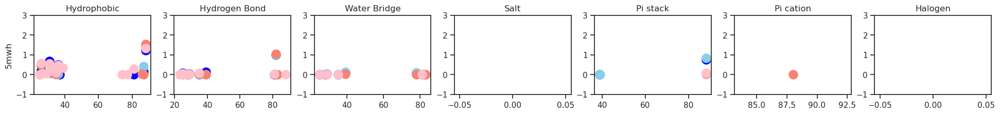

 80%|████████  | 80/100 [00:46<00:11,  1.77it/s]

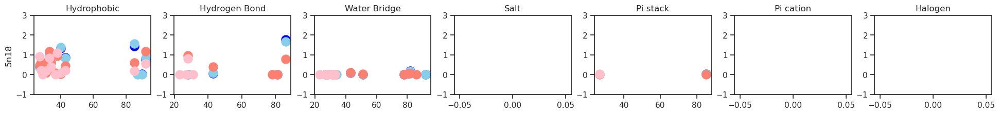

 81%|████████  | 81/100 [00:46<00:10,  1.75it/s]

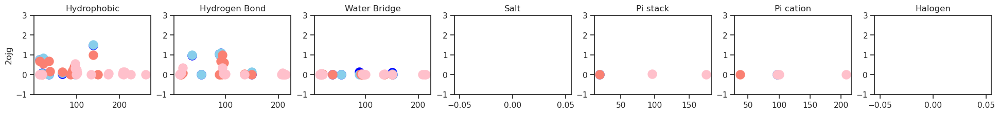

 82%|████████▏ | 82/100 [00:47<00:10,  1.79it/s]

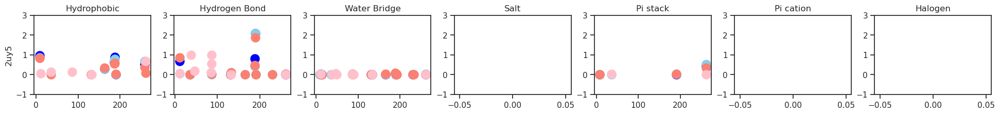

 83%|████████▎ | 83/100 [00:47<00:10,  1.67it/s]

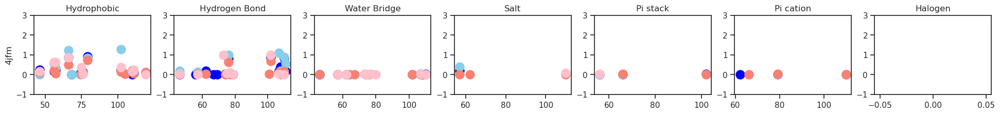

 84%|████████▍ | 84/100 [00:48<00:09,  1.71it/s]

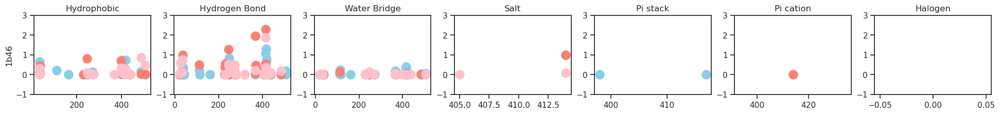

 85%|████████▌ | 85/100 [00:49<00:08,  1.74it/s]

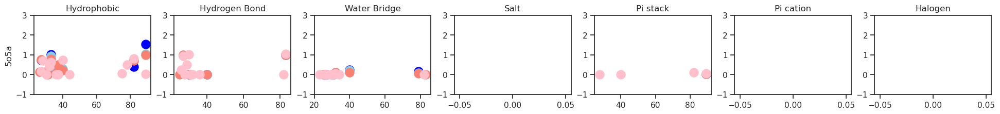

 86%|████████▌ | 86/100 [00:49<00:07,  1.78it/s]

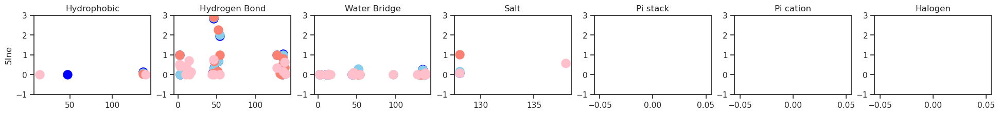

 87%|████████▋ | 87/100 [00:50<00:07,  1.81it/s]

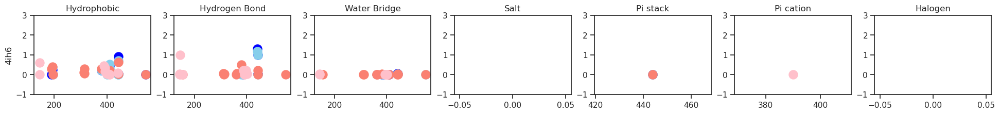

 88%|████████▊ | 88/100 [00:50<00:07,  1.69it/s]

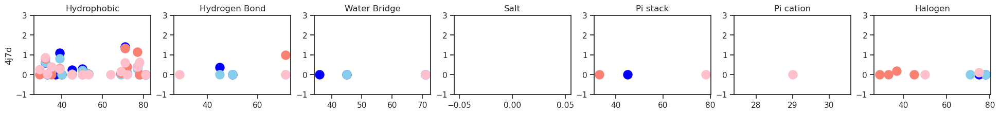

 89%|████████▉ | 89/100 [00:51<00:06,  1.74it/s]

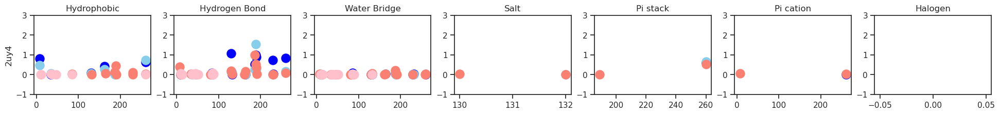

 90%|█████████ | 90/100 [00:51<00:05,  1.75it/s]

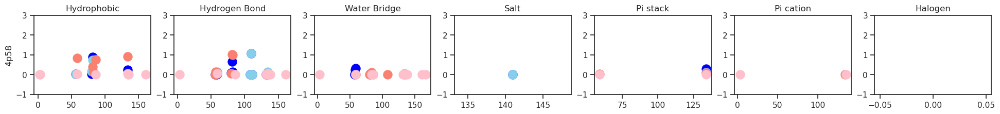

 91%|█████████ | 91/100 [00:52<00:05,  1.78it/s]

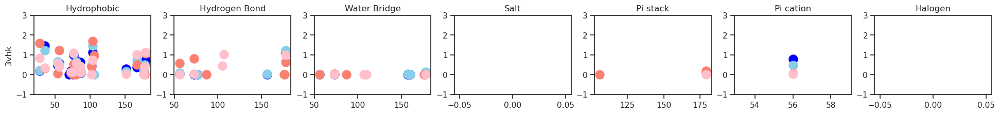

 92%|█████████▏| 92/100 [00:52<00:04,  1.81it/s]

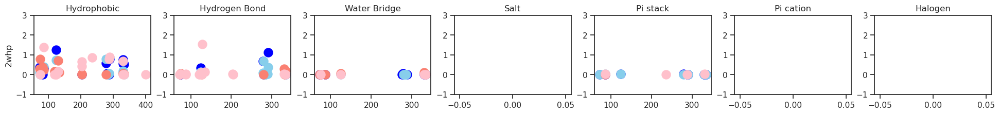

 93%|█████████▎| 93/100 [00:53<00:04,  1.68it/s]

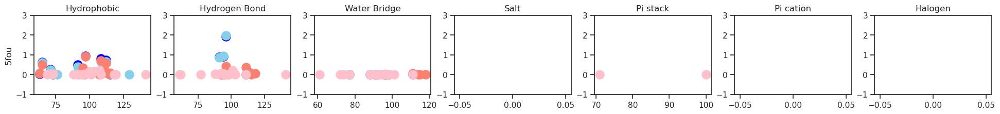

 94%|█████████▍| 94/100 [00:54<00:03,  1.72it/s]

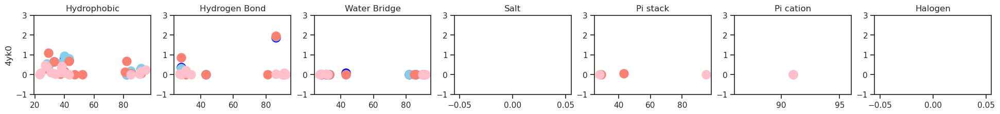

 95%|█████████▌| 95/100 [00:54<00:02,  1.76it/s]

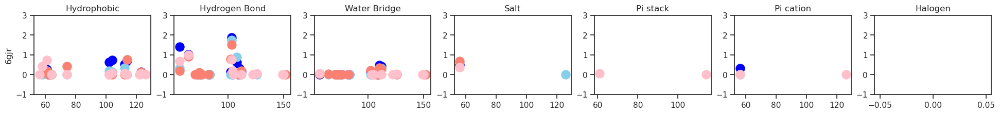

 96%|█████████▌| 96/100 [00:55<00:02,  1.79it/s]

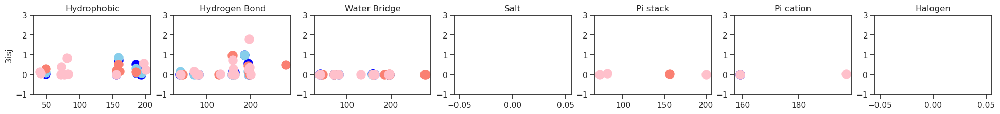

 97%|█████████▋| 97/100 [00:55<00:01,  1.82it/s]

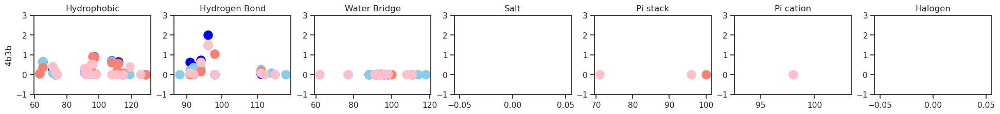

 98%|█████████▊| 98/100 [00:56<00:01,  1.68it/s]

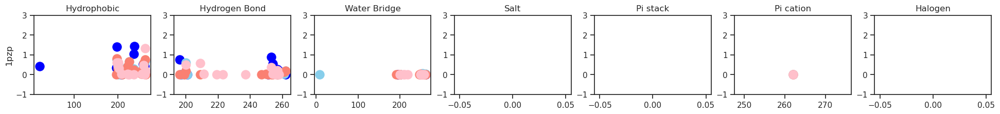

 99%|█████████▉| 99/100 [00:57<00:00,  1.69it/s]

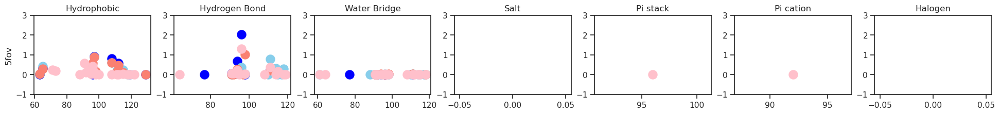

100%|██████████| 100/100 [00:57<00:00,  1.73it/s]

0


In [226]:
error=[]
for i in tqdm(sel_100_data['pdbid'].tolist()):
    try:
        plot_interaction_md(i)
    except:
        error.append(i)
        pass
    
print(len(error))

## Plot comparison for 2A, 5A, 10A and native

In [193]:
def plip_plot_interaction(filename=None, interaction=None):
    
    plip_path = '/data/mdml/neutral_collection/analysis_all/plip_interact'
    
    pdb=sel_100_data['pdbid'].tolist()


    plip_dynamic_ref=pd.DataFrame(pdb)


    for i in range(1,41):
        plip_dynamic_ref.loc[:,i]=0


    for pdbid in pdb:  

        try:
            file_native=pdbid+'_native_2550_md_inter.csv'
            file_2a=pdbid+'_2a_2550_md_inter.csv'
            file_5a=pdbid+'_5a_2550_md_inter.csv'
            file_10a=pdbid+'_10a_2550_md_inter.csv'
            g0_native=pd.read_csv(os.path.join(plip_path,file_native))
            g0_2a=pd.read_csv(os.path.join(plip_path,file_2a))
            g0_5a=pd.read_csv(os.path.join(plip_path,file_5a))
            g0_10a=pd.read_csv(os.path.join(plip_path,file_10a))

            g0_native_hydrophobic, g0_native_hydrogen, g0_native_water, g0_native_salt, g0_native_pi_stack, g0_native_pi_cation, g0_native_halogen=decompose_inter(g0_native)
            g0_2a_hydrophobic, g0_2a_hydrogen, g0_2a_water, g0_2a_salt, g0_2a_pi_stack, g0_2a_pi_cation, g0_2a_halogen=decompose_inter(g0_2a)
            g0_5a_hydrophobic, g0_5a_hydrogen, g0_5a_water, g0_5a_salt, g0_5a_pi_stack, g0_5a_pi_cation, g0_5a_halogen=decompose_inter(g0_5a)
            g0_10a_hydrophobic, g0_10a_hydrogen, g0_10a_water, g0_10a_salt, g0_10a_pi_stack, g0_10a_pi_cation, g0_10a_halogen=decompose_inter(g0_10a)

            if interaction=='hydrophobic_interactions':
                num_native=len(g0_native_hydrophobic['0'][0:10].values)
                num_2a=len(g0_2a_hydrophobic['0'][0:10].values)
                num_5a=len(g0_5a_hydrophobic['0'][0:10].values)
                num_10a=len(g0_10a_hydrophobic['0'][0:10].values)
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(1,num_native+1)]]=g0_native_hydrophobic['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(11,num_2a+11)]]=g0_2a_hydrophobic['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(21,num_5a+21)]]=g0_5a_hydrophobic['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(31,num_10a+31)]]=g0_10a_hydrophobic['0'][0:10].values
            if interaction=='hydrogen_bonds':
                num_native=len(g0_native_hydrogen['0'][0:10].values)
                num_2a=len(g0_2a_hydrogen['0'][0:10].values)
                num_5a=len(g0_5a_hydrogen['0'][0:10].values)
                num_10a=len(g0_10a_hydrogen['0'][0:10].values)
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(1,num_native+1)]]=g0_native_hydrogen['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(11,num_2a+11)]]=g0_2a_hydrogen['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(21,num_5a+21)]]=g0_5a_hydrogen['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(31,num_10a+31)]]=g0_10a_hydrogen['0'][0:10].values

            if interaction=='water_bridges':
                num_native=len(g0_native_water['0'][0:10].values)
                num_2a=len(g0_2a_water['0'][0:10].values)
                num_5a=len(g0_5a_water['0'][0:10].values)
                num_10a=len(g0_10a_water['0'][0:10].values)
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(1,num_native+1)]]=g0_native_water['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(11,num_2a+11)]]=g0_2a_water['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(21,num_5a+21)]]=g0_5a_water['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(31,num_10a+31)]]=g0_10a_water['0'][0:10].values

            if interaction=='salt_bridges':
                num_native=len(g0_native_salt['0'][0:10].values)
                num_2a=len(g0_2a_salt['0'][0:10].values)
                num_5a=len(g0_5a_salt['0'][0:10].values)
                num_10a=len(g0_10a_salt['0'][0:10].values)
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(1,num_native+1)]]=g0_native_salt['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(11,num_2a+11)]]=g0_2a_salt['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(21,num_5a+21)]]=g0_5a_salt['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(31,num_10a+31)]]=g0_10a_salt['0'][0:10].values

            if interaction=='pi_stacks':
                num_native=len(g0_native_pi_stack['0'][0:10].values)
                num_2a=len(g0_2a_pi_stack['0'][0:10].values)
                num_5a=len(g0_5a_pi_stack['0'][0:10].values)
                num_10a=len(g0_10a_pi_stack['0'][0:10].values)
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(1,num_native+1)]]=g0_native_pi_stack['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(11,num_2a+11)]]=g0_2a_pi_stack['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(21,num_5a+21)]]=g0_5a_pi_stack['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(31,num_10a+31)]]=g0_10a_pi_stack['0'][0:10].values

            if interaction=='pi_cation_interactions':
                num_native=len(g0_native_pi_cation['0'][0:10].values)
                num_2a=len(g0_2a_pi_cation['0'][0:10].values)
                num_5a=len(g0_5a_pi_cation['0'][0:10].values)
                num_10a=len(g0_10a_pi_cation['0'][0:10].values)
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(1,num_native+1)]]=g0_native_pi_cation['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(11,num_2a+11)]]=g0_2a_pi_cation['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(21,num_5a+21)]]=g0_5a_pi_cation['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(31,num_10a+31)]]=g0_10a_pi_cation['0'][0:10].values

            if interaction=='halogen_bonds':
                num_native=len(g0_native_halogen['0'][0:10].values)
                num_2a=len(g0_2a_halogen['0'][0:10].values)
                num_5a=len(g0_5a_halogen['0'][0:10].values)
                num_10a=len(g0_10a_halogen['0'][0:10].values)
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(1,num_native+1)]]=g0_native_halogen['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(11,num_2a+11)]]=g0_2a_halogen['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(21,num_5a+21)]]=g0_5a_halogen['0'][0:10].values
                plip_dynamic_ref.iloc[plip_dynamic_ref.loc[plip_dynamic_ref[0]==pdbid].index[0],[i for i in range(31,num_10a+31)]]=g0_10a_halogen['0'][0:10].values


        except:
            pass

    return plip_dynamic_ref

In [ ]:
data=plip_plot_interaction(filename=None, interaction='hydrogen_bonds')

tt=data[data[1]>0.05]
gg=tt

gg[i+10]=tt[i+10]-tt[i]
gg[i+20]=tt[i+20]-tt[i]
gg[i+30]=tt[i+30]-tt[i]

text_coor=2
i=1
gg[i+10].plot.kde()
#     plt.text(0.2,text_coor,'%d: %d/%d' % (i, len(gg[gg[i+10]<0]), len(gg)-len(gg[gg[i+10]<0])))

gg[i+20].plot.kde()
#     plt.text(0.2,text_coor,'%d: %d/%d' % (i, len(gg[gg[i+20]<0]), len(gg)-len(gg[gg[i+20]<0])))
gg[i+30].plot.kde()

#     text_coor=text_coor-0.5
    
tt=data[data[1]>0.05]
ggtt=tt

ggtt[i+20]=tt[i+20]-tt[i+10]
ggtt[i+30]=tt[i+30]-tt[i+10]

ggtt[i+20].plot.kde()
#     plt.text(0.2,text_coor,'%d: %d/%d' % (i, len(gg[gg[i+20]<0]), len(gg)-len(gg[gg[i+20]<0])))
ggtt[i+30].plot.kde()
    

tt=data[data[1]>0.05]
ggbb=tt
ggbb[i+30]=tt[i+30]-tt[i+20]
ggbb[i+30].plot.kde()

ggttaa=pd.concat([gg[1+10], gg[1+20], gg[1+30], ggtt[1+20], ggtt[1+30], ggbb[1+30]],axis=1)

ggttaa=ggttaa.dropna()

ggttaa.columns = ['native_2a','native_5a','native_10a','2a_5a','2a_10a','5a_10a']

In [69]:
ggttaa.boxplot()
# plt.xlim(-2,2)
plt.show()

<ipython-input-243-c02335ff4291>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gg[i+10]=tt[i+10]-tt[i]
<ipython-input-243-c02335ff4291>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gg[i+20]=tt[i+20]-tt[i]
<ipython-input-243-c02335ff4291>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retu

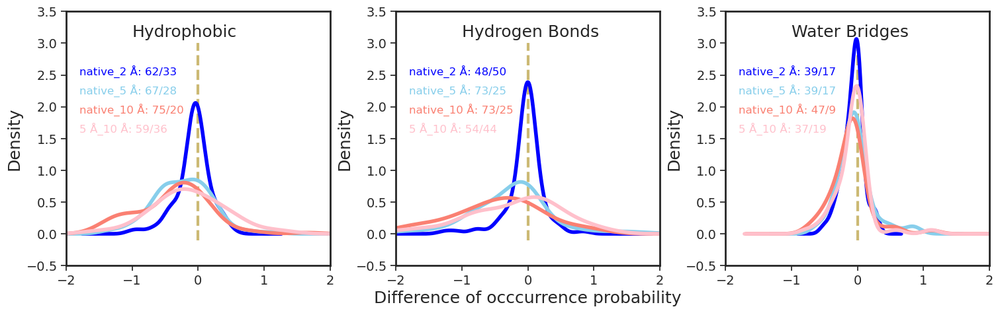

In [243]:
plt.figure(figsize=(18,5))

mpl.rcParams['axes.linewidth']=2

mpl.rcParams['xtick.labelsize']=14
mpl.rcParams['ytick.labelsize']=14


mpl.rcParams['axes.labelsize']=18

axes1=plt.subplot(1,3,1)
data=plip_plot_interaction(filename=None, interaction='hydrophobic_interactions')
tt=data[data[1]>0.05]
gg=tt
i=1
gg[i+10]=tt[i+10]-tt[i]
gg[i+20]=tt[i+20]-tt[i]
gg[i+30]=tt[i+30]-tt[i]

text_coor=2
i=1  
tt=data[data[1]>0.05]
ggtt=tt
ggtt[i+20]=tt[i+20]-tt[i+10]
ggtt[i+30]=tt[i+30]-tt[i+10]

tt=data[data[1]>0.05]
ggbb=tt
ggbb[i+30]=tt[i+30]-tt[i+20]

ggttaa=pd.concat([gg[1+10], gg[1+20], gg[1+30], ggtt[1+20], ggtt[1+30], ggbb[1+30]],axis=1)
plt
ggttaa=ggttaa.dropna()

ggttaa.columns = ['native_2a','native_5a','native_10a','2a_5a','2a_10a','5a_10a']
ggttaa[['native_2a','native_5a','native_10a','5a_10a']].plot.kde(color=[color_native, color_2a,color_5a,color_10a],ax=axes1,linewidth=4)
plt.text(-1.8,2.5,'native_2 Å: %d/%d' % (len(ggttaa[ggttaa['native_2a']<0]), len(ggttaa)-len(ggttaa[ggttaa['native_2a']<0])),color=color_native)
plt.text(-1.8,2.2,'native_5 Å: %d/%d' % (len(ggttaa[ggttaa['native_5a']<0]), len(ggttaa)-len(ggttaa[ggttaa['native_5a']<0])),color=color_2a)
plt.text(-1.8,1.9,'native_10 Å: %d/%d' % (len(ggttaa[ggttaa['native_10a']<0]), len(ggttaa)-len(ggttaa[ggttaa['native_10a']<0])),color=color_5a)
plt.text(-1.8,1.6,'5 Å_10 Å: %d/%d' % (len(ggttaa[ggttaa['5a_10a']<0]), len(ggttaa)-len(ggttaa[ggttaa['5a_10a']<0])),color=color_10a)
# plt.x
plt.xlim(-2,2)

plt.ylim(-0.5,3.5)

plt.vlines(0, -0.1, 3, colors = "y", linestyles = "dashed",linewidth=3)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.text(-1,3.1,'Hydrophobic',fontsize=18)
plt.ylabel('Density',fontsize=18)

# plt.xlabel('Difference of occcurrence probability',fontsize=18)

plt.legend('',frameon=False)

axes2=plt.subplot(1,3,2)
data=plip_plot_interaction(filename=None, interaction='hydrogen_bonds')
tt=data[data[1]>0.05]
gg=tt

gg[i+10]=tt[i+10]-tt[i]
gg[i+20]=tt[i+20]-tt[i]
gg[i+30]=tt[i+30]-tt[i]

text_coor=2
i=1  
tt=data[data[1]>0.05]
ggtt=tt
ggtt[i+20]=tt[i+20]-tt[i+10]
ggtt[i+30]=tt[i+30]-tt[i+10]

tt=data[data[1]>0.05]
ggbb=tt
ggbb[i+30]=tt[i+30]-tt[i+20]

ggttaa=pd.concat([gg[1+10], gg[1+20], gg[1+30], ggtt[1+20], ggtt[1+30], ggbb[1+30]],axis=1)
ggttaa=ggttaa.dropna()
ggttaa.columns = ['native_2a','native_5a','native_10a','2a_5a','2a_10a','5a_10a']
ggttaa[['native_2a','native_5a','native_10a','5a_10a']].plot.kde(color=[color_native, color_2a,color_5a,color_10a],ax=axes2,linewidth=4)
plt.text(-1.8,2.5,'native_2 Å: %d/%d' % (len(ggttaa[ggttaa['native_2a']<0]), len(ggttaa)-len(ggttaa[ggttaa['native_2a']<0])),color=color_native)
plt.text(-1.8,2.2,'native_5 Å: %d/%d' % (len(ggttaa[ggttaa['native_5a']<0]), len(ggttaa)-len(ggttaa[ggttaa['native_5a']<0])),color=color_2a)
plt.text(-1.8,1.9,'native_10 Å: %d/%d' % (len(ggttaa[ggttaa['native_10a']<0]), len(ggttaa)-len(ggttaa[ggttaa['native_10a']<0])),color=color_5a)
plt.text(-1.8,1.6,'5 Å_10 Å: %d/%d' % (len(ggttaa[ggttaa['5a_10a']<0]), len(ggttaa)-len(ggttaa[ggttaa['5a_10a']<0])),color=color_10a)
# plt.x
plt.xlim(-2,2)
plt.ylim(-0.5,3.5)

plt.vlines(0, -0.1, 3, colors = "y", linestyles = "dashed",linewidth=3)

plt.text(-1,3.1,'Hydrogen Bonds',fontsize=18)
plt.ylabel('Density',fontsize=18)

plt.xlabel('Difference of occcurrence probability',fontsize=18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.legend('',frameon=False)


axes3=plt.subplot(1,3,3)

data=plip_plot_interaction(filename=None, interaction='water_bridges')
tt=data[data[1]>0.05]
gg=tt

gg[i+10]=tt[i+10]-tt[i]
gg[i+20]=tt[i+20]-tt[i]
gg[i+30]=tt[i+30]-tt[i]

text_coor=2
i=1  
tt=data[data[1]>0.05]
ggtt=tt
ggtt[i+20]=tt[i+20]-tt[i+10]
ggtt[i+30]=tt[i+30]-tt[i+10]

tt=data[data[1]>0.05]
ggbb=tt
ggbb[i+30]=tt[i+30]-tt[i+20]

ggttaa=pd.concat([gg[1+10], gg[1+20], gg[1+30], ggtt[1+20], ggtt[1+30], ggbb[1+30]],axis=1)
ggttaa=ggttaa.dropna()
ggttaa.columns = ['native_2a','native_5a','native_10a','2a_5a','2a_10a','5a_10a']
ggttaa[['native_2a','native_5a','native_10a','5a_10a']].plot.kde(color=[color_native, color_2a,color_5a,color_10a],ax=axes3,linewidth=4)
plt.text(-1.8,2.5,'native_2 Å: %d/%d' % (len(ggttaa[ggttaa['native_2a']<0]), len(ggttaa)-len(ggttaa[ggttaa['native_2a']<0])),color=color_native)
plt.text(-1.8,2.2,'native_5 Å: %d/%d' % (len(ggttaa[ggttaa['native_5a']<0]), len(ggttaa)-len(ggttaa[ggttaa['native_5a']<0])),color=color_2a)
plt.text(-1.8,1.9,'native_10 Å: %d/%d' % (len(ggttaa[ggttaa['native_10a']<0]), len(ggttaa)-len(ggttaa[ggttaa['native_10a']<0])),color=color_5a)
plt.text(-1.8,1.6,'5 Å_10 Å: %d/%d' % (len(ggttaa[ggttaa['5a_10a']<0]), len(ggttaa)-len(ggttaa[ggttaa['5a_10a']<0])),color=color_10a)
# plt.x
plt.xlim(-2,2)
plt.ylim(-0.5,3.5)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.vlines(0, -0.1, 3, colors = "y", linestyles = "dashed",linewidth=3)

plt.text(-1,3.1,'Water Bridges',fontsize=18)
plt.ylabel('Density',fontsize=18)

# plt.xlabel('Difference of occcurrence probability',fontsize=18)

plt.legend('',frameon=False)
plt.subplots_adjust(wspace=0.25)
plt.savefig('plip_comparison.pdf',bbox_inches='tight')
plt.savefig('plip_comparison.png',bbox_inches='tight')
plt.show()
# ggttaa[['2a_5a','2a_10a','5a_10a']].plot.kde()
# plt.xlim(-2,2)
# plt.show()

<ipython-input-239-8c03f0eb5cee>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gg[i+10]=tt[i+10]-tt[i]
<ipython-input-239-8c03f0eb5cee>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gg[i+20]=tt[i+20]-tt[i]
<ipython-input-239-8c03f0eb5cee>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retu

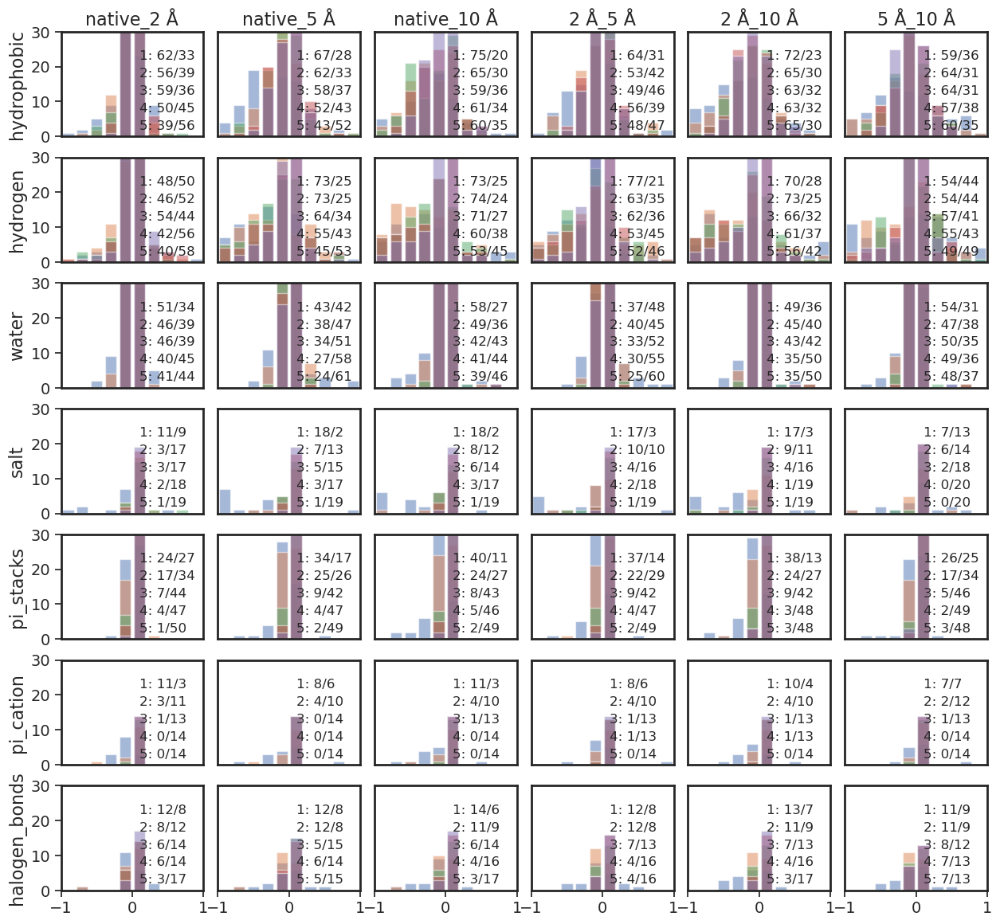

In [239]:
plt.figure(figsize=(15,14))

hist_group = np.linspace(-1,1,num=11)

for num, inter_part in enumerate(plip_int_types):
    data=plip_plot_interaction(filename=None, interaction=inter_part)

         
    tt=data[data[1]>0.01]
    gg=tt
    for i in range(1,6):
        gg[i+10]=tt[i+10]-tt[i]
        gg[i+20]=tt[i+20]-tt[i]
        gg[i+30]=tt[i+30]-tt[i]


    plt.subplot(7,6,num*6+1)
    text_coor=22
    for i in range(1,6):
        plt.hist(gg[i+10],hist_group, rwidth=0.8,alpha=0.5)
        plt.text(0.1,text_coor,'%d: %d/%d' % (i, len(gg[gg[i+10]<0]), len(gg)-len(gg[gg[i+10]<0])))
        text_coor=text_coor-5
        
    if num==0:
        plt.title('native_2 Å',fontsize=16)
    plt.xlim(-1,1)
    plt.ylim(0,30)
    if num<4:
        plt.ylabel(plip_int_types_name[num].split('_')[0], fontsize=16)
    else:
        plt.ylabel(plip_int_types_name[num], fontsize=16)
    if num!=6:
        plt.xticks(aticks)

                                      
    plt.subplot(7,6,num*6+2)
    text_coor=22
    for i in range(1,6):
        plt.hist(gg[i+20],hist_group, rwidth=0.8,alpha=0.5)
        plt.text(0.1,text_coor,'%d: %d/%d' % (i, len(gg[gg[i+20]<0]), len(gg)-len(gg[gg[i+20]<0])))
        text_coor=text_coor-5
        
    if num==0:
        plt.title('native_5 Å',fontsize=16)
    plt.xlim(-1,1)
    plt.ylim(0,30)
    aticks = []
    plt.yticks(aticks)
    if num!=6:
        plt.xticks(aticks)

    
    plt.subplot(7,6,num*6+3)
    text_coor=22
    for i in range(1,6):
        plt.hist(gg[i+30],hist_group, rwidth=0.8,alpha=0.5)
        plt.text(0.1,text_coor,'%d: %d/%d' % (i, len(gg[gg[i+30]<0]), len(gg)-len(gg[gg[i+30]<0])))
        text_coor=text_coor-5
        
    if num==0:
        plt.title('native_10 Å',fontsize=16)
    plt.xlim(-1,1)
    plt.ylim(0,30)
    aticks = []
    plt.yticks(aticks)
    if num!=6:
        plt.xticks(aticks)
    

    plt.subplot(7,6,num*6+4)
    tt=data[data[1]>0.01]
    ggtt=tt
    
    for i in range(1,6): 
        ggtt[i+20]=tt[i+20]-tt[i+10]
        ggtt[i+30]=tt[i+30]-tt[i+10]
        
    text_coor=22
    for i in range(1,6):
        plt.hist(ggtt[i+20],hist_group, rwidth=0.8,alpha=0.5)
        plt.text(0.1,text_coor,'%d: %d/%d' % (i, len(ggtt[ggtt[i+20]<0]), len(ggtt)-len(ggtt[ggtt[i+20]<0])))
        text_coor=text_coor-5

    if num==0:
        plt.title('2 Å_5 Å',fontsize=16)
    plt.xlim(-1,1)
    plt.ylim(0,30)
    aticks = []
    plt.yticks(aticks)
    if num!=6:
        plt.xticks(aticks)

    plt.subplot(7,6,num*6+5)
        
    text_coor=22
    for i in range(1,6):
        plt.hist(ggtt[i+30],hist_group, rwidth=0.8,alpha=0.5)
        plt.text(0.1,text_coor,'%d: %d/%d' % (i, len(ggtt[ggtt[i+30]<0]), len(ggtt)-len(ggtt[ggtt[i+30]<0])))
        text_coor=text_coor-5
        
    if num==0:
        plt.title('2 Å_10 Å',fontsize=16)
        

        
    plt.xlim(-1,1)
    plt.ylim(0,30)
    aticks = []
    plt.yticks(aticks)
    if num!=6:
        plt.xticks(aticks)

    plt.subplot(7,6,num*6+6)
    tt=data[data[1]>0.01]
    ggbb=tt
    
    for i in range(1,6): 
        ggbb[i+30]=tt[i+30]-tt[i+20]
        
    text_coor=22
    for i in range(1,6):
        plt.hist(ggbb[i+30],hist_group, rwidth=0.8,alpha=0.5)
        plt.text(0.1,text_coor,'%d: %d/%d' % (i, len(ggbb[ggbb[i+30]<0]), len(ggbb)-len(ggbb[ggbb[i+30]<0])))
        text_coor=text_coor-5
        
    if num==0:
        plt.title('5 Å_10 Å',fontsize=16)
    plt.xlim(-1,1)
    plt.ylim(0,30)
    aticks = []
    plt.yticks(aticks)
    if num!=6:
        plt.xticks(aticks)

    
plt.subplots_adjust(hspace=0.2,wspace=0.1)
plt.savefig('fig_si_plip_total_five.pdf', bbox_inches='tight')
plt.show()

# Screening

In [231]:
def screen_rmsd_pbsa_plip(pdfile,col1='native',col2='10a',col3='5a',col4='2a',reverse=False):
    if reverse:
        screen_1=pdfile[pdfile[col1]>pdfile[col2]]
        screen_2=screen_1[screen_1[col1]>screen_1[col3]]
        screen_3=screen_2[screen_2[col1]>screen_2[col4]]
    else:        
        screen_1=pdfile[pdfile[col1]<pdfile[col2]]
        screen_2=screen_1[screen_1[col1]<screen_1[col3]]
        screen_3=screen_2[screen_2[col1]<screen_2[col4]]
        print('%s:' % col1.split('_')[0],len(screen_1),len(screen_2),len(screen_3))
    return screen_2

In [287]:
sel_100_data[sel_100_data['smiles'].str.contains('Br')]

,Unnamed: 0,pdbid,ligand,smiles,uniprot,measure,affinity,unit,affinity(-logkd),ions,chains,sequence,len(seq)
4253,4253,5j2x,6DL,O=c1[nH]nc(-c2cc(Br)c(O)cc2O)n1-c1ccccc1F,P07900,Kd,18.0,nM,7.74,set(),['A'],AVETFAFQAEIAQLMSLIINTFYSNKEIFLRELISNSSDALDKIRY...,209.0
5273,5273,2qbq,4B3,CC1(C)CC(Nc2cccc(-c3sc(C(=O)[O-])c(OCC(=O)[O-...,P18031,Ki,36.0,nM,7.44,set(),['A'],EMEKEFEQIDKSGSWAAIYQDIRHEASDFPCRVAKLPKNKNRNRYR...,297.0
7928,7928,2qbs,024,O=C([O-])COc1c(C(=O)[O-])sc(-c2cccc(NC3CCCCC3...,P18031,Ki,210.0,nM,6.68,set(),['A'],EMEKEFEQIDKSGSWAAIYQDIRHEASDFPCRVAKLPKNKNRNRYR...,297.0
9568,9568,6gjn,F0Q,Cn1nnc(CN(Cc2ccc(N)cc2)C(=O)NCC(=O)N2CCC[C@@H...,P62937,Kd,600.0,nM,6.22,set(),['A'],MVNPTVFFDIAVDGEPLGRVSFELFADKVPKTAENFRALSTGEKGF...,165.0


In [ ]:
rmsd_last_five

In [209]:
pbsa_last_five

,pdbid,dynamic_native,dynamic_2a,dynamic_5a,dynamic_10a,affinity(-logkd)
0,4xtx,-60.788116,-63.286453,-54.709118,-32.378136,10.57
1,4rfm,-34.142144,-34.838457,-14.942645,-17.620782,10.05
2,4xtz,-64.926754,-62.484990,-49.228878,-45.645331,9.82
3,3lxk,-39.516513,-41.407715,-18.598397,0.522545,9.80
4,4cd0,-41.110741,-41.191703,-25.403146,-31.404850,9.70
...,...,...,...,...,...,...
128,6gjr,-27.488958,-22.665611,-26.776433,-14.402164,3.74
129,3isj,-18.357194,-14.651202,-13.477655,-21.968497,3.68
130,4b3b,-25.337295,-18.003768,-31.663026,-23.702826,3.60
131,1pzp,-29.747896,-25.042425,-22.586373,-27.094469,3.31


In [277]:
static=pbsa_static.merge(vina_total,how='left',on='pdbid')

In [278]:
static_dynamic=static.merge(dynamic,how='left',on='pdbid')

In [279]:
static_dynamic=static_dynamic.dropna()

In [283]:
static_dynamic=static_dynamic.merge(sel_100_data,how='left',on='pdbid')

/data/mdml/miniconda3/lib/python3.8/site-packages/pandas/core/frame.py:9186: FutureWarning: Passing 'suffixes' which cause duplicate columns {'affinity(-logkd)_x'} in the result is deprecated and will raise a MergeError in a future version.
  return merge(


In [281]:
static_dynamic=static_dynamic[~stati_dynamic['pdbid'].isin(error)]


<ipython-input-281-808b99f4818b>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  static_dynamic=static_dynamic[~stati_dynamic['pdbid'].isin(error)]


In [285]:
static_dynamic['uniprot'].value_counts()

P07900    14
O60885     7
Q92793     5
P36639     4
P03951     4
Q13451     3
O74036     3
P07986     2
A2IC68     2
P0A546     2
P29029     2
P17931     2
I6YFP0     2
P55201     2
P28482     2
Q9UM73     2
P52333     2
P06202     2
Q13093     1
Q2VPJ6     1
P00749     1
Q8KFZ1     1
P00520     1
P0A017     1
P26663     1
Q5A4W8     1
Q1RBS0     1
Q8TEK3     1
P56273     1
P22734     1
P35968     1
P21836     1
P62937     1
P0A5R0     1
P08238     1
P56817     1
Q5TCY1     1
P24941     1
P00797     1
O92972     1
P00533     1
P08581     1
P00746     1
A2RI47     1
P42684     1
P62942     1
P21675     1
P36897     1
P46925     1
P14207     1
Q08638     1
P59071     1
Q5VXR3     1
P43813     1
Q08881     1
P29724     1
O14757     1
P62593     1
Name: uniprot, dtype: int64

In [225]:
dynamic=pbsa_last_five

In [196]:
vina_pbsa_static=vina_total[vina_total['pdbid'].isin(pbsa_static_last_five['pdbid'].tolist())]

In [202]:
vina_pbsa_static

,pdbid,affinity(-logkd),vina_native,vina_2a,vina_5a,vina_10a,order_native,order_2a,order_5a,order_10a
0,4xtx,10.57,-11.88275,-0.15863,-0.28676,-0.43449,1.0,4.0,3.0,2.0
1,4rfm,10.05,-11.08875,-10.75153,0.00000,0.00000,1.0,2.0,3.5,3.5
2,4xtz,9.82,-11.91799,-11.68057,-8.93674,-8.35185,1.0,2.0,3.0,4.0
3,3lxk,9.80,-8.83034,-8.58099,-7.95497,-5.14741,1.0,2.0,3.0,4.0
4,4cd0,9.70,-8.04955,-8.59140,-7.34548,-6.86411,2.0,1.0,3.0,4.0
...,...,...,...,...,...,...,...,...,...,...
128,6gjr,3.74,-6.49609,-6.51056,-6.77613,-5.65641,3.0,2.0,1.0,4.0
129,3isj,3.68,-7.47869,-8.35273,-6.78021,-6.75698,2.0,1.0,3.0,4.0
130,4b3b,3.60,-5.90779,-6.04290,-6.52315,-6.46069,4.0,3.0,1.0,2.0
131,1pzp,3.31,-5.70873,-7.47700,-6.74258,-7.24022,4.0,1.0,3.0,2.0


## Static screening (vina,mmpbsa,plip)

### Union

In [233]:
vina_total

,pdbid,vina_native,vina_5a,vina_10a,order_native,order_5a,order_10a
0,4xtx,-11.88275,-10.3,-7.9,1.0,2.0,3.0
1,4rfm,-11.08875,-9.6,-8.2,1.0,2.0,3.0
2,4xtz,-11.91799,-8.8,-8.8,1.0,2.5,2.5
3,3lxk,-8.83034,-7.6,-5.1,1.0,2.0,3.0
4,4cd0,-8.04955,-7.2,-7.3,1.0,3.0,2.0
...,...,...,...,...,...,...,...
95,6gjr,-6.49609,-6.8,-5.7,2.0,1.0,3.0
96,3isj,-7.47869,-6.8,-6.8,1.0,2.5,2.5
97,4b3b,-5.90779,-6.3,-6.5,3.0,2.0,1.0
98,1pzp,-5.70873,-6.9,-7.1,3.0,2.0,1.0


In [234]:
def screen_union_static(pdfile_vina, pdfile_pbsa):

    data_common = pdfile_vina[pdfile_vina['pdbid'].isin(
        pdfile_pbsa['pdbid'].tolist())]
    data_common = data_common.merge(pdfile_pbsa, how='left', on='pdbid')
    vina_d_screen = screen_rmsd_pbsa_plip(data_common,
                                          col1='vina_native',
                                          col2='vina_10a',
                                          col3='vina_5a',
                                          col4='vina_2a')
    pbsa_d_screen = screen_rmsd_pbsa_plip(data_common,
                                          col1='static_native',
                                          col2='static_10a',
                                          col3='static_5a',
                                          col4='static_2a')
    vina_pbsa_d_common = vina_d_screen[vina_d_screen['pdbid'].isin(
        pbsa_d_screen['pdbid'].tolist())]
    vina_pbsa_union_list = pd.merge(vina_d_screen,
                                    pbsa_d_screen,
                                    on=['pdbid'],
                                    how='outer')['pdbid'].tolist()

    vina_pbsa_left = data_common[~data_common['pdbid'].
                                 isin(vina_pbsa_union_list)]

    print("data common: %s " % len(data_common))

    print("vina_pbsa_d_common %s" % len(vina_pbsa_d_common))

    print("vina_d_screen: %s pbsa_d_screen: %s" %
          (len(vina_d_screen), len(pbsa_d_screen)))

    print("vina_pbsa_left: %s " % len(vina_pbsa_left))


    return vina_pbsa_left

In [235]:
screen_rmsd_pbsa_plip(pbsa_static,
                                          col1='static_native',
                                          col2='static_10a',
                                          col3='static_5a',
                                          col4='static_2a')

static: 85 82 77


,pdbid,affinity(-logkd),static_native,static_2a,static_5a,static_10a
0,4xtx,10.57,-31.30,3.82,51.10,1.86
1,4rfm,10.05,-14.38,40.09,63.35,-6.89
2,4xtz,9.82,-16.17,41.93,8.58,62.74
3,3lxk,9.80,-43.50,1.37,1.84,37.84
4,4cd0,9.70,-30.75,-19.27,0.65,35.06
...,...,...,...,...,...,...
95,6gjr,3.74,-16.15,12.36,-11.55,-5.24
96,3isj,3.68,8.74,-4.06,40.37,16.25
97,4b3b,3.60,-33.17,-16.01,-4.49,45.91
98,1pzp,3.31,-16.47,-19.89,-12.90,-4.15


In [ ]:
screen_union_static(vina_total, pbsa_static)

## Dynamic screening (rmsd, pbsa,plip)

### Union

In [236]:
def screen_union(pdfile_rmsd, pdfile_pbsa, pdfile_hydrogen, pdfile_hydrophobic,
                 pdfile_water, pdfile_halogen):

    data_common = pdfile_rmsd[pdfile_rmsd['pdbid'].isin(
        pdfile_pbsa['pdbid'].tolist())]
    data_common = data_common.merge(pdfile_pbsa, how='left', on='pdbid')
    rmsd_d_screen = screen_rmsd_pbsa_plip(data_common,
                                          col1='rmsd_5ns_native',
                                          col2='rmsd_5ns_10a',
                                          col3='rmsd_5ns_5a',
                                          col4='rmsd_5ns_2a')
    pbsa_d_screen = screen_rmsd_pbsa_plip(data_common,
                                          col1='dynamic_native',
                                          col2='dynamic_10a',
                                          col3='dynamic_5a',
                                          col4='dynamic_2a')
    rmsd_pbsa_d_common = rmsd_d_screen[rmsd_d_screen['pdbid'].isin(
        pbsa_d_screen['pdbid'].tolist())]
    rmsd_pbsa_union_list = pd.merge(rmsd_d_screen,
                                    pbsa_d_screen,
                                    on=['pdbid'],
                                    how='outer')['pdbid'].tolist()

    rmsd_pbsa_left = data_common[~data_common['pdbid'].
                                 isin(rmsd_pbsa_union_list)]

    print("data common: %s " % len(data_common))

    print("rmsd_pbsa_d_common %s" % len(rmsd_pbsa_d_common))

    print("rmsd_d_screen: %s pbsa_d_screen: %s" %
          (len(rmsd_d_screen), len(pbsa_d_screen)))

    print("rmsd_pbsa_left: %s " % len(rmsd_pbsa_left))

    hydrogen_s = screen_rmsd_pbsa_plip(pdfile_hydrogen,
                                       col1=1,
                                       col2=31,
                                       col3=21,
                                       col4=11,
                                       reverse=True)
    a1 = hydrogen_s[hydrogen_s['pdbid'].isin(
        rmsd_pbsa_left['pdbid'].tolist())]['pdbid'].tolist()

    hydrophobic_s = screen_rmsd_pbsa_plip(pdfile_hydrophobic,
                                          col1=1,
                                          col2=31,
                                          col3=21,
                                          col4=11,
                                          reverse=True)
    b1 = hydrophobic_s[hydrophobic_s['pdbid'].isin(
        rmsd_pbsa_left['pdbid'].tolist())]['pdbid'].tolist()

    water_s = screen_rmsd_pbsa_plip(pdfile_water,
                                    col1=1,
                                    col2=31,
                                    col3=21,
                                    col4=11,
                                    reverse=True)
    c1 = water_s[water_s['pdbid'].isin(
        rmsd_pbsa_left['pdbid'].tolist())]['pdbid'].tolist()

    halogen_s = screen_rmsd_pbsa_plip(pdfile_halogen,
                                      col1=1,
                                      col2=31,
                                      col3=21,
                                      col4=11,
                                      reverse=True)
    d1 = halogen_s[halogen_s['pdbid'].isin(
        rmsd_pbsa_left['pdbid'].tolist())]['pdbid'].tolist()

    print('hydrogen: %d hydrophobic: %d water: %d halogen: %d' %
          (len(hydrogen_s), len(hydrophobic_s), len(water_s), len(halogen_s)))
    print('hydrogen: %d hydrophobic: %d water: %d halogen: %d' %
          (len(a1), len(b1), len(c1), len(d1)))

    f1 = a1 + b1 + c1 + d1

    rmsd_pbsa_all_left = rmsd_pbsa_left[~rmsd_pbsa_left['pdbid'].isin(f1)]
    return rmsd_pbsa_all_left

In [237]:
pdb_hydrophobic=plip_plot_interaction(filename=None, interaction='hydrophobic_interactions')
pdb_hydrophobic=pdb_hydrophobic.rename(columns={0:'pdbid'})
pdb_hydrogen=plip_plot_interaction(filename=None, interaction='hydrogen_bonds')
pdb_hydrogen=pdb_hydrogen.rename(columns={0:'pdbid'})
pdb_water=plip_plot_interaction(filename=None, interaction='water_bridges')
pdb_water=pdb_water.rename(columns={0:'pdbid'})
pdb_halogen=plip_plot_interaction(filename=None, interaction='halogen_bonds')
pdb_halogen=pdb_halogen.rename(columns={0:'pdbid'})

In [238]:
screen_union(rmsd_last_five, pbsa_last_five, pdb_hydrogen, pdb_hydrophobic, pdb_water, pdb_halogen)

rmsd: 83 76 61
dynamic: 81 73 49
data common: 100 
rmsd_pbsa_d_common 63
rmsd_d_screen: 76 pbsa_d_screen: 73
rmsd_pbsa_left: 14 
hydrogen: 57 hydrophobic: 59 water: 40 halogen: 9
hydrogen: 1 hydrophobic: 7 water: 6 halogen: 0


,pdbid,rmsd_5ns_native,rmsd_5ns_2a,rmsd_5ns_5a,rmsd_5ns_10a,dynamic_native,dynamic_2a,dynamic_5a,dynamic_10a,affinity(-logkd)
47,5ie1,1.746750,0.859416,0.933413,1.661838,-19.675010,-16.439619,-18.086032,-22.919880,6.85
92,2whp,1.241747,1.221126,0.994173,1.213920,-17.567495,-6.095932,-16.594128,-24.998737,4.00
97,4b3b,2.262053,3.219412,1.613140,3.904274,-25.337295,-18.003768,-31.663026,-23.702826,3.60


### Intersection

In [319]:
def screen_intersect(pdfile_rmsd, pdfile_pbsa, pdfile_hydrogen,
                     pdfile_hydrophobic, pdfile_water, pdfile_halogen):

    data_common = pdfile_rmsd[pdfile_rmsd['pdbid'].isin(
        pdfile_pbsa['pdbid'].tolist())]
    data_common = data_common.merge(pdfile_pbsa, how='left', on='pdbid')
    rmsd_d_screen = screen_rmsd_pbsa_plip(data_common,
                                          col1='rmsd_5ns_native',
                                          col2='rmsd_5ns_10a',
                                          col3='rmsd_5ns_5a',
                                          col4='rmsd_5ns_2a')

    pbsa_d_screen = screen_rmsd_pbsa_plip(data_common,
                                          col1='dynamic_native',
                                          col2='dynamic_10a',
                                          col3='dynamic_5a',
                                          col4='dynamic_2a')

    rmsd_pbsa_intersect = rmsd_d_screen[rmsd_d_screen['pdbid'].isin(
        pbsa_d_screen['pdbid'].tolist())]

    hydrogen_s = screen_rmsd_pbsa_plip(pdfile_hydrogen,
                                       col1=1,
                                       col2=31,
                                       col3=21,
                                       col4=11,
                                       reverse=True)
    a1 = hydrogen_s[hydrogen_s['pdbid'].isin(
        rmsd_pbsa_intersect['pdbid'].tolist())]['pdbid'].tolist()

    hydrophobic_s = screen_rmsd_pbsa_plip(pdfile_hydrophobic,
                                          col1=1,
                                          col2=31,
                                          col3=21,
                                          col4=11,
                                          reverse=True)
    b1 = hydrophobic_s[hydrophobic_s['pdbid'].isin(
        rmsd_pbsa_intersect['pdbid'].tolist())]['pdbid'].tolist()

    water_s = screen_rmsd_pbsa_plip(pdfile_water,
                                    col1=1,
                                    col2=31,
                                    col3=21,
                                    col4=11,
                                    reverse=True)
    c1 = water_s[water_s['pdbid'].isin(
        rmsd_pbsa_intersect['pdbid'].tolist())]['pdbid'].tolist()

    halogen_s = screen_rmsd_pbsa_plip(pdfile_halogen,
                                      col1=1,
                                      col2=31,
                                      col3=21,
                                      col4=11,
                                      reverse=True)
    d1 = halogen_s[halogen_s['pdbid'].isin(
        rmsd_pbsa_intersect['pdbid'].tolist())]['pdbid'].tolist()

    print('hydrogen: %d hydrophobic: %d water: %d ' %
          (len(hydrogen_s), len(hydrophobic_s), len(water_s)))
    print('hydrogen: %d hydrophobic: %d water: %d ' %
          (len(a1), len(b1), len(c1)))

    #     print('hydrogen: %d hydrophobic: %d water: %d halogen: %d' % (len(hydrogen_s),len(hydrophobic_s),len(water_s),len(halogen_s)))
    #     print('hydrogen: %d hydrophobic: %d water: %d halogen: %d' % (len(a1),len(b1),len(c1),len(d1)))

    #     intersection=rmsd_pbsa_intersect[rmsd_pbsa_intersect['pdbid'].isin(a1) & rmsd_pbsa_intersect['pdbid'].isin(b1) & rmsd_pbsa_intersect['pdbid'].isin(c1) & rmsd_pbsa_intersect['pdbid'].isin(d1)]

    intersection = rmsd_pbsa_intersect[rmsd_pbsa_intersect['pdbid'].isin(a1)
                                       & rmsd_pbsa_intersect['pdbid'].isin(b1)
                                       & rmsd_pbsa_intersect['pdbid'].isin(c1)]
    
    print(len(intersection))

    return intersection

In [320]:
screen_intersect(rmsd_last_five, pbsa_last_five, pdb_hydrogen, pdb_hydrophobic, pdb_water, pdb_halogen)

rmsd: 83 76 61
dynamic: 81 73 49
hydrogen: 57 hydrophobic: 59 water: 40 
hydrogen: 44 hydrophobic: 40 water: 22 
10


,pdbid,rmsd_5ns_native,rmsd_5ns_2a,rmsd_5ns_5a,rmsd_5ns_10a,dynamic_native,dynamic_2a,dynamic_5a,dynamic_10a,affinity(-logkd)
12,3gnw,0.366899,1.057458,1.139035,2.573280,-34.074509,-30.111884,-9.323026,-17.685972,9.10
15,5uoo,0.299019,0.840511,0.831779,0.691409,-30.009158,-30.907014,-26.027315,-11.245812,8.85
28,5ueu,0.502585,0.763031,1.079481,1.280197,-30.689279,-30.554790,-27.735070,-20.740100,7.78
37,2j7e,0.741156,0.518497,1.059089,1.328395,-21.717715,-23.124970,-12.674830,-0.186012,7.32
53,1pxp,0.711320,0.765876,1.649986,1.590328,-26.021062,-25.190701,-22.097415,-6.435271,6.66
61,5ant,0.691422,1.482212,1.102111,1.247783,-34.523507,-29.492325,-26.725070,-19.636974,6.36
71,4km0,0.185569,0.347162,0.291945,0.450548,-22.066733,-16.649238,-18.543046,-18.316413,6.04
80,5n18,0.318328,0.719135,0.727421,0.737031,-26.602325,-26.105711,-25.777234,-19.483026,5.68
81,2ojg,0.407305,0.559914,1.070908,1.168251,-33.022966,-27.712846,-14.151743,-9.714108,5.64
87,4ih6,0.779289,0.757646,1.341682,1.452842,-22.941022,-22.274068,-11.454669,-19.518758,4.74
